# a) Montar Drive

In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

# b) Instalaciones

# c) Importaciones

In [2]:
import os
# import pickle
# import json

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns

from collections import Counter
from imblearn.over_sampling import SMOTE
import joblib
from scipy import stats
from scipy.linalg import inv
from scipy.spatial.distance import mahalanobis
# import shap
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import IsolationForest
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import f_classif
from sklearn.feature_selection import mutual_info_classif
from sklearn.feature_selection import RFECV
from sklearn.feature_selection import SelectFromModel
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import VarianceThreshold
from sklearn.impute import KNNImputer
from sklearn.metrics import accuracy_score
from sklearn.metrics import auc
from sklearn.metrics import average_precision_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import f1_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import learning_curve
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neighbors import LocalOutlierFactor
from sklearn.neighbors import NearestNeighbors
from sklearn.neural_network import MLPClassifier
# from sklearn.pipeline import make_pipeline
# from sklearn.pipeline import Pipeline
# from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.svm import LinearSVC
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
import xgboost as xgb

# d) Montar la unidad de cola
Necesario para guardar los modelos entrenados

In [3]:
# BASE_FOLDER = '/content/drive/My Drive/TFM_VIU/'

# e) Rutas: Google Colab

In [4]:
# # Establecer la carpeta base
# base_dir = '/content/drive/My Drive'

# mirna_path = os.path.join(base_dir, 'data/raw/miRNA_RCadj.txt')
# metadata_path = os.path.join(base_dir, 'data/raw/metaData.csv')
# mirna_path_TMM = os.path.join(base_dir, 'data/processed/miRNA_RCadj_TMM.csv')
# results_figures_path = os.path.join(base_dir, 'results/figures')
# results_models_path = os.path.join(base_dir, 'results/models')
# processed_data_path = os.path.join(base_dir, 'data/processed')

# f) Rutas: Visual Studio Code

In [5]:
# Establecer la carpeta base
base_dir = 'C:/Users/mnunezmartinez_viu/Documents/14MBID---TFM--VF'

# Construir la ruta al archivo
mirna_path = os.path.join(base_dir, 'data/raw/miRNA_RCadj.txt')
metadata_path = os.path.join(base_dir, 'data/raw/metaData.csv')
mirna_path_TMM = os.path.join(base_dir, 'data/processed/miRNA_RCadj_TMM.csv')
results_figures_path = os.path.join(base_dir, 'results/figures')
results_models_path = os.path.join(base_dir, 'results/models')
results_eda_path = os.path.join(base_dir, 'results/eda')
results_statistics_path = os.path.join(base_dir, 'results/statistics')
processed_data_path = os.path.join(base_dir, 'data/processed')
characteristics_path = os.path.join(base_dir, 'results/characteristics')

---
# 1. Definición del Problema
---

## 1.1. Contextualización

## 1.2. Formulación del Problema

**Objetivo Principal:** Detectar enfermedades a través de modelos de clasificación multiclase utilizando datasets de microARNs en biopsias líquidas.

---
# 2. Análisis Exploratorio de Datos (EDA)
---

## 2.1. Carga de Datos

In [6]:
# Leer los datos
mirna_raw = pd.read_csv(mirna_path, delimiter='\t', dtype=str)
metadata_raw = pd.read_csv(metadata_path, delimiter='\t', dtype=str)

## 2.2. miRNA - Exploración Inicial

In [7]:
mirna_raw.head()

,name,SRX258926,SRX258927,SRX258928,SRX258929,SRX258930,SRX258931,SRX258932,SRX258933,SRX258934,...,SRX1704766,SRX1704767,SRX1704768,SRX1704769,SRX1704770,SRX1704771,SRX1704772,SRX1704773,SRX1704774,SRX1704775
0,hsa-miR-6850-3p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,hsa-miR-4761-3p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,hsa-miR-99b-3p,260,350,1796,1768,51,58,283,183,977,...,0,0,0,0,0,0,0,0,0,0
3,kshv-miR-K12-10a-3p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,hsa-miR-3129-5p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [8]:
mirna_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2419 entries, 0 to 2418
Columns: 1560 entries, name to SRX1704775
dtypes: object(1560)
memory usage: 28.8+ MB


In [9]:
# Convertir los datos a numérico
columns_to_convert = mirna_raw.columns[1:]
mirna_raw[columns_to_convert] = mirna_raw[columns_to_convert].apply(pd.to_numeric)

In [10]:
mirna_raw.dtypes

name          object
SRX258926      int64
SRX258927      int64
SRX258928      int64
SRX258929      int64
               ...  
SRX1704771     int64
SRX1704772     int64
SRX1704773     int64
SRX1704774     int64
SRX1704775     int64
Length: 1560, dtype: object

In [11]:
# Verificar columnas con todos los valores en 0
def columnas_todos_ceros(df):
    columnas_ceros = df.columns[(df == 0).all()]
    return columnas_ceros

columnas_con_ceros = columnas_todos_ceros(mirna_raw)

if len(columnas_con_ceros) > 0:
    print(f"Las siguientes columnas tienen todos sus valores en 0: {list(columnas_con_ceros)}")
else:
    print("No hay columnas con todos los valores en 0.")


Las siguientes columnas tienen todos sus valores en 0: ['SRX513283', 'SRX513285', 'SRX262176']


**Estructura:** Esta tabla contiene datos de expresión de microARN (miRNA) ajustados. Cada fila representa un tipo de miRNA y cada columna (excepto la primera) representa una muestra específica.

**Columnas:**
- **name:** Nombre del miRNA (ej. hsa-miR-6850-3p).
- **SRXxxxxxx:** Cada columna representa una muestra específica. Los valores son las lecturas ajustadas (RPM, Reads Per Million).

## 2.3. metaData - Exploración Inicial

In [12]:
metadata_raw.head()

,SRP,Experiment,Sample,Instrument,Sex,Fluid,Extraction,Library,Healthy,Cancer,Exosome,Desc
0,SRP008339,SRX098325,SAMN00723072,Illumina Genome Analyzer II,female,breast milk,TRIzol,Illumina,True,False,True,"Healthy women (30 +--0.9 years old, primiparit..."
1,SRP008339,SRX098326,SAMN00723073,Illumina Genome Analyzer II,female,breast milk,TRIzol,Illumina,True,False,True,"Healthy women (30 +--0.9 years old, primiparit..."
2,SRP008339,SRX098327,SAMN00723074,Illumina Genome Analyzer II,female,breast milk,TRIzol,Illumina,True,False,True,"Healthy women (30 +--0.9 years old, primiparit..."
3,SRP008339,SRX098328,SAMN00723075,Illumina Genome Analyzer II,female,breast milk,TRIzol,Illumina,True,False,True,"Healthy women (30 +--0.9 years old, primiparit..."
4,SRP018255,SRX262209,SAMN00009845,Illumina HiSeq 2000,NaN,NaN,miRNeasy,NaN,NaN,False,False,NaN


In [13]:
metadata_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1606 entries, 0 to 1605
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   SRP         1606 non-null   object
 1   Experiment  1606 non-null   object
 2   Sample      1606 non-null   object
 3   Instrument  1606 non-null   object
 4   Sex         1130 non-null   object
 5   Fluid       1603 non-null   object
 6   Extraction  1518 non-null   object
 7   Library     1397 non-null   object
 8   Healthy     1603 non-null   object
 9   Cancer      1578 non-null   object
 10  Exosome     1606 non-null   object
 11  Desc        1033 non-null   object
dtypes: object(12)
memory usage: 150.7+ KB


**Estructura:** Esta tabla contiene información adicional sobre las muestras analizadas.

**Columnas:**
- **SRP:** Identificador del estudio.
- **Experiment:** Identificador del experimento asociado.
- **Sample:** Identificador de la muestra.
- **Instrument:** Instrumento utilizado para la secuenciación.
- **Sex:** Sexo del individuo de la muestra.
- **Fluid:** Tipo de fluido (ej. plasma).
- **Extraction:** Método de extracción utilizado.
- **Library:** Tipo de biblioteca utilizada para la secuenciación.
- **Healthy:** Indica si la muestra proviene de un individuo sano.
- **Cancer:** Indica si la muestra proviene de un individuo con cáncer.
- **Exosome:** Indica si la muestra contiene exosomas.
- **Desc:** Descripción adicional de la muestra.

## 2.4. miRNA - Estadísticas descriptivas

### 2.4.1. Resumen Estadístico General

In [14]:
stats_mirna_raw = mirna_raw.describe()
stats_mirna_raw

,SRX258926,SRX258927,SRX258928,SRX258929,SRX258930,SRX258931,SRX258932,SRX258933,SRX258934,SRX258935,...,SRX1704766,SRX1704767,SRX1704768,SRX1704769,SRX1704770,SRX1704771,SRX1704772,SRX1704773,SRX1704774,SRX1704775
count,2419.000000,2419.000000,2.419000e+03,2.419000e+03,2419.000000,2419.000000,2419.000000,2.419000e+03,2419.000000,2419.000000,...,2419.000000,2419.000000,2419.000000,2419.000000,2419.000000,2419.000000,2419.000000,2419.000000,2419.000000,2419.000000
mean,1417.912774,1676.631253,1.861366e+03,1.899835e+03,850.903679,864.603969,1201.715998,1.300192e+03,1122.046714,1315.798677,...,0.123605,1.017363,0.055395,0.441918,0.313766,0.612236,0.151716,0.159157,0.072757,0.586193
std,20747.644906,24968.126736,2.538527e+04,2.660115e+04,9770.739683,9866.451117,23174.519509,2.406451e+04,15052.066065,17884.753503,...,3.786924,33.462256,1.930832,10.497441,6.393586,14.055930,3.566184,6.236573,3.337830,15.766424
min,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,656359.000000,878802.000000,1.052248e+06,1.110402e+06,275751.000000,266052.000000,840548.000000,1.002918e+06,518355.000000,617488.000000,...,184.000000,1634.000000,94.000000,492.000000,284.000000,649.000000,164.000000,304.000000,164.000000,745.000000


In [15]:
output_file_path = os.path.join(results_statistics_path, 'stats_mirna_raw.csv')
stats_mirna_raw.to_csv(output_file_path)

### 2.4.2. Inspección de Missing Values

No hay

## 2.5. metaData - Estadísticas descriptivas

### 2.5.1. Resumen Estadístico General

In [16]:
metadata_raw.describe()

,SRP,Experiment,Sample,Instrument,Sex,Fluid,Extraction,Library,Healthy,Cancer,Exosome,Desc
count,1606,1606,1606,1606,1130,1603,1518,1397,1603,1578,1606,1033
unique,30,1606,1603,9,2,21,7,3,2,2,2,104
top,SRP110505,SRX3848883,SAMN00009845,Illumina HiSeq 2000,female,plasma,miRNeasy,Illumina,True,False,False,Colorectal Cancer
freq,450,1,3,767,591,442,685,781,1002,1085,1238,100


### 2.5.2. Inspección de Missing Values

La inspección de valores faltantes reveló que los metadatos Sex, Fluid, Extraction, Library, Healthy, Cancer y Desc tienen de valores nulos, los cuales se van a tener que manejar.

## 2.6. miRNA - Visualización de la Distribución de Datos

### 2.6.1. Histogramas y KDE

In [17]:
# Elegir 30 muestras
sample_size = 30

# Establecer una semilla para hacer la selección reproducible
random_state = 42

# Seleccionar columnas aleatorias (excluyendo la primera columna que es 'name')
selected_columns_mirna_raw = np.random.RandomState(seed=random_state).choice(
    mirna_raw.columns[1:],  # Excluir la primera columna que es 'name'
    size=sample_size,
    replace=False
)

# Crear un nuevo dataframe con solo las columnas seleccionadas
selected_mirna_raw = mirna_raw[list(selected_columns_mirna_raw)]

# Mostrar las primeras filas del nuevo dataframe
selected_mirna_raw.head()

,SRX1704741,SRX2359244,SRX2464381,SRX3848859,SRX2742138,SRX1099494,SRX1099309,SRX3848786,SRX1099487,SRX2539174,...,SRX326624,SRX1099425,SRX1099470,SRX1169949,SRX2956361,SRX513283,SRX2956423,SRX1158773,SRX262177,SRX098326
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,9,1445,405,0,469,1879,94,838,87,...,45,1137,1352,0,0,0,0,0,19,1380
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [18]:
# Elegir 30 muestras
sample_size = 6

# Establecer una semilla para hacer la selección reproducible
random_state = 42

# Seleccionar columnas aleatorias (excluyendo la primera columna que es 'name')
selected_columns_mirna_raw_six = np.random.RandomState(seed=random_state).choice(
    mirna_raw.columns[1:],  # Excluir la primera columna que es 'name'
    size=sample_size,
    replace=False
)

# Crear un nuevo dataframe con solo las columnas seleccionadas
selected_mirna_raw_six = mirna_raw[list(selected_columns_mirna_raw_six)]

# Mostrar las primeras filas del nuevo dataframe
selected_mirna_raw_six.head()

,SRX1704741,SRX2359244,SRX2464381,SRX3848859,SRX2742138,SRX1099494
0,0,0,0,0,0,0
1,0,0,0,0,0,0
2,0,9,1445,405,0,469
3,0,0,0,0,0,0
4,0,0,0,0,0,0


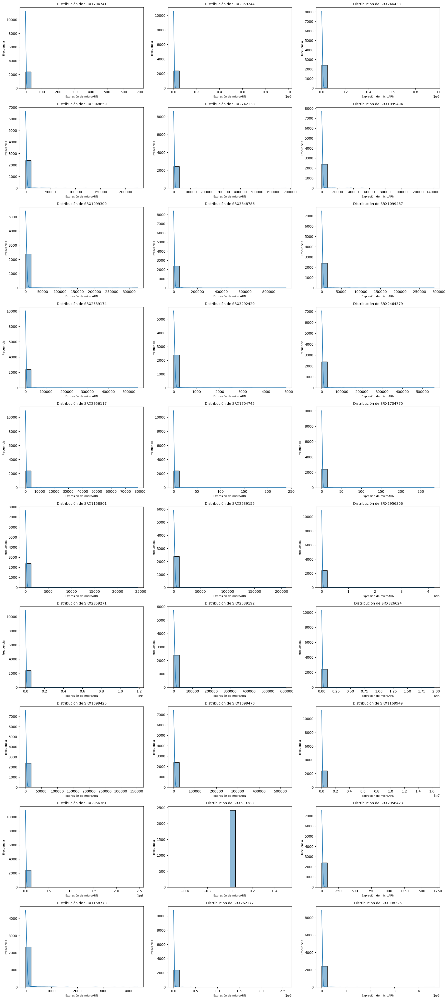

In [19]:
# Definir número de columnas y filas
n_cols = 3
n_rows = len(selected_mirna_raw.columns) // n_cols + (len(selected_mirna_raw.columns) % n_cols > 0)

# Crear la figura con tamaño ajustado
fig, axs = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols * 2, 4 * n_rows))

# Crear histogramas
for i, column in enumerate(selected_mirna_raw.columns):
    row = i // n_cols
    col = i % n_cols
    sns.histplot(selected_mirna_raw[column], bins=20, kde=True, ax=axs[row, col])
    axs[row, col].set_title(f'Distribución de {column}', fontsize=10)
    axs[row, col].set_xlabel('Expresión de microARN', fontsize=8)
    axs[row, col].set_ylabel('Frecuencia', fontsize=8)

# Eliminar ejes sobrantes
for j in range(len(selected_mirna_raw.columns), n_rows * n_cols):
    fig.delaxes(axs.flatten()[j])

plt.tight_layout()
#plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

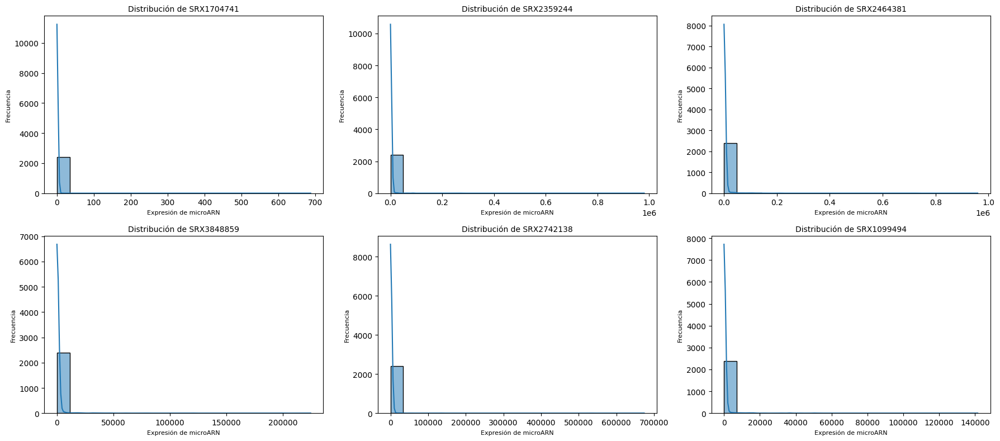

In [20]:
# Gráfico con 6 diagramas para presentar en la memoria

# Definir número de columnas y filas
n_cols = 3
n_rows = len(selected_mirna_raw_six.columns) // n_cols + (len(selected_mirna_raw_six.columns) % n_cols > 0)

# Crear la figura con tamaño ajustado
fig, axs = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols * 2, 4 * n_rows))

# Crear histogramas
for i, column in enumerate(selected_mirna_raw_six.columns):
    row = i // n_cols
    col = i % n_cols
    sns.histplot(selected_mirna_raw_six[column], bins=20, kde=True, ax=axs[row, col])
    axs[row, col].set_title(f'Distribución de {column}', fontsize=10)
    axs[row, col].set_xlabel('Expresión de microARN', fontsize=8)
    axs[row, col].set_ylabel('Frecuencia', fontsize=8)

# Eliminar ejes sobrantes
for j in range(len(selected_mirna_raw_six.columns), n_rows * n_cols):
    fig.delaxes(axs.flatten()[j])

plt.tight_layout()

# output_path = os.path.join(results_eda_path, f"mirna_histograma.png")
# plt.savefig(output_path, format='png')

plt.show()



In [21]:
# Aplicar la transformación log(x+1) a los datos de expresión
selected_mirna_raw_log2 = selected_mirna_raw.applymap(lambda x: np.log2(x + 1))
selected_mirna_raw_log2.head()

C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\2124428524.py:2: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  selected_mirna_raw_log2 = selected_mirna_raw.applymap(lambda x: np.log2(x + 1))


,SRX1704741,SRX2359244,SRX2464381,SRX3848859,SRX2742138,SRX1099494,SRX1099309,SRX3848786,SRX1099487,SRX2539174,...,SRX326624,SRX1099425,SRX1099470,SRX1169949,SRX2956361,SRX513283,SRX2956423,SRX1158773,SRX262177,SRX098326
0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
1,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
2,0.0,3.321928,10.497852,8.665336,0.0,8.876517,10.876517,6.569856,9.712527,6.459432,...,5.523562,10.152285,10.401946,0.0,0.0,0.0,0.0,0.0,4.321928,10.431498
3,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000
4,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000


In [22]:
# Aplicar la transformación log(x+1) a los datos de expresión
selected_mirna_raw_log2_six = selected_mirna_raw_six.applymap(lambda x: np.log2(x + 1))
selected_mirna_raw_log2_six.head()

C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\1681661831.py:2: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  selected_mirna_raw_log2_six = selected_mirna_raw_six.applymap(lambda x: np.log2(x + 1))


,SRX1704741,SRX2359244,SRX2464381,SRX3848859,SRX2742138,SRX1099494
0,0.0,0.000000,0.000000,0.000000,0.0,0.000000
1,0.0,0.000000,0.000000,0.000000,0.0,0.000000
2,0.0,3.321928,10.497852,8.665336,0.0,8.876517
3,0.0,0.000000,0.000000,0.000000,0.0,0.000000
4,0.0,0.000000,0.000000,0.000000,0.0,0.000000


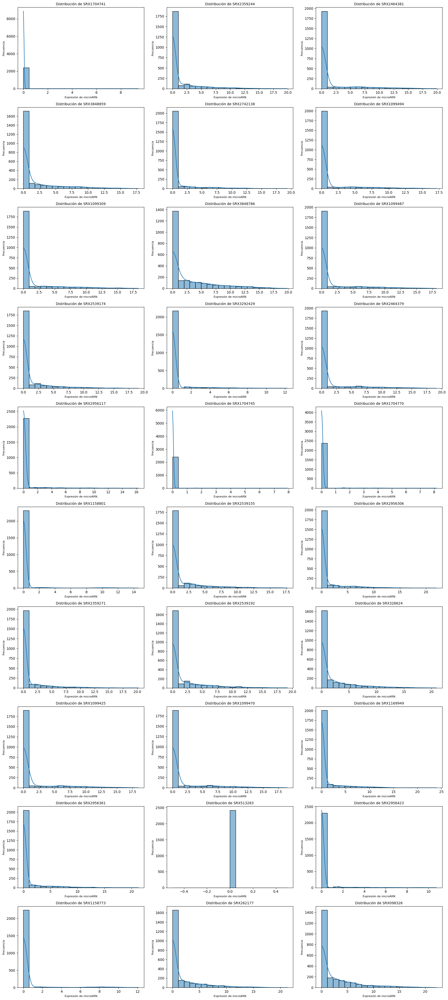

In [23]:
# Definir número de columnas y filas
n_cols = 3
n_rows = len(selected_mirna_raw_log2.columns) // n_cols + (len(selected_mirna_raw_log2.columns) % n_cols > 0)

# Crear la figura con tamaño ajustado
fig, axs = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols * 2, 4 * n_rows))

# Crear histogramas
for i, column in enumerate(selected_mirna_raw_log2.columns):
    row = i // n_cols
    col = i % n_cols
    sns.histplot(selected_mirna_raw_log2[column], bins=20, kde=True, ax=axs[row, col])
    axs[row, col].set_title(f'Distribución de {column}', fontsize=10)
    axs[row, col].set_xlabel('Expresión de microARN', fontsize=8)
    axs[row, col].set_ylabel('Frecuencia', fontsize=8)

# Eliminar ejes sobrantes
for j in range(len(selected_mirna_raw_log2.columns), n_rows * n_cols):
    fig.delaxes(axs.flatten()[j])

plt.tight_layout()
#plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

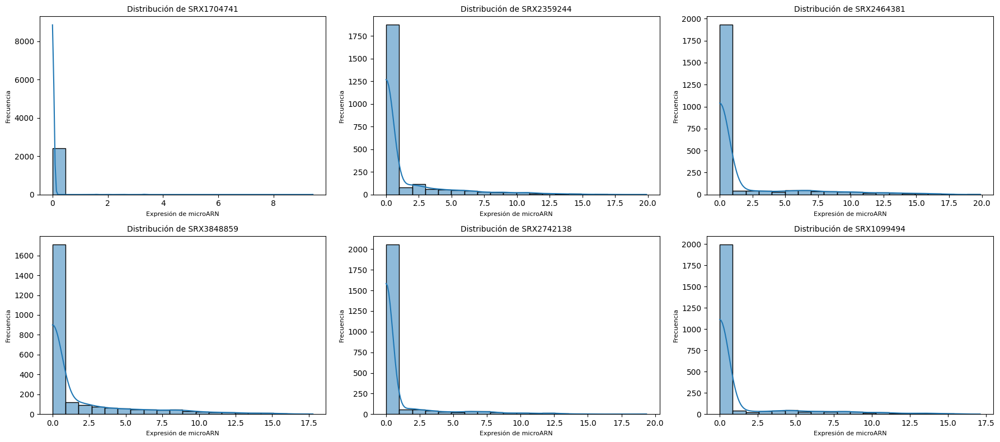

In [24]:
# Gráfico con 5 diagramas para presentar en la memoria

# Definir número de columnas y filas
n_cols = 3
n_rows = len(selected_mirna_raw_log2_six.columns) // n_cols + (len(selected_mirna_raw_log2_six.columns) % n_cols > 0)

# Crear la figura con tamaño ajustado
fig, axs = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols * 2, 4 * n_rows))

# Crear histogramas
for i, column in enumerate(selected_mirna_raw_log2_six.columns):
    row = i // n_cols
    col = i % n_cols
    sns.histplot(selected_mirna_raw_log2_six[column], bins=20, kde=True, ax=axs[row, col])
    axs[row, col].set_title(f'Distribución de {column}', fontsize=10)
    axs[row, col].set_xlabel('Expresión de microARN', fontsize=8)
    axs[row, col].set_ylabel('Frecuencia', fontsize=8)

# Eliminar ejes sobrantes
for j in range(len(selected_mirna_raw_log2_six.columns), n_rows * n_cols):
    fig.delaxes(axs.flatten()[j])

plt.tight_layout()

# output_path = os.path.join(results_eda_path, f"mirna_histograma_log2.png")
# plt.savefig(output_path, format='png')

plt.show()

### 2.6.2. Pruebas de Normalidad (Shapiro-Wilk)

In [25]:
# Prueba de Shapiro-Wilk
data = mirna_raw.drop(columns=['name'], errors='ignore')
shapiro_test = stats.shapiro(data)
print("Prueba de Shapiro-Wilk:", shapiro_test)

Prueba de Shapiro-Wilk: ShapiroResult(statistic=np.float64(0.006726391611139082), pvalue=np.float64(9.634439445598756e-251))


c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\scipy\stats\_axis_nan_policy.py:573: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 3771221.
  res = hypotest_fun_out(*samples, **kwds)


## 2.7. miRNA - Detección de outliers

### 2.7.1. IQR

Debido a la alta dimensionalidad del dataset, se opta por el método estadístico **IQR (Interquartile Range)** para detectar valores que están muy alejados del rango intercuartílico y, de esta manera, automatizar la detección y tratamiento de outliers.

In [26]:
def detect_outliers(df):
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1
    is_outlier = (df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))
    return is_outlier

# Detectar outliers en todas las columnas (excepto la primera columna que contiene los nombres de los miRNAs)
outliers = detect_outliers(mirna_raw.iloc[:, 1:])

# Contar el número de outliers por columna
outlier_counts = outliers.sum()

# Filtrar las columnas que tienen al menos un outlier
columns_with_outliers = outlier_counts[outlier_counts > 0]

# Imprimir el total de columnas que tienen outliers
total_columns_with_outliers = columns_with_outliers.count()
print(f"Total de columnas que tienen outliers: {total_columns_with_outliers}")

# Imprimir el nombre de las columnas con el total de outliers en cada columna
for column, count in columns_with_outliers.items():
    print(f"Columna {column} tiene {count} outliers")

Total de columnas que tienen outliers: 1556
Columna SRX258926 tiene 545 outliers
Columna SRX258927 tiene 566 outliers
Columna SRX258928 tiene 563 outliers
Columna SRX258929 tiene 573 outliers
Columna SRX258930 tiene 462 outliers
Columna SRX258931 tiene 478 outliers
Columna SRX258932 tiene 485 outliers
Columna SRX258933 tiene 478 outliers
Columna SRX258934 tiene 477 outliers
Columna SRX258935 tiene 507 outliers
Columna SRX258936 tiene 453 outliers
Columna SRX258937 tiene 477 outliers
Columna SRX258938 tiene 515 outliers
Columna SRX258939 tiene 485 outliers
Columna SRX3292413 tiene 336 outliers
Columna SRX3292414 tiene 53 outliers
Columna SRX3292415 tiene 249 outliers
Columna SRX3292416 tiene 130 outliers
Columna SRX3292417 tiene 451 outliers
Columna SRX3292418 tiene 296 outliers
Columna SRX3292419 tiene 285 outliers
Columna SRX3292420 tiene 402 outliers
Columna SRX3292421 tiene 207 outliers
Columna SRX3292422 tiene 306 outliers
Columna SRX3292423 tiene 374 outliers
Columna SRX3292424 ti

### 2.7.2. Boxplots

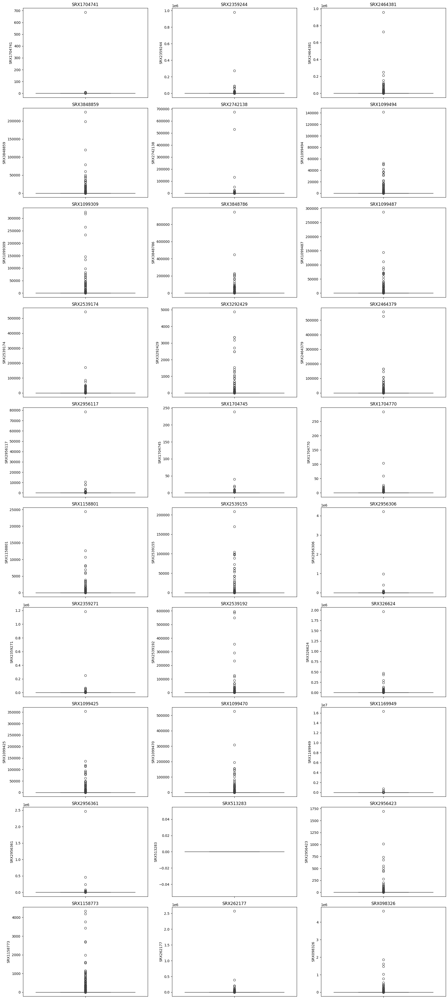

In [27]:
# Definir número de columnas y filas
n_cols = 3
n_rows = len(selected_mirna_raw.columns) // n_cols + (len(selected_mirna_raw.columns) % n_cols > 0)

# Crear la figura con tamaño ajustado
fig, axs = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols * 2, 4 * n_rows))

# Crear boxplots
for i, column in enumerate(selected_mirna_raw.columns):
    row = i // n_cols
    col = i % n_cols
    sns.boxplot(y=column, data=selected_mirna_raw, ax=axs[row, col])
    axs[row, col].set_title(column)
    axs[row, col].tick_params(axis='x', rotation=90)

# Eliminar ejes sobrantes
for j in range(len(selected_mirna_raw.columns), n_rows * n_cols):
    fig.delaxes(axs.flatten()[j])

plt.tight_layout()
plt.show()


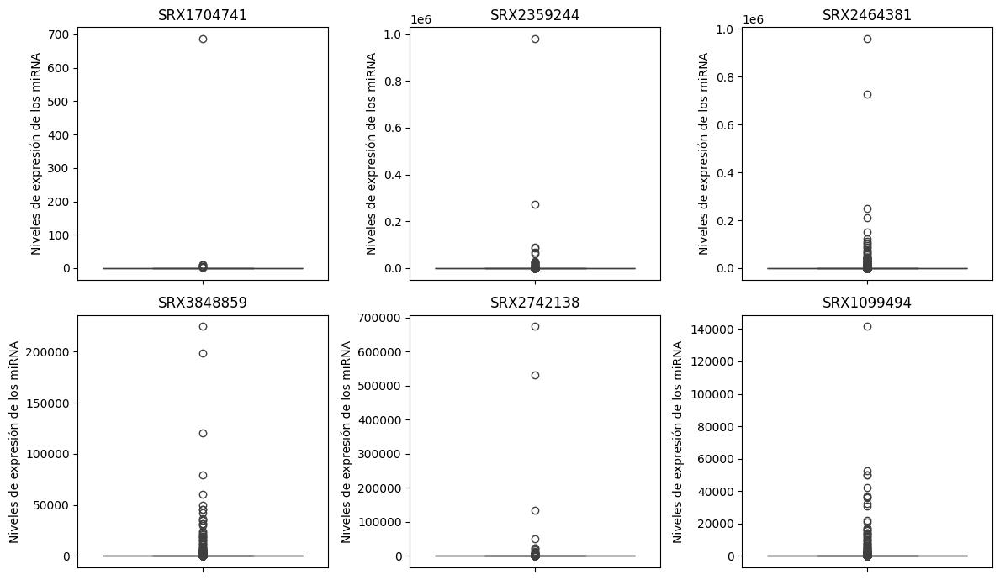

In [28]:
# Gráfico con 6 diagramas para presentar en la memoria

# Definir número de columnas y filas
n_cols = 3
n_rows = len(selected_mirna_raw_six.columns) // n_cols + (len(selected_mirna_raw_six.columns) % n_cols > 0)

# Crear la figura con tamaño ajustado
fig, axs = plt.subplots(n_rows, n_cols, figsize=(4 * n_cols, 3.5 * n_rows))

# Crear boxplots
for i, column in enumerate(selected_mirna_raw_six.columns):
    row = i // n_cols
    col = i % n_cols
    sns.boxplot(y=column,  data=selected_mirna_raw, ax=axs[row, col])
    axs[row, col].set_title(column)
    axs[row, col].set_ylabel("Niveles de expresión de los miRNA")
    axs[row, col].tick_params(axis='x',  rotation=90)

# Eliminar ejes sobrantes si hay
for j in range(len(selected_mirna_raw_six.columns), n_rows * n_cols):
    fig.delaxes(axs.flatten()[j])

# Ajustar el diseño para evitar solapamientos
plt.tight_layout()

# Guardar la figura en alta resolución
# output_path = os.path.join(results_eda_path, "mirna_boxplot.png")
# plt.savefig(output_path, format='png', dpi=300)

# Mostrar la figura
plt.show()

## 2.8. miRNA - Análisis de Correlación

### 2.8.1. Experimentos

In [29]:
mirna_nona = mirna_raw.dropna()
mirna_nona_expression = mirna_nona.iloc[:,1:]
mirna_nona_expression

,SRX258926,SRX258927,SRX258928,SRX258929,SRX258930,SRX258931,SRX258932,SRX258933,SRX258934,SRX258935,...,SRX1704766,SRX1704767,SRX1704768,SRX1704769,SRX1704770,SRX1704771,SRX1704772,SRX1704773,SRX1704774,SRX1704775
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,260,350,1796,1768,51,58,283,183,977,1127,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2414,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2415,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2416,0,0,2,0,2,0,0,0,2,0,...,0,0,0,0,0,0,0,0,0,0
2417,6,3,16,11,7,12,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Número de pares con correlación absoluta > 0.7: 188312
Número de pares con correlación absoluta > 0.85: 117664


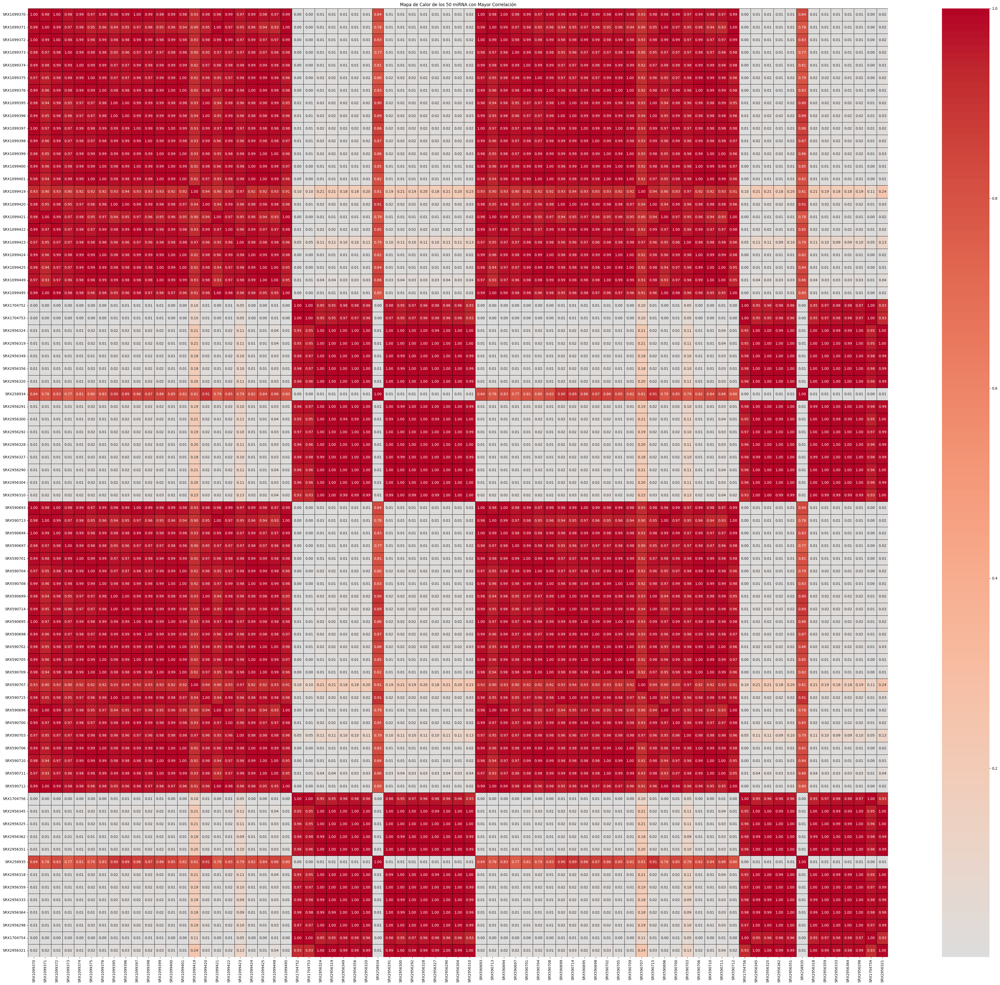

In [30]:
# Calcular la matriz de correlación entre todos los miRNA
correlation_matrix = mirna_nona_expression.corr()

# Crear una máscara para obtener sólo los pares de correlación (excluyendo la diagonal)
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool), k=1)

# Obtener correlaciones absolutas y aplicar la máscara
abs_corr_matrix = correlation_matrix.abs()
masked_corr_matrix = abs_corr_matrix.where(mask)

# Encontrar los pares con alta correlación
high_corr_0_7 = masked_corr_matrix.stack()[masked_corr_matrix.stack() > 0.7]
high_corr_0_85 = masked_corr_matrix.stack()[masked_corr_matrix.stack() > 0.85]

# Imprimir los resultados
print(f"Número de pares con correlación absoluta > 0.7: {len(high_corr_0_7)}")
print(f"Número de pares con correlación absoluta > 0.85: {len(high_corr_0_85)}")

# Filtrar las 50 correlaciones más altas (en valor absoluto)
top_50_corr = masked_corr_matrix.stack().nlargest(50)

# Extraer los miRNAs correspondientes a las 50 correlaciones más altas
top_50_miRNAs = pd.unique(top_50_corr.index.get_level_values(0).append(top_50_corr.index.get_level_values(1)))

# Crear una submatriz de correlación para estos miRNAs
top_50_corr_matrix = correlation_matrix.loc[top_50_miRNAs, top_50_miRNAs]

# Visualizar la submatriz de correlación como un mapa de calor
plt.figure(figsize=(54, 48))
sns.heatmap(top_50_corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', center=0, linewidths=0.5, linecolor='black')
plt.title("Mapa de Calor de los 50 miRNA con Mayor Correlación")
plt.show()

### 2.8.2. miRNAs

In [31]:
mirna_raw_transposed = mirna_raw.T
mirna_raw_transposed.columns = mirna_raw_transposed.iloc[0]
mirna_raw_transposed = mirna_raw_transposed[1:]
mirna_raw_transposed = mirna_raw_transposed.reset_index()
mirna_raw_transposed = mirna_raw_transposed.rename(columns={'index': 'Experiment'})

# Convertir a numerico
columns_to_convert = mirna_raw_transposed.columns[1:]
mirna_raw_transposed[columns_to_convert] = mirna_raw_transposed[columns_to_convert].apply(pd.to_numeric)
mirna_raw_transposed

name,Experiment,hsa-miR-6850-3p,hsa-miR-4761-3p,hsa-miR-99b-3p,kshv-miR-K12-10a-3p,hsa-miR-3129-5p,ebv-miR-BART3-3p,hsa-miR-6820-5p,hsa-miR-4731-5p,hsa-miR-4423-3p,...,hsa-miR-4423-5p,hsa-miR-6512-5p,hsa-miR-6718-5p,hsa-miR-520h,hsa-miR-6796-5p,hsa-miR-1245b-5p,hsa-miR-5586-3p,hsa-miR-29a-5p,hsa-miR-1304-3p,hsa-miR-384
0,SRX258926,0,0,260,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,6,1046
1,SRX258927,0,0,350,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,3,1735
2,SRX258928,0,0,1796,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,16,83
3,SRX258929,0,0,1768,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,11,89
4,SRX258930,0,0,51,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,7,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1554,SRX1704771,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1555,SRX1704772,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1556,SRX1704773,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1557,SRX1704774,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [32]:
mirna_transposed_nona = mirna_raw_transposed.dropna()
mirna_transposed_nona

name,Experiment,hsa-miR-6850-3p,hsa-miR-4761-3p,hsa-miR-99b-3p,kshv-miR-K12-10a-3p,hsa-miR-3129-5p,ebv-miR-BART3-3p,hsa-miR-6820-5p,hsa-miR-4731-5p,hsa-miR-4423-3p,...,hsa-miR-4423-5p,hsa-miR-6512-5p,hsa-miR-6718-5p,hsa-miR-520h,hsa-miR-6796-5p,hsa-miR-1245b-5p,hsa-miR-5586-3p,hsa-miR-29a-5p,hsa-miR-1304-3p,hsa-miR-384
0,SRX258926,0,0,260,0,0,0,2,0,0,...,0,0,0,0,0,0,0,0,6,1046
1,SRX258927,0,0,350,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,3,1735
2,SRX258928,0,0,1796,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,16,83
3,SRX258929,0,0,1768,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,11,89
4,SRX258930,0,0,51,0,0,0,0,0,0,...,0,0,0,0,0,0,0,2,7,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1554,SRX1704771,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1555,SRX1704772,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1556,SRX1704773,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1557,SRX1704774,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [33]:
mirna_transposed_nona_expression = mirna_transposed_nona.iloc[:,1:]
mirna_transposed_nona_expression

name,hsa-miR-6850-3p,hsa-miR-4761-3p,hsa-miR-99b-3p,kshv-miR-K12-10a-3p,hsa-miR-3129-5p,ebv-miR-BART3-3p,hsa-miR-6820-5p,hsa-miR-4731-5p,hsa-miR-4423-3p,hsa-miR-136-5p,...,hsa-miR-4423-5p,hsa-miR-6512-5p,hsa-miR-6718-5p,hsa-miR-520h,hsa-miR-6796-5p,hsa-miR-1245b-5p,hsa-miR-5586-3p,hsa-miR-29a-5p,hsa-miR-1304-3p,hsa-miR-384
0,0,0,260,0,0,0,2,0,0,956,...,0,0,0,0,0,0,0,0,6,1046
1,0,0,350,0,0,0,0,0,0,974,...,0,0,0,0,0,0,0,0,3,1735
2,0,0,1796,0,0,0,0,0,0,202,...,0,0,0,0,0,0,0,2,16,83
3,0,0,1768,0,0,0,0,0,0,231,...,0,0,0,0,0,0,0,0,11,89
4,0,0,51,0,0,0,0,0,0,145,...,0,0,0,0,0,0,0,2,7,77
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1554,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1555,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1556,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1557,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Número de pares con correlación absoluta > 0.7: 15719
Número de pares con correlación absoluta > 0.85: 5403


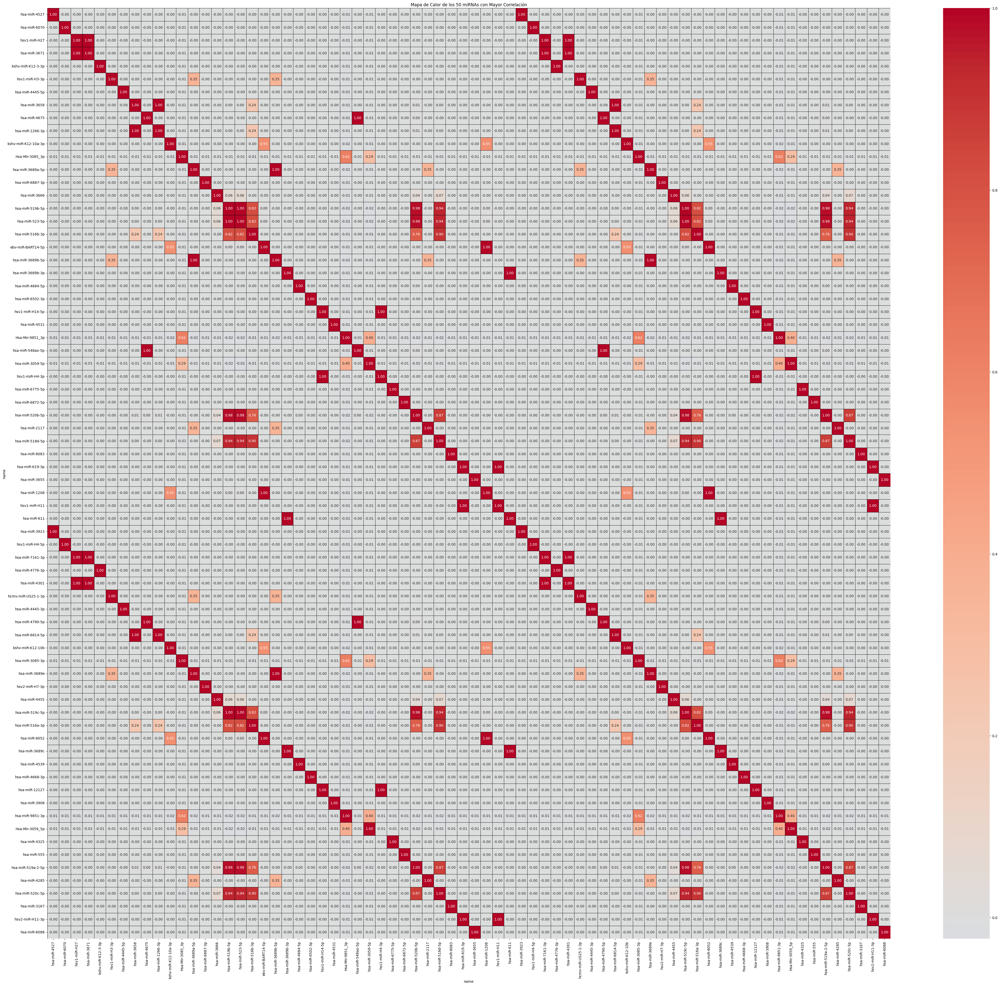

In [34]:
# Calcular la matriz de correlación entre todos los miRNA
correlation_matrix = mirna_transposed_nona_expression.corr()

# Crear una máscara para obtener sólo los pares de correlación (excluyendo la diagonal)
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool), k=1)

# Obtener correlaciones absolutas y aplicar la máscara
abs_corr_matrix = correlation_matrix.abs()
masked_corr_matrix = abs_corr_matrix.where(mask)

# Encontrar los pares con alta correlación
high_corr_0_7 = masked_corr_matrix.stack()[masked_corr_matrix.stack() > 0.7]
high_corr_0_85 = masked_corr_matrix.stack()[masked_corr_matrix.stack() > 0.85]

# Imprimir los resultados
print(f"Número de pares con correlación absoluta > 0.7: {len(high_corr_0_7)}")
print(f"Número de pares con correlación absoluta > 0.85: {len(high_corr_0_85)}")

# Filtrar las 50 correlaciones más altas (en valor absoluto)
top_50_corr = masked_corr_matrix.stack().nlargest(50)

# Extraer los miRNAs correspondientes a las 50 correlaciones más altas
top_50_miRNAs = pd.unique(top_50_corr.index.get_level_values(0).append(top_50_corr.index.get_level_values(1)))

# Crear una submatriz de correlación para estos miRNAs
top_50_corr_matrix = correlation_matrix.loc[top_50_miRNAs, top_50_miRNAs]

# Visualizar la submatriz de correlación como un mapa de calor
plt.figure(figsize=(54, 48))
sns.heatmap(top_50_corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', center=0, linewidths=0.5, linecolor='black')
plt.title("Mapa de Calor de los 50 miRNAs con Mayor Correlación")

# Guardar la figura en alta resolución
# output_path = os.path.join(results_eda_path, "mirna_correlation.png")
# plt.savefig(output_path, format='png', dpi=300)

plt.show()

Número de pares con correlación absoluta > 0.7: 15719
Número de pares con correlación absoluta > 0.85: 5403


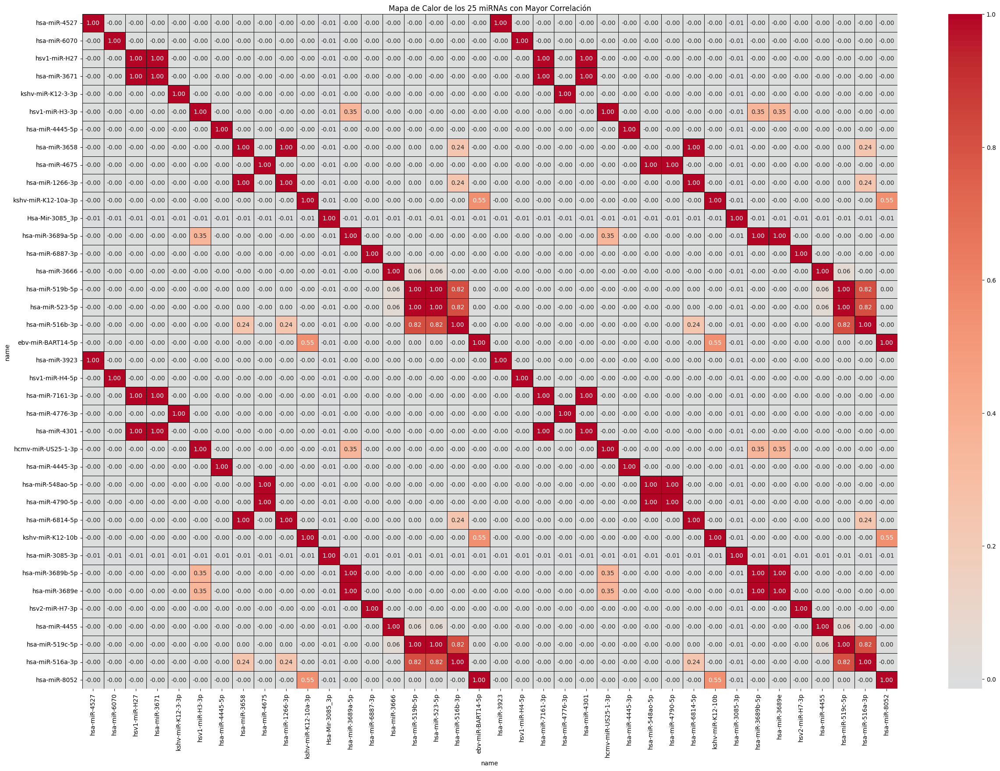

In [35]:
# Calcular la matriz de correlación entre todos los miRNA
correlation_matrix = mirna_transposed_nona_expression.corr()

# Crear una máscara para obtener sólo los pares de correlación (excluyendo la diagonal)
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool), k=1)

# Obtener correlaciones absolutas y aplicar la máscara
abs_corr_matrix = correlation_matrix.abs()
masked_corr_matrix = abs_corr_matrix.where(mask)

# Encontrar los pares con alta correlación
high_corr_0_7 = masked_corr_matrix.stack()[masked_corr_matrix.stack() > 0.7]
high_corr_0_85 = masked_corr_matrix.stack()[masked_corr_matrix.stack() > 0.85]

# Imprimir los resultados
print(f"Número de pares con correlación absoluta > 0.7: {len(high_corr_0_7)}")
print(f"Número de pares con correlación absoluta > 0.85: {len(high_corr_0_85)}")

# Filtrar las 25 correlaciones más altas (en valor absoluto)
top_25_corr = masked_corr_matrix.stack().nlargest(25)

# Extraer los miRNAs correspondientes a las 25 correlaciones más altas
top_25_miRNAs = pd.unique(top_25_corr.index.get_level_values(0).append(top_25_corr.index.get_level_values(1)))

# Crear una submatriz de correlación para estos miRNAs
top_25_corr_matrix = correlation_matrix.loc[top_25_miRNAs, top_25_miRNAs]

# Visualizar la submatriz de correlación como un mapa de calor
plt.figure(figsize=(30, 20))
sns.heatmap(top_25_corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', center=0, linewidths=0.5, linecolor='black')
plt.title("Mapa de Calor de los 25 miRNAs con Mayor Correlación")

# Guardar la figura en alta resolución
# output_path = os.path.join(results_eda_path, "mirna_correlation_25.png")
# plt.savefig(output_path, format='png')

plt.show()

### 2.8.3. Análisis de Correlación con variables objetivo

Se tienen en cuenta las posibles varaibles objetivo Healthy, Cancer y Sex

In [36]:
# Eliminar valores NaN de metadata

metadata_nona = metadata_raw.dropna()
metadata_nona = metadata_nona.reset_index(drop=True)

In [37]:
# Unir el dataset transpuesto con metadata
mirna_metadata_nona = pd.merge(mirna_transposed_nona, metadata_nona, on='Experiment', how='inner')

In [38]:
# Discretizar los valores para poder obtener las correlaciones
mirna_metadata_encoded = mirna_metadata_nona.copy()

mirna_metadata_encoded['Healthy'] = mirna_metadata_encoded['Healthy'].map({'True': 1, 'False': 0})
mirna_metadata_encoded['Cancer'] = mirna_metadata_encoded['Cancer'].map({'True': 1, 'False': 0})
mirna_metadata_encoded['Sex'] = mirna_metadata_encoded['Sex'].map({'male': 1, 'female': 0})

In [39]:
# Crear el codificador
encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore')

# Ajustar y transformar los datos
encoded_array = encoder.fit_transform(mirna_metadata_encoded[['Fluid']])

# Convertir el array codificado a un DataFrame
df_encoded = pd.DataFrame(encoded_array, columns=encoder.get_feature_names_out(['Fluid']))

# Concatenar el DataFrame original con el DataFrame codificado
# mirna_metadata_encoded = pd.concat([mirna_metadata_encoded.drop(columns=['Fluid']), df_encoded], axis=1)
mirna_metadata_encoded = pd.concat([mirna_metadata_encoded, df_encoded], axis=1)

In [40]:
mirna_metadata_encoded

,Experiment,hsa-miR-6850-3p,hsa-miR-4761-3p,hsa-miR-99b-3p,kshv-miR-K12-10a-3p,hsa-miR-3129-5p,ebv-miR-BART3-3p,hsa-miR-6820-5p,hsa-miR-4731-5p,hsa-miR-4423-3p,...,Library,Healthy,Cancer,Exosome,Desc,Fluid_blood cells,Fluid_breast milk,Fluid_plasma,Fluid_serum,Fluid_whole blood
0,SRX3292413,0,0,7,0,0,0,0,3,0,...,NEBNext,0,0,False,Age: 26,0.0,0.0,1.0,0.0,0.0
1,SRX3292414,0,0,0,0,0,0,0,0,0,...,NEBNext,0,0,False,Age: 32,0.0,0.0,1.0,0.0,0.0
2,SRX3292415,0,0,2,0,0,0,0,0,0,...,NEBNext,0,0,False,Age: 68,0.0,0.0,1.0,0.0,0.0
3,SRX3292416,0,0,0,0,0,0,0,0,0,...,NEBNext,0,0,False,Age: 48,0.0,0.0,1.0,0.0,0.0
4,SRX3292417,0,0,58,0,0,0,0,0,0,...,NEBNext,0,0,False,Age: 39,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
833,SRX2026433,0,0,309,0,4,0,0,0,0,...,NEBNext,1,0,False,Age: 46,0.0,0.0,0.0,1.0,0.0
834,SRX2026434,0,0,74,0,0,0,0,0,0,...,NEBNext,0,1,False,Age: 69,0.0,0.0,0.0,1.0,0.0
835,SRX2026435,0,0,268,0,0,0,0,0,0,...,NEBNext,1,0,False,Age: 63,0.0,0.0,0.0,1.0,0.0
836,SRX2026436,0,0,138,0,0,0,0,0,0,...,NEBNext,1,0,False,Age: 58,0.0,0.0,0.0,1.0,0.0


In [41]:
mirna_metadata_fluid = mirna_metadata_encoded['Fluid']
mirna_metadata_encoded_dropped_cols = mirna_metadata_encoded.copy()
columns_to_remove = ['Experiment', 'SRP', 'Sample', 'Instrument', 'Extraction', 'Library', 'Exosome', 'Desc', 'Fluid']
mirna_metadata_encoded_dropped_cols.drop(columns=columns_to_remove, inplace=True)

In [42]:
len(mirna_metadata_encoded_dropped_cols.columns)

2427

In [43]:
# Convertir a numerico
columns_to_convert = mirna_metadata_encoded_dropped_cols.columns
mirna_metadata_encoded_dropped_cols[columns_to_convert] = mirna_metadata_encoded_dropped_cols[columns_to_convert].apply(pd.to_numeric)

In [44]:
mirna_metadata_encoded_dropped_cols.columns[2419:]

Index(['Sex', 'Healthy', 'Cancer', 'Fluid_blood cells', 'Fluid_breast milk',
       'Fluid_plasma', 'Fluid_serum', 'Fluid_whole blood'],
      dtype='object')

In [45]:
# Crear los nuevos DataFrames para cada metadata
mirna_sex = mirna_metadata_encoded_dropped_cols.iloc[:, 0:2420]  # columnas miRNA + Sex
mirna_healthy = mirna_metadata_encoded_dropped_cols.iloc[:, list(range(0, 2419)) + [2420]]  # columnas miRNA + Healthy
mirna_cancer = mirna_metadata_encoded_dropped_cols.iloc[:, list(range(0, 2419)) + [2421]]  # columnas miRNA + Cancer
#mirna_fluid = mirna_metadata_encoded_dropped_cols.iloc[:, list(range(0, 2419)) + list(range(2422, 2427))]  # columnas miRNA + Fluid

In [46]:
mirna_sex = mirna_sex.dropna()
mirna_healthy = mirna_healthy.dropna()
mirna_cancer = mirna_cancer.dropna()

In [47]:
from scipy.stats import ConstantInputWarning
import warnings

# Función para calcular la correlación y p-valor para cada miRNA
def calculate_correlation(df, target_column):
    correlations = []
    for i in range(2420):  # Asumiendo que las columnas miRNA están del 0 al 2419

        mirna_col = df.iloc[:,i]

        # Ignorar las columnas constantes
        if mirna_col.nunique() == 1:
            continue

        try: # Calcular la correlación
            corr, p_value = stats.pearsonr(df.iloc[:, i], df[target_column])
            correlations.append((df.columns[i], corr, p_value))

        except ConstantInputWarning:
            continue

    return pd.DataFrame(correlations, columns=['miRNA', 'Correlation', 'p-value'])

# Calcular correlaciones para cada metadata
sex_correlations = calculate_correlation(mirna_sex, 'Sex')
healthy_correlations = calculate_correlation(mirna_healthy, 'Healthy')
cancer_correlations = calculate_correlation(mirna_cancer, 'Cancer')

In [48]:
# Filtrar por correlaciones significativas (p-valor < 0.05)
significant_sex = sex_correlations[sex_correlations['p-value'] < 0.05]
significant_healthy = healthy_correlations[healthy_correlations['p-value'] < 0.05]
significant_cancer = cancer_correlations[cancer_correlations['p-value'] < 0.05]

# Imprimir el número total de miRNAs con correlación significativa
print(f"Total miRNAs significativos para Sex: {len(significant_sex)}")
print(f"Total miRNAs significativos para Healthy: {len(significant_healthy)}")
print(f"Total miRNAs significativos para Cancer: {len(significant_cancer)}")


Total miRNAs significativos para Sex: 1055
Total miRNAs significativos para Healthy: 1174
Total miRNAs significativos para Cancer: 1159


In [49]:
# Añadir una columna con el valor absoluto de la correlación usando .loc
significant_sex.loc[:, 'Absolute_Correlation'] = significant_sex['Correlation'].abs()
significant_healthy.loc[:, 'Absolute_Correlation'] = significant_healthy['Correlation'].abs()
significant_cancer.loc[:, 'Absolute_Correlation'] = significant_cancer['Correlation'].abs()

# Seleccionar los 20 miRNA más correlacionados
top_40_sex = significant_sex.nlargest(40, 'Absolute_Correlation', 'all')
top_40_healthy = significant_healthy.nlargest(40, 'Absolute_Correlation', 'all')
top_40_cancer = significant_cancer.nlargest(40, 'Absolute_Correlation', 'all')


C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\168964552.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_sex.loc[:, 'Absolute_Correlation'] = significant_sex['Correlation'].abs()
C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\168964552.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  significant_healthy.loc[:, 'Absolute_Correlation'] = significant_healthy['Correlation'].abs()
C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\168964552.py:4: Set

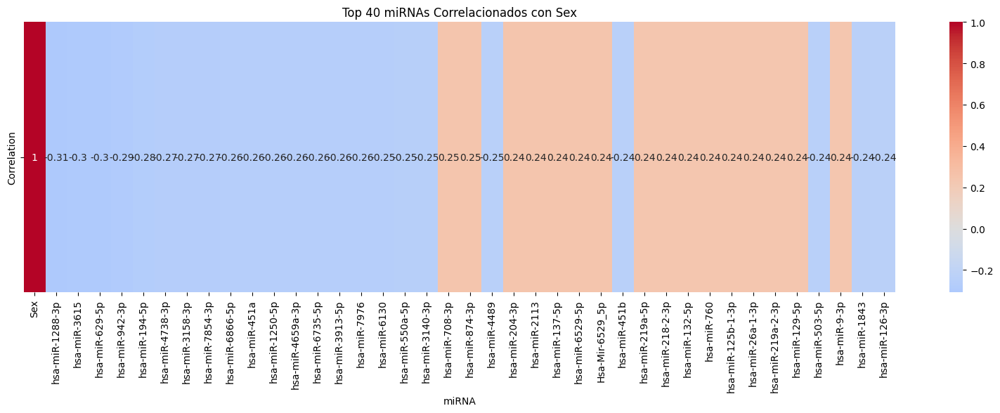

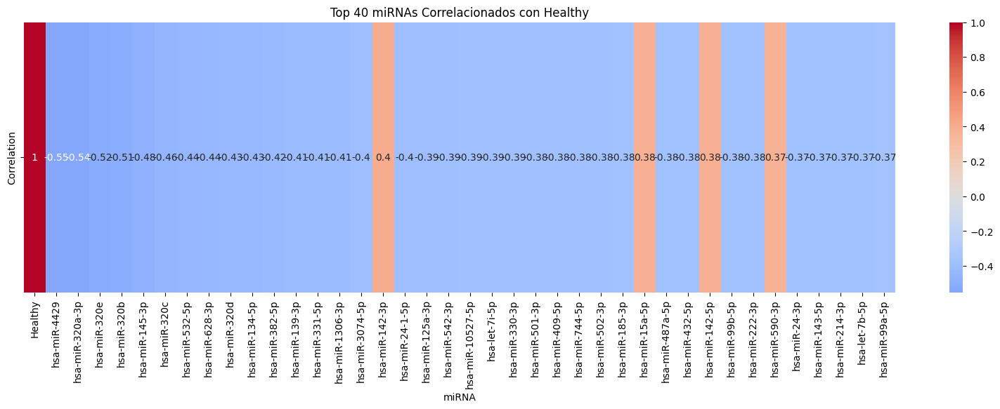

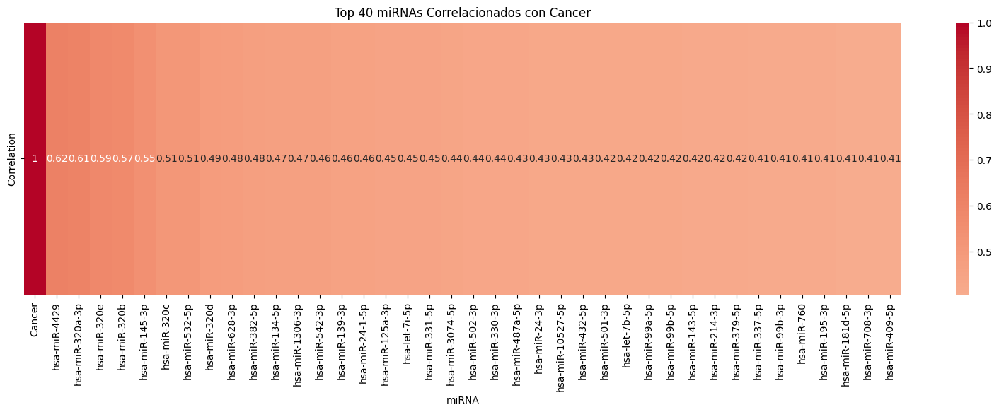

In [50]:
# Función para visualizar la matriz de correlaciones
def display_correlation(top_df, title):
    plt.figure(figsize=(20, 5))
    sns.heatmap(top_df[['miRNA', 'Correlation']].set_index('miRNA').transpose(), annot=True, cmap='coolwarm', center=0)
    plt.title(title)

    # Guardar la figura en alta resolución
    # output_path = os.path.join(results_eda_path, f"mirna_correlation_{title}.png")
    # plt.savefig(output_path, format='png', dpi=300)

# Visualizar para cada metadata
display_correlation(top_40_sex, "Top 40 miRNAs Correlacionados con Sex")
display_correlation(top_40_healthy, "Top 40 miRNAs Correlacionados con Healthy")
display_correlation(top_40_cancer, "Top 40 miRNAs Correlacionados con Cancer")


## 2.9. Análisis Multivariado

### 2.9.1. PCA (Análisis de Componentes Principales)

Se realiza un PCA para reducir la dimensionalidad y visualizar las principales fuentes de variabilidad entre muestras. También es útil para detectar patrones biológicos.
Se utilizan gráficos de dispersión para observar cómo las muestras se agrupan en función de la metadata (e.g., condición de cáncer).

#### 2.9.1.1. Detectar outliers y patrones entre las muestras

El PCA funciona reduciendo la dimensionalidad de un conjunto de datos al transformar las variables originales en un nuevo conjunto de variables ortogonales (componentes principales) que capturan la mayor variabilidad posible. Analiza como las observaciones (filas) varían conjuntamente a través de las variables (columnas). Después, descompone la matriz de covarianza en autovectores y autovalores, donde los autovectores representan las direcciones principales (componentes principales) en las que los datos varían más. Los autovalores indican la magnitud de la variabilidad en esas direcciones. Finalmente, proyecta las observaciones originales en este nuevo espacio de componentes principales, que se ordenan de tal manera que los primeros componentes capturan la mayor cantidad de variabilidad total. Así, se obtienen relaciones entre las observaciones (muestras) según cómo se distribuyen a lo largo de estas nuevas dimensiones.

Por lo tanto, si queremos identificar outliers entre las muestas o detectar patrones entre las muestras, es necesario **transponer** el dataset. 

In [51]:
# Seleccionar solo las columnas de expresión de miRNA
mirna_metadata_encoded_dropped_cols_expression = mirna_metadata_encoded_dropped_cols.iloc[:, 0:-8]
mirna_metadata_encoded_dropped_cols_expression

,hsa-miR-6850-3p,hsa-miR-4761-3p,hsa-miR-99b-3p,kshv-miR-K12-10a-3p,hsa-miR-3129-5p,ebv-miR-BART3-3p,hsa-miR-6820-5p,hsa-miR-4731-5p,hsa-miR-4423-3p,hsa-miR-136-5p,...,hsa-miR-4423-5p,hsa-miR-6512-5p,hsa-miR-6718-5p,hsa-miR-520h,hsa-miR-6796-5p,hsa-miR-1245b-5p,hsa-miR-5586-3p,hsa-miR-29a-5p,hsa-miR-1304-3p,hsa-miR-384
0,0,0,7,0,0,0,0,3,0,0,...,0,0,0,0,0,0,0,0,9,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,2,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,9,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,58,0,0,0,0,0,0,19,...,0,0,0,0,0,0,0,0,51,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
833,0,0,309,0,4,0,0,0,0,35,...,0,0,0,0,0,0,0,0,140,0
834,0,0,74,0,0,0,0,0,0,12,...,0,0,0,0,5,0,0,0,207,0
835,0,0,268,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,391,0
836,0,0,138,0,0,0,0,0,0,42,...,0,0,0,0,0,0,0,0,163,0


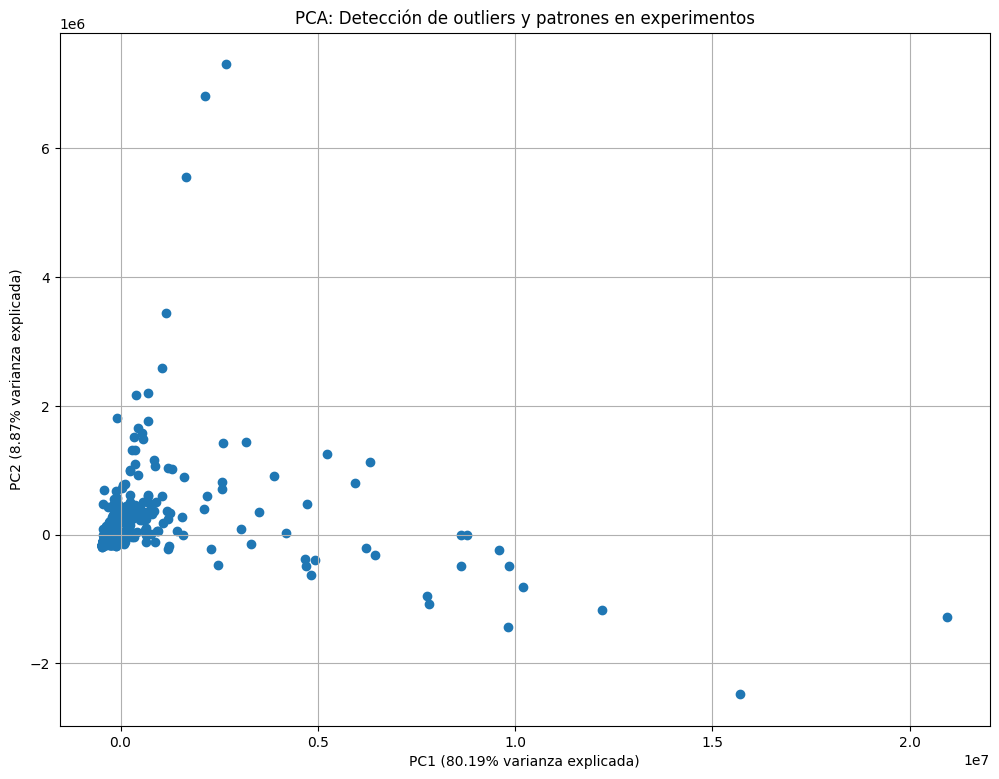

In [52]:
# Realizar PCA solo en las columnas de expresión de miRNA
pca = PCA(n_components=2)  # Usar las dos primeras componentes principales para poder graficarlo
pca_result = pca.fit_transform(mirna_metadata_encoded_dropped_cols_expression)

# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Convertir el resultado en un DataFrame para facilitar el plotting
pca_df = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])

# Plotting
plt.figure(figsize=(12,9))
plt.scatter(pca_df['PC1'], pca_df['PC2'])
plt.title('PCA: Detección de outliers y patrones en experimentos')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.show()

#### 2.9.1.2. Detección de patrones entre los miRNA

In [53]:
mirna_raw_expression = mirna_raw.iloc[:,1:]
mirna_raw_expression.head()

,SRX258926,SRX258927,SRX258928,SRX258929,SRX258930,SRX258931,SRX258932,SRX258933,SRX258934,SRX258935,...,SRX1704766,SRX1704767,SRX1704768,SRX1704769,SRX1704770,SRX1704771,SRX1704772,SRX1704773,SRX1704774,SRX1704775
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,260,350,1796,1768,51,58,283,183,977,1127,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


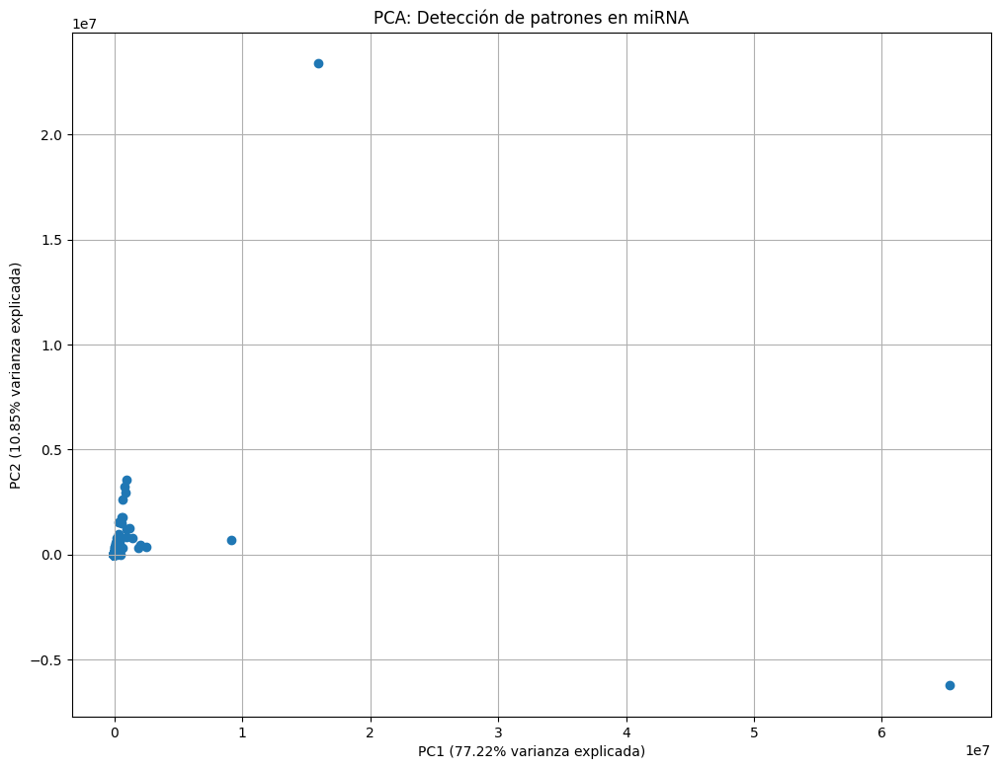

In [54]:
pca_mirna = PCA(n_components=2)
pca_result_mirna = pca_mirna.fit_transform(mirna_raw_expression)

# Convertir el resultado en un DataFrame para facilitar el plotting
pca_mirna_df = pd.DataFrame(data=pca_result_mirna, columns=['PC1', 'PC2'])

# Obtener el porcentaje de varianza explicada por cada componente
explained_variance_mirna = pca_mirna.explained_variance_ratio_

# Plotting
plt.figure(figsize=(12,9))
plt.scatter(pca_mirna_df['PC1'], pca_mirna_df['PC2'])
plt.title('PCA: Detección de patrones en miRNA')
plt.xlabel(f'PC1 ({explained_variance_mirna[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance_mirna[1]:.2%} varianza explicada)')
plt.grid(True)
plt.show()


#### 2.9.1.3. Gráfico de dispersión

In [55]:
# Unir el resultado del PCA con la metadata para poder usar la condición (Healthy, Cancer, Fluid)
columns_to_join = mirna_metadata_encoded_dropped_cols.iloc[:, 2420:].copy()
if len(pca_df) == len(columns_to_join):
    pca_df = pd.concat([pca_df, columns_to_join], axis=1)

pca_df.columns

Index(['PC1', 'PC2', 'Healthy', 'Cancer', 'Fluid_blood cells',
       'Fluid_breast milk', 'Fluid_plasma', 'Fluid_serum',
       'Fluid_whole blood'],
      dtype='object')

In [56]:
if len(pca_df) == len(mirna_metadata_fluid):
    pca_df = pd.concat([pca_df, mirna_metadata_fluid], axis=1)

In [57]:
pca_df.columns

Index(['PC1', 'PC2', 'Healthy', 'Cancer', 'Fluid_blood cells',
       'Fluid_breast milk', 'Fluid_plasma', 'Fluid_serum', 'Fluid_whole blood',
       'Fluid'],
      dtype='object')

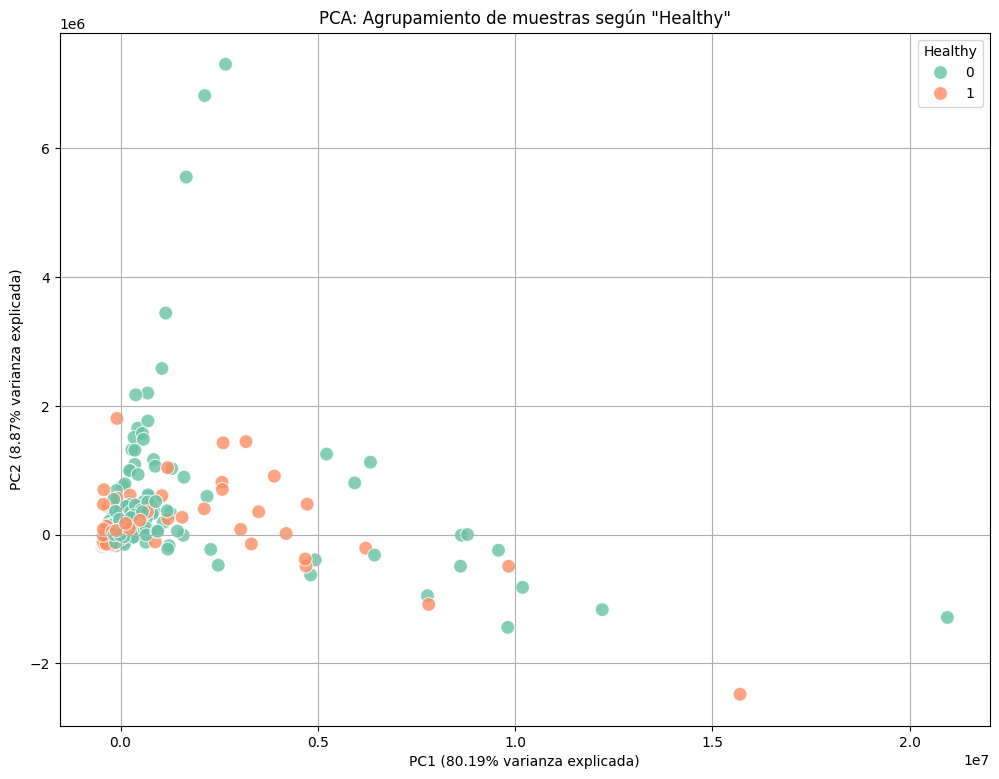

In [58]:
# Gráfico de dispersión con color basado en la condición de 'Healthy'
plt.figure(figsize=(12,9))
sns.scatterplot(
    x='PC1', y='PC2',
    hue='Healthy',
    palette=sns.color_palette("Set2", n_colors=2),
    data=pca_df,
    s=100,  # Tamaño de los puntos
    alpha=0.8  # Transparencia
)

plt.title('PCA: Agrupamiento de muestras según "Healthy"')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.legend(title='Healthy')
plt.grid(True)
plt.show()


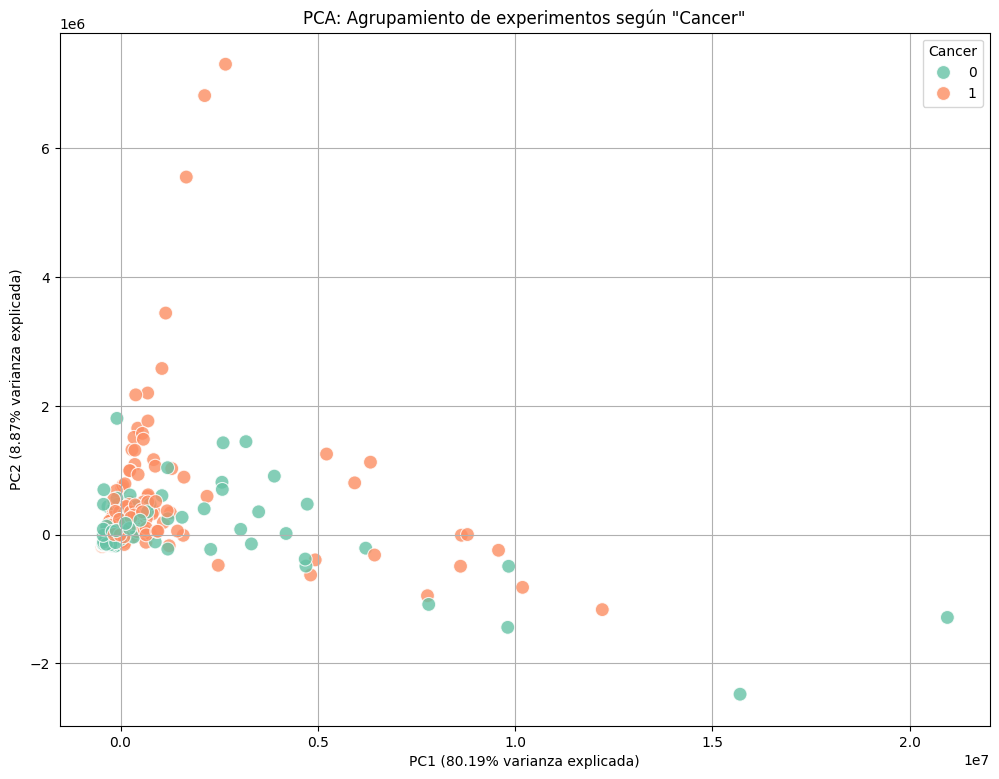

In [59]:
# Gráfico de dispersión con color basado en la condición de 'Cancer'
plt.figure(figsize=(12,9))
sns.scatterplot(
    x='PC1', y='PC2',
    hue='Cancer',
    palette=sns.color_palette("Set2", n_colors=2),
    data=pca_df,
    s=100,  # Tamaño de los puntos
    alpha=0.8  # Transparencia
)

plt.title('PCA: Agrupamiento de experimentos según "Cancer"')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.legend(title='Cancer')
plt.grid(True)
plt.show()

In [60]:
metadata_raw['Fluid'].unique()

array(['breast milk', nan, 'serum', 'plasma', 'urine cells', 'urine',
       'whole blood', 'seminal fluid', 'vaginal secretion',
       'menstrual secretion', 'perspiration', 'saliva', 'blood cells',
       'exosomes', 'cerebrospinal fluid', 'full urine', 'full saliva',
       'leukocytes', 'bronchoalveolar lavage', 'bile', 'amniotic fluid',
       'ovarian follicle fluid'], dtype=object)

In [61]:
pca_df['Fluid'].unique()

array(['plasma', 'serum', 'blood cells', 'breast milk', 'whole blood'],
      dtype=object)

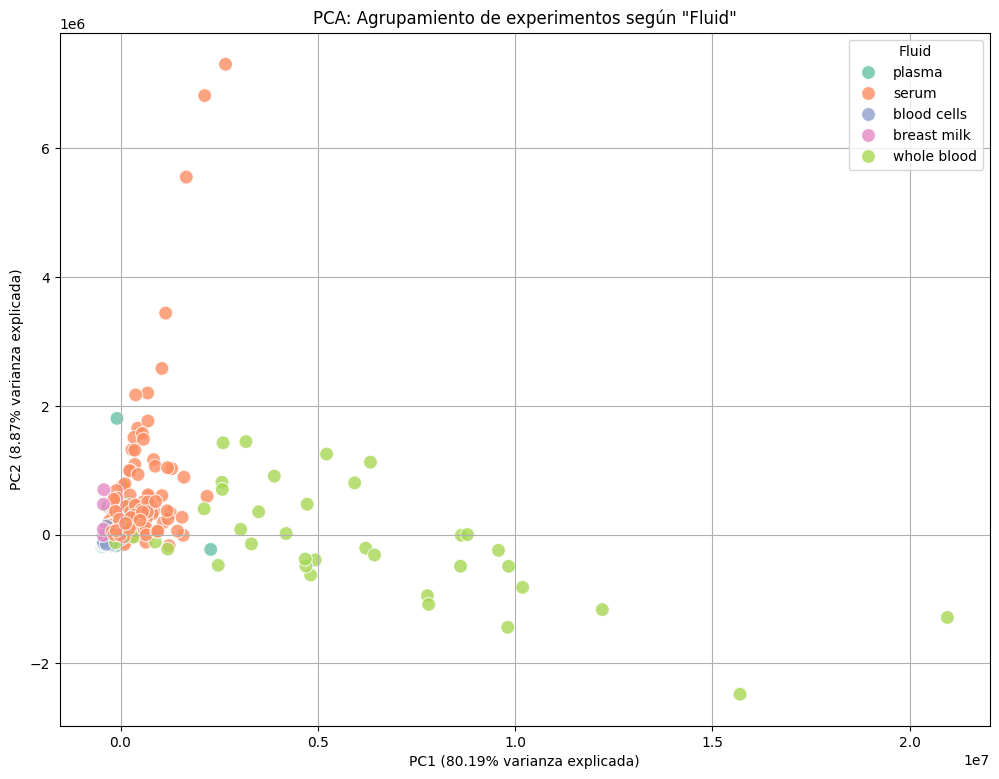

In [62]:
# Gráfico de dispersión con color basado en la condición de 'Fluid'
plt.figure(figsize=(12,9))
sns.scatterplot(
    x='PC1', y='PC2',
    hue='Fluid',
    palette=sns.color_palette("Set2", n_colors=5),
    data=pca_df,
    s=100,  # Tamaño de los puntos
    alpha=0.8  # Transparencia
)

plt.title('PCA: Agrupamiento de experimentos según "Fluid"')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.legend(title='Fluid')
plt.grid(True)
plt.show()

### 2.9.2. Métodos de clusterización (K-means)

In [63]:
mirna_metadata_encoded_dropped_cols_expression

,hsa-miR-6850-3p,hsa-miR-4761-3p,hsa-miR-99b-3p,kshv-miR-K12-10a-3p,hsa-miR-3129-5p,ebv-miR-BART3-3p,hsa-miR-6820-5p,hsa-miR-4731-5p,hsa-miR-4423-3p,hsa-miR-136-5p,...,hsa-miR-4423-5p,hsa-miR-6512-5p,hsa-miR-6718-5p,hsa-miR-520h,hsa-miR-6796-5p,hsa-miR-1245b-5p,hsa-miR-5586-3p,hsa-miR-29a-5p,hsa-miR-1304-3p,hsa-miR-384
0,0,0,7,0,0,0,0,3,0,0,...,0,0,0,0,0,0,0,0,9,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,2,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,9,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,58,0,0,0,0,0,0,19,...,0,0,0,0,0,0,0,0,51,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
833,0,0,309,0,4,0,0,0,0,35,...,0,0,0,0,0,0,0,0,140,0
834,0,0,74,0,0,0,0,0,0,12,...,0,0,0,0,5,0,0,0,207,0
835,0,0,268,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,391,0
836,0,0,138,0,0,0,0,0,0,42,...,0,0,0,0,0,0,0,0,163,0


In [64]:
# Definir el número de clusters (k)
num_clusters = 2

# Inicializar y ajustar el modelo K-means
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(mirna_metadata_encoded_dropped_cols_expression)

# Obtener las etiquetas de cluster para cada muestra
cluster_labels = kmeans.labels_

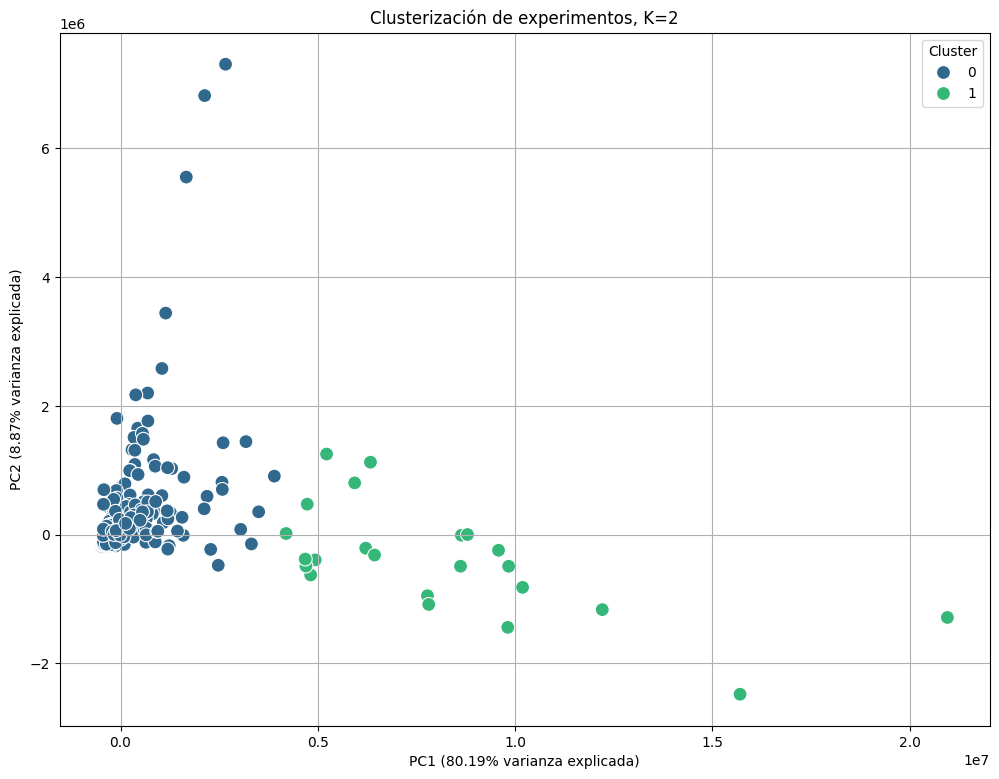

In [65]:
# Aplicar PCA para reducir a 2 componentes principales
pca_cluster = PCA(n_components=2)
pca_result_cluster = pca_cluster.fit_transform(mirna_metadata_encoded_dropped_cols_expression)

# Obtener el porcentaje de varianza explicada por cada componente
explained_variance_cluster = pca_cluster.explained_variance_ratio_

# Crear un DataFrame con los resultados del PCA y los labels del cluster
pca_kmeans = pd.DataFrame(data=pca_result_cluster, columns=['PC1', 'PC2'])
pca_kmeans['Cluster'] = cluster_labels

# Visualizar los clusters
plt.figure(figsize=(12,9))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_kmeans, palette='viridis', s=100)
plt.title('Clusterización de experimentos, K=2')
plt.xlabel(f'PC1 ({explained_variance_cluster[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance_cluster[1]:.2%} varianza explicada)')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()


In [66]:
mirna_metadata_encoded['Fluid'].unique()

array(['plasma', 'serum', 'blood cells', 'breast milk', 'whole blood'],
      dtype=object)

In [67]:
# Definir el número de clusters (k)
num_clusters = 5 # 5 es el número total de fluidos diferentes tras la eliminación de nulos y la integración de datasets

# Inicializar y ajustar el modelo K-means
kmeans = KMeans(n_clusters=num_clusters, random_state=42)
kmeans.fit(mirna_metadata_encoded_dropped_cols_expression)

# Obtener las etiquetas de cluster para cada muestra
cluster_labels = kmeans.labels_


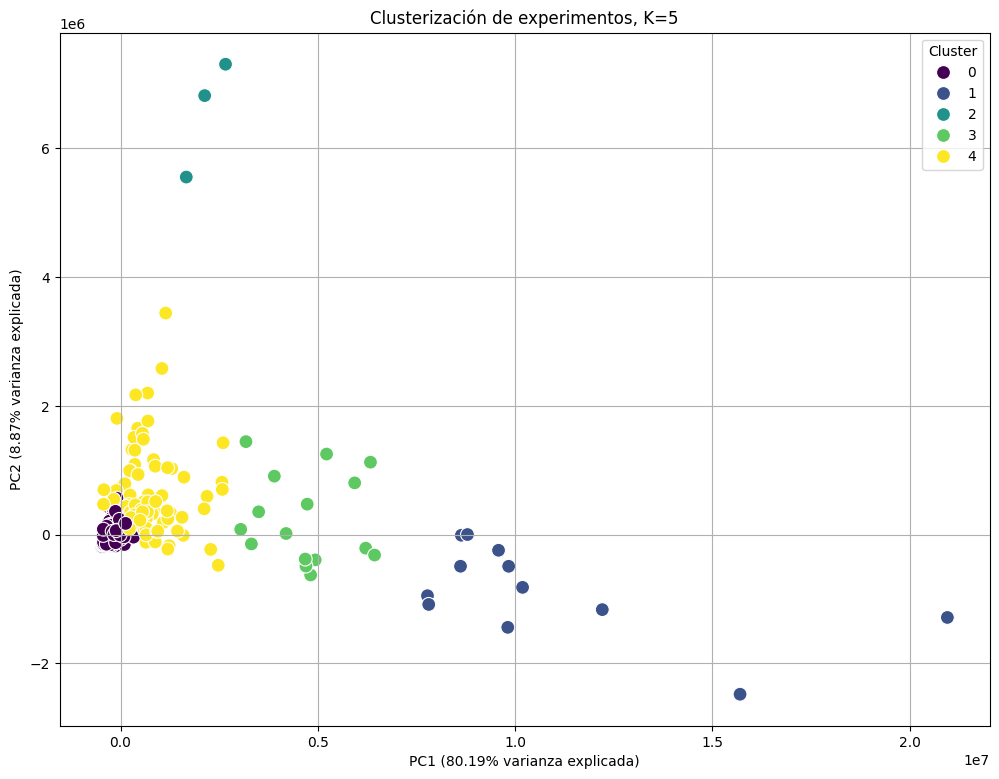

In [68]:
# Aplicar PCA para reducir a 2 componentes principales
pca_cluster = PCA(n_components=2)
pca_result_cluster = pca_cluster.fit_transform(mirna_metadata_encoded_dropped_cols_expression)

# Obtener el porcentaje de varianza explicada por cada componente
explained_variance_cluster = pca_cluster.explained_variance_ratio_

# Crear un DataFrame con los resultados del PCA y los labels del cluster
pca_kmeans = pd.DataFrame(data=pca_result_cluster, columns=['PC1', 'PC2'])
pca_kmeans['Cluster'] = cluster_labels

# Visualizar los clusters
plt.figure(figsize=(12,9))
sns.scatterplot(x='PC1', y='PC2', hue='Cluster', data=pca_kmeans, palette='viridis', s=100)
plt.title('Clusterización de experimentos, K=5')
plt.xlabel(f'PC1 ({explained_variance_cluster[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance_cluster[1]:.2%} varianza explicada)')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()


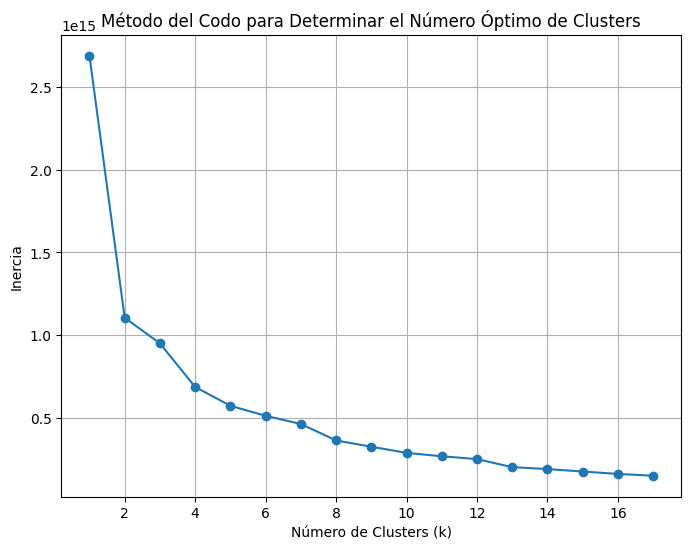

In [69]:
# Lista para almacenar la inercia (inertia) para cada número de clusters
inertia = []

# Rango de número de clusters que se van a probar
range_clusters = range(1, 18)

# Iterar sobre el rango de clusters y calcular K-means para cada uno
for k in range_clusters:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(mirna_metadata_encoded_dropped_cols_expression)
    inertia.append(kmeans.inertia_)

# Graficar el método del codo
plt.figure(figsize=(8, 6))
plt.plot(range_clusters, inertia, marker='o', linestyle='-')
plt.title('Método del Codo para Determinar el Número Óptimo de Clusters')
plt.xlabel('Número de Clusters (k)')
plt.ylabel('Inercia')
plt.grid(True)
plt.show()


K=5 como ya se ha probado

## 2.10. Exploración de la Metadata


### 2.10.1. Distribución de Variables Categóricas

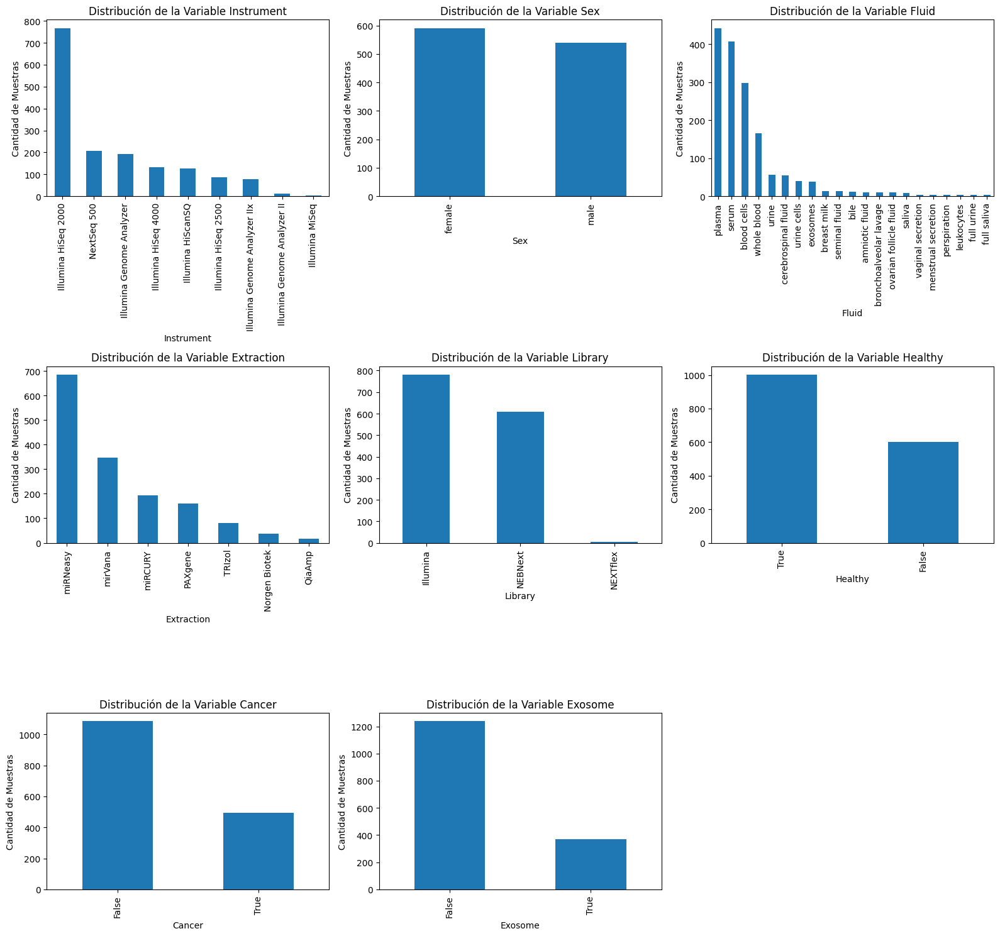

In [70]:
# Excluir columnas
excluded_columns = ['SRP', 'Experiment', 'Sample', 'Desc']
columns_to_plot = [col for col in metadata_raw.columns if col not in excluded_columns]

# Número de filas y columnas para los subplots
num_plots = len(columns_to_plot)
num_cols = 3
num_rows = (num_plots + num_cols - 1) // num_cols

plt.figure(figsize=(16, num_rows * 5))

for i, column in enumerate(columns_to_plot):
    plt.subplot(num_rows, num_cols, i + 1)
    metadata_raw[column].value_counts().plot(kind='bar')
    plt.title(f'Distribución de la Variable {column}')
    plt.xlabel(column)
    plt.ylabel('Cantidad de Muestras')

# Ajusta el layout para evitar solapamientos
plt.tight_layout()
plt.show()


In [71]:
print("\nNúmero de Observaciones por Categoría:")
for column in columns_to_plot:
    print(f"\n{column}:")
    print(metadata_raw[column].value_counts())
    num_nulls = metadata_raw[column].isnull().sum()
    print(f"\nNúmero de Valores Nulos: {num_nulls}")


Número de Observaciones por Categoría:

Instrument:
Instrument
Illumina HiSeq 2000             767
NextSeq 500                     206
Illumina Genome Analyzer        192
Illumina HiSeq 4000             133
Illumina HiScanSQ               126
Illumina HiSeq 2500              88
Illumina Genome Analyzer IIx     79
Illumina Genome Analyzer II      12
Illumina MiSeq                    3
Name: count, dtype: int64

Número de Valores Nulos: 0

Sex:
Sex
female    591
male      539
Name: count, dtype: int64

Número de Valores Nulos: 476

Fluid:
Fluid
plasma                    442
serum                     407
blood cells               297
whole blood               166
urine                      57
cerebrospinal fluid        55
urine cells                40
exosomes                   38
breast milk                14
seminal fluid              13
bile                       12
amniotic fluid             10
bronchoalveolar lavage     10
ovarian follicle fluid     10
saliva                      8


Las clases no están balanceadas

### 2.10.2. Boxplots/Violin Plots por Categoría:

Se visualiza cómo los niveles de expresión de miRNAs varían según categorías de la metadata (healthy y cancer).

C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\3006361108.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x=target, y=mirna_sel, data=mirna_metadata_encoded_dropped_cols, palette='Set2')
C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\3006361108.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x=target, y=mirna_sel, data=mirna_metadata_encoded_dropped_cols, palette='Set2')
C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\3006361108.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violin

<Figure size 1600x500 with 0 Axes>

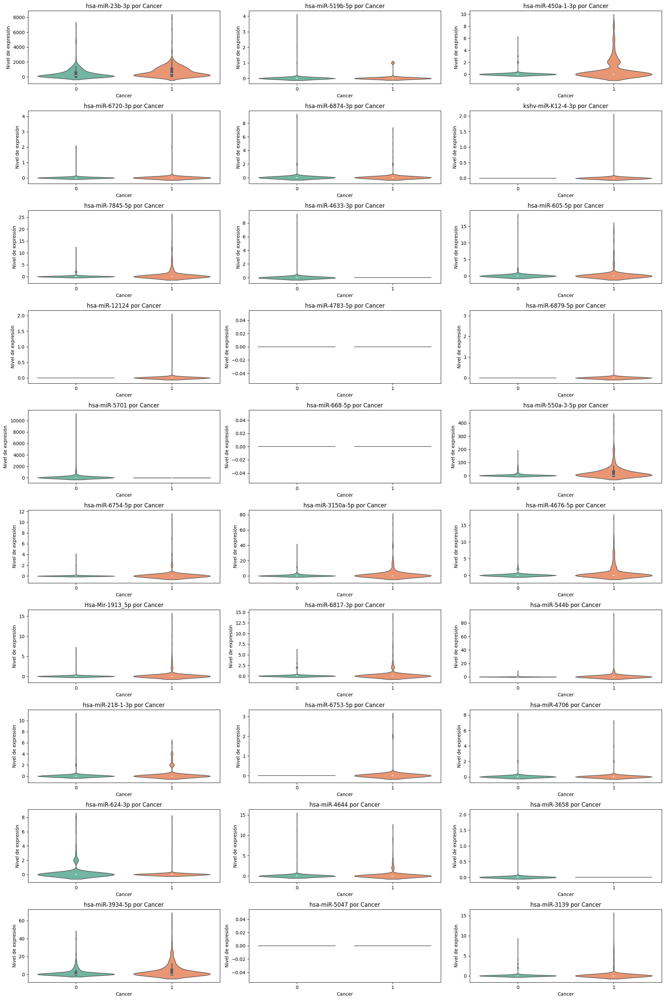

C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\3006361108.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x=target, y=mirna_sel, data=mirna_metadata_encoded_dropped_cols, palette='Set2')
C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\3006361108.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x=target, y=mirna_sel, data=mirna_metadata_encoded_dropped_cols, palette='Set2')
C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\3006361108.py:17: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violin

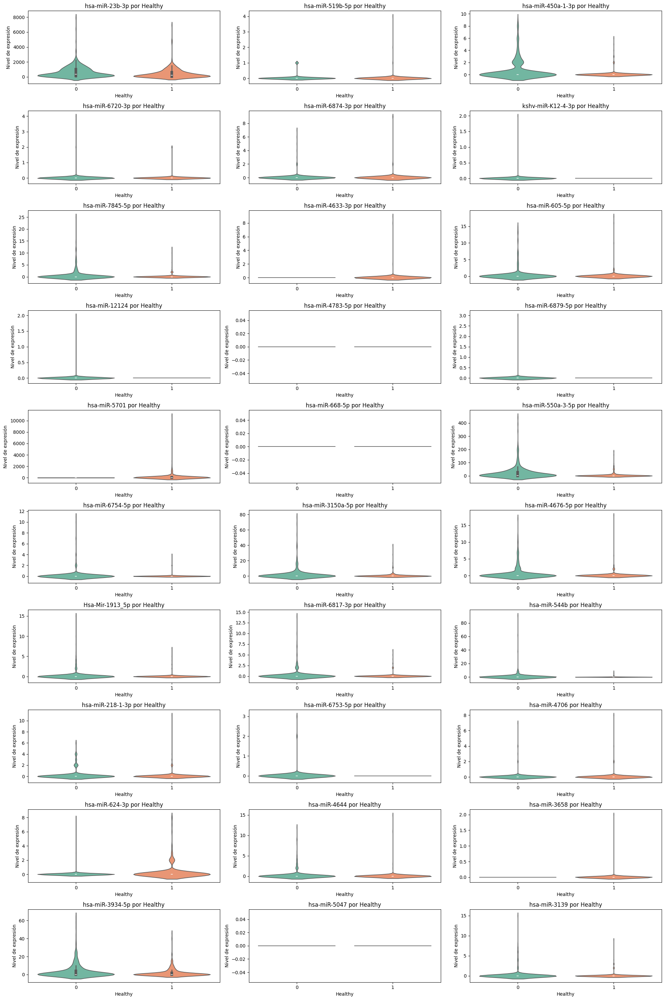

In [72]:
plt.figure(figsize=(16, 5))

# Fijar una semilla para reproducibilidad
np.random.seed(42)

# Seleccionar 30 miRNAs de manera aleatoria
selected_mirnas = np.random.choice(mirna_transposed_nona_expression.columns, 30, replace=False)

# Crear gráficos de violín para cada variable categórica y para cada miRNA seleccionado
target_variables = ['Cancer', 'Healthy']  # Ajustar según las variables que tengas en el metadata

for target in target_variables:
    plt.figure(figsize=(20, 30))  # Ajustar el tamaño para acomodar todos los gráficos

    for i, mirna_sel in enumerate(selected_mirnas):
        plt.subplot(10, 3, i+1)  # Crear un subplot en una cuadrícula de 10x3 (30 gráficos en total)
        sns.violinplot(x=target, y=mirna_sel, data=mirna_metadata_encoded_dropped_cols, palette='Set2')
        plt.title(f'{mirna_sel} por {target}')
        plt.xlabel(target)
        plt.ylabel('Nivel de expresión')

    plt.tight_layout()
    plt.show()


### 2.10.3. Cancer vs Healthy

Verificar si son características contrarias

In [73]:
# Verifica las condiciones
healthy_true_cancer_false = metadata_raw[(metadata_raw['Healthy'] == 'True') & (metadata_raw['Cancer'] == 'False')].shape[0]
healthy_false_cancer_true = metadata_raw[(metadata_raw['Healthy'] == 'False') & (metadata_raw['Cancer'] == 'True')].shape[0]
healthy_true_cancer_true = metadata_raw[(metadata_raw['Healthy'] == 'True') & (metadata_raw['Cancer'] == 'True')].shape[0]
healthy_false_cancer_false = metadata_raw[(metadata_raw['Healthy'] == 'False') & (metadata_raw['Cancer'] == 'False')].shape[0]

# Imprime los resultados
print(f"Healthy=True & Cancer=False: {healthy_true_cancer_false}")
print(f"Healthy=False & Cancer=True: {healthy_false_cancer_true}")
print(f"Healthy=True & Cancer=True: {healthy_true_cancer_true}")
print(f"Healthy=False & Cancer=False: {healthy_false_cancer_false}")

Healthy=True & Cancer=False: 974
Healthy=False & Cancer=True: 493
Healthy=True & Cancer=True: 0
Healthy=False & Cancer=False: 108


Healthy=False & Cancer=False: 108  
    Tratarlas como si fueran sanas

---
# 3. Preprocesamiento de Datos
---

## 3.1. Limpieza de Datos: Valores Duplicados

Se realizará un análisis de valores duplicados para poder eliminarlos y que no haya copias de la misma observación en el dataset.

Como se ve en la siguiente línea de código, no hay duplicados en ningún dataset, por lo que no se necesita ningún tratamiento en este punto.

In [74]:
df_dedupped = mirna_raw.drop_duplicates()

# Analizamos duplicados
print(mirna_raw.shape)
print(df_dedupped.shape)

(2419, 1560)
(2419, 1560)


In [75]:
# Se elimina el identificador único
df_dedupped = metadata_raw.drop_duplicates()

# Analizamos duplicados
print(metadata_raw.shape)
print(df_dedupped.shape)

(1606, 12)
(1606, 12)


## 3.2. miRNA - Limpieza de datos: Filtrado de miRNAs con baja expresión

Se eliminan los miRNA con un recuento de expresión igual a 0 en al menos el 60% de las muestras. Este paso también se ha realizado en R, aunque los resultados también se visualizan aquí.

In [76]:
# Calculamos el porcentaje de ceros por fila
threshold = 0.60
rows_to_drop = mirna_raw.apply(lambda row: (row == 0).mean(), axis=1) >= threshold

# Filtramos el DataFrame para eliminar esas filas
mirna_filtered = mirna_raw.loc[~rows_to_drop]

In [77]:
mirna_filtered.info()

<class 'pandas.core.frame.DataFrame'>
Index: 414 entries, 2 to 2417
Columns: 1560 entries, name to SRX1704775
dtypes: int64(1559), object(1)
memory usage: 4.9+ MB


In [78]:
mirna_raw

,name,SRX258926,SRX258927,SRX258928,SRX258929,SRX258930,SRX258931,SRX258932,SRX258933,SRX258934,...,SRX1704766,SRX1704767,SRX1704768,SRX1704769,SRX1704770,SRX1704771,SRX1704772,SRX1704773,SRX1704774,SRX1704775
0,hsa-miR-6850-3p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,hsa-miR-4761-3p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,hsa-miR-99b-3p,260,350,1796,1768,51,58,283,183,977,...,0,0,0,0,0,0,0,0,0,0
3,kshv-miR-K12-10a-3p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,hsa-miR-3129-5p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2414,hsa-miR-1245b-5p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2415,hsa-miR-5586-3p,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2416,hsa-miR-29a-5p,0,0,2,0,2,0,0,0,2,...,0,0,0,0,0,0,0,0,0,0
2417,hsa-miR-1304-3p,6,3,16,11,7,12,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [79]:
mirna_filtered

,name,SRX258926,SRX258927,SRX258928,SRX258929,SRX258930,SRX258931,SRX258932,SRX258933,SRX258934,...,SRX1704766,SRX1704767,SRX1704768,SRX1704769,SRX1704770,SRX1704771,SRX1704772,SRX1704773,SRX1704774,SRX1704775
2,hsa-miR-99b-3p,260,350,1796,1768,51,58,283,183,977,...,0,0,0,0,0,0,0,0,0,0
9,hsa-miR-136-5p,956,974,202,231,145,106,124,213,68,...,0,0,0,2,0,0,0,0,0,0
11,hsa-miR-106b-5p,212,202,123,130,10,16,24,27,34,...,0,0,0,0,0,0,0,0,0,0
17,hsa-miR-29a-3p,50389,56865,16776,15664,2831,3170,12015,18905,6798,...,2,2,0,2,0,0,0,0,0,0
19,hsa-miR-26a-5p,14511,20498,14721,14452,4367,4432,11462,11171,7308,...,3,16,4,32,21,39,6,0,0,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2372,hsa-miR-376a-3p,54,85,133,133,9,7,17,6,18,...,0,0,0,0,0,0,0,0,0,0
2378,hsa-miR-486-3p,3,7,65,49,17,12,2,2,5,...,0,0,0,0,0,0,0,0,0,0
2398,hsa-miR-1304-5p,0,0,5,6,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2403,hsa-miR-99b-5p,58800,79030,46855,47706,275751,266052,175379,143089,40342,...,0,6,2,9,8,10,2,0,0,4


In [80]:
mirna_filtered.reset_index(drop=True, inplace=True)

In [81]:
mirna_filtered

,name,SRX258926,SRX258927,SRX258928,SRX258929,SRX258930,SRX258931,SRX258932,SRX258933,SRX258934,...,SRX1704766,SRX1704767,SRX1704768,SRX1704769,SRX1704770,SRX1704771,SRX1704772,SRX1704773,SRX1704774,SRX1704775
0,hsa-miR-99b-3p,260,350,1796,1768,51,58,283,183,977,...,0,0,0,0,0,0,0,0,0,0
1,hsa-miR-136-5p,956,974,202,231,145,106,124,213,68,...,0,0,0,2,0,0,0,0,0,0
2,hsa-miR-106b-5p,212,202,123,130,10,16,24,27,34,...,0,0,0,0,0,0,0,0,0,0
3,hsa-miR-29a-3p,50389,56865,16776,15664,2831,3170,12015,18905,6798,...,2,2,0,2,0,0,0,0,0,0
4,hsa-miR-26a-5p,14511,20498,14721,14452,4367,4432,11462,11171,7308,...,3,16,4,32,21,39,6,0,0,9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
409,hsa-miR-376a-3p,54,85,133,133,9,7,17,6,18,...,0,0,0,0,0,0,0,0,0,0
410,hsa-miR-486-3p,3,7,65,49,17,12,2,2,5,...,0,0,0,0,0,0,0,0,0,0
411,hsa-miR-1304-5p,0,0,5,6,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
412,hsa-miR-99b-5p,58800,79030,46855,47706,275751,266052,175379,143089,40342,...,0,6,2,9,8,10,2,0,0,4


## 3.3. miRNA - Transformación de Datos: Normalización de Datos (TMM)

### 3.3.1 Identificación de genes con expresiones extremas

Se verifica si existen genes con expresiones extremas tras haber filtrado el dataset por niveles de expresión. Para ello, se va a evaluar la distribución de expresión de cada miRNA a través de todas las muestras para identificar outliers.

In [82]:
# Identificación de outliers usando el criterio de Tukey

# Detectar outliers en todas las columnas (excepto la primera columna que contiene los nombres de los miRNAs)
outliers = detect_outliers(mirna_filtered.iloc[:, 1:])

# Contar el número de outliers por columna
outlier_counts = outliers.sum()

# Filtrar las columnas que tienen al menos un outlier
columns_with_outliers = outlier_counts[outlier_counts > 0]

# Imprimir el total de columnas que tienen outliers
total_columns_with_outliers = columns_with_outliers.count()
print(f"Total de columnas que tienen outliers: {total_columns_with_outliers}")

# Imprimir el nombre de las columnas con el total de outliers en cada columna
for column, count in columns_with_outliers.items():
    print(f"Columna {column} tiene {count} outliers")

Total de columnas que tienen outliers: 1556
Columna SRX258926 tiene 65 outliers
Columna SRX258927 tiene 65 outliers
Columna SRX258928 tiene 77 outliers
Columna SRX258929 tiene 78 outliers
Columna SRX258930 tiene 75 outliers
Columna SRX258931 tiene 74 outliers
Columna SRX258932 tiene 68 outliers
Columna SRX258933 tiene 74 outliers
Columna SRX258934 tiene 70 outliers
Columna SRX258935 tiene 66 outliers
Columna SRX258936 tiene 71 outliers
Columna SRX258937 tiene 72 outliers
Columna SRX258938 tiene 74 outliers
Columna SRX258939 tiene 76 outliers
Columna SRX3292413 tiene 67 outliers
Columna SRX3292414 tiene 53 outliers
Columna SRX3292415 tiene 72 outliers
Columna SRX3292416 tiene 76 outliers
Columna SRX3292417 tiene 76 outliers
Columna SRX3292418 tiene 72 outliers
Columna SRX3292419 tiene 67 outliers
Columna SRX3292420 tiene 73 outliers
Columna SRX3292421 tiene 74 outliers
Columna SRX3292422 tiene 65 outliers
Columna SRX3292423 tiene 78 outliers
Columna SRX3292424 tiene 74 outliers
Columna 

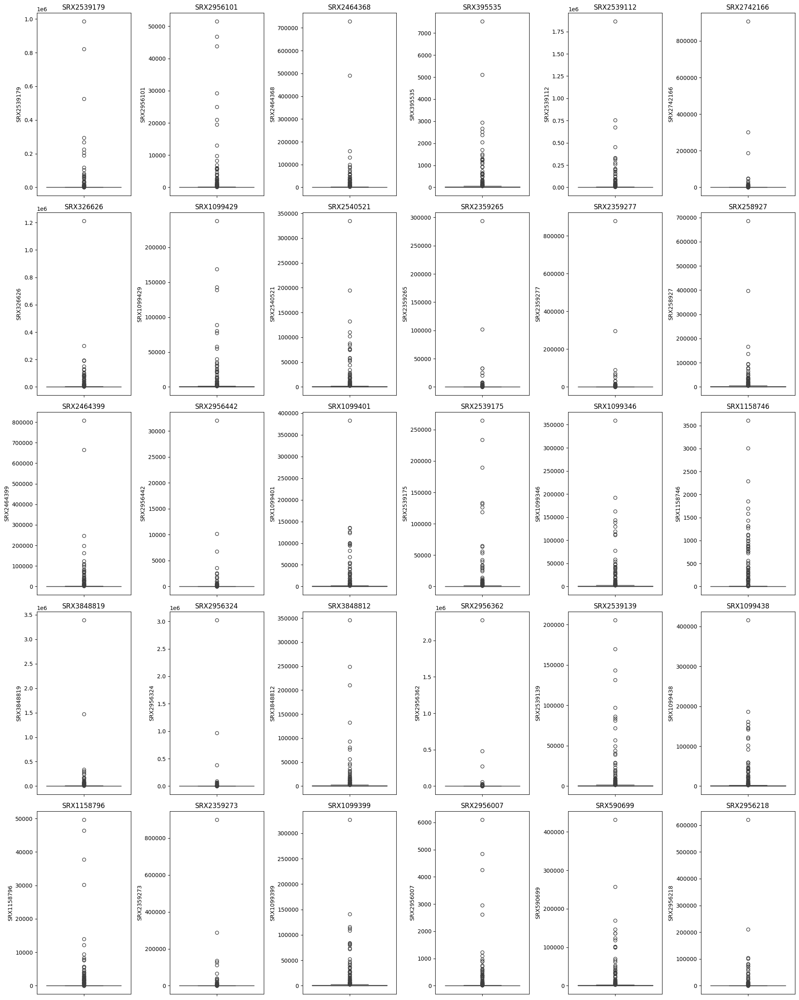

In [83]:
# Visualización de datos

# Seleccionar aleatoriamente 30 miRNAs (columnas) excluyendo la primera columna 'name'
selected_miRNA = np.random.choice(mirna_filtered.columns[1:], 30, replace=False)

# Crear boxplots para los miRNAs seleccionados
num_plots = len(selected_miRNA)
num_cols = 6  # Número de plots por fila
num_rows = (num_plots // num_cols) + (num_plots % num_cols > 0)

plt.figure(figsize=(20, num_rows * 5))

for i, miRNA in enumerate(selected_miRNA):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.boxplot(y=miRNA, data=mirna_filtered)
    plt.title(miRNA)
    plt.xticks(rotation=90)

plt.tight_layout()
plt.show()

El análisis descriptivo (*2.1. miRNA - Estadísticas descriptivas*) indica que una gran cantidad de los miRNA tienen muchos valores de expresión iguales a 0 en la mayoría de las muestras. Esto sugiere que muchos miRNA están expresados en niveles extremadamente bajos o no están expresados en muchas de las muestras.

Además, se han identificado un gran número de outliers en casi todas las columnas (miRNA). El hecho de que 414 de las 414 columnas tengan outliers indica que hay una gran variabilidad en la expresión de los miRNA entre las muestras. Esto puede ser normal en datos de RNA-seq, especialmente si los niveles de expresión varían considerablemente entre diferentes muestras, lo cual es común en estudios de cáncer donde la heterogeneidad entre muestras es alta.

### 3.3.2. Justificación de normalización con TMM

El método TMM es especialmente adecuado para abordar las diferencias en la composición de las librerías de secuenciación, una característica común en datasets donde existen múltiples experimentos con variaciones en la abundancia de algunos miRNAs. Estas variaciones pueden introducir sesgos que distorsionan los resultados de análisis comparativos si no se corrigen adecuadamente.

Una de las principales ventajas de TMM frente a otros métodos, como Reads Per Million (RPM), CPM (Counts Per Million) o TPM (Transcripts Per Million), es su capacidad para manejar la presencia de genes altamente expresados que podrían dominar la librería y ocultar diferencias sutiles en genes menos expresados pero biológicamente relevantes. TMM logra esto ajustando los conteos de lectura al excluir las regiones extremas de expresión (genes con alta y baja variación) y calculando un factor de normalización basado en el promedio ponderado del resto de los genes.

### 3.3.3. Importación de dataset miRNA tratado con R

El tratamiento se ha realizado en R. A continuación, ser importa el csv.

In [84]:
# Leer los datos
mirna_tmm = pd.read_csv(mirna_path_TMM, dtype=str)

# Convertir los datos a numérico
columns_to_convert = mirna_tmm.columns[1:]
mirna_tmm[columns_to_convert] = mirna_tmm[columns_to_convert].apply(pd.to_numeric)

In [85]:
mirna_tmm.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 415 entries, 0 to 414
Columns: 1557 entries, name to SRX1704775
dtypes: float64(1556), object(1)
memory usage: 4.9+ MB


In [86]:
mirna_tmm.head()

,name,SRX258926,SRX258927,SRX258928,SRX258929,SRX258930,SRX258931,SRX258932,SRX258933,SRX258934,...,SRX1704766,SRX1704767,SRX1704768,SRX1704769,SRX1704770,SRX1704771,SRX1704772,SRX1704773,SRX1704774,SRX1704775
0,hsa-miR-99b-3p,134.969886,129.929298,426.002801,412.242656,52.177586,67.221350,182.980390,137.874798,517.940841,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000
1,hsa-miR-136-5p,496.273890,361.574675,47.913455,53.862021,148.348039,122.852813,80.175153,160.477224,36.049107,...,0.000000,0.000000,0.000000,181.487265,0.000000,0.000000,0.000000,0.0,0.0,0.000000
2,hsa-miR-106b-5p,110.052369,74.987766,29.175025,30.311960,10.230899,18.543821,15.517772,20.342183,18.024553,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000
3,hsa-miR-29a-3p,26157.683117,21109.798643,3979.188744,3652.358009,2896.367567,3673.994496,7768.584414,14243.295429,3603.850393,...,835.283152,414.069074,0.000000,181.487265,0.000000,0.000000,0.000000,0.0,0.0,0.000000
4,hsa-miR-26a-5p,7532.877011,7609.402138,3491.752355,3369.757275,4467.833686,5136.638362,7411.029093,8416.390015,3874.218693,...,1252.924728,3312.552594,1637.922104,2903.796243,1976.679587,7215.295448,1380.851454,0.0,0.0,1388.433821


### 3.3.4. Identificación de outliers y valores de expresión extremos

Se vuelven a identificar los outliers para ver si se ha reducido el sesgo tras la normalización TMM

In [87]:
# Identificación de outliers usando el criterio de Tukey

# Detectar outliers en todas las columnas (excepto la primera columna que contiene los nombres de los miRNAs)
outliers = detect_outliers(mirna_tmm.iloc[:, 1:])

# Contar el número de outliers por columna
outlier_counts = outliers.sum()

# Filtrar las columnas que tienen al menos un outlier
columns_with_outliers = outlier_counts[outlier_counts > 0]

# Imprimir el total de columnas que tienen outliers
total_columns_with_outliers = columns_with_outliers.count()
print(f"Total de columnas que tienen outliers: {total_columns_with_outliers}")

# Imprimir el nombre de las columnas con el total de outliers en cada columna
for column, count in columns_with_outliers.items():
    print(f"Columna {column} tiene {count} outliers")

Total de columnas que tienen outliers: 1556
Columna SRX258926 tiene 65 outliers
Columna SRX258927 tiene 66 outliers
Columna SRX258928 tiene 77 outliers
Columna SRX258929 tiene 79 outliers
Columna SRX258930 tiene 75 outliers
Columna SRX258931 tiene 74 outliers
Columna SRX258932 tiene 68 outliers
Columna SRX258933 tiene 74 outliers
Columna SRX258934 tiene 70 outliers
Columna SRX258935 tiene 66 outliers
Columna SRX258936 tiene 71 outliers
Columna SRX258937 tiene 73 outliers
Columna SRX258938 tiene 74 outliers
Columna SRX258939 tiene 76 outliers
Columna SRX3292413 tiene 67 outliers
Columna SRX3292414 tiene 53 outliers
Columna SRX3292415 tiene 72 outliers
Columna SRX3292416 tiene 82 outliers
Columna SRX3292417 tiene 76 outliers
Columna SRX3292418 tiene 72 outliers
Columna SRX3292419 tiene 67 outliers
Columna SRX3292420 tiene 74 outliers
Columna SRX3292421 tiene 74 outliers
Columna SRX3292422 tiene 65 outliers
Columna SRX3292423 tiene 79 outliers
Columna SRX3292424 tiene 75 outliers
Columna 

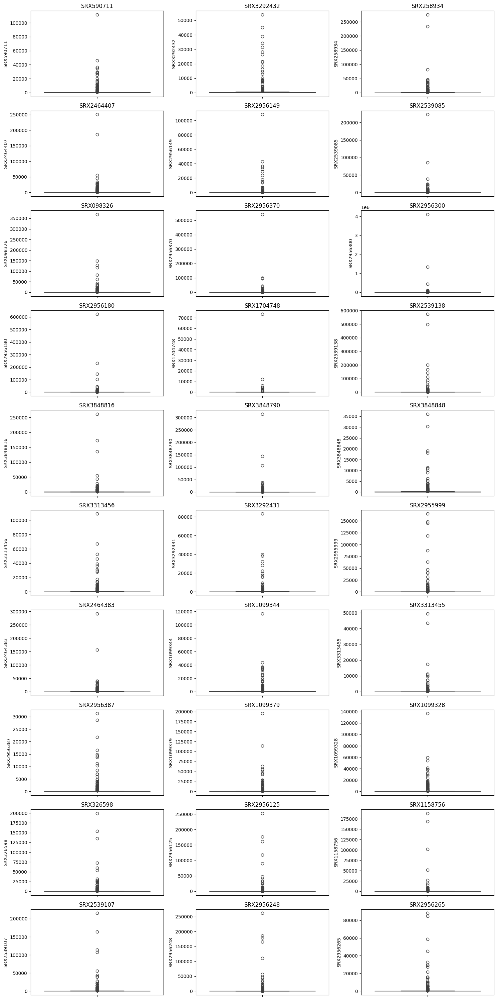

In [88]:
# Visualización de datos

# Seleccionar aleatoriamente 30 columnas excluyendo la primera columna 'name'
selected_col = np.random.choice(mirna_tmm.columns[1:], 30, replace=False)

# Crear boxplots para los miRNAs seleccionados
num_plots = len(selected_col)
num_cols = 3  # Número de plots por fila
num_rows = (num_plots // num_cols) + (num_plots % num_cols > 0)

plt.figure(figsize=(15, num_rows * 3))

for i, col in enumerate(selected_col):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.boxplot(y=col, data=mirna_tmm)
    plt.title(col)
    plt.xticks(rotation=90)

plt.tight_layout()
plt.show()

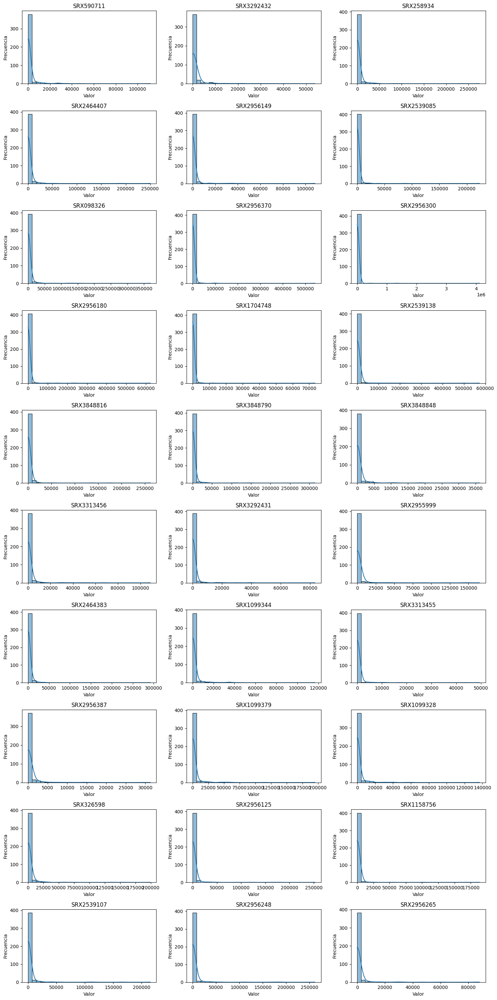

In [89]:
plt.figure(figsize=(15, num_rows * 3))

for i, col in enumerate(selected_col):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.histplot(mirna_tmm[col], bins=30, kde=True)  # Histograma con 30 bins
    plt.title(col)
    plt.xlabel("Valor")
    plt.ylabel("Frecuencia")

plt.tight_layout()
plt.show()

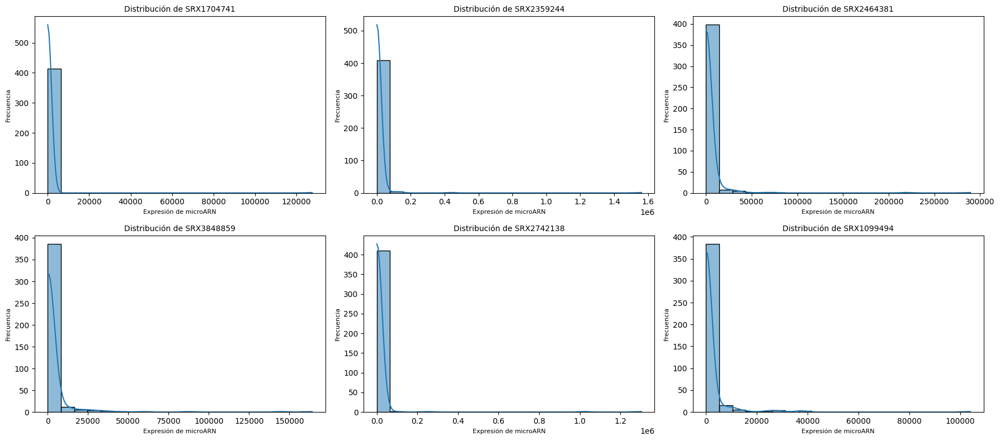

In [90]:
# Gráfico con 6 diagramas para la memoria

# Visualización de datos

selected_col_six = ['SRX1704741', 'SRX2359244', 'SRX2464381', 'SRX3848859', 'SRX2742138', 'SRX1099494']

# Crear boxplots para los miRNAs seleccionados
num_plots_six = len(selected_col_six)
num_cols_six = 3  # Número de plots por fila
num_rows_six = (num_plots_six // num_cols_six) + (num_plots_six % num_cols_six > 0)

# Crear la figura con tamaño ajustado
fig, axs = plt.subplots(num_rows_six, num_cols_six, figsize=(3 * num_cols_six * 2, 4 * num_rows_six))

# Aplanar axs si es necesario
axs = axs.flatten()

# Crear histogramas
for i, column in enumerate(selected_col_six):
    sns.histplot(mirna_tmm[column], bins=20, kde=True, ax=axs[i])
    axs[i].set_title(f'Distribución de {column}', fontsize=10)
    axs[i].set_xlabel('Expresión de microARN', fontsize=8)
    axs[i].set_ylabel('Frecuencia', fontsize=8)

# Ajustar el diseño
plt.tight_layout()

# Mostrar los plots
plt.show()

## 3.4. miRNA - Transformación de Datos: Estandarización de Datos (log(x+1))

Existen ciertos algoritmos que son sensibles a la escala, como los basados en distancias, que son frecuentes en modelos de clasificación o análisis estadísticos. Aunque se haya realizado un previa normalización con TMM, siguen existiendo ciertas razones por las cuales es necesario estandarizar los datos con **log(x+1)**:

 - Los datos siguen una distribución altamente sesgada, donde hay un pequeño número de genes o miRNAs con alta expresión y muchos con baja o nula expresión. Esto puede resultar en una distribución con una cola larga hacia la derecha- Una transformación log2 ayuda a que los datos se distribuyan de una manera más cercana a la normalidad, lo cual es una suposición subyacente en muchos modelos estadísticos.
 - Aún habiendo normalizado el dataset, sigue habiendo una alta cantidad de valores extremadamente altos debido a la alta expresión de ciertos miRNAs en algunas muestras. 

Es por ello que se va a realizar una copia del dataset para estandarizarlo con **log2**

In [91]:
# Aplicar la transformación logarítmica log(x + 1) a las columnas de expresión
# La columna 'name' no debe ser transformada, por lo que se excluye
mirna_tmm_log2 = mirna_tmm.copy()
mirna_tmm_log2.iloc[:, 1:] = np.log2(mirna_tmm.iloc[:, 1:] + 1)

selected_mirna_raw_log2 = selected_mirna_raw.applymap(lambda x: np.log2(x + 1))

mirna_tmm_log2.head()

C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\670269482.py:6: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  selected_mirna_raw_log2 = selected_mirna_raw.applymap(lambda x: np.log2(x + 1))


,name,SRX258926,SRX258927,SRX258928,SRX258929,SRX258930,SRX258931,SRX258932,SRX258933,SRX258934,...,SRX1704766,SRX1704767,SRX1704768,SRX1704769,SRX1704770,SRX1704771,SRX1704772,SRX1704773,SRX1704774,SRX1704775
0,hsa-miR-99b-3p,7.087143,7.032644,8.738102,8.690845,5.732746,6.092151,7.523408,7.117641,9.019426,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000
1,hsa-miR-136-5p,8.957897,8.502134,5.612159,5.777736,7.222534,6.952483,6.342966,7.335187,5.211367,...,0.000000,0.000000,0.000000,7.511652,0.000000,0.000000,0.000000,0.0,0.0,0.000000
2,hsa-miR-106b-5p,6.795096,6.247695,4.915283,4.968642,3.489402,4.288641,4.045947,4.415636,4.249791,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000
3,hsa-miR-29a-3p,14.675002,14.365694,11.958621,11.835007,11.500527,11.843526,12.923622,13.798097,11.815724,...,9.707848,8.697208,0.000000,7.511652,0.000000,0.000000,0.000000,0.0,0.0,0.000000
4,hsa-miR-26a-5p,12.879177,12.893757,11.770149,11.718857,12.125683,12.326890,12.855653,13.039157,11.920062,...,10.292235,11.694163,10.678532,11.504221,10.949593,12.817043,10.432387,0.0,0.0,10.440281


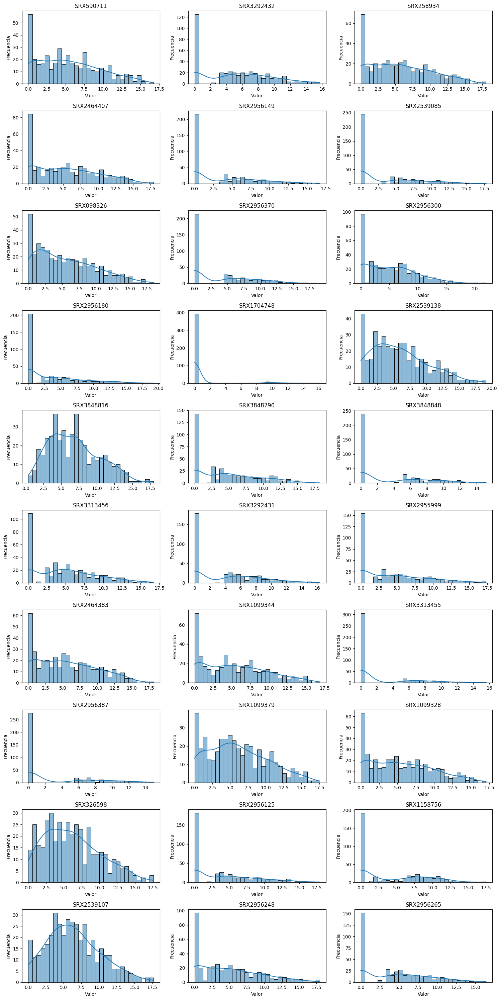

In [92]:
plt.figure(figsize=(15, num_rows * 3))

for i, col in enumerate(selected_col):
    plt.subplot(num_rows, num_cols, i + 1)
    sns.histplot(mirna_tmm_log2[col], bins=30, kde=True)  # Histograma con 30 bins
    plt.title(col)
    plt.xlabel("Valor")
    plt.ylabel("Frecuencia")

plt.tight_layout()
plt.show()

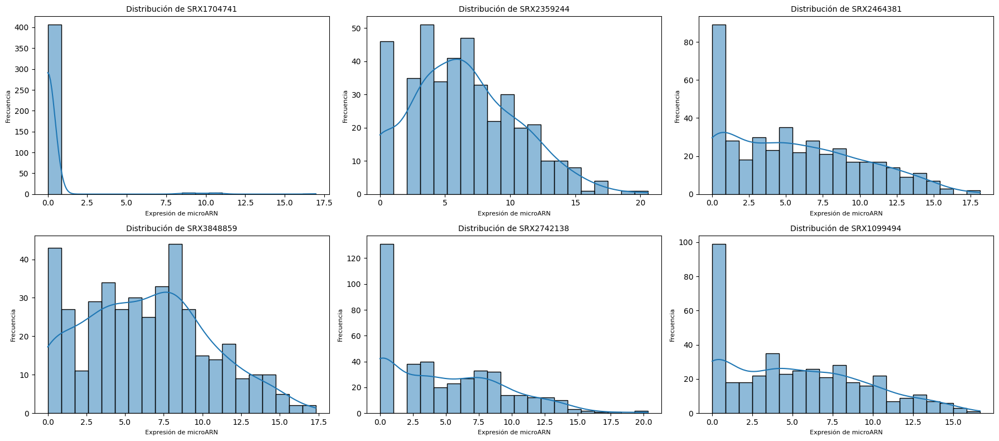

In [93]:
#  Gráfico con 6 diagramas para la memoria

# Visualización de datos

selected_col_six = ['SRX1704741', 'SRX2359244', 'SRX2464381', 'SRX3848859', 'SRX2742138', 'SRX1099494']

# Crear boxplots para los miRNAs seleccionados
num_plots = len(selected_col_six)
num_cols = 3  # Número de plots por fila
num_rows = (num_plots // num_cols) + (num_plots % num_cols > 0)

# Crear la figura con tamaño ajustado
fig, axs = plt.subplots(num_rows, num_cols, figsize=(3 * num_cols * 2, 4 * num_rows))

# Aplanar axs si es necesario
axs = axs.flatten()

# Crear histogramas
for i, column in enumerate(selected_col_six):
    sns.histplot(mirna_tmm_log2[column], bins=20, kde=True, ax=axs[i])
    axs[i].set_title(f'Distribución de {column}', fontsize=10)
    axs[i].set_xlabel('Expresión de microARN', fontsize=8)
    axs[i].set_ylabel('Frecuencia', fontsize=8)

# Ajustar el diseño
plt.tight_layout()

# Mostrar los plots
plt.show()

## 3.5. miRNA & metaData - Integración de Datos

Es necesario integrar los datasets para poder realizar la división train/test de manera correcta.

In [94]:
# Transponer miRNA_RPMadjLib para que las columnas de experimentos sean filas
mirna_t = mirna_tmm_log2.set_index('name').T.reset_index()
mirna_t.rename(columns={'index': 'Experiment'}, inplace=True)
mirna_t.head()

name,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,SRX258926,7.087143,8.957897,6.795096,14.675002,12.879177,11.637191,13.451060,13.499718,5.544798,...,4.934967,12.929868,4.095297,6.041974,9.939003,4.859582,1.354647,0.000000,14.897702,2.040784
1,SRX258927,7.032644,8.502134,6.247695,14.365694,12.893757,11.712430,13.279547,13.500263,4.672479,...,5.195259,12.389323,3.361862,5.485579,10.011601,5.024774,1.847430,0.000000,14.840534,1.079757
2,SRX258928,8.738102,5.612159,4.915283,11.958621,11.770149,8.995084,15.114476,10.987242,5.783471,...,6.546990,11.568479,2.029820,1.753585,8.053709,5.024452,4.037180,1.128278,13.440193,2.261568
3,SRX258929,8.690845,5.777736,4.968642,11.835007,11.718857,8.715062,14.966864,10.720282,5.715079,...,6.614684,11.511082,2.169134,1.631579,7.842385,5.000517,3.635206,1.262441,13.441460,1.833845
4,SRX258930,5.732746,7.222534,3.489402,11.500527,12.125683,9.448627,13.305414,11.878414,5.317500,...,6.951527,17.801725,4.675486,4.118479,8.416540,3.351601,4.201048,0.000000,18.105945,3.028857


In [95]:
mirna_t.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1556 entries, 0 to 1555
Columns: 416 entries, Experiment to hsa-miR-1304-3p
dtypes: float64(415), object(1)
memory usage: 4.9+ MB


In [96]:
metadata_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1606 entries, 0 to 1605
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   SRP         1606 non-null   object
 1   Experiment  1606 non-null   object
 2   Sample      1606 non-null   object
 3   Instrument  1606 non-null   object
 4   Sex         1130 non-null   object
 5   Fluid       1603 non-null   object
 6   Extraction  1518 non-null   object
 7   Library     1397 non-null   object
 8   Healthy     1603 non-null   object
 9   Cancer      1578 non-null   object
 10  Exosome     1606 non-null   object
 11  Desc        1033 non-null   object
dtypes: object(12)
memory usage: 150.7+ KB


In [97]:
# Combinar los datasets utilizando 'Experiment' como clave
# Utilizar 'inner' para quedarse con las filas que tengan datos en ambos datasets
mirna_metadata = pd.merge(mirna_t, metadata_raw, on='Experiment', how='inner')
mirna_metadata.head()

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,Sample,Instrument,Sex,Fluid,Extraction,Library,Healthy,Cancer,Exosome,Desc
0,SRX258926,7.087143,8.957897,6.795096,14.675002,12.879177,11.637191,13.451060,13.499718,5.544798,...,SAMN01997249,Illumina HiSeq 2000,NaN,plasma,miRNeasy,NEXTflex,True,False,True,NaN
1,SRX258927,7.032644,8.502134,6.247695,14.365694,12.893757,11.712430,13.279547,13.500263,4.672479,...,SAMN01997250,Illumina HiSeq 2000,NaN,plasma,miRNeasy,NEXTflex,True,False,True,NaN
2,SRX258928,8.738102,5.612159,4.915283,11.958621,11.770149,8.995084,15.114476,10.987242,5.783471,...,SAMN01997251,Illumina HiSeq 2000,NaN,plasma,miRNeasy,NEBNext,True,False,True,NaN
3,SRX258929,8.690845,5.777736,4.968642,11.835007,11.718857,8.715062,14.966864,10.720282,5.715079,...,SAMN01997252,Illumina HiSeq 2000,NaN,plasma,miRNeasy,NEBNext,True,False,True,NaN
4,SRX258930,5.732746,7.222534,3.489402,11.500527,12.125683,9.448627,13.305414,11.878414,5.317500,...,SAMN01997253,Illumina HiSeq 2000,NaN,plasma,miRNeasy,Illumina,True,False,True,NaN


In [98]:
mirna_metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1556 entries, 0 to 1555
Columns: 427 entries, Experiment to Desc
dtypes: float64(415), object(12)
memory usage: 5.1+ MB


## 3.6. miRNA & metaData - División de Datos

Dividir los datos antes de realizar ciertos pasos en el preprocesamiento es crucial para evitar la fuga de información (data leakage) y asegurar que el modelo se evalúe de manera precisa con datos no vistos, reflejando así su verdadero desempeño en un entorno de producción.

Es importante realizar una estratificación de los datos para asegurar que las proporciones de las clases se mantengan consistentes en ambos conjuntos.

### 3.6.1. División de Datos

In [99]:
# Eliminar filas con nulos en columnas con un porcentaje de nulos inferior al 5%
drop_rows = ['Cancer']
mirna_metadata = mirna_metadata.dropna(subset=drop_rows) #Se eliminan todas las filas de mirna_metadata donde la columna 'Cancer' tenga valores nulos
mirna_metadata.reset_index(drop=True, inplace=True)
mirna_metadata.head()

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,Sample,Instrument,Sex,Fluid,Extraction,Library,Healthy,Cancer,Exosome,Desc
0,SRX258926,7.087143,8.957897,6.795096,14.675002,12.879177,11.637191,13.451060,13.499718,5.544798,...,SAMN01997249,Illumina HiSeq 2000,NaN,plasma,miRNeasy,NEXTflex,True,False,True,NaN
1,SRX258927,7.032644,8.502134,6.247695,14.365694,12.893757,11.712430,13.279547,13.500263,4.672479,...,SAMN01997250,Illumina HiSeq 2000,NaN,plasma,miRNeasy,NEXTflex,True,False,True,NaN
2,SRX258928,8.738102,5.612159,4.915283,11.958621,11.770149,8.995084,15.114476,10.987242,5.783471,...,SAMN01997251,Illumina HiSeq 2000,NaN,plasma,miRNeasy,NEBNext,True,False,True,NaN
3,SRX258929,8.690845,5.777736,4.968642,11.835007,11.718857,8.715062,14.966864,10.720282,5.715079,...,SAMN01997252,Illumina HiSeq 2000,NaN,plasma,miRNeasy,NEBNext,True,False,True,NaN
4,SRX258930,5.732746,7.222534,3.489402,11.500527,12.125683,9.448627,13.305414,11.878414,5.317500,...,SAMN01997253,Illumina HiSeq 2000,NaN,plasma,miRNeasy,Illumina,True,False,True,NaN


In [100]:
mirna_metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1528 entries, 0 to 1527
Columns: 427 entries, Experiment to Desc
dtypes: float64(415), object(12)
memory usage: 5.0+ MB


In [101]:
# Dividir en variables predictoras (X) y la variable objetivo (Cancer)
X = mirna_metadata.drop(columns=['Cancer'])
y_cancer = mirna_metadata['Cancer']

In [102]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1528 entries, 0 to 1527
Columns: 426 entries, Experiment to Desc
dtypes: float64(415), object(11)
memory usage: 5.0+ MB


In [103]:
# Dividir en conjuntos de entrenamiento y prueba utilizando la combinación para la estratificación
X_train, X_test, y_cancer_train, y_cancer_test = train_test_split(
    X, y_cancer, test_size=0.2, stratify=y_cancer, random_state=42)

In [104]:
# Resetear los índices
X_train = X_train.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)
y_cancer_train = y_cancer_train.reset_index(drop=True)
y_cancer_test = y_cancer_test.reset_index(drop=True)

In [105]:
X_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1222 entries, 0 to 1221
Columns: 426 entries, Experiment to Desc
dtypes: float64(415), object(11)
memory usage: 4.0+ MB


In [106]:
X_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 306 entries, 0 to 305
Columns: 426 entries, Experiment to Desc
dtypes: float64(415), object(11)
memory usage: 1018.5+ KB


In [107]:
y_cancer_train.info()

<class 'pandas.core.series.Series'>
RangeIndex: 1222 entries, 0 to 1221
Series name: Cancer
Non-Null Count  Dtype 
--------------  ----- 
1222 non-null   object
dtypes: object(1)
memory usage: 9.7+ KB


In [108]:
# Verificar las distribuciones

print("Distribución de Cancer en el conjunto de entrenamiento:")
print(y_cancer_train.value_counts())

print("Distribución de Cancer en el conjunto de prueba:")
print(y_cancer_test.value_counts())

Distribución de Cancer en el conjunto de entrenamiento:
Cancer
False    828
True     394
Name: count, dtype: int64
Distribución de Cancer en el conjunto de prueba:
Cancer
False    207
True      99
Name: count, dtype: int64


### 3.6.2. Obtener los dataset miRNA y metadata por separado

In [109]:
len(X_train.columns)

426

In [110]:
X_train.columns[416]

'SRP'

In [111]:
X_train_mirna = X_train.iloc[:, 0:416]
X_train_mirna

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,SRX2539128,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,...,6.005777,17.179671,6.417664,5.181464,5.163893,1.608804,9.413083,5.431997,8.970077,4.726746
1,SRX2956350,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,...,5.619158,21.638673,8.028001,7.752329,5.808130,0.000000,6.898628,0.000000,6.431232,7.010611
2,SRX2956137,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,...,4.446213,9.880981,8.303605,4.234808,3.987018,0.000000,0.000000,0.000000,5.510013,4.234808
3,SRX2956358,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,...,6.265335,22.112450,7.819897,8.196934,7.201842,0.000000,8.684904,0.000000,7.057034,6.790068
4,SRX2540517,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,...,5.549404,15.776228,6.302500,1.523648,7.796886,0.581466,7.945661,3.831523,11.516693,4.242178
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1217,SRX1099428,8.827399,6.430007,4.795648,12.210311,12.044808,9.567880,14.989831,10.828011,5.329763,...,4.607618,12.215811,3.483049,1.528808,8.277136,4.040969,3.382302,1.528808,14.302153,1.863804
1218,SRX2742164,0.000000,0.000000,10.422585,8.395104,13.685238,0.000000,15.676119,0.000000,4.605249,...,4.731330,19.855109,7.301135,9.476362,4.790466,0.000000,0.000000,4.143339,7.455272,5.931135
1219,SRX3848863,4.822627,8.008994,5.293413,8.581847,9.219401,3.575214,7.265556,5.481453,0.000000,...,0.000000,11.415107,6.274901,10.191495,0.000000,5.293413,3.575214,0.000000,11.894188,0.000000
1220,SRX1099330,8.945555,6.509042,4.719664,12.203863,12.241571,9.157081,15.328120,10.992907,5.182185,...,4.534820,10.872326,1.490892,0.930028,8.054220,4.074076,2.875228,0.000000,14.130256,0.000000


In [112]:
X_test_mirna = X_test.iloc[:, 0:416]
X_test_mirna

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,SRX2956186,1.298593,0.000000,9.753325,13.251531,16.628147,0.000000,13.575523,0.000000,2.773903,...,4.562443,8.678667,8.515591,4.950829,6.121322,0.000000,2.217145,0.000000,5.508639,4.690312
1,SRX2539186,6.581866,3.153727,6.207865,9.376254,15.809010,4.824996,15.264243,3.717331,3.153727,...,8.440302,16.716829,6.572685,4.171074,7.040518,0.000000,10.295795,6.231392,11.607654,6.195957
2,SRX2359242,1.331169,2.967592,11.257569,9.971639,14.384357,2.077803,13.138590,7.408132,4.318376,...,6.566915,21.570470,8.795874,7.754234,7.084705,2.740980,12.038622,3.735309,9.583780,7.003934
3,SRX2956288,1.256379,1.256379,9.161270,13.537516,16.921110,0.000000,14.035791,3.422594,2.161045,...,5.438396,10.139726,8.892779,4.914949,5.692004,0.000000,1.624537,1.256379,7.401421,5.672492
4,SRX2956220,3.656580,0.000000,9.035993,14.846308,17.849155,0.000000,14.030891,1.293572,2.210499,...,6.436781,11.673218,8.286848,3.480187,4.976280,0.000000,4.722383,1.293572,11.000083,3.480187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
301,SRX1099479,9.026138,7.399957,5.103071,11.684183,10.723401,8.255027,15.163786,10.554954,4.997139,...,2.635530,11.159793,2.714056,1.257258,7.108057,4.279689,2.162218,1.453129,13.303094,0.761460
302,SRX098326,6.792578,1.374152,10.606113,13.632616,14.039061,8.980584,13.009725,0.213149,2.733820,...,9.680608,6.368034,4.691401,2.663053,8.241049,0.308970,0.000000,0.483404,11.629698,1.460150
303,SRX326620,3.583996,2.653616,12.194899,11.088127,12.702208,3.315626,12.169305,3.255396,1.944771,...,7.819720,15.249569,6.491107,5.503824,5.741929,3.285825,8.723020,3.285825,10.891292,7.246352
304,SRX1169939,0.000000,0.000000,8.972269,7.221663,13.733764,0.000000,11.827071,0.000000,5.438272,...,5.930953,23.301666,5.753530,13.040197,7.255385,0.000000,0.000000,4.684237,10.921054,5.438272


In [113]:
X_train_metadata = X_train.iloc[:, [0] + list(range(416 , X_train.shape[1]))]
X_train_metadata

,Experiment,SRP,Sample,Instrument,Sex,Fluid,Extraction,Library,Healthy,Exosome,Desc
0,SRX2539128,SRP098894,SAMN06298928,NextSeq 500,female,serum,miRCURY,NEBNext,False,False,Serous
1,SRX2956350,SRP110505,SAMN07277544,Illumina HiSeq 2000,NaN,whole blood,PAXgene,Illumina,True,False,NaN
2,SRX2956137,SRP110505,SAMN07277628,Illumina HiSeq 2000,NaN,blood cells,mirVana,Illumina,True,False,NaN
3,SRX2956358,SRP110505,SAMN07277535,Illumina HiSeq 2000,NaN,whole blood,PAXgene,Illumina,True,False,NaN
4,SRX2540517,SRP098923,SAMN06308183,Illumina HiSeq 2000,NaN,serum,miRNeasy,NEBNext,False,False,Multiple myeloma patient
...,...,...,...,...,...,...,...,...,...,...,...
1217,SRX1099428,SRP061240,SAMN03863389,Illumina Genome Analyzer,male,plasma,miRNeasy,NEBNext,False,True,Colorectal Cancer
1218,SRX2742164,SRP104148,SAMN06760290,Illumina HiSeq 2000,male,whole blood,PAXgene,Illumina,True,False,NaN
1219,SRX3848863,SRP136488,SAMN08796599,Illumina HiSeq 4000,NaN,amniotic fluid,miRNeasy,NaN,True,False,NaN
1220,SRX1099330,SRP061240,SAMN03863441,Illumina Genome Analyzer,female,plasma,miRNeasy,NEBNext,False,True,Colorectal Cancer


In [114]:
X_test_metadata = X_test.iloc[:, [0] + list(range(416 , X_test.shape[1]))]
X_test_metadata

,Experiment,SRP,Sample,Instrument,Sex,Fluid,Extraction,Library,Healthy,Exosome,Desc
0,SRX2956186,SRP110505,SAMN07277844,Illumina HiSeq 2000,male,blood cells,mirVana,Illumina,True,False,Age: 46
1,SRX2539186,SRP098894,SAMN06299027,NextSeq 500,female,serum,miRCURY,NEBNext,False,False,Endo-Clear Cell
2,SRX2359242,SRP093728,SAMN06036065,Illumina HiSeq 2000,NaN,serum,miRNeasy,Illumina,False,False,Accidental acetaminophen overdose
3,SRX2956288,SRP110505,SAMN07277750,Illumina HiSeq 2000,male,blood cells,mirVana,Illumina,True,False,Age: 27
4,SRX2956220,SRP110505,SAMN07277424,Illumina HiSeq 2000,male,blood cells,mirVana,Illumina,True,False,Age: 63
...,...,...,...,...,...,...,...,...,...,...,...
301,SRX1099479,SRP061240,SAMN03863572,Illumina Genome Analyzer,female,plasma,miRNeasy,NEBNext,False,True,Colorectal Cancer
302,SRX098326,SRP008339,SAMN00723073,Illumina Genome Analyzer II,female,breast milk,TRIzol,Illumina,True,True,"Healthy women (30 +--0.9 years old, primiparit..."
303,SRX326620,SRP027589,SAMN02260846,Illumina HiSeq 2500,female,serum,TRIzol,Illumina,False,False,NaN
304,SRX1169939,SRP062974,SAMN04017996,Illumina HiSeq 2000,female,whole blood,PAXgene,Illumina,False,False,Breast cancer


### 3.6.3. Resumen variables: División de Datos
- X_train
- X_test
- X_train_mirna
- X_test_mirna
- X_train_metadata
- X_test_metadata
- y_cancer_train
- y_cancer_test


## 3.7. miRNA - Limpieza de Datos: Missing Data

In [115]:
X_train_mirna.isnull().sum()

Experiment         0
hsa-miR-99b-3p     0
hsa-miR-136-5p     0
hsa-miR-106b-5p    0
hsa-miR-29a-3p     0
                  ..
hsa-miR-376a-3p    0
hsa-miR-486-3p     0
hsa-miR-1304-5p    0
hsa-miR-99b-5p     0
hsa-miR-1304-3p    0
Length: 416, dtype: int64

In [116]:
# Identificar columnas con valores nulos
null_columns = X_train_mirna.columns[X_train_mirna.isnull().any()]

# Imprimir nombres de columnas con valores nulos
print("Columnas con valores nulos:")
for column in null_columns:
  print(column)

Columnas con valores nulos:


Sin valores nulos.

## 3.8. metaData - Limpieza de Datos: Missing Data

### 3.8.1. Identificación

#### 3.8.1.1. Train

In [117]:
X_train_metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1222 entries, 0 to 1221
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Experiment  1222 non-null   object
 1   SRP         1222 non-null   object
 2   Sample      1222 non-null   object
 3   Instrument  1222 non-null   object
 4   Sex         856 non-null    object
 5   Fluid       1220 non-null   object
 6   Extraction  1148 non-null   object
 7   Library     1048 non-null   object
 8   Healthy     1220 non-null   object
 9   Exosome     1222 non-null   object
 10  Desc        787 non-null    object
dtypes: object(11)
memory usage: 105.1+ KB


In [118]:
null_values = X_train_metadata.isnull().sum()
cols_null = null_values[null_values > 0]
cols_null

Sex           366
Fluid           2
Extraction     74
Library       174
Healthy         2
Desc          435
dtype: int64

In [119]:
y_cancer_train.isnull().sum()

np.int64(0)

<Axes: >

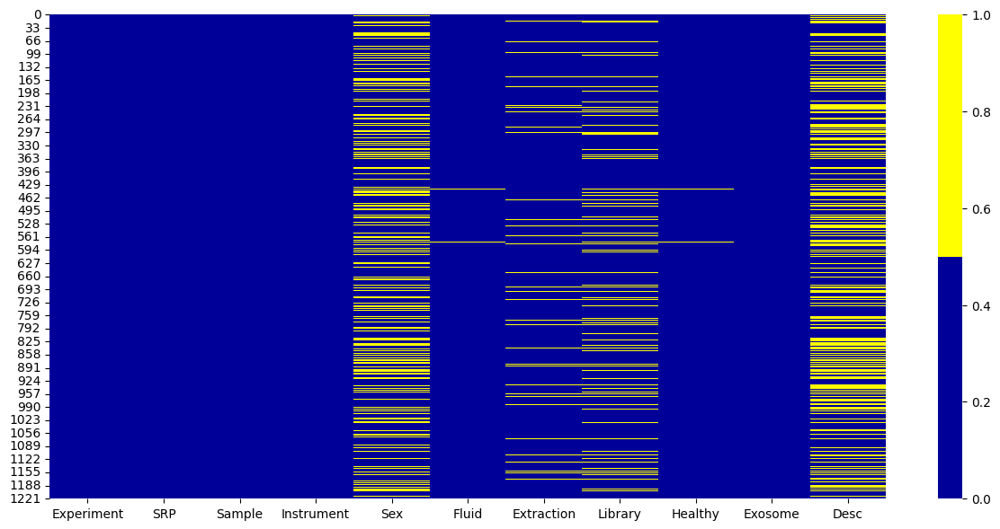

In [120]:
cols = X_train_metadata.columns
colours = ['#000099', '#ffff00']
plt.figure(figsize=(15,7))
sns.heatmap(X_train_metadata[cols].isnull(), cmap=sns.color_palette(colours))

#### 3.8.1.2. Test

In [121]:
X_test_metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 306 entries, 0 to 305
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Experiment  306 non-null    object
 1   SRP         306 non-null    object
 2   Sample      306 non-null    object
 3   Instrument  306 non-null    object
 4   Sex         211 non-null    object
 5   Fluid       305 non-null    object
 6   Extraction  292 non-null    object
 7   Library     271 non-null    object
 8   Healthy     305 non-null    object
 9   Exosome     306 non-null    object
 10  Desc        196 non-null    object
dtypes: object(11)
memory usage: 26.4+ KB


In [122]:
null_values = X_test_metadata.isnull().sum()
cols_null = null_values[null_values > 0]
cols_null

Sex            95
Fluid           1
Extraction     14
Library        35
Healthy         1
Desc          110
dtype: int64

In [123]:
y_cancer_test.isnull().sum()

np.int64(0)

<Axes: >

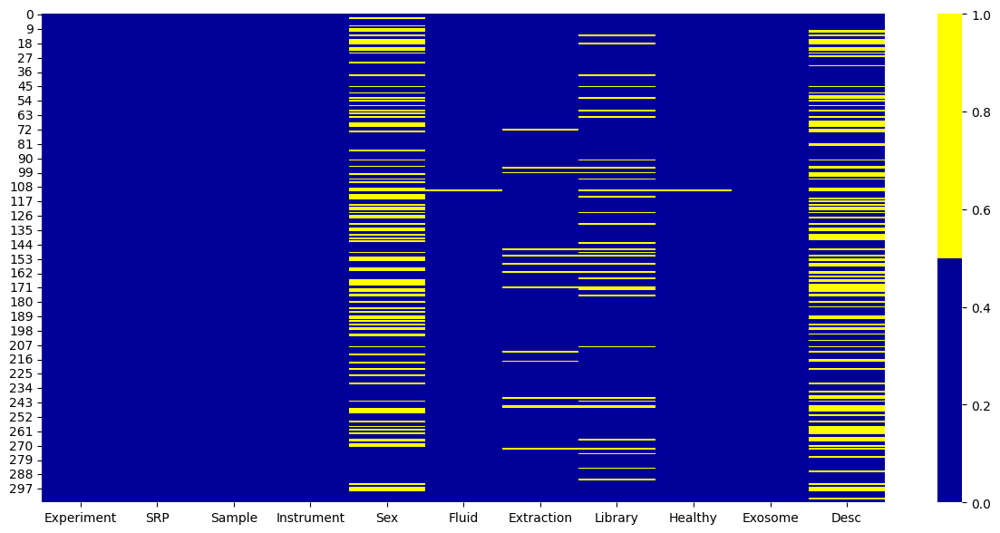

In [124]:
cols = X_test_metadata.columns
colours = ['#000099', '#ffff00']
plt.figure(figsize=(15,7))
sns.heatmap(X_test_metadata[cols].isnull(), cmap=sns.color_palette(colours))

### 3.8.2. Tratamiento

**IMPORTANTE:** Las variable 'Cancer' ha sido tratada en el paso **3.6. Disivión de Datos**. Es la razón por la cual se han reducido los missing values en 'Healthy'

**Train**

- Sex 29,95%: Columna imprescindible con alto porcentaje de valores faltantes. Es probable que los valores faltantes puedan ser estimados a partir de observaciones similares; por lo que se van a inferir a partir de **métodos de clustering (KNN)**.
- Fluid 0,16%: Esta columna es impresndibible. Dado el bajo porcentaje de valores faltantes, las **filas** con valores nulos se van a **eliminar del dataframe**.
- Extraction 6,06%: Columna con un porcentaje moderado de valores faltantes. Esta columna puede ser interesante para realizar ciertos análisis. Es probable que los valores faltantes puedan ser estimados a partir de observaciones similares; por lo que se van a inferir a partir de **métodos de clustering (KNN)**.
- Library 14,24%: Columna con un porcentaje moderado de valores faltantes. Esta columna puede ser interesante para realizar ciertos análisis. Es probable que los valores faltantes puedan ser estimados a partir de observaciones similares; por lo que se van a inferir a partir de **métodos de clustering (KNN)**.
- Healthy 0,16%: Esta columna es impresndibible. Dado el bajo porcentaje de valores faltantes, las **filas** con valores nulos se van a **eliminar del dataframe**. Complete Case Analysis (eliminar todas las ovservaciones que tienen valores faltantes.)
- Desc 35,60%: Columna con alta cantidad de valores faltantes. La información proporcionada por esta columna no es xxx. Esta información no se considera imprescindible para el análisis, por lo que la **columna** se va a **eliminar por completo**.

**Test**

- Sex 31.05%
- Fluid 0.33%
- Extraction 4.58%
- Library 11.44%
- Heatlhy: 0,33%
- Desc: 35,95%

Se aplicarán los mismos criterios que en el dataset train

#### 3.8.2.1. Train

In [125]:
X_train_cleaned = X_train.copy()

# Eliminar la columna Desc
X_train_cleaned = X_train_cleaned.drop('Desc', axis=1)

# Guardar los índices de las filas que tienen nulos en las columnas 'Fluid' o 'Healthy'
rows_to_drop_train = X_train_cleaned[X_train_cleaned[['Fluid', 'Healthy']].isna().any(axis=1)].index

# Eliminar filas con nulos en columnas con un porcentaje de nulos inferior al 5% (Cancer se ha procesado con anterioridad)
drop_rows = ['Fluid', 'Healthy']
X_train_cleaned.dropna(subset=drop_rows, inplace=True)

X_train_cleaned.reset_index(drop=True, inplace=True)

null_values = X_train_cleaned.isnull().sum()
cols_null = null_values[null_values > 0]
cols_null

Sex           364
Extraction     74
Library       172
dtype: int64

#### 3.8.2.2. Test

In [126]:
X_test_cleaned = X_test.copy()

# Eliminar la columna Desc
X_test_cleaned = X_test_cleaned.drop('Desc', axis=1)

# Guardar los índices de las filas que tienen nulos en las columnas 'Fluid' o 'Healthy'
rows_to_drop_test = X_test_cleaned[X_test_cleaned[['Fluid', 'Healthy']].isna().any(axis=1)].index

# Eliminar filas con nulos en columnas con un porcentaje de nulos inferior al 5% (Healthy y Cancer se han procesado con anterioridad)
drop_rows = ['Fluid', 'Healthy']
X_test_cleaned.dropna(subset=drop_rows, inplace=True)

X_test_cleaned.reset_index(drop=True, inplace=True)

null_values = X_test_cleaned.isnull().sum()
cols_null = null_values[null_values > 0]
cols_null

Sex           94
Extraction    14
Library       34
dtype: int64

#### 3.8.2.3. Cancer

In [127]:
# Eliminar las filas de usando los índices guardados

y_cancer_train_cleaned = y_cancer_train.drop(index=rows_to_drop_train)
y_cancer_train_cleaned.reset_index(drop=True, inplace=True)

y_cancer_test_cleaned = y_cancer_test.drop(index=rows_to_drop_test)
y_cancer_test_cleaned.reset_index(drop=True, inplace=True)

#### 3.8.2.4. Obtener mirna y metadata por separado

In [128]:
X_train_cleaned.columns[415:416]

Index(['hsa-miR-1304-3p'], dtype='object')

In [129]:
X_train_mirna_cleaned = X_train_cleaned.iloc[:, 0:416]
X_train_mirna_cleaned

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,SRX2539128,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,...,6.005777,17.179671,6.417664,5.181464,5.163893,1.608804,9.413083,5.431997,8.970077,4.726746
1,SRX2956350,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,...,5.619158,21.638673,8.028001,7.752329,5.808130,0.000000,6.898628,0.000000,6.431232,7.010611
2,SRX2956137,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,...,4.446213,9.880981,8.303605,4.234808,3.987018,0.000000,0.000000,0.000000,5.510013,4.234808
3,SRX2956358,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,...,6.265335,22.112450,7.819897,8.196934,7.201842,0.000000,8.684904,0.000000,7.057034,6.790068
4,SRX2540517,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,...,5.549404,15.776228,6.302500,1.523648,7.796886,0.581466,7.945661,3.831523,11.516693,4.242178
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1215,SRX1099428,8.827399,6.430007,4.795648,12.210311,12.044808,9.567880,14.989831,10.828011,5.329763,...,4.607618,12.215811,3.483049,1.528808,8.277136,4.040969,3.382302,1.528808,14.302153,1.863804
1216,SRX2742164,0.000000,0.000000,10.422585,8.395104,13.685238,0.000000,15.676119,0.000000,4.605249,...,4.731330,19.855109,7.301135,9.476362,4.790466,0.000000,0.000000,4.143339,7.455272,5.931135
1217,SRX3848863,4.822627,8.008994,5.293413,8.581847,9.219401,3.575214,7.265556,5.481453,0.000000,...,0.000000,11.415107,6.274901,10.191495,0.000000,5.293413,3.575214,0.000000,11.894188,0.000000
1218,SRX1099330,8.945555,6.509042,4.719664,12.203863,12.241571,9.157081,15.328120,10.992907,5.182185,...,4.534820,10.872326,1.490892,0.930028,8.054220,4.074076,2.875228,0.000000,14.130256,0.000000


In [130]:
X_test_mirna_cleaned = X_test_cleaned.iloc[:, 0:416]
X_test_mirna_cleaned

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,SRX2956186,1.298593,0.000000,9.753325,13.251531,16.628147,0.000000,13.575523,0.000000,2.773903,...,4.562443,8.678667,8.515591,4.950829,6.121322,0.000000,2.217145,0.000000,5.508639,4.690312
1,SRX2539186,6.581866,3.153727,6.207865,9.376254,15.809010,4.824996,15.264243,3.717331,3.153727,...,8.440302,16.716829,6.572685,4.171074,7.040518,0.000000,10.295795,6.231392,11.607654,6.195957
2,SRX2359242,1.331169,2.967592,11.257569,9.971639,14.384357,2.077803,13.138590,7.408132,4.318376,...,6.566915,21.570470,8.795874,7.754234,7.084705,2.740980,12.038622,3.735309,9.583780,7.003934
3,SRX2956288,1.256379,1.256379,9.161270,13.537516,16.921110,0.000000,14.035791,3.422594,2.161045,...,5.438396,10.139726,8.892779,4.914949,5.692004,0.000000,1.624537,1.256379,7.401421,5.672492
4,SRX2956220,3.656580,0.000000,9.035993,14.846308,17.849155,0.000000,14.030891,1.293572,2.210499,...,6.436781,11.673218,8.286848,3.480187,4.976280,0.000000,4.722383,1.293572,11.000083,3.480187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,SRX1099479,9.026138,7.399957,5.103071,11.684183,10.723401,8.255027,15.163786,10.554954,4.997139,...,2.635530,11.159793,2.714056,1.257258,7.108057,4.279689,2.162218,1.453129,13.303094,0.761460
301,SRX098326,6.792578,1.374152,10.606113,13.632616,14.039061,8.980584,13.009725,0.213149,2.733820,...,9.680608,6.368034,4.691401,2.663053,8.241049,0.308970,0.000000,0.483404,11.629698,1.460150
302,SRX326620,3.583996,2.653616,12.194899,11.088127,12.702208,3.315626,12.169305,3.255396,1.944771,...,7.819720,15.249569,6.491107,5.503824,5.741929,3.285825,8.723020,3.285825,10.891292,7.246352
303,SRX1169939,0.000000,0.000000,8.972269,7.221663,13.733764,0.000000,11.827071,0.000000,5.438272,...,5.930953,23.301666,5.753530,13.040197,7.255385,0.000000,0.000000,4.684237,10.921054,5.438272


In [131]:
X_train_metadata_cleaned = X_train_cleaned.iloc[:, [0] + list(range(416 , X_train_cleaned.shape[1]))]
X_train_metadata_cleaned

,Experiment,SRP,Sample,Instrument,Sex,Fluid,Extraction,Library,Healthy,Exosome
0,SRX2539128,SRP098894,SAMN06298928,NextSeq 500,female,serum,miRCURY,NEBNext,False,False
1,SRX2956350,SRP110505,SAMN07277544,Illumina HiSeq 2000,NaN,whole blood,PAXgene,Illumina,True,False
2,SRX2956137,SRP110505,SAMN07277628,Illumina HiSeq 2000,NaN,blood cells,mirVana,Illumina,True,False
3,SRX2956358,SRP110505,SAMN07277535,Illumina HiSeq 2000,NaN,whole blood,PAXgene,Illumina,True,False
4,SRX2540517,SRP098923,SAMN06308183,Illumina HiSeq 2000,NaN,serum,miRNeasy,NEBNext,False,False
...,...,...,...,...,...,...,...,...,...,...
1215,SRX1099428,SRP061240,SAMN03863389,Illumina Genome Analyzer,male,plasma,miRNeasy,NEBNext,False,True
1216,SRX2742164,SRP104148,SAMN06760290,Illumina HiSeq 2000,male,whole blood,PAXgene,Illumina,True,False
1217,SRX3848863,SRP136488,SAMN08796599,Illumina HiSeq 4000,NaN,amniotic fluid,miRNeasy,NaN,True,False
1218,SRX1099330,SRP061240,SAMN03863441,Illumina Genome Analyzer,female,plasma,miRNeasy,NEBNext,False,True


In [132]:
X_test_metadata_cleaned = X_test_cleaned.iloc[:, [0] + list(range(416 , X_test_cleaned.shape[1]))]
X_test_metadata_cleaned

,Experiment,SRP,Sample,Instrument,Sex,Fluid,Extraction,Library,Healthy,Exosome
0,SRX2956186,SRP110505,SAMN07277844,Illumina HiSeq 2000,male,blood cells,mirVana,Illumina,True,False
1,SRX2539186,SRP098894,SAMN06299027,NextSeq 500,female,serum,miRCURY,NEBNext,False,False
2,SRX2359242,SRP093728,SAMN06036065,Illumina HiSeq 2000,NaN,serum,miRNeasy,Illumina,False,False
3,SRX2956288,SRP110505,SAMN07277750,Illumina HiSeq 2000,male,blood cells,mirVana,Illumina,True,False
4,SRX2956220,SRP110505,SAMN07277424,Illumina HiSeq 2000,male,blood cells,mirVana,Illumina,True,False
...,...,...,...,...,...,...,...,...,...,...
300,SRX1099479,SRP061240,SAMN03863572,Illumina Genome Analyzer,female,plasma,miRNeasy,NEBNext,False,True
301,SRX098326,SRP008339,SAMN00723073,Illumina Genome Analyzer II,female,breast milk,TRIzol,Illumina,True,True
302,SRX326620,SRP027589,SAMN02260846,Illumina HiSeq 2500,female,serum,TRIzol,Illumina,False,False
303,SRX1169939,SRP062974,SAMN04017996,Illumina HiSeq 2000,female,whole blood,PAXgene,Illumina,False,False


In [133]:
y_cancer_train_cleaned

0        True
1       False
2       False
3       False
4        True
        ...  
1215     True
1216    False
1217    False
1218     True
1219     True
Name: Cancer, Length: 1220, dtype: object

In [134]:
y_cancer_test_cleaned

0      False
1       True
2      False
3      False
4      False
       ...  
300     True
301    False
302     True
303     True
304    False
Name: Cancer, Length: 305, dtype: object

#### 3.8.2.4. Resumen variables: Eliminación de filas/columnas Missing Data
- X_train_cleaned
- X_test_cleaned
- X_train_mirna_cleaned
- X_test_mirna_cleaned
- X_train_metadata_cleaned
- X_test_metadata_cleaned
- y_cancer_train_cleaned
- y_cancer_test_cleaned

#### 3.8.2.5. Data Leakage en la Limpieza de valores faltantes

Se pretende utilizar KNN para imputar valores faltantes en ciertas columnas. Para evitar el Data Leakage, y como este método depende de la distribución de los datos, se debe aplicars solo en el conjunto de entrenamiento y luego aplicar las imputaciones al conjunto de prueba. En caso contrario, se estaría introduciendo información del conjunto de prueba en el conjunto de entrenamiento.

#### 3.8.2.6. Explicación: Uso de KNN para el tratamiento de valores faltantes

El uso de K-Nearest Neighbors (KNN) para la imputación de valores faltantes es un enfoque válido y amplamente utilizado en bioinformática, siempre y cuando las otras características proporcionen información suficiente para imputar los valores faltantes. Es importante verificar que las características estén escaladas y que los datos tengan un patrón claro que pueda ser explotado por KNN; que, como se ha podido verificar en los gráficos PCA, es así.

#### 3.8.2.7. Explicación: Detección y tratamiento de outliers antes de la imputación de valores faltantes

Los outliers pueden distorsionar las distancias calculadas durante la imputación con KNN, lo que podría llevar a imputaciones incorrectas. KNN considera las distancias entre observaciones, por lo que la presencia de outliers podría hacer que las observaciones normales sean tratadas como menos similares de lo que realmente son. Por lo tanto, eliminar o ajustar outliers antes de la imputación garantiza que los vecinos seleccionados para la imputación representen mejor las observaciones normales, lo que aumenta la precisión de la imputación.

#### 3.8.2.8. Explicación: Integración de datasets TODO: Reviar si lo dejo escrito

Dado que los valores de miRNA en el dataset **miRNA_RCadj** están realcionados con los valores en **metadata** a partir de la columna **Experiment**, combinar ambos datasets puede ofrecer beneficios, tanto en el tratamiento de outliers como en la imputación de valores faltantes.

Los outliers pueden identificarse de manera más precisa. Por ejemplo, si un perfil de miRNA en particular es extremadamente alto pero solo en muestras de cáncer, mientras que en muestras sanas los valores son bajos, este perfil puede parecer un outlier si solo se analiza el dataset de miRNA. Sin embargo, al considerar la relación con el estado de salud en metadata, se entiende que este comportamiento es esperado en muestras cancerígenas, evitando la eliminación o corrección incorrecta de estos valores.

La imputación de valores faltantes en metadata puede realizarse ded manera más informada. Si los niveles de expresión de ciertos miRNAs están correlacionados con características específicas en metadata (como el sexo, la presencia de cáncer, o el estado de salid), estos datos pueden proporcionar un contexto adicional que ayuda a imputar valores faltantes de manera más precisa. Por ejemplo, si ciertas expresiones de miRNA son más prevalentes en muestras femeninas, esto podría ayudar a imputar valores faltantes en la columna de sexo. Además, al usar la información combinada de ambos datasets, se puede reducir el riesgo de sesgo en la imputación de valores faltantes, asegurando que la imputación respete las relaciones biológicas subyacentes entre las variables.

## 3.9. metaData - Transformación de Datos: Codificación de Variables Categóricas

Los algoritmos DBESCAN y KNN dependen de la distancia entre puntos en un espacio de características, por lo que, para utilizarlos, es necesario que todas las características (incluidas las categóricas) estén en un formato numérico que represente adecuadamente las relaciones entre las categorías.

La variables categóricas no tienen un orden natural, por lo que se emplea **One-Hote Encoding** para codificarlas.

Sin embargo, hay que tener en cuenta que el dataset contiene **características booleanas (True/False)**. Por lo tanto, se van a convertir directamente a una **representación numérica**, donde True se convierte en 1 y False se convierte en 0.

Se debe aplicar la codificación de variables categóricas por separado en los conjuntos de entrenamiento y prueba para evitar el riesgo de data leakage. Si se realiza la codificación antes de la división, las categorías del conjunto de prueba influirían en el entrenamiento.

In [135]:
for col in X_train_metadata_cleaned.columns:
    print(f"Valores únicos en la columna '{col}':")
    print(X_train_metadata_cleaned[col].unique())
    print("\n")

Valores únicos en la columna 'Experiment':
['SRX2539128' 'SRX2956350' 'SRX2956137' ... 'SRX3848863' 'SRX1099330'
 'SRX590710']


Valores únicos en la columna 'SRP':
['SRP098894' 'SRP110505' 'SRP098923' 'SRP061240' 'SRP104148' 'SRP062974'
 'SRP062587' 'SRP136488' 'SRP120996' 'SRP082216' 'SRP090716' 'SRP093728'
 'SRP034590' 'SRP073296' 'SRP018255' 'SRP043122' 'SRP029994' 'SRP096110'
 'SRP120169' 'SRP020486' 'SRP027589' 'SRP125870' 'SRP094840' 'SRP074077'
 'SRP008339' 'SRP048890' 'SRP033505']


Valores únicos en la columna 'Sample':
['SAMN06298928' 'SAMN07277544' 'SAMN07277628' ... 'SAMN08796599'
 'SAMN03863441' 'SAMN02850891']


Valores únicos en la columna 'Instrument':
['NextSeq 500' 'Illumina HiSeq 2000' 'Illumina Genome Analyzer'
 'Illumina Genome Analyzer IIx' 'Illumina HiSeq 4000' 'Illumina HiScanSQ'
 'Illumina HiSeq 2500' 'Illumina Genome Analyzer II' 'Illumina MiSeq']


Valores únicos en la columna 'Sex':
['female' nan 'male']


Valores únicos en la columna 'Fluid':
['serum' 'who

In [136]:
print(f"Valores únicos en la columna 'Cancer':")
print(y_cancer_train_cleaned.unique())

Valores únicos en la columna 'Cancer':
['True' 'False']


**SRP, Experiment, Sample:**
- Tipo de Variable: Identificadores únicos.
- Codificación: No es necesario codificarlas-
- Estas columnas son identificadores únicos que no tienen un valor predictivo o relacional directo. Tampoco deben incluirse en el modelo de clustering o imputación.

**Instrument:**
- Tipo de Variable: Categórica nominal (diferentes tipos de instrumentos de secuenciación).
- Codificación: One-Hot Encoding.
- Usar One-Hot Encoding para evitar cualquier interpretación incorrecta de orden o relación entre los tipos de instrumentos.

**Fluid:**
- Tipo de Variable: Categórica nominal (tipos de fluidos).
- Codificación: One-Hot Encoding.
- Esta columna tiene múltiples valores y One-Hot Encoding es la mejor opción para representarlos adecuadamente sin inducir un orden falso.

**Extraction:**
- Tipo de Variable: Categórica nominal (métodos de extracción).
 Codificación: One-Hot Encoding.
- Al igual que con las otras categóricas, One-Hot Encoding permitirá que los diferentes métodos de extracción se representen adecuadamente.

**Library:**
- Tipo de Variable: Categórica nominal (tipos de bibliotecas).
- Codificación: One-Hot Encoding.
- Similar a las columnas anteriores, One-Hot Encoding es el método más adecuado.

**Sex, Healthy, Cancer, Exosome:**
- Tipo de Variable: Categórica binaria (True/False) (male/female/nan).
- Codificación: Label Encoding.
- Para estas variables binarias, se puede utilizar Label Encoding (0 y 1) o Binary Encoding.

**Desc:**
- Tipo de Variable: Texto no estructurado con categorías mezcladas.
- Codificación: Sin codificación.
- Esta columna contiene información descriptiva que combina edad, enfermedades, y estados de salud.

**IMPORTANTE:** drop=Fist -> Elimina la primera categoría de cada variable codificada. Esto evita la trampa de variables ficticias (dummy variable trap), una situación donde las variables codificadas son linealmente dependientes, lo que puede causar problemas en modelos de regresión y otros algoritmos. Por lo tanto, uno de categorías se inferirá por exclusión.

### 3.9. Train

In [137]:
X_train_metadata_encoded = X_train_metadata_cleaned.copy()

# Aplicar Label Encoding a las variables binarias (True/False)
X_train_metadata_encoded['Sex'] = X_train_metadata_encoded['Sex'].map({'female': 1, 'male': 0})
X_train_metadata_encoded['Exosome'] = X_train_metadata_encoded['Exosome'].map({'True': 1, 'False': 0})
X_train_metadata_encoded['Healthy'] = X_train_metadata_encoded['Healthy'].map({'True': 1, 'False': 0})


# Identificar columnas One-Hot
one_hot_columns = ['Instrument', 'Fluid', 'Extraction', 'Library']

# Crear una instancia de OneHotEncoder con drop='first' para evitar la trampa de variables ficticias. Se utilizaran matrices densas porque el procesamiento se integra en un pipeline de pandas.
enc = OneHotEncoder(sparse_output=False, drop='first')

# Ajustar el encoder a las columnas seleccionadas
enc.fit(X_train_metadata_encoded[one_hot_columns])

# Transformar las columnas categóricas en variables codificadas
encoded_features = enc.transform(X_train_metadata_encoded[one_hot_columns])

# Convertir el resultado en un DataFrame con los nombres de las nuevas columnas
X_train_metadata_encoded_proced = pd.DataFrame(encoded_features, columns=enc.get_feature_names_out())

# Concatenar el DataFrame original con las columnas codificadas
X_train_metadata_encoded = pd.concat([X_train_metadata_encoded.drop(columns=one_hot_columns), X_train_metadata_encoded_proced], axis=1)

# Verificar el DataFrame final
X_train_metadata_encoded

,Experiment,SRP,Sample,Sex,Healthy,Exosome,Instrument_Illumina Genome Analyzer II,Instrument_Illumina Genome Analyzer IIx,Instrument_Illumina HiScanSQ,Instrument_Illumina HiSeq 2000,...,Fluid_urine cells,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan
0,SRX2539128,SRP098894,SAMN06298928,1.0,0,0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1,SRX2956350,SRP110505,SAMN07277544,NaN,1,0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,SRX2956137,SRP110505,SAMN07277628,NaN,1,0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,SRX2956358,SRP110505,SAMN07277535,NaN,1,0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,SRX2540517,SRP098923,SAMN06308183,NaN,0,0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1215,SRX1099428,SRP061240,SAMN03863389,0.0,0,1,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1216,SRX2742164,SRP104148,SAMN06760290,0.0,1,0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1217,SRX3848863,SRP136488,SAMN08796599,NaN,1,0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1218,SRX1099330,SRP061240,SAMN03863441,1.0,0,1,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


In [138]:
for col in X_train_metadata_encoded.columns:
    print(f"Valores únicos en la columna '{col}':")
    print(X_train_metadata_encoded[col].unique())
    print("\n")

Valores únicos en la columna 'Experiment':
['SRX2539128' 'SRX2956350' 'SRX2956137' ... 'SRX3848863' 'SRX1099330'
 'SRX590710']


Valores únicos en la columna 'SRP':
['SRP098894' 'SRP110505' 'SRP098923' 'SRP061240' 'SRP104148' 'SRP062974'
 'SRP062587' 'SRP136488' 'SRP120996' 'SRP082216' 'SRP090716' 'SRP093728'
 'SRP034590' 'SRP073296' 'SRP018255' 'SRP043122' 'SRP029994' 'SRP096110'
 'SRP120169' 'SRP020486' 'SRP027589' 'SRP125870' 'SRP094840' 'SRP074077'
 'SRP008339' 'SRP048890' 'SRP033505']


Valores únicos en la columna 'Sample':
['SAMN06298928' 'SAMN07277544' 'SAMN07277628' ... 'SAMN08796599'
 'SAMN03863441' 'SAMN02850891']


Valores únicos en la columna 'Sex':
[ 1. nan  0.]


Valores únicos en la columna 'Healthy':
[0 1]


Valores únicos en la columna 'Exosome':
[0 1]


Valores únicos en la columna 'Instrument_Illumina Genome Analyzer II':
[0. 1.]


Valores únicos en la columna 'Instrument_Illumina Genome Analyzer IIx':
[0. 1.]


Valores únicos en la columna 'Instrument_Illumina HiSc

In [139]:
X_train_metadata_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1220 entries, 0 to 1219
Data columns (total 35 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Experiment                               1220 non-null   object 
 1   SRP                                      1220 non-null   object 
 2   Sample                                   1220 non-null   object 
 3   Sex                                      856 non-null    float64
 4   Healthy                                  1220 non-null   int64  
 5   Exosome                                  1220 non-null   int64  
 6   Instrument_Illumina Genome Analyzer II   1220 non-null   float64
 7   Instrument_Illumina Genome Analyzer IIx  1220 non-null   float64
 8   Instrument_Illumina HiScanSQ             1220 non-null   float64
 9   Instrument_Illumina HiSeq 2000           1220 non-null   float64
 10  Instrument_Illumina HiSeq 2500           1220 no

### 3.9.2. Test

Se debe codificar de la misma manera que se ha codificado el conjunto de test. El códificador de One-Hot Encoding será el mismo que se ha ajustado con el conjunto de train.

In [140]:
X_test_metadata_encoded = X_test_metadata_cleaned.copy()

# Aplicar Label Encoding a las variables binarias (True/False)
X_test_metadata_encoded['Sex'] = X_test_metadata_encoded['Sex'].map({'female': 1, 'male': 0})
X_test_metadata_encoded['Exosome'] = X_test_metadata_encoded['Exosome'].map({'True': 1, 'False': 0})
X_test_metadata_encoded['Healthy'] = X_test_metadata_encoded['Healthy'].map({'True': 1, 'False': 0})

# Identificar columnas One-Hot
one_hot_columns = ['Instrument', 'Fluid', 'Extraction', 'Library']

# Transformar las columnas categóricas en variables codificadas. Se utiliza el encoder de train.
encoded_features = enc.transform(X_test_metadata_encoded[one_hot_columns])

# Convertir el resultado en un DataFrame con los nombres de las nuevas columnas
X_test_metadata_encoded_proced = pd.DataFrame(encoded_features, columns=enc.get_feature_names_out())

# Concatenar el DataFrame original con las columnas codificadas
X_test_metadata_encoded = pd.concat([X_test_metadata_encoded.drop(columns=one_hot_columns), X_test_metadata_encoded_proced], axis=1)

# Verificar el DataFrame final
X_test_metadata_encoded

,Experiment,SRP,Sample,Sex,Healthy,Exosome,Instrument_Illumina Genome Analyzer II,Instrument_Illumina Genome Analyzer IIx,Instrument_Illumina HiScanSQ,Instrument_Illumina HiSeq 2000,...,Fluid_urine cells,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan
0,SRX2956186,SRP110505,SAMN07277844,0.0,1,0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,SRX2539186,SRP098894,SAMN06299027,1.0,0,0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2,SRX2359242,SRP093728,SAMN06036065,NaN,0,0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,SRX2956288,SRP110505,SAMN07277750,0.0,1,0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,SRX2956220,SRP110505,SAMN07277424,0.0,1,0,0.0,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,SRX1099479,SRP061240,SAMN03863572,1.0,0,1,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
301,SRX098326,SRP008339,SAMN00723073,1.0,1,1,1.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
302,SRX326620,SRP027589,SAMN02260846,1.0,0,0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
303,SRX1169939,SRP062974,SAMN04017996,1.0,0,0,0.0,0.0,0.0,1.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [141]:
X_test_metadata_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 305 entries, 0 to 304
Data columns (total 35 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Experiment                               305 non-null    object 
 1   SRP                                      305 non-null    object 
 2   Sample                                   305 non-null    object 
 3   Sex                                      211 non-null    float64
 4   Healthy                                  305 non-null    int64  
 5   Exosome                                  305 non-null    int64  
 6   Instrument_Illumina Genome Analyzer II   305 non-null    float64
 7   Instrument_Illumina Genome Analyzer IIx  305 non-null    float64
 8   Instrument_Illumina HiScanSQ             305 non-null    float64
 9   Instrument_Illumina HiSeq 2000           305 non-null    float64
 10  Instrument_Illumina HiSeq 2500           305 non-n

### 3.9.4. Cancer

In [142]:
y_cancer_train_encoded = y_cancer_train_cleaned.copy()
y_cancer_train_encoded = y_cancer_train_encoded.map({'True': True, 'False': False}).astype(int)

y_cancer_test_encoded = y_cancer_test_cleaned.copy()
y_cancer_test_encoded = y_cancer_test_encoded.map({'True': True, 'False': False}).astype(int)

### 3.9.3. Resumen variables: Codificación de variables categóricas

- X_train_mirna_cleaned
- X_test_mirna_cleaned
- X_train_metadata_encoded
- X_test_metadata_encoded
- y_cancer_train_encoded
- y_cancer_test_encoded


## 3.10. miRNA - Limpieza de Datos: Outliers

Se detectan y eliminan outliers en el conjunto de entrenamiento. En el conjunto de prueba no se deben eliminar los outliers. Este conjunto debe reflejar datos no vistos y reales, por lo que eliminar otuliers introduciría sesgo. Al matener todos los datos, se podrá evaluar la capacidad de generalización del modelo.  El objetivo del conjunto de prueba es evaluar la capacidad del modelo para manejar datos nuevos y desconocidos, incluyendo outliers. Si el modelo se ha entrenado correctamente, debería haber aprendido a lidiar con outliers si existían en el conjunto de entrenamiento.

In [143]:
X_train_mirna_cleaned.head()

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,SRX2539128,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,...,6.005777,17.179671,6.417664,5.181464,5.163893,1.608804,9.413083,5.431997,8.970077,4.726746
1,SRX2956350,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,...,5.619158,21.638673,8.028001,7.752329,5.808130,0.000000,6.898628,0.000000,6.431232,7.010611
2,SRX2956137,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,...,4.446213,9.880981,8.303605,4.234808,3.987018,0.000000,0.000000,0.000000,5.510013,4.234808
3,SRX2956358,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,...,6.265335,22.112450,7.819897,8.196934,7.201842,0.000000,8.684904,0.000000,7.057034,6.790068
4,SRX2540517,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,...,5.549404,15.776228,6.302500,1.523648,7.796886,0.581466,7.945661,3.831523,11.516693,4.242178


In [144]:
# Se utiliza el dataset transpuesto porque, para detectar outliers, las filas deben corresponder a las observaciones (muestras)
X_train_mirna_expression = X_train_mirna_cleaned.iloc[:, 1:]
X_train_mirna_expression.head()

,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,9.671937,...,6.005777,17.179671,6.417664,5.181464,5.163893,1.608804,9.413083,5.431997,8.970077,4.726746
1,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,5.492624,...,5.619158,21.638673,8.028001,7.752329,5.808130,0.000000,6.898628,0.000000,6.431232,7.010611
2,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,2.795490,...,4.446213,9.880981,8.303605,4.234808,3.987018,0.000000,0.000000,0.000000,5.510013,4.234808
3,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,5.838925,...,6.265335,22.112450,7.819897,8.196934,7.201842,0.000000,8.684904,0.000000,7.057034,6.790068
4,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,7.401763,...,5.549404,15.776228,6.302500,1.523648,7.796886,0.581466,7.945661,3.831523,11.516693,4.242178


In [145]:
X_train_mirna_expression.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1220 entries, 0 to 1219
Columns: 415 entries, hsa-miR-99b-3p to hsa-miR-1304-3p
dtypes: float64(415)
memory usage: 3.9 MB


In [146]:
X_train_mirna_experiment = X_train_mirna_cleaned.iloc[:,0]
X_train_mirna_experiment

0       SRX2539128
1       SRX2956350
2       SRX2956137
3       SRX2956358
4       SRX2540517
           ...    
1215    SRX1099428
1216    SRX2742164
1217    SRX3848863
1218    SRX1099330
1219     SRX590710
Name: Experiment, Length: 1220, dtype: object

### Con Cáncer

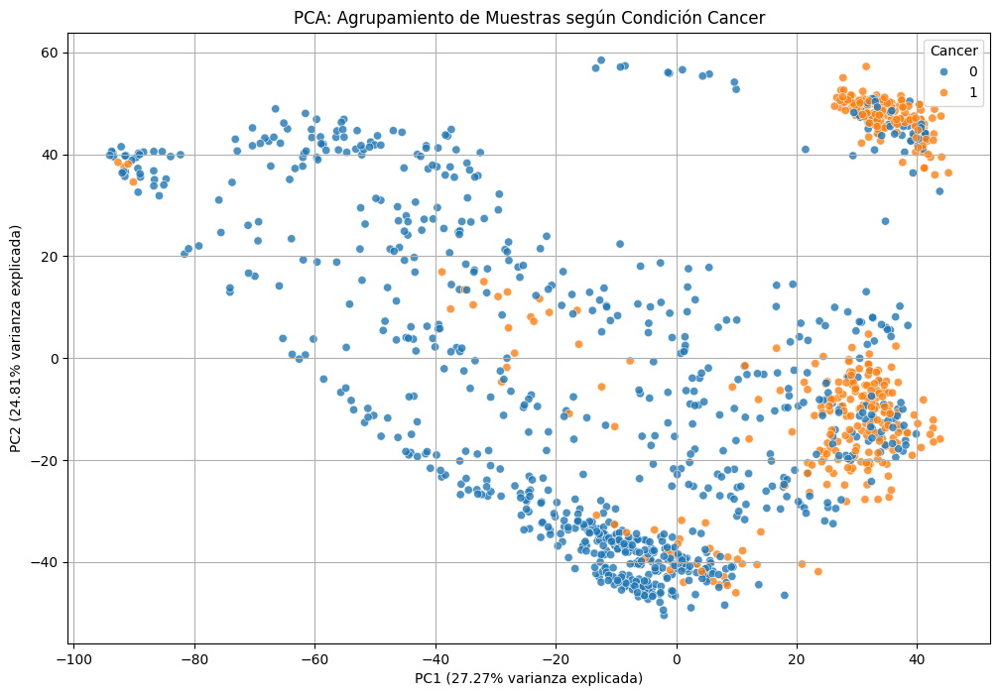

In [147]:
X_train_mirna_expression_cancer_pca = X_train_mirna_expression.copy()

# Realizar PCA
pca = PCA(n_components=2)  # Usar las dos primeras componentes principales para poder graficarlo
pca_result = pca.fit_transform(X_train_mirna_expression_cancer_pca)
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Convertir el resultado en un DataFrame para facilitar el plotting
pca_df = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])

# Unir el resultado del PCA con la metadata para poder usar la condición (Cancer)
pca_df = pd.concat([pca_df, y_cancer_train_encoded], axis=1)


# Gráfico de dispersión con color basado en la condición de 'Cancer'
plt.figure(figsize=(12,8))
sns.scatterplot(
    x='PC1', y='PC2',
    hue='Cancer',
    palette=sns.color_palette("tab10", n_colors=2),
    data=pca_df,
    alpha=0.8  # Transparencia
)

plt.title('PCA: Agrupamiento de Muestras según Condición Cancer')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.legend(title='Cancer')
plt.grid(True)
plt.show()

### 3.10.1. Isolation Forest

Algoritmo basado en árboles diseñado exclusivamente para la detección de anomalías. Aisla puntos dividiendo iterativamente el espacio de datos. Los puntos que son más fáciles de aislar (es decir, se requieren menos divisiones para separarlos del resto) se consideran anomalías. Se construyen múltiples árboles de aislamiento (similar a un bosque aleatorio) y se mide el nivel de aislamiento de cada punto.

Se detectaron 13 muestras anómalas.


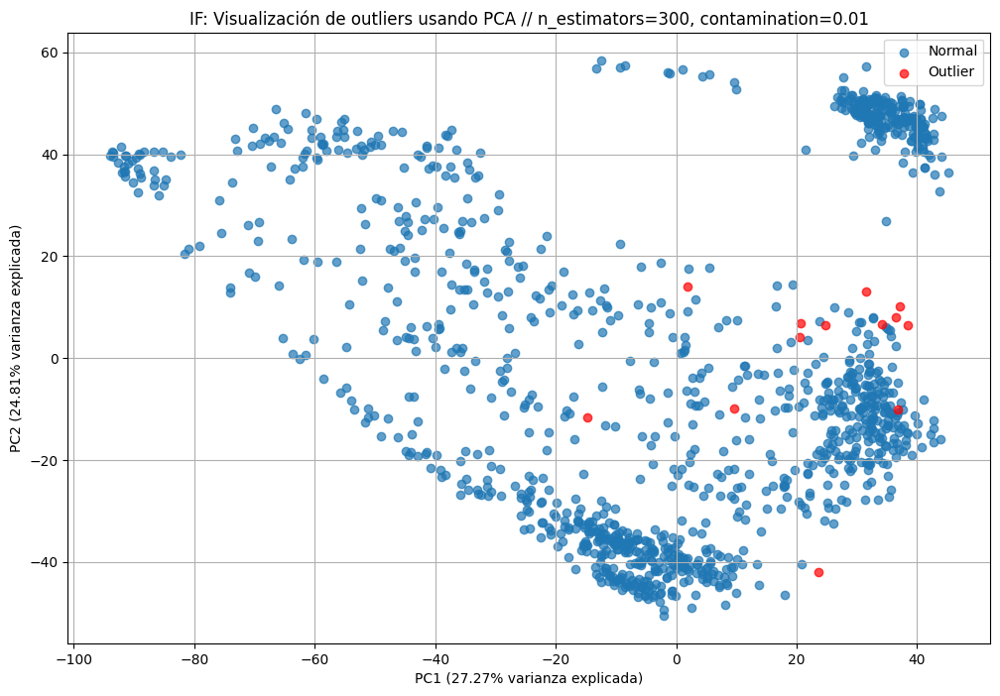

In [148]:
X_train_mirna_expression_if = X_train_mirna_expression.copy()

# Crear el modelo Isolation Forest
# n_estimators 100-300 ## Número de árboles en el bosque (precisión)
# max_samples auto/0.5-1.0 ## Fracción de muestras que se utilizarán para construir el árbol
# contamination auto/0.01-0.1 ## La proporción de outliers en el dataset
isolation_forest = IsolationForest(n_estimators=300, contamination=0.01, random_state=42)

# Entrenar el modelo
isolation_forest.fit(X_train_mirna_expression_if)

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_if = isolation_forest.predict(X_train_mirna_expression_if)

# Añadir la predicción de outliers a X_train_mirna_expression_if
X_train_mirna_expression_if['Outlier'] = outliers_if

# Ver las muestras detectadas como outliers (-1)
outliers_detected_if = X_train_mirna_expression_if[X_train_mirna_expression_if['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_if)} muestras anómalas.")

# Visualización
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_if.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_if['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_if['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_if['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_if['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('IF: Visualización de outliers usando PCA // n_estimators=300, contamination=0.01')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

Se detectaron 122 muestras anómalas.


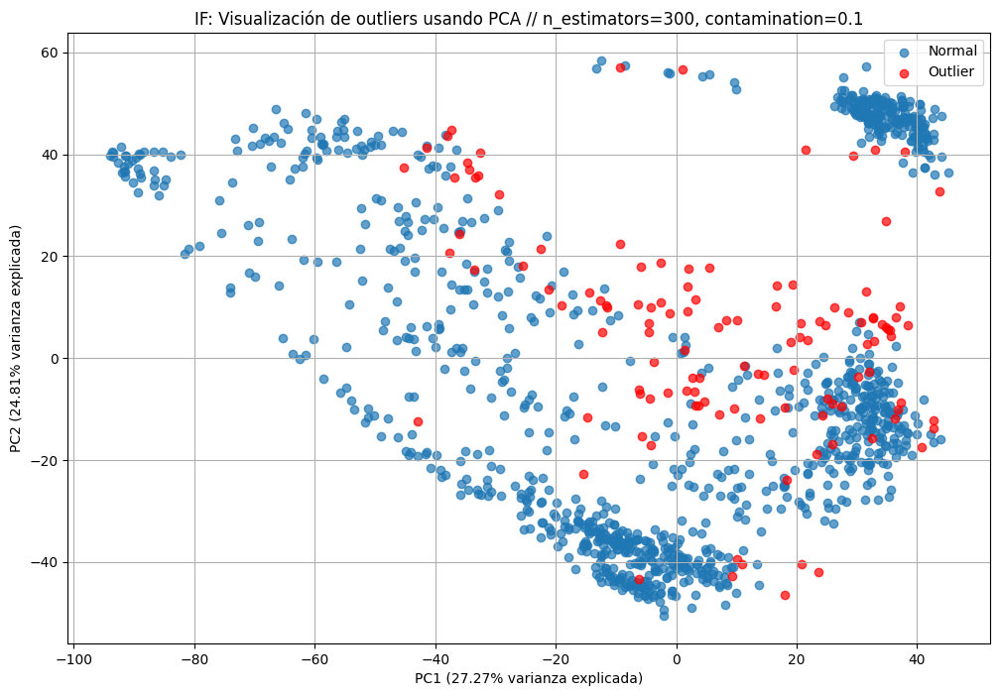

In [149]:
X_train_mirna_expression_if = X_train_mirna_expression.copy()

# Crear el modelo Isolation Forest
# n_estimators 100-300 ## Número de árboles en el bosque (precisión)
# max_samples auto/0.5-1.0 ## Fracción de muestras que se utilizarán para construir el árbol
# contamination auto/0.01-0.1 ## La proporción de outliers en el dataset
isolation_forest = IsolationForest(n_estimators=300, contamination=0.1, random_state=42)

# Entrenar el modelo
isolation_forest.fit(X_train_mirna_expression_if)

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_if = isolation_forest.predict(X_train_mirna_expression_if)

# Añadir la predicción de outliers a X_train_mirna_expression_if
X_train_mirna_expression_if['Outlier'] = outliers_if

# Ver las muestras detectadas como outliers (-1)
outliers_detected_if = X_train_mirna_expression_if[X_train_mirna_expression_if['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_if)} muestras anómalas.")

# Visualización
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_if.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_if['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_if['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_if['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_if['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('IF: Visualización de outliers usando PCA // n_estimators=300, contamination=0.1')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

Se detectaron 206 muestras anómalas.


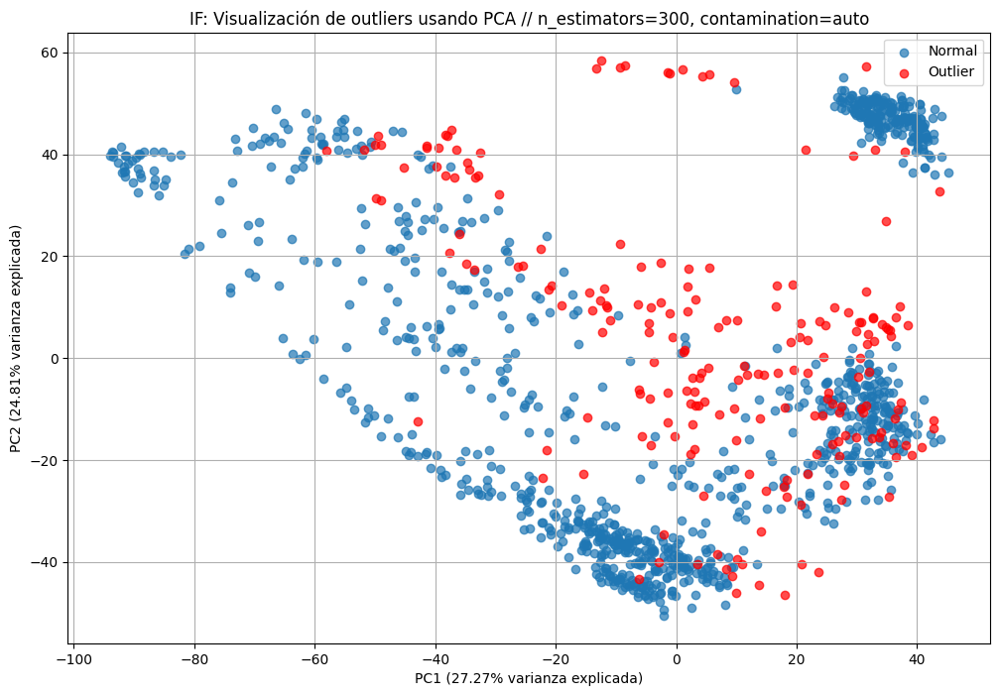

In [150]:
X_train_mirna_expression_if = X_train_mirna_expression.copy()

# Crear el modelo Isolation Forest
# n_estimators 100-300 ## Número de árboles en el bosque (precisión)
# max_samples auto/0.5-1.0 ## Fracción de muestras que se utilizarán para construir el árbol
# contamination auto/0.01-0.1 ## La proporción de outliers en el dataset
isolation_forest = IsolationForest(n_estimators=300, contamination='auto', random_state=42)

# Entrenar el modelo
isolation_forest.fit(X_train_mirna_expression_if)

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_if = isolation_forest.predict(X_train_mirna_expression_if)

# Añadir la predicción de outliers a X_train_mirna_expression_if
X_train_mirna_expression_if['Outlier'] = outliers_if

# Ver las muestras detectadas como outliers (-1)
outliers_detected_if = X_train_mirna_expression_if[X_train_mirna_expression_if['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_if)} muestras anómalas.")

# Visualización
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_if.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_if['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_if['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_if['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_if['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('IF: Visualización de outliers usando PCA // n_estimators=300, contamination=auto')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()


#### El elegido

Se detectaron 61 muestras anómalas.


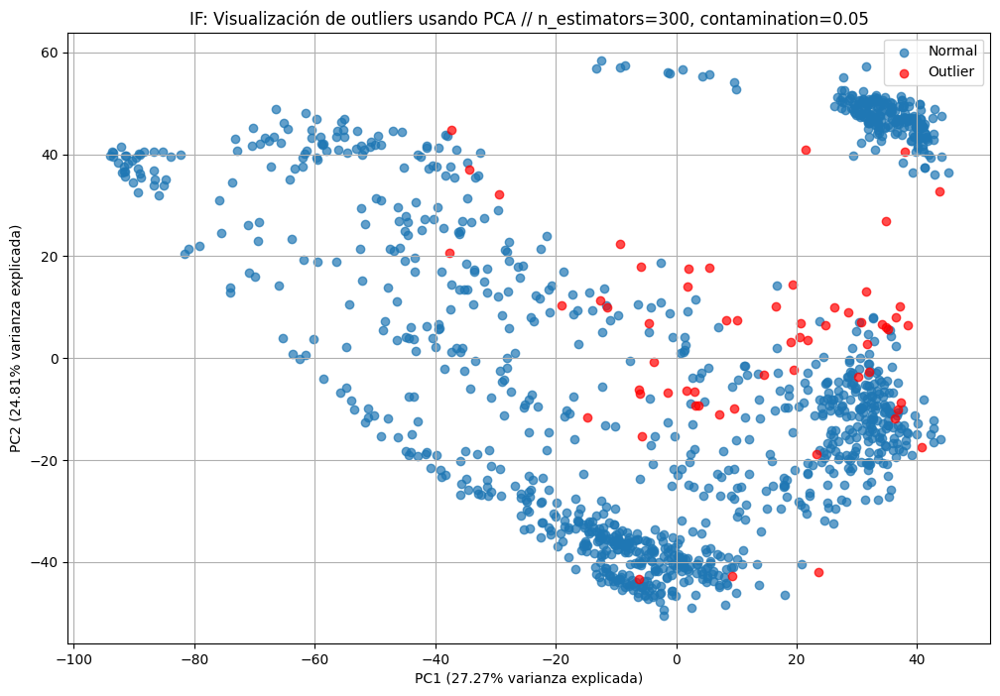

In [151]:
X_train_mirna_expression_if = X_train_mirna_expression.copy()

# Crear el modelo Isolation Forest
# n_estimators 100-300 ## Número de árboles en el bosque (precisión)
# max_samples auto/0.5-1.0 ## Fracción de muestras que se utilizarán para construir el árbol
# contamination auto/0.01-0.1 ## La proporción de outliers en el dataset
isolation_forest = IsolationForest(n_estimators=300, contamination=0.05, random_state=42)

# Entrenar el modelo
isolation_forest.fit(X_train_mirna_expression_if)

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_if = isolation_forest.predict(X_train_mirna_expression_if)

# Añadir la predicción de outliers a X_train_mirna_expression_if
X_train_mirna_expression_if['Outlier'] = outliers_if

# Ver las muestras detectadas como outliers (-1)
outliers_detected_if = X_train_mirna_expression_if[X_train_mirna_expression_if['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_if)} muestras anómalas.")

# Visualización
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_if.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_if['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_if['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_if['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_if['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('IF: Visualización de outliers usando PCA // n_estimators=300, contamination=0.05')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

### 3.10.2. LOF

Específicamente diseñado para la detección de anomalías en base a la densidad local. Calcula la densidad local de un punto en relación con sus vecinos. Un punto se considera una anomalía si su densidad es mucho menor que la densidad de sus vecinos, lo que indica que está "aislado" en comparación con su entorno.

Se detectaron 61 muestras anómalas.


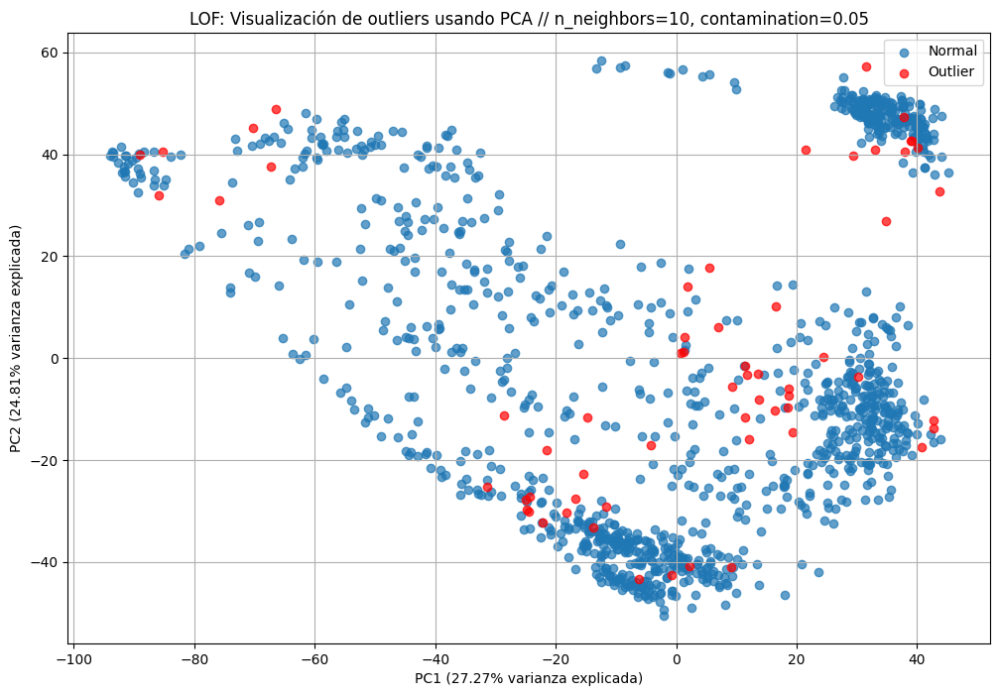

In [152]:
X_train_mirna_expression_lof = X_train_mirna_expression.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=10, contamination=0.05)  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_expression_lof)

# Añadir la predicción de outliers a X_train_mirna_expression_lof
X_train_mirna_expression_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_expression_lof[X_train_mirna_expression_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_lof.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('LOF: Visualización de outliers usando PCA // n_neighbors=10, contamination=0.05')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

Se detectaron 13 muestras anómalas.


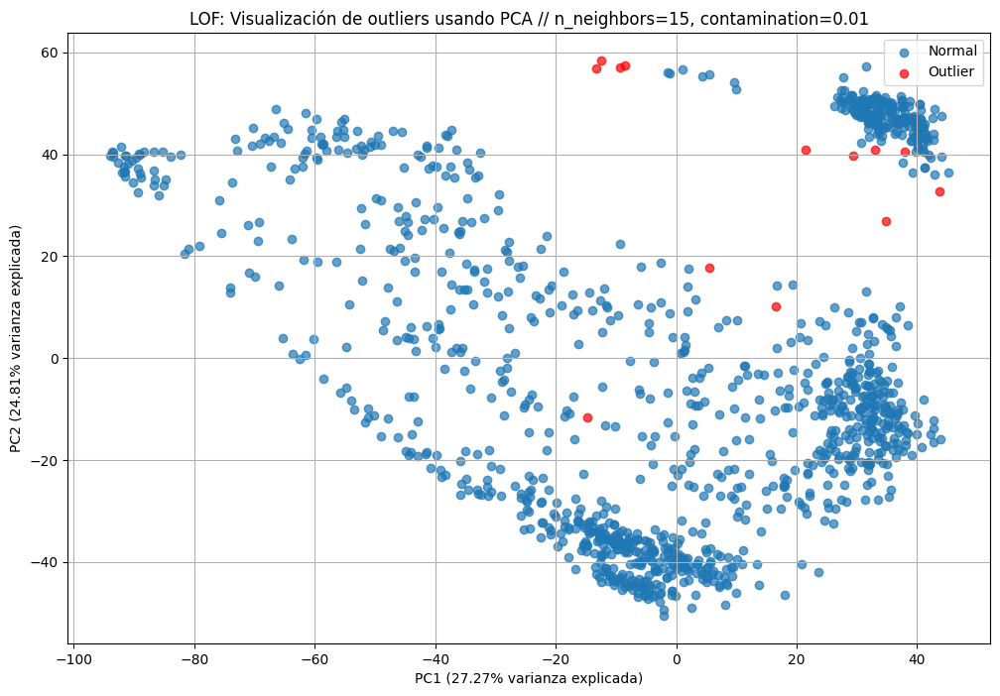

In [153]:
X_train_mirna_expression_lof = X_train_mirna_expression.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=15, contamination=0.01)  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_expression_lof)

# Añadir la predicción de outliers a X_train_mirna_expression_lof
X_train_mirna_expression_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_expression_lof[X_train_mirna_expression_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_lof.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('LOF: Visualización de outliers usando PCA // n_neighbors=15, contamination=0.01')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

Se detectaron 61 muestras anómalas.


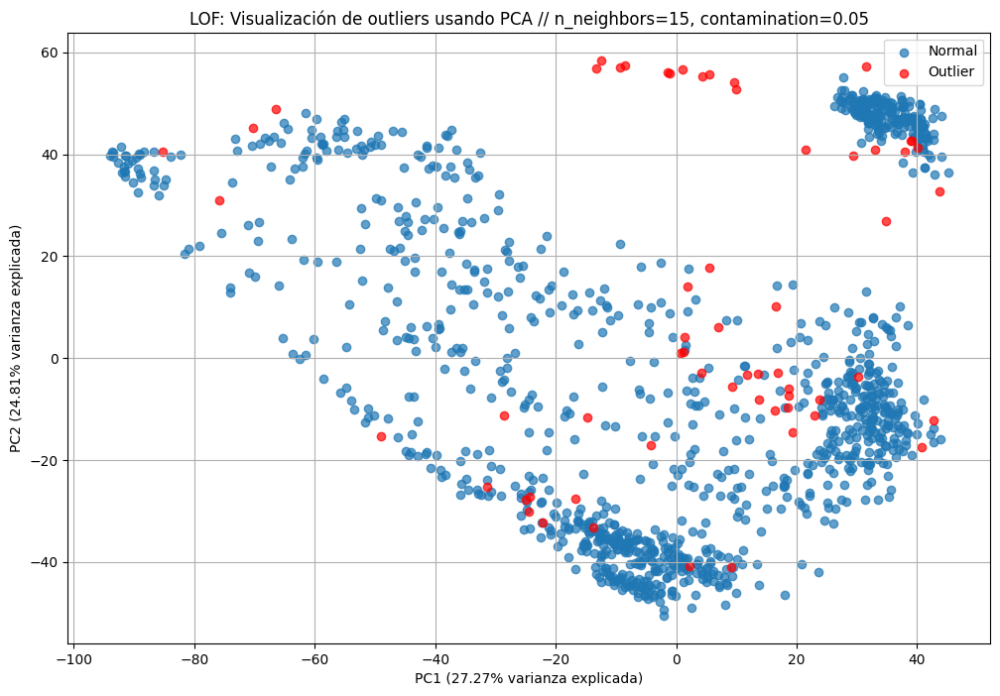

In [154]:
X_train_mirna_expression_lof = X_train_mirna_expression.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=15, contamination=0.05)  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_expression_lof)

# Añadir la predicción de outliers a mirna_transposed_expression_lof
X_train_mirna_expression_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_expression_lof[X_train_mirna_expression_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_lof.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('LOF: Visualización de outliers usando PCA // n_neighbors=15, contamination=0.05')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

Se detectaron 122 muestras anómalas.


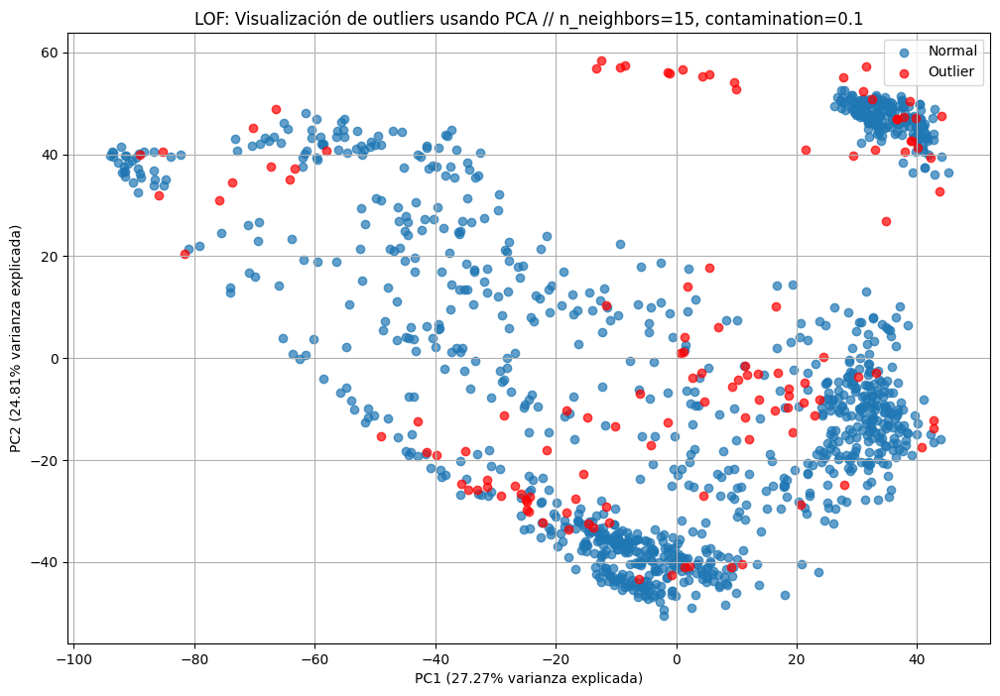

In [155]:
X_train_mirna_expression_lof = X_train_mirna_expression.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=15, contamination=0.1)  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_expression_lof)

# Añadir la predicción de outliers a X_train_mirna_expression_lof
X_train_mirna_expression_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_expression_lof[X_train_mirna_expression_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_lof.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('LOF: Visualización de outliers usando PCA // n_neighbors=15, contamination=0.1')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

Se detectaron 49 muestras anómalas.


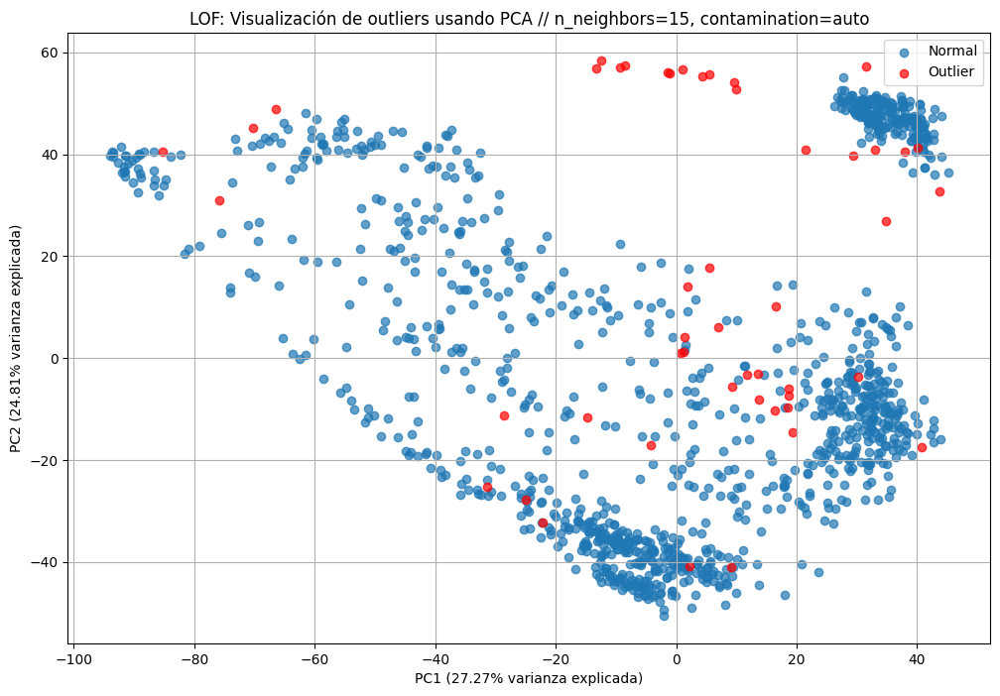

In [156]:
X_train_mirna_expression_lof = X_train_mirna_expression.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=15, contamination='auto')  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_expression_lof)

# Añadir la predicción de outliers a mirna_transposed_expression_lof
X_train_mirna_expression_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_expression_lof[X_train_mirna_expression_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_lof.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('LOF: Visualización de outliers usando PCA // n_neighbors=15, contamination=auto')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

Se detectaron 47 muestras anómalas.


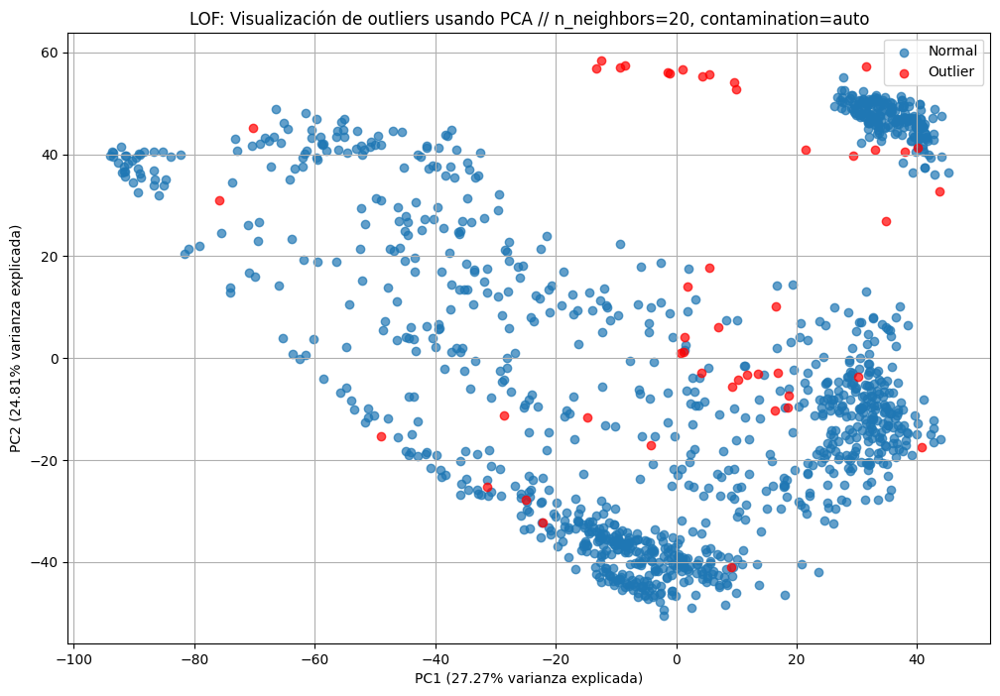

In [157]:
X_train_mirna_expression_lof = X_train_mirna_expression.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=20, contamination='auto')  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_expression_lof)

# Añadir la predicción de outliers a mirna_transposed_expression_lof
X_train_mirna_expression_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_expression_lof[X_train_mirna_expression_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_lof.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('LOF: Visualización de outliers usando PCA // n_neighbors=20, contamination=auto')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

Se detectaron 13 muestras anómalas.


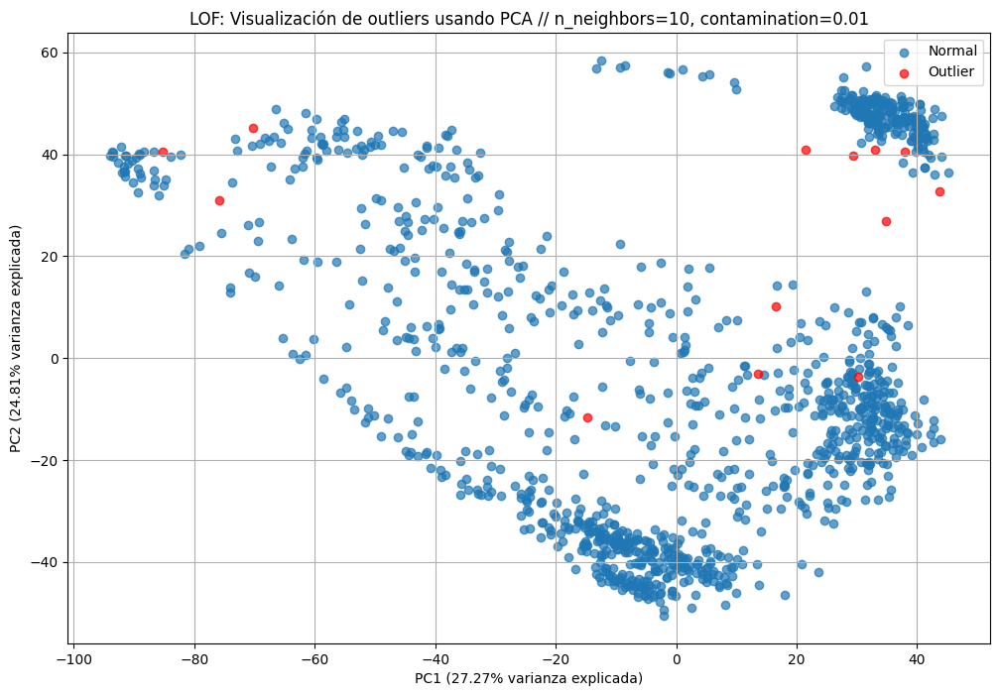

In [158]:
X_train_mirna_expression_lof = X_train_mirna_expression.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=10, contamination=0.01)  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_expression_lof)

# Añadir la predicción de outliers a X_train_mirna_expression_lof
X_train_mirna_expression_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_expression_lof[X_train_mirna_expression_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_lof.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('LOF: Visualización de outliers usando PCA // n_neighbors=10, contamination=0.01')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

Se detectaron 122 muestras anómalas.


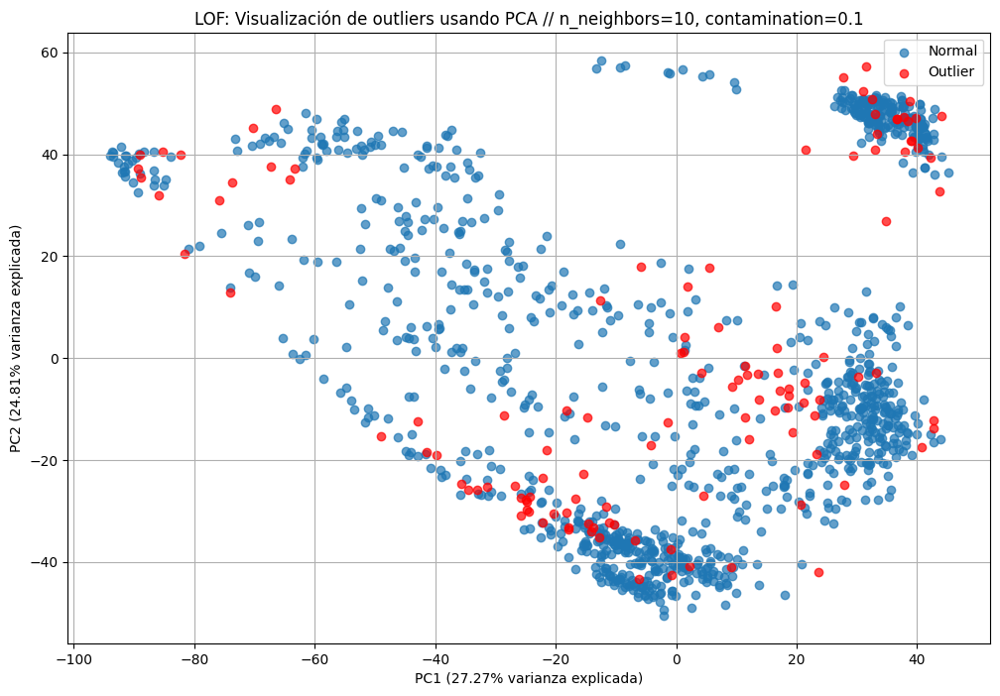

In [159]:
X_train_mirna_expression_lof = X_train_mirna_expression.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=10, contamination=0.1)  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_expression_lof)

# Añadir la predicción de outliers a X_train_mirna_expression_lof
X_train_mirna_expression_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_expression_lof[X_train_mirna_expression_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_lof.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('LOF: Visualización de outliers usando PCA // n_neighbors=10, contamination=0.1')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

#### El elegido

Se detectaron 41 muestras anómalas.


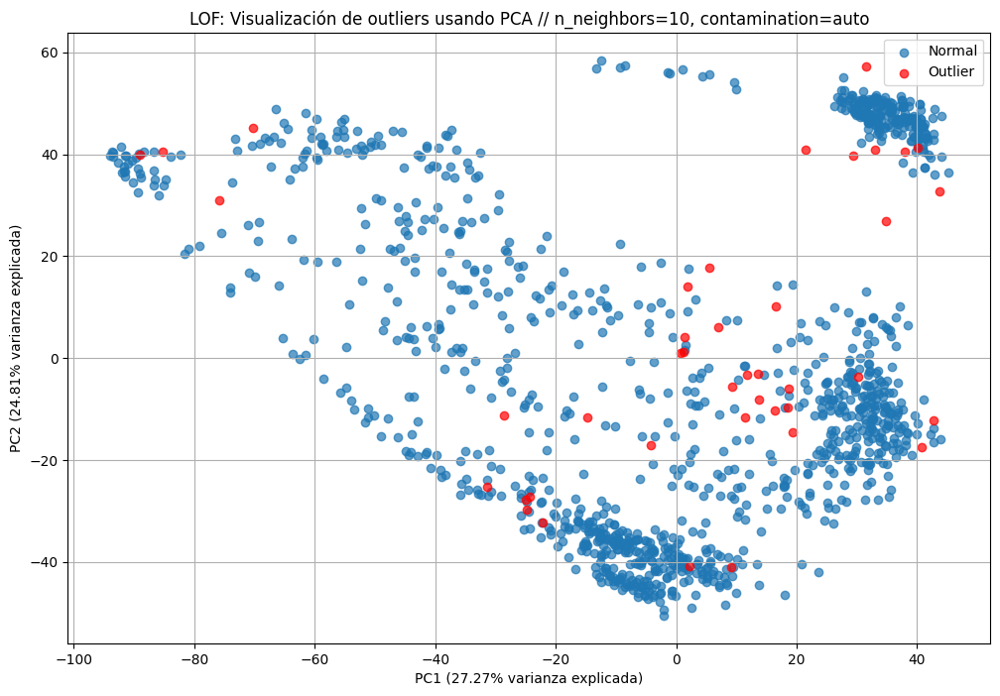

In [160]:
X_train_mirna_expression_lof = X_train_mirna_expression.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=10, contamination='auto')  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_expression_lof)

# Añadir la predicción de outliers a X_train_mirna_expression_lof
X_train_mirna_expression_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_expression_lof[X_train_mirna_expression_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_lof.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_df['PC1'], pca_df['PC2'], c=X_train_mirna_expression_if['Outlier'], cmap='coolwarm_r')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.7)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

plt.title('LOF: Visualización de outliers usando PCA // n_neighbors=10, contamination=auto')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

### 3.10.3. DBSCAN

Es un algoritmo de clustering que también puede identificar anomalías como puntos que no pertenecen a ningún clúster. Se basa en la densidad de puntos en un espacio. Identifica áreas densas como clústeres y considera los puntos que no están en zonas densas como ruido o anomalías.

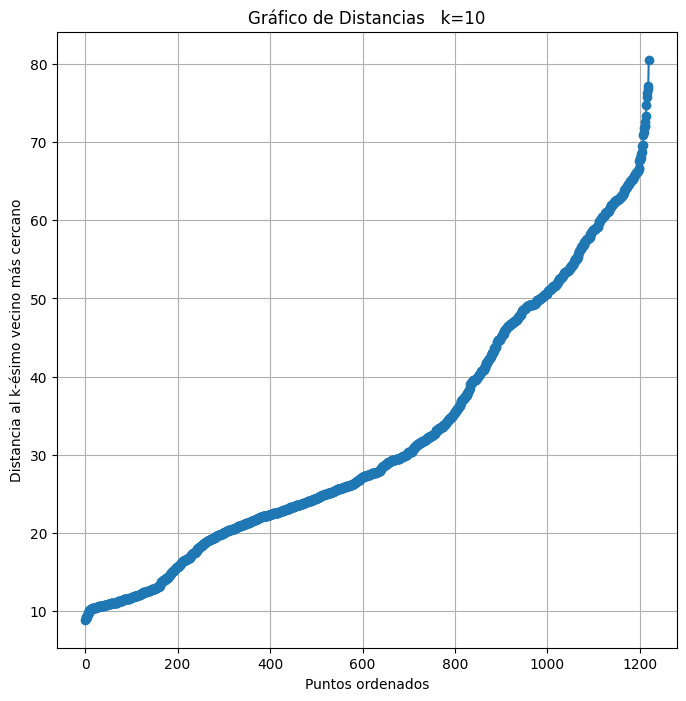

In [161]:
# Número de vecinos para calcular la distancia
k = 10  # Ajusta este valor según sea necesario

# Calcular distancias a los k-ésimos vecinos más cercanos
nbrs = NearestNeighbors(n_neighbors=k).fit(X_train_mirna_expression)
distances, indices = nbrs.kneighbors(X_train_mirna_expression)

# Tomar la distancia al k-ésimo vecino más cercano
k_distances = distances[:, k-1]

# Graficar las distancias ordenadas
plt.figure(figsize=(8, 8))
plt.plot(np.sort(k_distances), marker='o')
plt.title(f'Gráfico de Distancias   k={k}')
plt.xlabel('Puntos ordenados')
plt.ylabel('Distancia al k-ésimo vecino más cercano')
plt.grid()
plt.show()

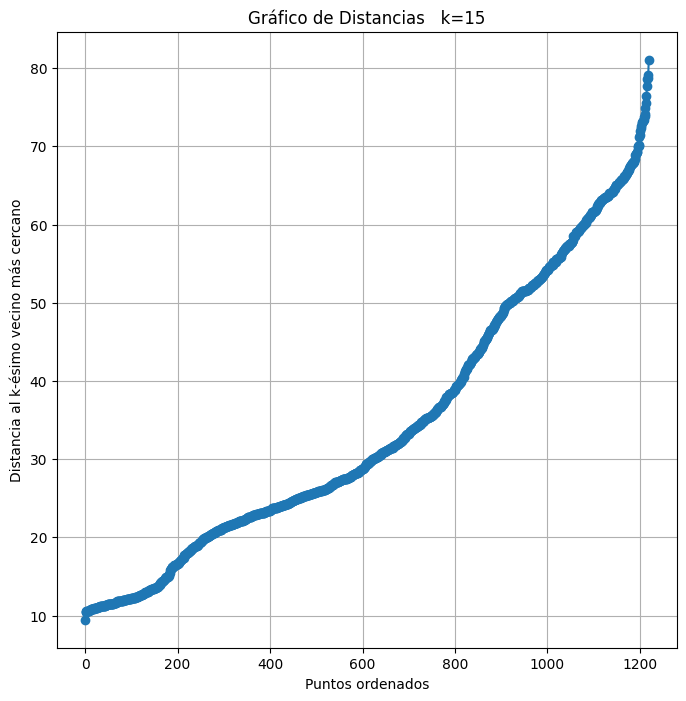

In [162]:
# Número de vecinos para calcular la distancia
k = 15  # Ajusta este valor según sea necesario

# Calcular distancias a los k-ésimos vecinos más cercanos
nbrs = NearestNeighbors(n_neighbors=k).fit(X_train_mirna_expression)
distances, indices = nbrs.kneighbors(X_train_mirna_expression)

# Tomar la distancia al k-ésimo vecino más cercano
k_distances = distances[:, k-1]

# Graficar las distancias ordenadas
plt.figure(figsize=(8,8))
plt.plot(np.sort(k_distances), marker='o')
plt.title(f'Gráfico de Distancias   k={k}')
plt.xlabel('Puntos ordenados')
plt.ylabel('Distancia al k-ésimo vecino más cercano')
plt.grid()
plt.show()

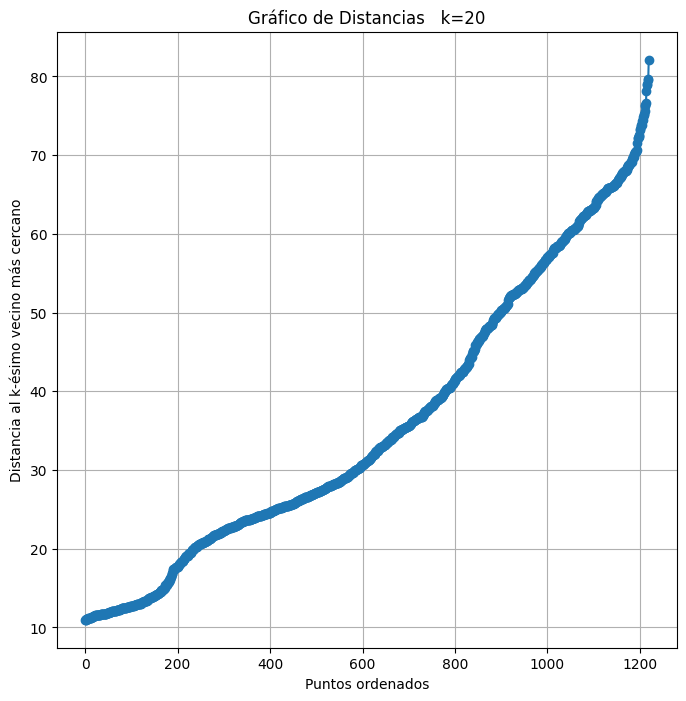

In [163]:
# Número de vecinos para calcular la distancia
k = 20  # Ajusta este valor según sea necesario

# Calcular distancias a los k-ésimos vecinos más cercanos
nbrs = NearestNeighbors(n_neighbors=k).fit(X_train_mirna_expression)
distances, indices = nbrs.kneighbors(X_train_mirna_expression)

# Tomar la distancia al k-ésimo vecino más cercano
k_distances = distances[:, k-1]

# Graficar las distancias ordenadas
plt.figure(figsize=(8,8))
plt.plot(np.sort(k_distances), marker='o')
plt.title(f'Gráfico de Distancias   k={k}')
plt.xlabel('Puntos ordenados')
plt.ylabel('Distancia al k-ésimo vecino más cercano')
plt.grid()
plt.show()

**Comparación de gráficos:**

k=10:
- El codo en este gráfico es más claro, alrededor de los valores de distancia 30-35. Después de ese punto, la curva sube más rápidamente, lo que sugiere que los valores de distancia más altos están empezando a separarse de la mayoría de los puntos.

k=15:
- Este gráfico muestra un codo más suave, alrededor de 35-40, pero sigue una tendencia similar al gráfico de k=10.
 
El gráfico con k=10 parece tener el codo más claro y distintivo. El valor óptimo de eps debería estar cerca de 30-35, ya que es el punto donde se produce un cambio notable en la pendiente de la curva. Utilizar este valor permitirá que DBSCAN agrupe puntos que están dentro de esa distancia como vecinos, separando clusters de forma adecuada.

Se detectaron 437 muestras anómalas.


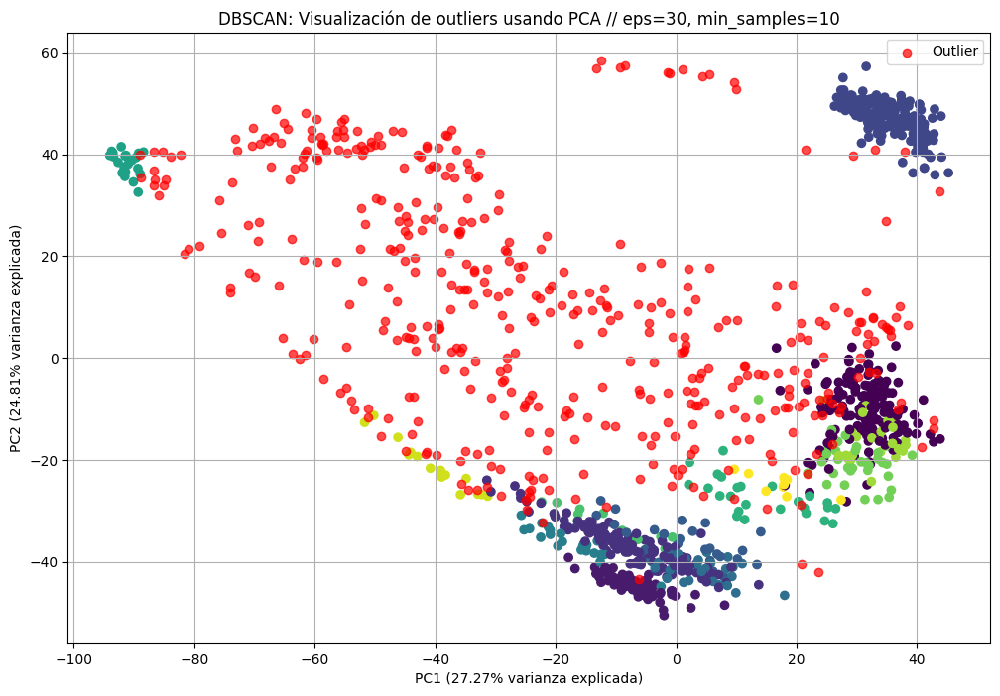

In [164]:
X_train_mirna_expression_dbscan = X_train_mirna_expression.copy()

# Crear el modelo DBSCAN
# eps 0.1 - 1 ## Radio de búsqueda
# min_samples 5-15 ## Número mínimo de muestras en una vecindad para formar un cluster
dbscan = DBSCAN(eps=30, min_samples=10)

# Predecir anomalías
# Las muestras normales tendrán un valor de 0 y las anomalías -1
clusters_dbscan = dbscan.fit_predict(X_train_mirna_expression_dbscan)

# Añadir la predicción de outliers a mirna_transposed_expression
X_train_mirna_expression_dbscan['Outlier'] = clusters_dbscan

# Ver las muestras detectadas como outliers (-1)
outliers_detected_dbscan = X_train_mirna_expression_dbscan[X_train_mirna_expression_dbscan['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_dbscan)} muestras anómalas.")

# Visualización simple con PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_dbscan.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Crear un colormap personalizado donde los outliers sean rojos
cmap = plt.get_cmap('viridis', np.unique(clusters_dbscan).size)
colors = np.array(cmap(clusters_dbscan / np.max(clusters_dbscan)))  # Normalizar etiquetas para el colormap
colors[clusters_dbscan == -1] = [1, 0, 0, 1]  # Asignar color rojo a los outliers

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12, 8))

# Dibujar puntos normales
plt.scatter(pca_result[clusters_dbscan != -1, 0],
            pca_result[clusters_dbscan != -1, 1],
            c=colors[clusters_dbscan != -1])

# Dibujar outliers
plt.scatter(pca_result[clusters_dbscan == -1, 0],
            pca_result[clusters_dbscan == -1, 1],
            color='red', label='Outlier', alpha=0.7)

#plt.scatter(pca_result[:, 0], pca_result[:, 1], c=colors, alpha=0.6)
plt.title('DBSCAN: Visualización de outliers usando PCA // eps=30, min_samples=10')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.legend()
plt.grid(True)
plt.show()

Se detectaron 995 muestras anómalas.


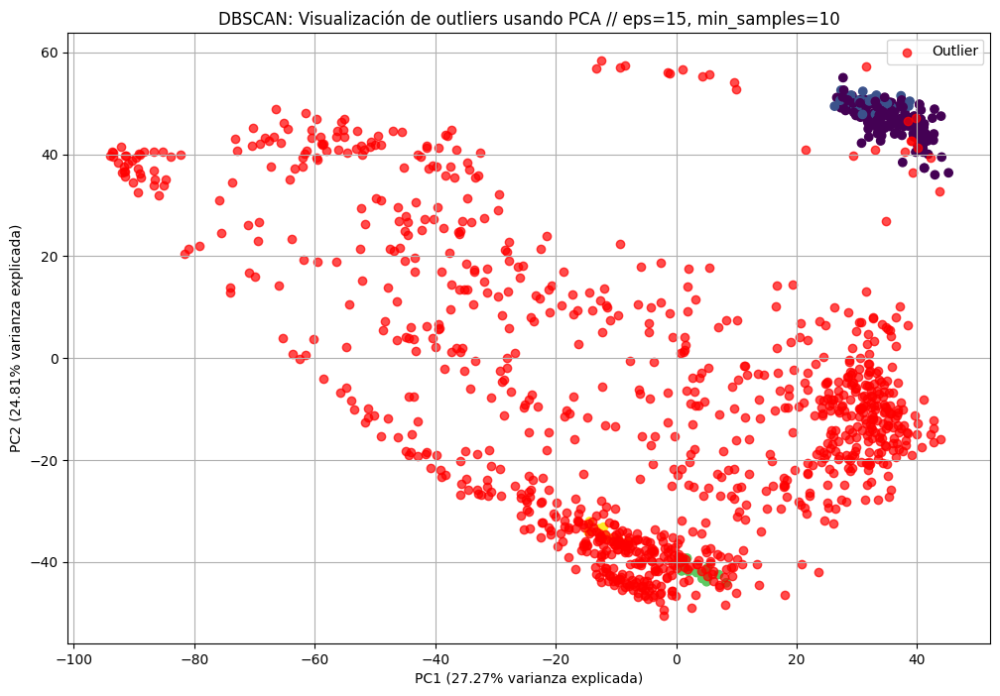

In [165]:
X_train_mirna_expression_dbscan = X_train_mirna_expression.copy()

# Crear el modelo DBSCAN
# eps 0.1 - 1 ## Radio de búsqueda
# min_samples 5-15 ## Número mínimo de muestras en una vecindad para formar un cluster
dbscan = DBSCAN(eps=15, min_samples=10)

# Predecir anomalías
# Las muestras normales tendrán un valor de 0 y las anomalías -1
clusters_dbscan = dbscan.fit_predict(X_train_mirna_expression_dbscan)

# Añadir la predicción de outliers a mirna_transposed_expression
X_train_mirna_expression_dbscan['Outlier'] = clusters_dbscan

# Ver las muestras detectadas como outliers (-1)
outliers_detected_dbscan = X_train_mirna_expression_dbscan[X_train_mirna_expression_dbscan['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_dbscan)} muestras anómalas.")

# Visualización simple con PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_dbscan.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Crear un colormap personalizado donde los outliers sean rojos
cmap = plt.get_cmap('viridis', np.unique(clusters_dbscan).size)
colors = np.array(cmap(clusters_dbscan / np.max(clusters_dbscan)))  # Normalizar etiquetas para el colormap
colors[clusters_dbscan == -1] = [1, 0, 0, 1]  # Asignar color rojo a los outliers

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12, 8))

# Dibujar puntos normales
plt.scatter(pca_result[clusters_dbscan != -1, 0],
            pca_result[clusters_dbscan != -1, 1],
            c=colors[clusters_dbscan != -1])

# Dibujar outliers
plt.scatter(pca_result[clusters_dbscan == -1, 0],
            pca_result[clusters_dbscan == -1, 1],
            color='red', label='Outlier', alpha=0.7)

#plt.scatter(pca_result[:, 0], pca_result[:, 1], c=colors, alpha=0.6)
plt.title('DBSCAN: Visualización de outliers usando PCA // eps=15, min_samples=10')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.legend()
plt.grid(True)
plt.show()

Debido al resultado donde observaciones han sido consideradas atípicas, DBSCAN no se tendrá en cuenta.

### 3.10.4. Distancias Multivariadas - Mahalanobis

Se detectaron 31 muestras anómalas.


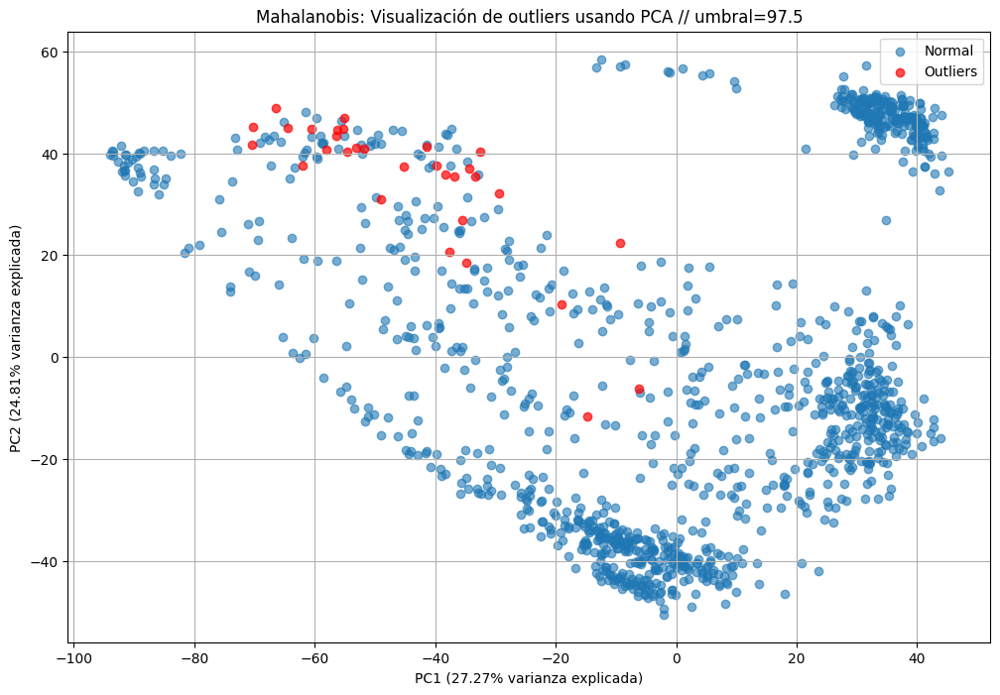

In [166]:
X_train_mirna_expression_mahalanobis = X_train_mirna_expression.copy()

# Calcular el centroide (media) y la matriz de covarianza inversa del dataset
data_matrix = X_train_mirna_expression_mahalanobis.to_numpy()
mean_vec = np.mean(data_matrix, axis=0)
cov_matrix_inv = inv(np.cov(data_matrix.T))

# Calcular la distancia de Mahalanobis para cada punto
distances = np.array([mahalanobis(x, mean_vec, cov_matrix_inv) for x in data_matrix])

# Definir un umbral para detectar outliers (valor de percentil alto)
threshold = np.percentile(distances, 97.5)
#threshold = np.percentile(distances, 95)
#irna_transposed_expression_mahalanobis['Outlier'] = (distances > threshold).astype(int)
outliers_mahalanobis = np.where(distances > threshold, -1, 1)
X_train_mirna_expression_mahalanobis['Outlier'] = outliers_mahalanobis

# Mostrar resumen de resultados
outliers_detected_mahalanobis = X_train_mirna_expression_mahalanobis[X_train_mirna_expression_mahalanobis['Outlier'] == -1]
print(f"Se detectaron {len(outliers_detected_mahalanobis)} muestras anómalas.")

# Aplicar PCA para reducir las dimensiones a 2D
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression_mahalanobis.drop('Outlier', axis=1))
# Obtener el porcentaje de varianza explicada por cada componente
explained_variance = pca.explained_variance_ratio_

# Visualización de los outliers en el gráfico PCA
plt.figure(figsize=(12, 8))
plt.scatter(pca_result[X_train_mirna_expression_mahalanobis['Outlier'] == 1, 0],
            pca_result[X_train_mirna_expression_mahalanobis['Outlier'] == 1, 1],
            label='Normal', alpha=0.6)

plt.scatter(pca_result[X_train_mirna_expression_mahalanobis['Outlier'] == -1, 0],
            pca_result[X_train_mirna_expression_mahalanobis['Outlier'] == -1, 1],
            color='red', label='Outliers', alpha=0.7)

plt.title('Mahalanobis: Visualización de outliers usando PCA // umbral=97.5')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.legend()
plt.grid(True)
plt.show()


### 3.10.5. Outlier selection

In [167]:
# Crear un DataFrame con los outliers
outliers_df = pd.DataFrame({
    'outliers_if': outliers_if,
    'outliers_lof': outliers_lof,
    #'outliers_dbscan': clusters_dbscan,
    'outliers_mahalanobis': outliers_mahalanobis
})

# Contar cuántas veces cada muestra es outlier
outliers_df['outlier_count'] = (outliers_df == -1).sum(axis=1)

# Crear una nueva variable que indique si una muestra es outlier en al menos 2 de las 3 variables
outliers_df['is_outlier'] = outliers_df['outlier_count'] >= 2

# Crear un DataFrame final que incluya el nombre de la muestra y si es outlier o no
experiment_outlier = pd.DataFrame({
    'Experiment': X_train_mirna_experiment,
    'Is_Outlier': outliers_df['is_outlier']
})

# Imprimir el número total de outliers
total_outliers = experiment_outlier['Is_Outlier'].sum()
print(f"El número total de outliers es: {total_outliers}")

El número total de outliers es: 17


In [168]:
outliers_df

,outliers_if,outliers_lof,outliers_mahalanobis,outlier_count,is_outlier
0,1,1,1,0,False
1,1,1,1,0,False
2,1,1,1,0,False
3,1,1,1,0,False
4,1,1,1,0,False
...,...,...,...,...,...
1215,1,1,1,0,False
1216,1,1,1,0,False
1217,-1,1,1,1,False
1218,1,1,1,0,False


In [169]:
experiment_outlier['Is_Outlier']

0       False
1       False
2       False
3       False
4       False
        ...  
1215    False
1216    False
1217    False
1218    False
1219    False
Name: Is_Outlier, Length: 1220, dtype: bool

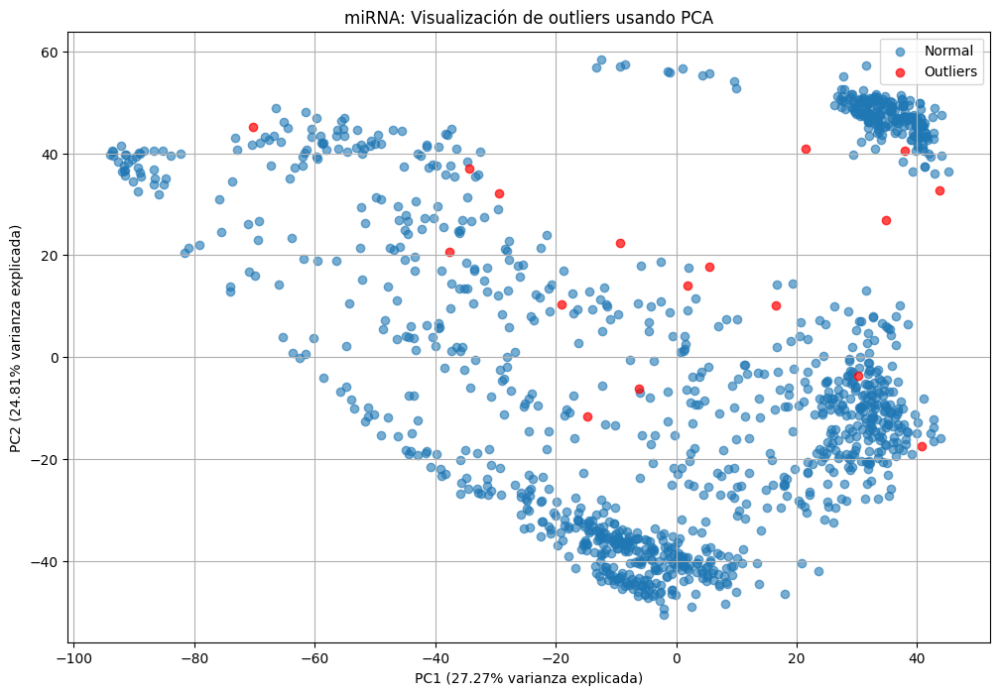

In [170]:
# Aplicar PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_expression)
# Calcular la varianza explicada
explained_variance = pca.explained_variance_ratio_

# Crear un DataFrame para los resultados de PCA
pca_df = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])
pca_df['Is_Outlier'] = experiment_outlier['Is_Outlier']

# Visualizar los resultados
plt.figure(figsize=(12, 8))
#plt.scatter(pca_result[:, 0], pca_result[:, 1], c=experiment_outlier['Is_Outlier'], cmap='coolwarm', alpha=0.8)
plt.scatter(pca_df[pca_df['Is_Outlier'] == False]['PC1'],
            pca_df[pca_df['Is_Outlier'] == False]['PC2'],
            label='Normal', alpha=0.6)

plt.scatter(pca_df[pca_df['Is_Outlier'] == True]['PC1'],
            pca_df[pca_df['Is_Outlier'] == True]['PC2'],
            color='red', label='Outliers', alpha=0.7)

#sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Is_Outlier', palette={True: 'red', False: 'blue'}, alpha=0.8)
plt.title('miRNA: Visualización de outliers usando PCA')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.legend()
plt.grid(True)
#plt.legend(labels=['Outlier', 'Normal'])
#plt.colorbar(label='Outlier')
plt.show()

In [171]:
X_train_mirna_no_outliers = X_train_mirna_cleaned.copy()
X_train_mirna_no_outliers['Is_Outlier'] = experiment_outlier['Is_Outlier']
X_train_mirna_no_outliers.columns

Index(['Experiment', 'hsa-miR-99b-3p', 'hsa-miR-136-5p', 'hsa-miR-106b-5p',
       'hsa-miR-29a-3p', 'hsa-miR-26a-5p', 'hsa-miR-885-5p', 'hsa-let-7i-5p',
       'hsa-miR-136-3p', 'hsa-miR-3074-5p',
       ...
       'hsa-miR-486-5p', 'hsa-miR-589-5p', 'hsa-miR-93-3p', 'hsa-let-7b-3p',
       'hsa-miR-376a-3p', 'hsa-miR-486-3p', 'hsa-miR-1304-5p',
       'hsa-miR-99b-5p', 'hsa-miR-1304-3p', 'Is_Outlier'],
      dtype='object', length=417)

In [172]:
# Guardar los índices de las filas a eliminar
indices_to_remove = X_train_mirna_no_outliers[X_train_mirna_no_outliers['Is_Outlier'] == True].index

In [173]:
# Elimina las filas donde 'Is_Outlier' sea True
X_train_mirna_no_outliers = X_train_mirna_no_outliers[X_train_mirna_no_outliers['Is_Outlier'] != True]
X_train_mirna_no_outliers.reset_index(inplace=True, drop=True)

In [174]:
X_train_mirna_no_outliers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1203 entries, 0 to 1202
Columns: 417 entries, Experiment to Is_Outlier
dtypes: bool(1), float64(415), object(1)
memory usage: 3.8+ MB


In [175]:
X_train_mirna_no_outliers.head()

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p,Is_Outlier
0,SRX2539128,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,...,17.179671,6.417664,5.181464,5.163893,1.608804,9.413083,5.431997,8.970077,4.726746,False
1,SRX2956350,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,...,21.638673,8.028001,7.752329,5.808130,0.000000,6.898628,0.000000,6.431232,7.010611,False
2,SRX2956137,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,...,9.880981,8.303605,4.234808,3.987018,0.000000,0.000000,0.000000,5.510013,4.234808,False
3,SRX2956358,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,...,22.112450,7.819897,8.196934,7.201842,0.000000,8.684904,0.000000,7.057034,6.790068,False
4,SRX2540517,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,...,15.776228,6.302500,1.523648,7.796886,0.581466,7.945661,3.831523,11.516693,4.242178,False


In [176]:
X_train_mirna_no_outliers.index

RangeIndex(start=0, stop=1203, step=1)

In [177]:
X_train_mirna_no_outliers = X_train_mirna_no_outliers.drop(columns=['Is_Outlier'])

In [178]:
# Eliminar las filas correspondientes en los otros dataset

X_train_metadata_no_outliers = X_train_metadata_encoded.drop(indices_to_remove)
X_train_metadata_no_outliers.reset_index(inplace=True, drop=True)

y_cancer_train_no_outliers = y_cancer_train_encoded.drop(indices_to_remove)
y_cancer_train_no_outliers.reset_index(inplace=True, drop=True)

In [179]:
X_train_metadata_no_outliers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1203 entries, 0 to 1202
Data columns (total 35 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Experiment                               1203 non-null   object 
 1   SRP                                      1203 non-null   object 
 2   Sample                                   1203 non-null   object 
 3   Sex                                      846 non-null    float64
 4   Healthy                                  1203 non-null   int64  
 5   Exosome                                  1203 non-null   int64  
 6   Instrument_Illumina Genome Analyzer II   1203 non-null   float64
 7   Instrument_Illumina Genome Analyzer IIx  1203 non-null   float64
 8   Instrument_Illumina HiScanSQ             1203 non-null   float64
 9   Instrument_Illumina HiSeq 2000           1203 non-null   float64
 10  Instrument_Illumina HiSeq 2500           1203 no

In [180]:
y_cancer_train_no_outliers.info()

<class 'pandas.core.series.Series'>
RangeIndex: 1203 entries, 0 to 1202
Series name: Cancer
Non-Null Count  Dtype
--------------  -----
1203 non-null   int64
dtypes: int64(1)
memory usage: 9.5 KB


### 3.10.6. Resumen Variables: Eliminación de outliers
- X_train_mirna_no_outliers
- X_test_mirna_cleaned
- X_train_metadata_no_outliers
- X_test_metadata_encoded
- y_cancer_train_no_outliers
- y_cancer_test_encoded

## 3.11. Integración de Datos
Se vuelven a unir los datsets **miRNA_RCadj** (*X_train_mirna_no_outliers*) y **metadata** (*X_train_metadata_no_outliers*) mediante la columna en común **'Experiment'**

In [181]:
# Unir los datasets usando la columna 'Experiment'
X_train_mirna_metadata = pd.merge(X_train_mirna_no_outliers, X_train_metadata_no_outliers, on='Experiment', how='inner')
X_train_mirna_metadata

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,Fluid_urine cells,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan
0,SRX2539128,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1,SRX2956350,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,SRX2956137,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,SRX2956358,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,SRX2540517,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1198,SRX1099428,8.827399,6.430007,4.795648,12.210311,12.044808,9.567880,14.989831,10.828011,5.329763,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1199,SRX2742164,0.000000,0.000000,10.422585,8.395104,13.685238,0.000000,15.676119,0.000000,4.605249,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1200,SRX3848863,4.822627,8.008994,5.293413,8.581847,9.219401,3.575214,7.265556,5.481453,0.000000,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1201,SRX1099330,8.945555,6.509042,4.719664,12.203863,12.241571,9.157081,15.328120,10.992907,5.182185,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


In [182]:
X_train_mirna_metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1203 entries, 0 to 1202
Columns: 450 entries, Experiment to Library_nan
dtypes: float64(445), int64(2), object(3)
memory usage: 4.1+ MB


In [183]:
X_train_mirna_metadata.columns

Index(['Experiment', 'hsa-miR-99b-3p', 'hsa-miR-136-5p', 'hsa-miR-106b-5p',
       'hsa-miR-29a-3p', 'hsa-miR-26a-5p', 'hsa-miR-885-5p', 'hsa-let-7i-5p',
       'hsa-miR-136-3p', 'hsa-miR-3074-5p',
       ...
       'Fluid_urine cells', 'Fluid_whole blood', 'Extraction_TRIzol',
       'Extraction_miRCURY', 'Extraction_miRNeasy', 'Extraction_mirVana',
       'Extraction_nan', 'Library_NEBNext', 'Library_NEXTflex', 'Library_nan'],
      dtype='object', length=450)

In [184]:
X_train_mirna_metadata.columns[410:420]

Index(['hsa-let-7b-3p', 'hsa-miR-376a-3p', 'hsa-miR-486-3p', 'hsa-miR-1304-5p',
       'hsa-miR-99b-5p', 'hsa-miR-1304-3p', 'SRP', 'Sample', 'Sex', 'Healthy'],
      dtype='object')

In [185]:
X_train_mirna_metadata.columns[1:416]

Index(['hsa-miR-99b-3p', 'hsa-miR-136-5p', 'hsa-miR-106b-5p', 'hsa-miR-29a-3p',
       'hsa-miR-26a-5p', 'hsa-miR-885-5p', 'hsa-let-7i-5p', 'hsa-miR-136-3p',
       'hsa-miR-3074-5p', 'hsa-miR-199a-5p',
       ...
       'hsa-miR-335-3p', 'hsa-miR-486-5p', 'hsa-miR-589-5p', 'hsa-miR-93-3p',
       'hsa-let-7b-3p', 'hsa-miR-376a-3p', 'hsa-miR-486-3p', 'hsa-miR-1304-5p',
       'hsa-miR-99b-5p', 'hsa-miR-1304-3p'],
      dtype='object', length=415)

In [186]:
X_train_mirna_metadata_experiment = X_train_mirna_metadata.iloc[:,0]
X_train_mirna_metadata_expression = X_train_mirna_metadata.iloc[:,1:]

In [187]:
X_train_mirna_metadata_experiment

0       SRX2539128
1       SRX2956350
2       SRX2956137
3       SRX2956358
4       SRX2540517
           ...    
1198    SRX1099428
1199    SRX2742164
1200    SRX3848863
1201    SRX1099330
1202     SRX590710
Name: Experiment, Length: 1203, dtype: object

In [188]:
X_train_mirna_metadata_expression

,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,Fluid_urine cells,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan
0,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,9.671937,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,5.492624,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,2.795490,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,5.838925,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,7.401763,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1198,8.827399,6.430007,4.795648,12.210311,12.044808,9.567880,14.989831,10.828011,5.329763,5.611497,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1199,0.000000,0.000000,10.422585,8.395104,13.685238,0.000000,15.676119,0.000000,4.605249,7.865964,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1200,4.822627,8.008994,5.293413,8.581847,9.219401,3.575214,7.265556,5.481453,0.000000,4.119255,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1201,8.945555,6.509042,4.719664,12.203863,12.241571,9.157081,15.328120,10.992907,5.182185,6.494630,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


In [189]:
# Unir los datasets usando la columna 'Experiment'
X_test_mirna_metadata= pd.merge(X_test_mirna_cleaned, X_test_metadata_encoded, on='Experiment', how='inner')
X_test_mirna_metadata

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,Fluid_urine cells,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan
0,SRX2956186,1.298593,0.000000,9.753325,13.251531,16.628147,0.000000,13.575523,0.000000,2.773903,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,SRX2539186,6.581866,3.153727,6.207865,9.376254,15.809010,4.824996,15.264243,3.717331,3.153727,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2,SRX2359242,1.331169,2.967592,11.257569,9.971639,14.384357,2.077803,13.138590,7.408132,4.318376,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,SRX2956288,1.256379,1.256379,9.161270,13.537516,16.921110,0.000000,14.035791,3.422594,2.161045,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,SRX2956220,3.656580,0.000000,9.035993,14.846308,17.849155,0.000000,14.030891,1.293572,2.210499,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,SRX1099479,9.026138,7.399957,5.103071,11.684183,10.723401,8.255027,15.163786,10.554954,4.997139,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
301,SRX098326,6.792578,1.374152,10.606113,13.632616,14.039061,8.980584,13.009725,0.213149,2.733820,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
302,SRX326620,3.583996,2.653616,12.194899,11.088127,12.702208,3.315626,12.169305,3.255396,1.944771,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
303,SRX1169939,0.000000,0.000000,8.972269,7.221663,13.733764,0.000000,11.827071,0.000000,5.438272,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### 3.11.1. Resumen Variables: Integración de Datos
- X_train_mirna_metadata
    - X_train_mirna_metadata_experiment
    - X_train_mirna_metadata_experession
- X_test_mirna_metadata
- X_train_mirna_no_outliers
- X_test_mirna_cleaned
- X_train_metadata_no_outliers
- X_test_metadata_encoded
- y_cancer_train_no_outliers
- y_cancer_test_encoded

## 3.12. miRNA & metaData - Limpieza de Datos: Outliers

### 3.12.1. Seleccionar las columnas adecuadas

Columnas útiles para identificar outliers en los datos integrados:

- **Sex:** El sexo puede influir en la expresión de miRNAs, por lo que puede ser un factor relevante al identificar outliers. Un sesgo en el número de muestras de cada sexo también podría influir en la expresión de miRNAs.

- **Healthy:** El indicador de salid puede ser un factor relevante para identificar outliers, ya que es una característica esencial para agrupar muestras.

- **Exosome:** Esta columna puede reflejar si el miRNA se encuentra en exosomas, lo que puede generar un perfil de expresión particular. Las muestras que no siguen un patrón coherente según esta variable pueden ser outliers.

- **Instrumentos de secuenciación (Instrument_*):** Los diferentes instrumentos de secuenciación (Illumina HiSeq, NextSeq, etc.) pueden producir ligeras diferencias en los datos, y podrían influir en las variaciones en los perfiles de miRNA. Detectar si ciertas muestras están fuera de la distribución esperada según el instrumento es importante.

- **Fluidos biológicos (Fluid_*):** El tipo de fluido biológico de donde se extrajeron las muestras (plasma, suero, orina, etc.) puede generar grandes diferencias en los perfiles de expresión de miRNA. Muestras que no sigan los patrones típicos de expresión de un fluido particular podrían ser outliers.

- **Método de extracción de miRNA (Extraction_*):** Las diferentes técnicas de extracción de miRNA (TRIzol, miRCURY, etc.) pueden influir en los resultados de expresión. Si los datos asociados a un método muestran un patrón inesperado, esas muestras podrían considerarse outliers.

- **Método de preparación de librerías (Library_*):** Diferentes métodos de preparación de librerías (NEBNext, NEXTflex, etc.) podrían influir en las lecturas de secuenciación. Muestras preparadas con un método que genera perfiles inusuales también podrían ser identificadas como outliers.

In [190]:
# Lista de columnas mirna a seleccionar
columns_to_select = X_train_mirna_metadata.columns[1:416].tolist()

columns_to_select += ['Sex', 'Exosome', 'Healthy']

fluid_columns = [col for col in X_train_mirna_metadata.columns if col.startswith('Fluid')]
instrument_columns = [col for col in X_train_mirna_metadata.columns if col.startswith('Instrument')]
extraction_columns = [col for col in X_train_mirna_metadata.columns if col.startswith('Extraction')]
library_columns = [col for col in X_train_mirna_metadata.columns if col.startswith('Library')]

columns_to_select += fluid_columns + instrument_columns + extraction_columns + library_columns

X_train_mirna_metadata_selected_cols = X_train_mirna_metadata[columns_to_select]

X_train_mirna_metadata_selected_cols

,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,Instrument_Illumina MiSeq,Instrument_NextSeq 500,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan
0,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,9.671937,...,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,5.492624,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,2.795490,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,5.838925,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,7.401763,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1198,8.827399,6.430007,4.795648,12.210311,12.044808,9.567880,14.989831,10.828011,5.329763,5.611497,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1199,0.000000,0.000000,10.422585,8.395104,13.685238,0.000000,15.676119,0.000000,4.605249,7.865964,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1200,4.822627,8.008994,5.293413,8.581847,9.219401,3.575214,7.265556,5.481453,0.000000,4.119255,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0
1201,8.945555,6.509042,4.719664,12.203863,12.241571,9.157081,15.328120,10.992907,5.182185,6.494630,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0


### 3.12.2. PCA - Gráfico de dispersión - Metadata

In [191]:
# Verificar valores NaN
columns_with_nan = X_train_mirna_metadata_selected_cols.columns[X_train_mirna_metadata_selected_cols.isna().any()].tolist()
print("Columnas con valores NaN:")
for col in columns_with_nan:
    print(col)

Columnas con valores NaN:
Sex


In [192]:
# Eliminar la columna 'Sex'
X_train_mirna_metadata_selected_cols = X_train_mirna_metadata_selected_cols.drop(columns=['Sex'])

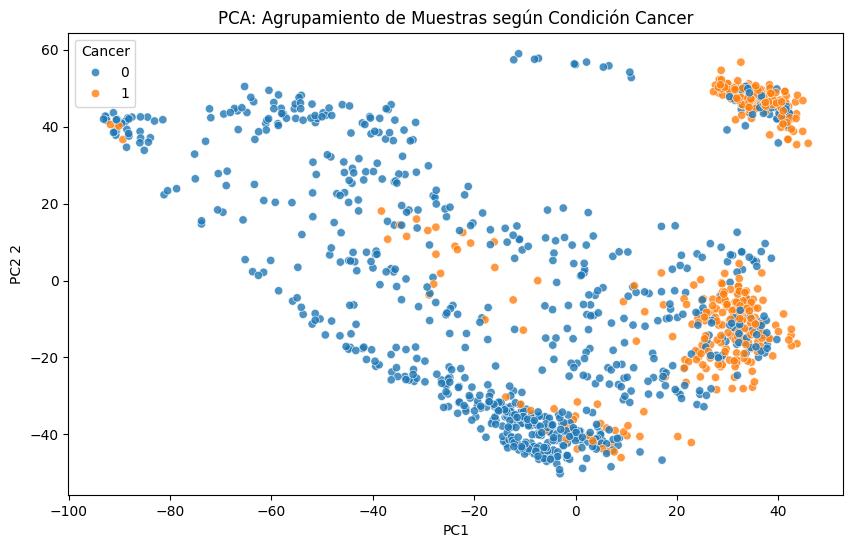

In [193]:
# Realizar PCA
pca = PCA(n_components=2)  # Usar las dos primeras componentes principales para poder graficarlo
pca_result = pca.fit_transform(X_train_mirna_metadata_selected_cols)

# Convertir el resultado en un DataFrame para facilitar el plotting
pca_df = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])

# Unir el resultado del PCA con la metadata para poder usar la condición (Cancer)
pca_df = pd.concat([pca_df, y_cancer_train_no_outliers], axis=1)


# Gráfico de dispersión con color basado en la condición de 'Cancer'
plt.figure(figsize=(10,6))
sns.scatterplot(
    x='PC1', y='PC2',
    hue='Cancer',
    palette=sns.color_palette("tab10", n_colors=2),
    data=pca_df,
    alpha=0.8  # Transparencia
)

plt.title('PCA: Agrupamiento de Muestras según Condición Cancer')
plt.xlabel('PC1')
plt.ylabel('PC2 2')
plt.legend(title='Cancer')
plt.show()


### 3.12.3. Isolation Forest

Se detectaron 172 muestras anómalas.


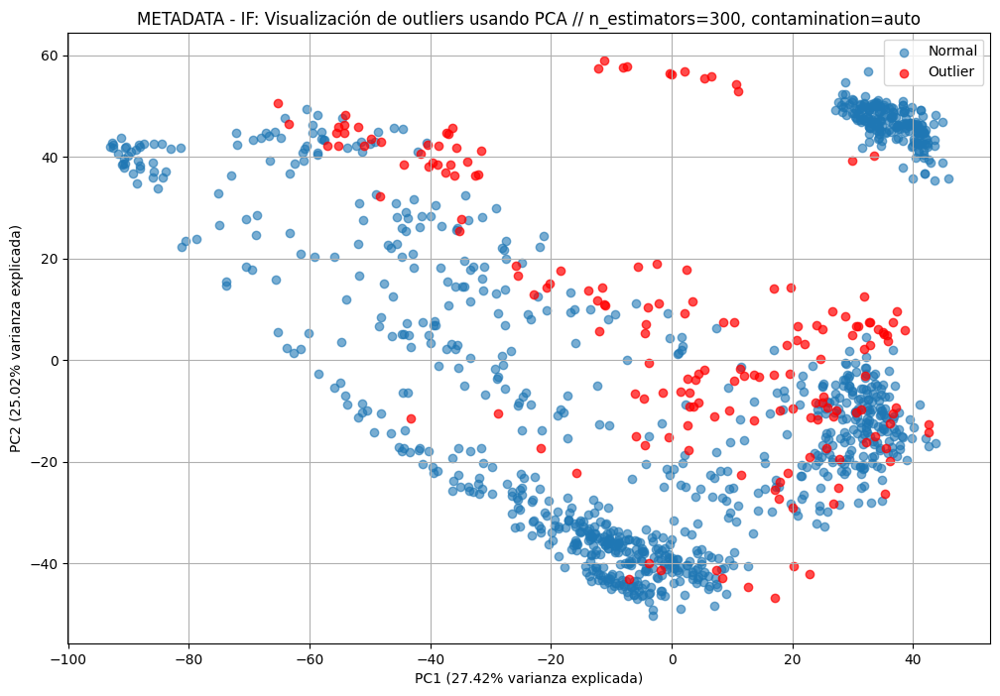

In [194]:
X_train_mirna_metadata_selected_cols_if = X_train_mirna_metadata_selected_cols.copy()

# Crear el modelo Isolation Forest
# n_estimators 100-300 ## Número de árboles en el bosque (precisión)
# max_samples auto/0.5-1.0 ## Fracción de muestras que se utilizarán para construir el árbol
# contamination auto/0.01-0.1 ## La proporción de outliers en el dataset
isolation_forest = IsolationForest(n_estimators=300, contamination="auto", random_state=42)

# Entrenar el modelo
isolation_forest.fit(X_train_mirna_metadata_selected_cols_if)

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_if = isolation_forest.predict(X_train_mirna_metadata_selected_cols_if)

# Añadir la predicción de outliers
X_train_mirna_metadata_selected_cols_if['Outlier'] = outliers_if

# Ver las muestras detectadas como outliers (-1)
outliers_detected_if = X_train_mirna_metadata_selected_cols_if[X_train_mirna_metadata_selected_cols_if['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_if)} muestras anómalas.")

# Visualización
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_metadata_selected_cols_if.drop('Outlier', axis=1))
# Calcular la varianza explicada
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
#plt.scatter(pca_result[:, 0], pca_result[:, 1], c=mirna_transposed_expression_if['Outlier'], cmap='coolwarm')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_metadata_selected_cols_if['Outlier'] == 1, 0],
            pca_result[X_train_mirna_metadata_selected_cols_if['Outlier'] == 1, 1],
            label='Normal', alpha=0.6)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_metadata_selected_cols_if['Outlier'] == -1, 0],
            pca_result[X_train_mirna_metadata_selected_cols_if['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.7)

# Añadir títulos y etiquetas de ejes
plt.title('METADATA - IF: Visualización de outliers usando PCA // n_estimators=300, contamination=auto')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.grid(True)
plt.legend()
plt.show()

### 3.12.4. LOF

Se detectaron 32 muestras anómalas.


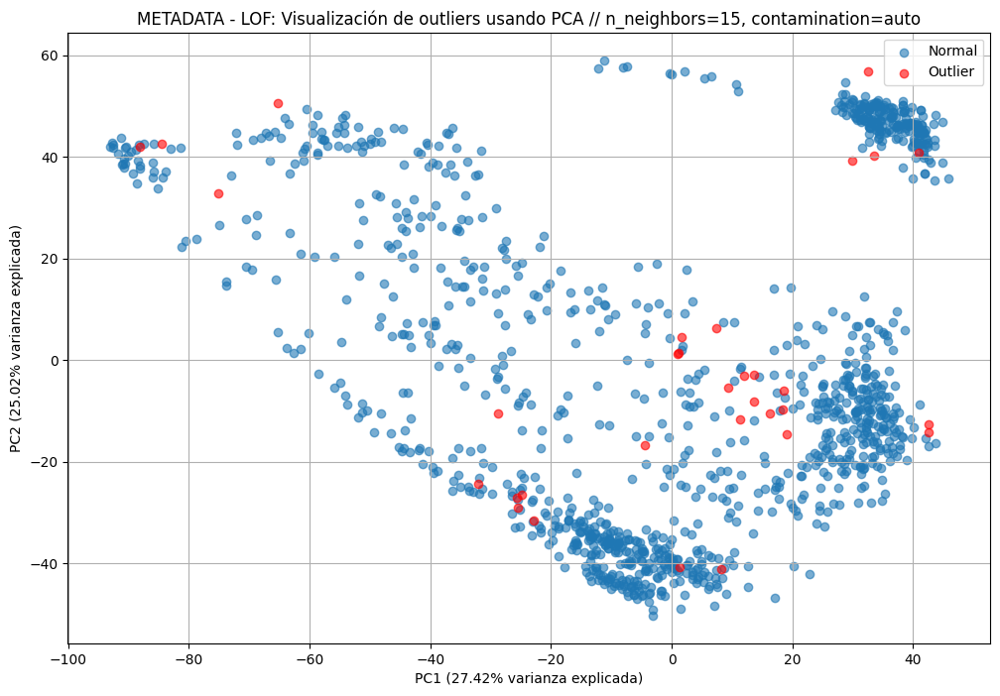

In [195]:
X_train_mirna_metadata_selected_cols_lof = X_train_mirna_metadata_selected_cols.copy()

# Crear el modelo LOF
# n_neighbors 10-30 ## Cuántos vecinos se usarán para construir la densidad local
# contamination
lof = LocalOutlierFactor(n_neighbors=10, contamination='auto')  # Ajusta n_neighbors según tus necesidades

# Predecir anomalías
# Las muestras normales tendrán un valor de 1 y las anomalías -1
outliers_lof = lof.fit_predict(X_train_mirna_metadata_selected_cols_lof)

# Añadir la predicción de outliers
X_train_mirna_metadata_selected_cols_lof['Outlier'] = outliers_lof

# Ver las muestras detectadas como outliers (-1)
outliers_detected_lof = X_train_mirna_metadata_selected_cols_lof[X_train_mirna_metadata_selected_cols_lof['Outlier'] == -1]

# Mostrar resumen de resultados
print(f"Se detectaron {len(outliers_detected_lof)} muestras anómalas.")

# Visualización simple
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_metadata_selected_cols_lof.drop('Outlier', axis=1))
# Calcular la varianza explicada
explained_variance = pca.explained_variance_ratio_

# Gráfico PCA para visualizar los outliers
plt.figure(figsize=(12,8))
# plt.scatter(pca_result[:, 0], pca_result[:, 1], c=mirna_transposed_expression_lof['Outlier'], cmap='coolwarm')

# Dibujar puntos normales
plt.scatter(pca_result[X_train_mirna_metadata_selected_cols_lof['Outlier'] == 1, 0],
            pca_result[X_train_mirna_metadata_selected_cols_lof['Outlier'] == 1, 1],
            label='Normal', alpha=0.6)

# Dibujar outliers
plt.scatter(pca_result[X_train_mirna_metadata_selected_cols_lof['Outlier'] == -1, 0],
            pca_result[X_train_mirna_metadata_selected_cols_lof['Outlier'] == -1, 1],
            c='red', label='Outlier', alpha=0.6)

# Añadir títulos y etiquetas de ejes
plt.title('METADATA - LOF: Visualización de outliers usando PCA // n_neighbors=15, contamination=auto')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
plt.legend()
plt.grid(True)
plt.show()

### 3.12.5. Outlier selection

In [196]:
# Crear un DataFrame con los outliers
outliers_df = pd.DataFrame({
    'outliers_if': outliers_if,
    'outliers_lof': outliers_lof
})

# Contar cuántas veces cada muestra es outlier
outliers_df['outlier_count'] = (outliers_df == -1).sum(axis=1)

# Crear una nueva variable que indique si una muestra es outlier en las dos
outliers_df['is_outlier'] = outliers_df['outlier_count'] >= 2

# Crear un DataFrame final que incluya el nombre de la muestra y si es outlier o no
experiment_outlier = pd.DataFrame({
    'Experiment': X_train_mirna_metadata_experiment,
    'Is_Outlier': outliers_df['is_outlier']
})

# Imprimir el número total de outliers
total_outliers = experiment_outlier['Is_Outlier'].sum()
print(f"El número total de outliers es: {total_outliers}")

El número total de outliers es: 9


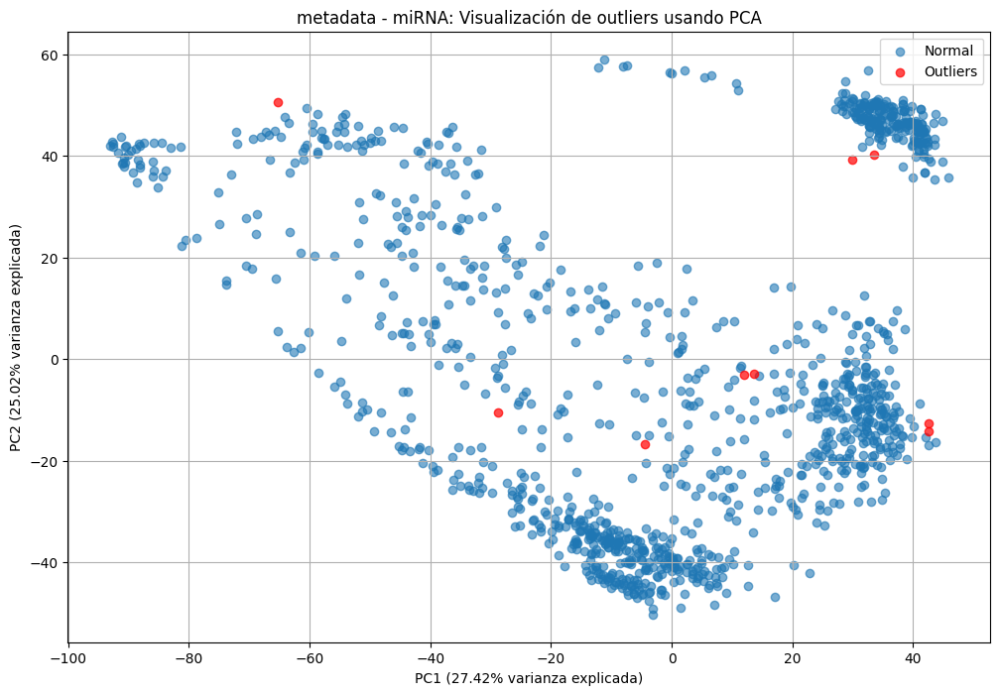

In [197]:
# Aplicar PCA
pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_train_mirna_metadata_selected_cols)
# Calcular la varianza explicada
explained_variance = pca.explained_variance_ratio_

# Crear un DataFrame para los resultados de PCA
pca_df = pd.DataFrame(data=pca_result, columns=['PC1', 'PC2'])
pca_df['Is_Outlier'] = experiment_outlier['Is_Outlier']

# Visualizar los resultados
plt.figure(figsize=(12, 8))
#plt.scatter(pca_result[:, 0], pca_result[:, 1], c=experiment_outlier['Is_Outlier'], cmap='coolwarm', alpha=0.8)
plt.scatter(pca_df[pca_df['Is_Outlier'] == False]['PC1'],
            pca_df[pca_df['Is_Outlier'] == False]['PC2'],
            label='Normal', alpha=0.6)

plt.scatter(pca_df[pca_df['Is_Outlier'] == True]['PC1'],
            pca_df[pca_df['Is_Outlier'] == True]['PC2'],
            color='red', label='Outliers', alpha=0.7)
#sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Is_Outlier', palette={True: 'red', False: 'blue'}, alpha=0.8)
plt.title('metadata - miRNA: Visualización de outliers usando PCA')
plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
#plt.legend(labels=['Outlier', 'Normal'])
plt.legend()
plt.grid(True)

plt.show()

In [198]:
X_train_mirna_metadata_no_outliers = X_train_mirna_metadata.copy()
X_train_mirna_metadata_no_outliers['Is_Outlier'] = experiment_outlier['Is_Outlier']
X_train_mirna_metadata_no_outliers.columns

Index(['Experiment', 'hsa-miR-99b-3p', 'hsa-miR-136-5p', 'hsa-miR-106b-5p',
       'hsa-miR-29a-3p', 'hsa-miR-26a-5p', 'hsa-miR-885-5p', 'hsa-let-7i-5p',
       'hsa-miR-136-3p', 'hsa-miR-3074-5p',
       ...
       'Fluid_whole blood', 'Extraction_TRIzol', 'Extraction_miRCURY',
       'Extraction_miRNeasy', 'Extraction_mirVana', 'Extraction_nan',
       'Library_NEBNext', 'Library_NEXTflex', 'Library_nan', 'Is_Outlier'],
      dtype='object', length=451)

In [199]:
# Guardar los índices de las filas a eliminar
indices_to_remove = X_train_mirna_metadata_no_outliers[X_train_mirna_metadata_no_outliers['Is_Outlier'] == True].index

In [200]:
# Elimina las filas donde 'Is_Outlier' sea True
X_train_mirna_metadata_no_outliers = X_train_mirna_metadata_no_outliers[X_train_mirna_metadata_no_outliers['Is_Outlier'] != True]
X_train_mirna_metadata_no_outliers.reset_index(inplace=True, drop=True)

In [201]:
X_train_mirna_metadata_no_outliers = X_train_mirna_metadata_no_outliers.drop(columns=['Is_Outlier'])

In [202]:
# Eliminar las filas correspondientes en los otros dataset

y_cancer_train_no_outliers = y_cancer_train_no_outliers.drop(indices_to_remove)
y_cancer_train_no_outliers.reset_index(inplace=True, drop=True)

In [203]:
X_train_mirna_metadata_no_outliers.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1194 entries, 0 to 1193
Columns: 450 entries, Experiment to Library_nan
dtypes: float64(445), int64(2), object(3)
memory usage: 4.1+ MB


In [204]:
y_cancer_train_no_outliers.info()

<class 'pandas.core.series.Series'>
RangeIndex: 1194 entries, 0 to 1193
Series name: Cancer
Non-Null Count  Dtype
--------------  -----
1194 non-null   int64
dtypes: int64(1)
memory usage: 9.5 KB


### 3.12.6. Resumen Variables: Eliminación de Outliers
- X_train_mirna_metadata_no_outliers
- X_test_mirna_metadata
- y_cancer_train_no_outliers
- y_cancer_test_encoded

In [205]:
X_train_mirna_metadata_no_outliers.columns[-35:]

Index(['hsa-miR-1304-3p', 'SRP', 'Sample', 'Sex', 'Healthy', 'Exosome',
       'Instrument_Illumina Genome Analyzer II',
       'Instrument_Illumina Genome Analyzer IIx',
       'Instrument_Illumina HiScanSQ', 'Instrument_Illumina HiSeq 2000',
       'Instrument_Illumina HiSeq 2500', 'Instrument_Illumina HiSeq 4000',
       'Instrument_Illumina MiSeq', 'Instrument_NextSeq 500', 'Fluid_bile',
       'Fluid_blood cells', 'Fluid_breast milk',
       'Fluid_bronchoalveolar lavage', 'Fluid_cerebrospinal fluid',
       'Fluid_exosomes', 'Fluid_ovarian follicle fluid', 'Fluid_plasma',
       'Fluid_seminal fluid', 'Fluid_serum', 'Fluid_urine',
       'Fluid_urine cells', 'Fluid_whole blood', 'Extraction_TRIzol',
       'Extraction_miRCURY', 'Extraction_miRNeasy', 'Extraction_mirVana',
       'Extraction_nan', 'Library_NEBNext', 'Library_NEXTflex', 'Library_nan'],
      dtype='object')

## 3.13. miRNA & metaData - Limpieza de Datos: Valores faltantes

Al realizar la verificación, es necesario tener en cuenta que las variables 'Extraction' y 'Library' también tienen valores faltantes. Sin embargo, tras haber aplicado One-Hot Encoding, estas están en columnas específicas.

In [206]:
# Verificar cuántos valores faltantes tiene cada columna
missing_values = X_train_mirna_metadata_no_outliers.isnull().sum()

# Mostrar las columnas que tienen valores faltantes y el conteo
missing_values = missing_values[missing_values > 0]
print(missing_values)

Sex    352
dtype: int64


In [207]:
# Verificar cuántos valores faltantes tiene cada columna
missing_values = X_test_mirna_metadata.isnull().sum()

# Mostrar las columnas que tienen valores faltantes y el conteo
missing_values = missing_values[missing_values > 0]
print(missing_values)

Sex    94
dtype: int64


### 3.13.1. Seleccionar las columnas adecuadas

La columna 'Sex' es relevante en el análisis de expresión de miRNA debido a que existen diferencias biológicas importantes entre hombres y mujeres que pueden afectar la expresión de ciertos miRNAs, influyendo así en la detección de enfermedades. El sexo es una característica biológica clave que puede impactar directamente en el desarrollo y diagnóstico de condiciones patológicas, por lo que su inclusión y correcto tratamiento es crucial para mejorar la precisión del modelo. En contraste, las columnas 'Extraction' y 'Library' representan factores técnicos relacionados con los métodos de extracción de RNA y preparación de bibliotecas para la secuenciación. Aunque estos procesos pueden introducir cierta variabilidad en los datos, su influencia es más técnica que biológica, y no están directamente vinculados con las diferencias en la expresión de miRNA causadas por las condiciones de salud de los pacientes. Como resultado, su relevancia para el objetivo de predecir enfermedades es limitada, y, a menos que muestren un impacto significativo en la calidad de los datos, podrían no ser necesarias para el modelo final. Estas dos columnas no se tendrán en cuenta para imputar los valores falantes en mirna.

La columnas de metedata que se utilizarán para imputar valores faltantes, junto con las expresiones de miRNA, son:
- Exosome: Esta es la que puede aportar más. Relacionado con la presencia de exosomas, podría tener alguna correlación con el tipo de fluido o el sexo del paciente.
- Fluid (tipo de biofluido): Los diferentes tipos de fluidos pueden estar correlacionados con el sexo. Por ejemplo, "seminal fluid" o "breast milk" son específicos de un sexo.
- Healthy: La salud y el sexo pueden estar estrechamente realcionadas entre sí, ya que ciertos canceres afectan más a un sexo que al contrario.

In [208]:
X_train_mirna_metadata_no_outliers.columns[416]

'SRP'

In [209]:
# Lista de columnas mirna a seleccionar
columns_to_select = X_train_mirna_metadata_no_outliers.columns[0:416].tolist()
columns_to_select += ['Sex', 'Exosome', 'Healthy']
fluid_columns = [col for col in X_train_mirna_metadata_no_outliers.columns if col.startswith('Fluid')]
columns_to_select += fluid_columns

In [210]:
X_train_mirna_metadata_no_outliers_selected_cols = X_train_mirna_metadata_no_outliers[columns_to_select]
X_train_mirna_metadata_no_outliers_selected_cols

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,Fluid_bronchoalveolar lavage,Fluid_cerebrospinal fluid,Fluid_exosomes,Fluid_ovarian follicle fluid,Fluid_plasma,Fluid_seminal fluid,Fluid_serum,Fluid_urine,Fluid_urine cells,Fluid_whole blood
0,SRX2539128,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,SRX2956350,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,SRX2956137,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,SRX2956358,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,SRX2540517,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1189,SRX1099428,8.827399,6.430007,4.795648,12.210311,12.044808,9.567880,14.989831,10.828011,5.329763,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1190,SRX2742164,0.000000,0.000000,10.422585,8.395104,13.685238,0.000000,15.676119,0.000000,4.605249,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1191,SRX3848863,4.822627,8.008994,5.293413,8.581847,9.219401,3.575214,7.265556,5.481453,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1192,SRX1099330,8.945555,6.509042,4.719664,12.203863,12.241571,9.157081,15.328120,10.992907,5.182185,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [211]:
X_test_mirna_metadata_selected_cols = X_test_mirna_metadata[columns_to_select]
X_test_mirna_metadata_selected_cols

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,Fluid_bronchoalveolar lavage,Fluid_cerebrospinal fluid,Fluid_exosomes,Fluid_ovarian follicle fluid,Fluid_plasma,Fluid_seminal fluid,Fluid_serum,Fluid_urine,Fluid_urine cells,Fluid_whole blood
0,SRX2956186,1.298593,0.000000,9.753325,13.251531,16.628147,0.000000,13.575523,0.000000,2.773903,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,SRX2539186,6.581866,3.153727,6.207865,9.376254,15.809010,4.824996,15.264243,3.717331,3.153727,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2,SRX2359242,1.331169,2.967592,11.257569,9.971639,14.384357,2.077803,13.138590,7.408132,4.318376,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,SRX2956288,1.256379,1.256379,9.161270,13.537516,16.921110,0.000000,14.035791,3.422594,2.161045,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,SRX2956220,3.656580,0.000000,9.035993,14.846308,17.849155,0.000000,14.030891,1.293572,2.210499,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,SRX1099479,9.026138,7.399957,5.103071,11.684183,10.723401,8.255027,15.163786,10.554954,4.997139,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
301,SRX098326,6.792578,1.374152,10.606113,13.632616,14.039061,8.980584,13.009725,0.213149,2.733820,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
302,SRX326620,3.583996,2.653616,12.194899,11.088127,12.702208,3.315626,12.169305,3.255396,1.944771,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
303,SRX1169939,0.000000,0.000000,8.972269,7.221663,13.733764,0.000000,11.827071,0.000000,5.438272,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


### 3.13.2. Data Leakage

Es crucial hacer el fit del imputador únicamente en el conjunto de entrenamiento y luego aplicar el transform tanto en el conjunto de entrenamiento como en el de prueba para evitar el Data Leakage.

### 3.13.3. Imputación de Valores Faltantes (KNN)

In [212]:
X_train_mirna_metadata_no_outliers_selected_cols['Sex'].dtype

dtype('float64')

In [213]:
unique_values = X_train_mirna_metadata_no_outliers_selected_cols['Sex'].unique()
unique_values

array([ 1., nan,  0.])

In [214]:
unique_values = X_test_mirna_metadata_selected_cols['Sex'].unique()
unique_values

array([ 0.,  1., nan])

In [215]:
# Filtrar los datos donde 'Experiment' es igual a 1454
filtered_df = X_train_mirna_metadata_no_outliers_selected_cols[X_train_mirna_metadata_no_outliers_selected_cols['Sex'] == 1]

# Imprimir los valores de la columna 'Name'
print(filtered_df['Experiment'])

0       SRX2539128
5       SRX2539138
8       SRX2956232
9       SRX1169951
12      SRX1099326
           ...    
1177    SRX2539227
1178    SRX1169937
1180    SRX2539169
1182    SRX1169950
1192    SRX1099330
Name: Experiment, Length: 442, dtype: object


In [216]:
# Filtrar los datos donde 'Experiment' es igual a 1454
filtered_df = metadata_raw[metadata_raw['Experiment'] == 'SRX262174']

# Imprimir los valores de la columna 'Sex'
print(filtered_df['Sex'])

22    female
Name: Sex, dtype: object


In [217]:
X_train_mirna_metadata_imputed = X_train_mirna_metadata_no_outliers.copy()
X_test_mirna_metadata_imputed = X_test_mirna_metadata.copy()

# Columnas seleccionadas
X_train_cols_to_impute = X_train_mirna_metadata_no_outliers_selected_cols.drop('Experiment', axis=1)
X_test_cols_to_impute = X_test_mirna_metadata_selected_cols.drop('Experiment', axis=1)

# Crear el imputador KNN. sqrt(1491)=38.61
knn_imputer = KNNImputer(n_neighbors=30)

# Ajustar (fit) al conjunto de entrenamiento y transformar
X_train_imputed = knn_imputer.fit_transform(X_train_cols_to_impute)

# Aplicar (transform) el imputador tanto al conjunto de prueba
X_test_imputed = knn_imputer.transform(X_test_cols_to_impute)

# Convertir nuevamente a DataFrame, si es necesario
X_train_imputed_df = pd.DataFrame(X_train_imputed, columns=X_train_cols_to_impute.columns)
X_test_imputed_df = pd.DataFrame(X_test_imputed, columns=X_test_cols_to_impute.columns)

# Redondear los valores de 'Sex' a 0 o 1
X_train_imputed_df['Sex'] = X_train_imputed_df['Sex'].round(0)
X_test_imputed_df['Sex'] = X_test_imputed_df['Sex'].round(0)

# Actualizar la columna 'Sex' en el dataframe original con los valores imputados
X_train_mirna_metadata_imputed['Sex'] = X_train_imputed_df['Sex']
X_test_mirna_metadata_imputed['Sex'] = X_test_imputed_df['Sex']

# Verificar los valores únicos en la columna 'Sex' después de la imputación
print(X_train_mirna_metadata_imputed['Sex'].value_counts(dropna=False))
print(X_test_mirna_metadata_imputed['Sex'].value_counts(dropna=False))

Sex
1.0    664
0.0    530
Name: count, dtype: int64
Sex
1.0    168
0.0    137
Name: count, dtype: int64


In [218]:
unique_values = X_train_mirna_metadata_imputed['Sex'].unique()
unique_values

array([1., 0.])

In [219]:
unique_values = X_test_mirna_metadata_imputed['Sex'].unique()
unique_values

array([0., 1.])

### 3.13.4. Resumen Variables: Imputación de Missing Values
- X_train_mirna_metadata_imputed --> X_train_mirna_metadata_imputed_dropped_cols
- X_test_mirna_metadata_imputed  --> X_test_mirna_metadata_imputed_dropped_cols
- y_healthy_train_no_outliers
- y_healthy_test_encoded
- y_cancer_train_no_outliers
- y_cancer_test_encoded

**IMPORTANTE:** Se eliminan las columnas SRP y Sample

In [220]:
X_train_mirna_metadata_imputed_dropped_cols = X_train_mirna_metadata_imputed.drop(columns=['SRP', 'Sample'])
X_test_mirna_metadata_imputed_dropped_cols = X_test_mirna_metadata_imputed.drop(columns=['SRP', 'Sample'])

In [221]:
X_train_mirna_metadata_imputed_dropped_cols.columns[0]

'Experiment'

In [222]:
X_train_mirna_metadata_imputed_dropped_cols.columns[-35:]

Index(['hsa-miR-1304-5p', 'hsa-miR-99b-5p', 'hsa-miR-1304-3p', 'Sex',
       'Healthy', 'Exosome', 'Instrument_Illumina Genome Analyzer II',
       'Instrument_Illumina Genome Analyzer IIx',
       'Instrument_Illumina HiScanSQ', 'Instrument_Illumina HiSeq 2000',
       'Instrument_Illumina HiSeq 2500', 'Instrument_Illumina HiSeq 4000',
       'Instrument_Illumina MiSeq', 'Instrument_NextSeq 500', 'Fluid_bile',
       'Fluid_blood cells', 'Fluid_breast milk',
       'Fluid_bronchoalveolar lavage', 'Fluid_cerebrospinal fluid',
       'Fluid_exosomes', 'Fluid_ovarian follicle fluid', 'Fluid_plasma',
       'Fluid_seminal fluid', 'Fluid_serum', 'Fluid_urine',
       'Fluid_urine cells', 'Fluid_whole blood', 'Extraction_TRIzol',
       'Extraction_miRCURY', 'Extraction_miRNeasy', 'Extraction_mirVana',
       'Extraction_nan', 'Library_NEBNext', 'Library_NEXTflex', 'Library_nan'],
      dtype='object')

In [223]:
X_train_mirna_metadata_imputed_dropped_cols.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1194 entries, 0 to 1193
Columns: 448 entries, Experiment to Library_nan
dtypes: float64(445), int64(2), object(1)
memory usage: 4.1+ MB


In [224]:
y_cancer_train_no_outliers.info()

<class 'pandas.core.series.Series'>
RangeIndex: 1194 entries, 0 to 1193
Series name: Cancer
Non-Null Count  Dtype
--------------  -----
1194 non-null   int64
dtypes: int64(1)
memory usage: 9.5 KB


## 3.14. miRNA & metaData - Balanceo de Clases

Existen varias técnicas para abordar el desbalanceo de clases, entre las cuales se incluyen el sobremuestreo, el submuestreo y el ajuste de pesos en la función de pérdida.

El **sobremuestreo** es la mejor opción para balancear las clases en este caso, ya que permite aumentar el número de muestras de la clase minoritaria sin perder información valiosa de la clase mayoritaria. El sobremuestreo ayuda a preservar el conjunto de datos completo. Además, al generar nuevas muestras sintéticas, como en el caso del uso de técnicas como **SMOTE**, se introducen variaciones en los datos que pueden mejorar la capacidad del modelo para generalizar y aprender patrones relevantes.

In [225]:
cancer_distribution = y_cancer_train_no_outliers.value_counts()
print(cancer_distribution)

Cancer
0    803
1    391
Name: count, dtype: int64


In [226]:
# Separar la columna 'Experiment' antes de aplicar SMOTE
X_train_mirna_metadata_imputed_dropped_cols_no_experiment = X_train_mirna_metadata_imputed_dropped_cols.drop(columns=['Experiment'])

# Inicializar SMOTE
smote = SMOTE(random_state=42)

# Aplicar SMOTE al conjunto combinado de etiquetas multiclase
X_train_mirna_metadata_balanced, y_cancer_train_balanced = smote.fit_resample(X_train_mirna_metadata_imputed_dropped_cols_no_experiment, y_cancer_train_no_outliers)

# Verificar la nueva distribución de clases
unique_values = y_cancer_train_balanced.unique()
print(unique_values)

[1 0]


In [227]:
# Contar el número de muestras originales
num_original_samples = X_train_mirna_metadata_imputed_dropped_cols.shape[0]

# Crear una lista con los nuevos nombres de experimentos para las muestras generadas por SMOTE
num_new_samples = X_train_mirna_metadata_balanced.shape[0] - num_original_samples
new_experiments = [f"SMOTE_{i}" for i in range(1, num_new_samples + 1)]

# Restaurar la columna 'Experiment'
X_train_mirna_metadata_balanced['Experiment'] = X_train_mirna_metadata_imputed_dropped_cols['Experiment'].tolist() + new_experiments

# Revisar los primeros resultados para verificar
X_train_mirna_metadata_balanced.head()


C:\Users\mnunezmartinez_viu\AppData\Local\Temp\ipykernel_15068\2689940872.py:9: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  X_train_mirna_metadata_balanced['Experiment'] = X_train_mirna_metadata_imputed_dropped_cols['Experiment'].tolist() + new_experiments


,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan,Experiment
0,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,9.671937,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,SRX2539128
1,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,5.492624,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,SRX2956350
2,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,2.795490,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,SRX2956137
3,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,5.838925,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,SRX2956358
4,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,7.401763,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,SRX2540517


In [228]:
# Verificar la nueva distribución de clases
cancer_distribution = y_cancer_train_balanced.value_counts()
print(cancer_distribution)

Cancer
1    803
0    803
Name: count, dtype: int64


expression: 0:415  
metadata: 416:446  
experiment: 447

In [229]:
exp_cols = list(X_train_mirna_metadata_balanced.columns[0:415])  # expresión: columnas 0 a 415
meta_cols = list(X_train_mirna_metadata_balanced.columns[415:447])  # metadata: columnas 415 a 447
experiment_col = X_train_mirna_metadata_balanced.columns[447]  # experiment: columna 447

In [230]:
exp_cols

['hsa-miR-99b-3p',
 'hsa-miR-136-5p',
 'hsa-miR-106b-5p',
 'hsa-miR-29a-3p',
 'hsa-miR-26a-5p',
 'hsa-miR-885-5p',
 'hsa-let-7i-5p',
 'hsa-miR-136-3p',
 'hsa-miR-3074-5p',
 'hsa-miR-199a-5p',
 'hsa-miR-106b-3p',
 'hsa-miR-4677-3p',
 'hsa-miR-21-5p',
 'hsa-miR-23a-5p',
 'hsa-let-7i-3p',
 'hsa-miR-548o-3p',
 'hsa-miR-199a-3p',
 'hsa-miR-21-3p',
 'hsa-miR-326',
 'hsa-miR-23a-3p',
 'hsa-miR-20a-5p',
 'hsa-miR-30d-5p',
 'hsa-let-7f-1-3p',
 'hsa-miR-193a-5p',
 'hsa-miR-30d-3p',
 'hsa-miR-873-5p',
 'hsa-miR-432-5p',
 'hsa-miR-7-5p',
 'hsa-miR-29b-2-5p',
 'hsa-miR-30c-2-3p',
 'hsa-miR-873-3p',
 'hsa-miR-505-5p',
 'hsa-miR-142-5p',
 'hsa-miR-3615',
 'hsa-miR-28-5p',
 'hsa-miR-505-3p',
 'hsa-miR-142-3p',
 'hsa-miR-215-5p',
 'hsa-miR-941',
 'hsa-miR-28-3p',
 'hsa-miR-125b-1-3p',
 'hsa-miR-16-5p',
 'hsa-let-7c-5p',
 'hsa-miR-100-5p',
 'hsa-miR-409-5p',
 'hsa-miR-24-1-5p',
 'hsa-miR-1468-5p',
 'hsa-miR-149-5p',
 'hsa-miR-409-3p',
 'hsa-miR-1260b',
 'hsa-miR-1260a',
 'hsa-miR-203a-3p',
 'hsa-miR-200

In [231]:
meta_cols

['Sex',
 'Healthy',
 'Exosome',
 'Instrument_Illumina Genome Analyzer II',
 'Instrument_Illumina Genome Analyzer IIx',
 'Instrument_Illumina HiScanSQ',
 'Instrument_Illumina HiSeq 2000',
 'Instrument_Illumina HiSeq 2500',
 'Instrument_Illumina HiSeq 4000',
 'Instrument_Illumina MiSeq',
 'Instrument_NextSeq 500',
 'Fluid_bile',
 'Fluid_blood cells',
 'Fluid_breast milk',
 'Fluid_bronchoalveolar lavage',
 'Fluid_cerebrospinal fluid',
 'Fluid_exosomes',
 'Fluid_ovarian follicle fluid',
 'Fluid_plasma',
 'Fluid_seminal fluid',
 'Fluid_serum',
 'Fluid_urine',
 'Fluid_urine cells',
 'Fluid_whole blood',
 'Extraction_TRIzol',
 'Extraction_miRCURY',
 'Extraction_miRNeasy',
 'Extraction_mirVana',
 'Extraction_nan',
 'Library_NEBNext',
 'Library_NEXTflex',
 'Library_nan']

In [232]:
experiment_col

'Experiment'

### 3.13.4. Resumen Variables: Balanceo de clases
- X_train_mirna_metadata_balanced
- X_test_mirna_metadata_imputed_dropped_cols
- y_cancer_train_balanced
- y_cancer_test_encoded

## 3.15. Variables tras el preprocesamiento

- X_train_clean
- X_test_clean
- X_train_mirna_clean
- X_test_mirna_clean
- X_train_metadata_clean
- X_test_metadata_clean
- y_cancer_train_clean
- y_cancer_test_clean

In [233]:
X_train_clean = X_train_mirna_metadata_balanced.copy()
X_test_clean = X_test_mirna_metadata_imputed_dropped_cols.copy()

X_train_mirna_clean = X_train_mirna_metadata_balanced[[X_train_mirna_metadata_balanced.columns[447]] + list(X_train_mirna_metadata_balanced.columns[0:415])]
X_test_mirna_clean = X_test_mirna_metadata_imputed_dropped_cols[list(X_test_mirna_metadata_imputed_dropped_cols.columns[0:416])]

X_train_metadata_clean = X_train_mirna_metadata_balanced[[X_train_mirna_metadata_balanced.columns[447]] + list(X_train_mirna_metadata_balanced.columns[415:447])]
X_test_metadata_clean = X_test_mirna_metadata_imputed_dropped_cols[[X_test_mirna_metadata_imputed_dropped_cols.columns[0]] + list(X_test_mirna_metadata_imputed_dropped_cols.columns[416:])]

y_cancer_train_clean = y_cancer_train_balanced.copy()
y_cancer_test_clean = y_cancer_test_encoded.copy()


In [234]:
X_train_clean

,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan,Experiment
0,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,9.671937,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,SRX2539128
1,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,5.492624,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,SRX2956350
2,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,2.795490,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,SRX2956137
3,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,5.838925,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,SRX2956358
4,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,7.401763,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,SRX2540517
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1601,5.781479,3.430570,7.408063,10.369643,14.731742,3.681878,15.162415,4.483644,3.083021,9.574077,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,SMOTE_408
1602,7.180748,1.683081,7.286178,9.342468,14.193393,0.895711,15.091258,2.568761,3.611499,9.647283,...,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,SMOTE_409
1603,9.513278,6.883073,4.369365,11.821397,10.949829,8.898811,15.065079,10.775482,5.137709,5.876730,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,SMOTE_410
1604,0.000000,0.000000,9.830525,7.047468,13.143194,0.000000,15.258418,0.000000,5.101536,7.437053,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,SMOTE_411


In [235]:
X_train_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1606 entries, 0 to 1605
Columns: 448 entries, hsa-miR-99b-3p to Experiment
dtypes: float64(445), int64(2), object(1)
memory usage: 5.5+ MB


In [236]:
X_train_mirna_clean

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,SRX2539128,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,...,6.005777,17.179671,6.417664,5.181464,5.163893,1.608804,9.413083,5.431997,8.970077,4.726746
1,SRX2956350,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,...,5.619158,21.638673,8.028001,7.752329,5.808130,0.000000,6.898628,0.000000,6.431232,7.010611
2,SRX2956137,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,...,4.446213,9.880981,8.303605,4.234808,3.987018,0.000000,0.000000,0.000000,5.510013,4.234808
3,SRX2956358,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,...,6.265335,22.112450,7.819897,8.196934,7.201842,0.000000,8.684904,0.000000,7.057034,6.790068
4,SRX2540517,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,...,5.549404,15.776228,6.302500,1.523648,7.796886,0.581466,7.945661,3.831523,11.516693,4.242178
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1601,SMOTE_408,5.781479,3.430570,7.408063,10.369643,14.731742,3.681878,15.162415,4.483644,3.083021,...,6.789648,17.620119,5.866023,3.760019,6.547693,0.987069,10.341737,5.430430,10.723556,5.029034
1602,SMOTE_409,7.180748,1.683081,7.286178,9.342468,14.193393,0.895711,15.091258,2.568761,3.611499,...,7.550948,18.898021,6.955345,3.829679,6.694078,0.895711,11.914110,6.320277,11.043526,6.438089
1603,SMOTE_410,9.513278,6.883073,4.369365,11.821397,10.949829,8.898811,15.065079,10.775482,5.137709,...,2.415570,8.631341,1.144527,1.198396,7.728549,3.598313,1.480496,0.000000,13.891859,0.000000
1604,SMOTE_411,0.000000,0.000000,9.830525,7.047468,13.143194,0.000000,15.258418,0.000000,5.101536,...,4.373316,19.797914,7.437895,8.600551,5.797424,0.000000,0.000000,4.385217,6.657454,5.189537


In [237]:
X_train_mirna_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1606 entries, 0 to 1605
Columns: 416 entries, Experiment to hsa-miR-1304-3p
dtypes: float64(415), object(1)
memory usage: 5.1+ MB


In [238]:
X_train_metadata_clean

,Experiment,Sex,Healthy,Exosome,Instrument_Illumina Genome Analyzer II,Instrument_Illumina Genome Analyzer IIx,Instrument_Illumina HiScanSQ,Instrument_Illumina HiSeq 2000,Instrument_Illumina HiSeq 2500,Instrument_Illumina HiSeq 4000,...,Fluid_urine cells,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan
0,SRX2539128,1.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1,SRX2956350,0.0,1,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,SRX2956137,0.0,1,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
3,SRX2956358,0.0,1,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,SRX2540517,1.0,0,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1601,SMOTE_408,1.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1602,SMOTE_409,1.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
1603,SMOTE_410,0.0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1604,SMOTE_411,0.0,0,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [239]:
X_train_metadata_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1606 entries, 0 to 1605
Data columns (total 33 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Experiment                               1606 non-null   object 
 1   Sex                                      1606 non-null   float64
 2   Healthy                                  1606 non-null   int64  
 3   Exosome                                  1606 non-null   int64  
 4   Instrument_Illumina Genome Analyzer II   1606 non-null   float64
 5   Instrument_Illumina Genome Analyzer IIx  1606 non-null   float64
 6   Instrument_Illumina HiScanSQ             1606 non-null   float64
 7   Instrument_Illumina HiSeq 2000           1606 non-null   float64
 8   Instrument_Illumina HiSeq 2500           1606 non-null   float64
 9   Instrument_Illumina HiSeq 4000           1606 non-null   float64
 10  Instrument_Illumina MiSeq                1606 no

In [240]:
y_cancer_train_clean

0       1
1       0
2       0
3       0
4       1
       ..
1601    1
1602    1
1603    1
1604    1
1605    1
Name: Cancer, Length: 1606, dtype: int64

In [241]:
X_test_clean

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,Fluid_urine cells,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan
0,SRX2956186,1.298593,0.000000,9.753325,13.251531,16.628147,0.000000,13.575523,0.000000,2.773903,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,SRX2539186,6.581866,3.153727,6.207865,9.376254,15.809010,4.824996,15.264243,3.717331,3.153727,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2,SRX2359242,1.331169,2.967592,11.257569,9.971639,14.384357,2.077803,13.138590,7.408132,4.318376,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,SRX2956288,1.256379,1.256379,9.161270,13.537516,16.921110,0.000000,14.035791,3.422594,2.161045,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,SRX2956220,3.656580,0.000000,9.035993,14.846308,17.849155,0.000000,14.030891,1.293572,2.210499,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,SRX1099479,9.026138,7.399957,5.103071,11.684183,10.723401,8.255027,15.163786,10.554954,4.997139,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
301,SRX098326,6.792578,1.374152,10.606113,13.632616,14.039061,8.980584,13.009725,0.213149,2.733820,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
302,SRX326620,3.583996,2.653616,12.194899,11.088127,12.702208,3.315626,12.169305,3.255396,1.944771,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
303,SRX1169939,0.000000,0.000000,8.972269,7.221663,13.733764,0.000000,11.827071,0.000000,5.438272,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [242]:
X_test_mirna_clean

,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,SRX2956186,1.298593,0.000000,9.753325,13.251531,16.628147,0.000000,13.575523,0.000000,2.773903,...,4.562443,8.678667,8.515591,4.950829,6.121322,0.000000,2.217145,0.000000,5.508639,4.690312
1,SRX2539186,6.581866,3.153727,6.207865,9.376254,15.809010,4.824996,15.264243,3.717331,3.153727,...,8.440302,16.716829,6.572685,4.171074,7.040518,0.000000,10.295795,6.231392,11.607654,6.195957
2,SRX2359242,1.331169,2.967592,11.257569,9.971639,14.384357,2.077803,13.138590,7.408132,4.318376,...,6.566915,21.570470,8.795874,7.754234,7.084705,2.740980,12.038622,3.735309,9.583780,7.003934
3,SRX2956288,1.256379,1.256379,9.161270,13.537516,16.921110,0.000000,14.035791,3.422594,2.161045,...,5.438396,10.139726,8.892779,4.914949,5.692004,0.000000,1.624537,1.256379,7.401421,5.672492
4,SRX2956220,3.656580,0.000000,9.035993,14.846308,17.849155,0.000000,14.030891,1.293572,2.210499,...,6.436781,11.673218,8.286848,3.480187,4.976280,0.000000,4.722383,1.293572,11.000083,3.480187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,SRX1099479,9.026138,7.399957,5.103071,11.684183,10.723401,8.255027,15.163786,10.554954,4.997139,...,2.635530,11.159793,2.714056,1.257258,7.108057,4.279689,2.162218,1.453129,13.303094,0.761460
301,SRX098326,6.792578,1.374152,10.606113,13.632616,14.039061,8.980584,13.009725,0.213149,2.733820,...,9.680608,6.368034,4.691401,2.663053,8.241049,0.308970,0.000000,0.483404,11.629698,1.460150
302,SRX326620,3.583996,2.653616,12.194899,11.088127,12.702208,3.315626,12.169305,3.255396,1.944771,...,7.819720,15.249569,6.491107,5.503824,5.741929,3.285825,8.723020,3.285825,10.891292,7.246352
303,SRX1169939,0.000000,0.000000,8.972269,7.221663,13.733764,0.000000,11.827071,0.000000,5.438272,...,5.930953,23.301666,5.753530,13.040197,7.255385,0.000000,0.000000,4.684237,10.921054,5.438272


In [243]:
X_test_metadata_clean

,Experiment,Sex,Healthy,Exosome,Instrument_Illumina Genome Analyzer II,Instrument_Illumina Genome Analyzer IIx,Instrument_Illumina HiScanSQ,Instrument_Illumina HiSeq 2000,Instrument_Illumina HiSeq 2500,Instrument_Illumina HiSeq 4000,...,Fluid_urine cells,Fluid_whole blood,Extraction_TRIzol,Extraction_miRCURY,Extraction_miRNeasy,Extraction_mirVana,Extraction_nan,Library_NEBNext,Library_NEXTflex,Library_nan
0,SRX2956186,0.0,1,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
1,SRX2539186,1.0,0,0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0
2,SRX2359242,1.0,0,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
3,SRX2956288,0.0,1,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
4,SRX2956220,0.0,1,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,SRX1099479,1.0,0,1,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
301,SRX098326,1.0,1,1,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
302,SRX326620,1.0,0,0,0.0,0.0,0.0,0.0,1.0,0.0,...,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
303,SRX1169939,1.0,0,0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


---
# 4. Análisis Exploratorio de Datos (EDA) - Verificación del preprocesamiento
---

In [244]:
X_train_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1606 entries, 0 to 1605
Columns: 448 entries, hsa-miR-99b-3p to Experiment
dtypes: float64(445), int64(2), object(1)
memory usage: 5.5+ MB


In [245]:
def initial_exploration(df):
    # Mostrar las primeras filas del dataset
    print("Primeras 5 filas del dataset:")
    display(df.head())

    # Tipos de datos
    print("\nTipos de datos en el dataset:")
    print(df.dtypes)

    # Resumen estadístico
    print("\nResumen estadístico general:")
    display(df.describe())
    stats = df.describe()

    # Inspección de valores faltantes
    missing_values = df.isnull().sum()
    print("\nValores faltantes por columna:")
    print(missing_values[missing_values > 0])

    return stats

In [246]:
statistics_post = initial_exploration(X_train_mirna_clean)

Primeras 5 filas del dataset:


,Experiment,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,SRX2539128,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,...,6.005777,17.179671,6.417664,5.181464,5.163893,1.608804,9.413083,5.431997,8.970077,4.726746
1,SRX2956350,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,...,5.619158,21.638673,8.028001,7.752329,5.808130,0.000000,6.898628,0.000000,6.431232,7.010611
2,SRX2956137,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,...,4.446213,9.880981,8.303605,4.234808,3.987018,0.000000,0.000000,0.000000,5.510013,4.234808
3,SRX2956358,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,...,6.265335,22.112450,7.819897,8.196934,7.201842,0.000000,8.684904,0.000000,7.057034,6.790068
4,SRX2540517,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,...,5.549404,15.776228,6.302500,1.523648,7.796886,0.581466,7.945661,3.831523,11.516693,4.242178



Tipos de datos en el dataset:
Experiment          object
hsa-miR-99b-3p     float64
hsa-miR-136-5p     float64
hsa-miR-106b-5p    float64
hsa-miR-29a-3p     float64
                    ...   
hsa-miR-376a-3p    float64
hsa-miR-486-3p     float64
hsa-miR-1304-5p    float64
hsa-miR-99b-5p     float64
hsa-miR-1304-3p    float64
Length: 416, dtype: object

Resumen estadístico general:


,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
count,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,...,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000,1606.000000
mean,3.997633,2.834500,6.841834,10.253260,13.450810,3.329987,13.294240,4.647060,2.530553,5.573446,...,4.471219,14.005630,4.662605,3.386832,5.313799,1.872913,4.908534,1.710836,9.661249,3.120756
std,3.550729,2.837435,3.233456,3.134740,2.365117,3.734469,2.634712,4.325843,2.092258,3.469623,...,2.676440,4.983766,3.083335,3.222522,2.822628,2.288382,4.042765,2.227618,3.853828,2.837655
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,4.799210,8.853883,12.015802,0.000000,12.412309,0.000000,0.000000,3.227564,...,3.189568,10.444882,1.511614,0.360595,4.191587,0.000000,0.622788,0.000000,7.844026,0.000000
50%,4.220140,2.446859,7.102622,10.754970,13.691132,1.876398,13.994943,3.923872,2.791545,6.028224,...,4.921853,14.427325,6.080236,2.652882,6.118791,0.000000,4.116637,0.000000,10.367290,3.697647
75%,7.606432,5.827693,9.291561,12.133719,14.874050,7.710301,14.941854,9.395892,4.455937,8.492672,...,6.476301,17.648472,7.088339,5.242686,7.558304,3.938035,8.873276,3.653136,13.019968,5.782360
max,9.753511,12.647284,14.796108,16.373851,18.172558,11.802457,17.350936,12.305307,7.247542,12.696434,...,11.158509,23.686635,12.976559,12.536015,9.478764,12.743324,12.989834,7.255013,15.740408,8.503985



Valores faltantes por columna:
Series([], dtype: int64)


In [247]:
output_file_path = os.path.join(results_statistics_path, 'stats_mirna_processed.csv')
statistics_post.to_csv(output_file_path)

In [248]:
def plot_distributions(df, sample_size=30, random_state=42):
    # Seleccionar una muestra aleatoria de columnas (excluyendo la primera columna)
    selected_columns = np.random.RandomState(seed=random_state).choice(df.columns, size=sample_size, replace=False) # Indice de las columnas mirna
    selected_mirna = df[list(selected_columns)]

    # Definir número de columnas y filas
    n_cols = 3
    n_rows = len(selected_mirna.columns) // n_cols + (len(selected_mirna.columns) % n_cols > 0)

    # Crear la figura
    fig, axs = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols * 2, 4 * n_rows))

    for i, column in enumerate(selected_mirna.columns):
        row = i // n_cols
        col = i % n_cols
        sns.histplot(selected_mirna[column], bins=20, kde=True, ax=axs[row, col])
        axs[row, col].set_title(f'Distribución de {column}')

    # Eliminar ejes sobrantes
    for j in range(len(selected_mirna.columns), n_rows * n_cols):
        fig.delaxes(axs.flatten()[j])

    plt.tight_layout()
    plt.show()

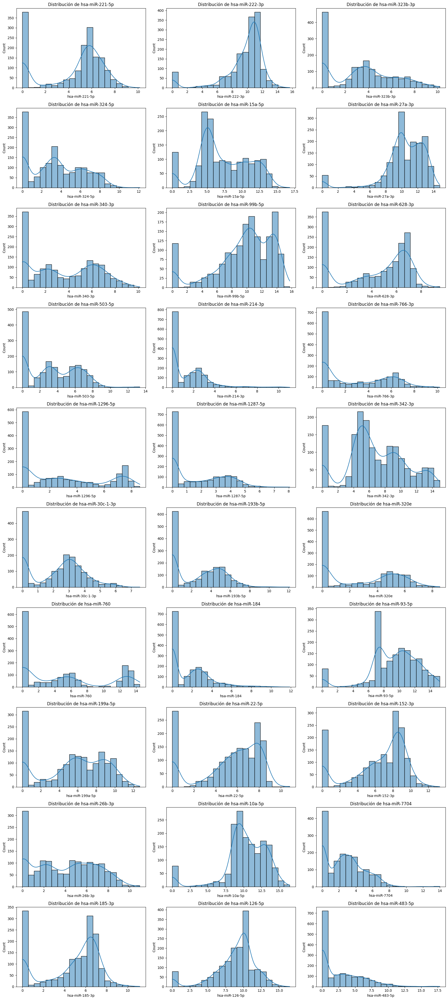

In [249]:
plot_distributions(X_train_mirna_clean.iloc[:,1:])

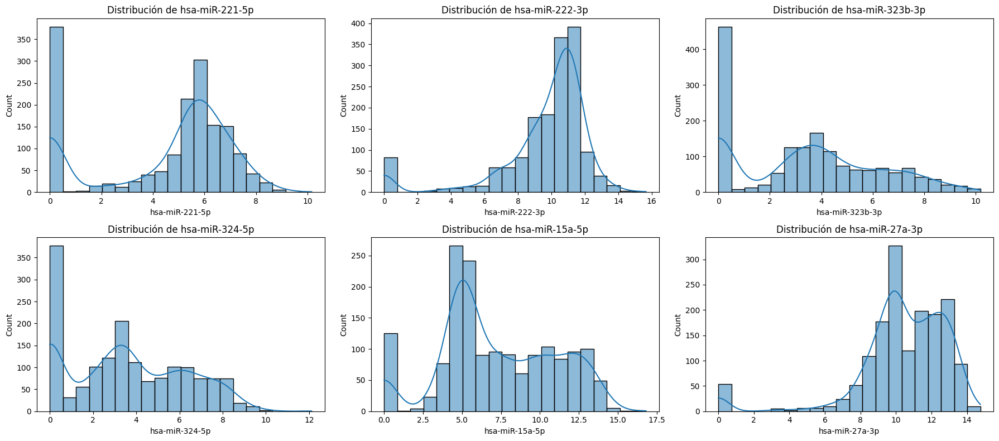

In [250]:
plot_distributions(X_train_mirna_clean.iloc[:,1:], sample_size=6)

In [251]:
def test_normality(df):
    shapiro_test = stats.shapiro(df)
    print("Prueba de Shapiro-Wilk:", shapiro_test)

In [252]:
test_normality(X_train_mirna_clean.iloc[:,1:])

Prueba de Shapiro-Wilk: ShapiroResult(statistic=np.float64(0.9175497012797244), pvalue=np.float64(1.9875192358098386e-142))


c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\scipy\stats\_axis_nan_policy.py:573: UserWarning: scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 666490.
  res = hypotest_fun_out(*samples, **kwds)


In [253]:
def test_normality_column(df):
    # Realizar prueba de Shapiro-Wilk en cada columna (excluyendo la primera)
    normality_results = {}
    for col in df.columns[1:]:
        stat, p_value = stats.shapiro(df[col].dropna())
        normality_results[col] = p_value
    return normality_results

In [254]:
test_normality_column(X_train_mirna_clean)

{'hsa-miR-99b-3p': np.float64(2.9193556039593875e-37),
 'hsa-miR-136-5p': np.float64(9.037410025396346e-38),
 'hsa-miR-106b-5p': np.float64(1.635648377228285e-22),
 'hsa-miR-29a-3p': np.float64(6.033725030508194e-35),
 'hsa-miR-26a-5p': np.float64(5.154691796232341e-36),
 'hsa-miR-885-5p': np.float64(1.511183392562753e-41),
 'hsa-let-7i-5p': np.float64(1.4089597267065703e-46),
 'hsa-miR-136-3p': np.float64(5.47009769692836e-37),
 'hsa-miR-3074-5p': np.float64(1.1958373069355775e-34),
 'hsa-miR-199a-5p': np.float64(5.799653765889864e-29),
 'hsa-miR-106b-3p': np.float64(8.351532030997844e-32),
 'hsa-miR-4677-3p': np.float64(4.702478671707244e-40),
 'hsa-miR-21-5p': np.float64(5.185501660696908e-46),
 'hsa-miR-23a-5p': np.float64(4.140666036289842e-41),
 'hsa-let-7i-3p': np.float64(1.5252927275900388e-35),
 'hsa-miR-548o-3p': np.float64(2.387108298739838e-36),
 'hsa-miR-199a-3p': np.float64(1.6658128444412177e-29),
 'hsa-miR-21-3p': np.float64(1.8761887074122807e-18),
 'hsa-miR-326': np.f

In [255]:
def detect_outliers_iql(df):
    # Calcular el primer y tercer cuartil (Q1, Q3) y el rango intercuartílico (IQR)
    Q1 = df.quantile(0.25)
    Q3 = df.quantile(0.75)
    IQR = Q3 - Q1

    # Identificar outliers: valores menores que (Q1 - 1.5*IQR) o mayores que (Q3 + 1.5*IQR)
    is_outlier = (df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))

    # Contar el número de outliers por columna
    outlier_counts = is_outlier.sum()

    # Filtrar las columnas que tienen al menos un outlier
    columns_with_outliers = outlier_counts[outlier_counts > 0]

    # Imprimir el número total de columnas con outliers
    total_columns_with_outliers = columns_with_outliers.count()
    print(f"Total de columnas que tienen outliers: {total_columns_with_outliers}")

    # Imprimir el nombre de las columnas y el número de outliers en cada una
    for column, count in columns_with_outliers.items():
        print(f"Columna '{column}' tiene {count} outliers")

In [256]:
detect_outliers_iql(X_train_mirna_clean.iloc[:,1:])

Total de columnas que tienen outliers: 163
Columna 'hsa-miR-29a-3p' tiene 79 outliers
Columna 'hsa-miR-26a-5p' tiene 23 outliers
Columna 'hsa-let-7i-5p' tiene 64 outliers
Columna 'hsa-miR-106b-3p' tiene 136 outliers
Columna 'hsa-miR-21-5p' tiene 56 outliers
Columna 'hsa-miR-23a-5p' tiene 23 outliers
Columna 'hsa-miR-199a-3p' tiene 122 outliers
Columna 'hsa-miR-21-3p' tiene 10 outliers
Columna 'hsa-miR-23a-3p' tiene 136 outliers
Columna 'hsa-miR-20a-5p' tiene 162 outliers
Columna 'hsa-miR-30d-5p' tiene 153 outliers
Columna 'hsa-miR-29b-2-5p' tiene 13 outliers
Columna 'hsa-miR-30c-2-3p' tiene 14 outliers
Columna 'hsa-miR-28-5p' tiene 203 outliers
Columna 'hsa-miR-28-3p' tiene 109 outliers
Columna 'hsa-miR-16-5p' tiene 42 outliers
Columna 'hsa-let-7c-5p' tiene 64 outliers
Columna 'hsa-miR-149-5p' tiene 1 outliers
Columna 'hsa-miR-203a-3p' tiene 1 outliers
Columna 'hsa-miR-200a-5p' tiene 65 outliers
Columna 'hsa-miR-221-3p' tiene 76 outliers
Columna 'hsa-miR-324-3p' tiene 265 outliers
Colu

In [257]:
def plot_boxplots(df, sample_size=30, random_state=42):
    selected_columns = np.random.RandomState(seed=random_state).choice(df.columns, size=sample_size, replace=False)
    selected_mirna = df[list(selected_columns)]

    n_cols = 3
    n_rows = len(selected_mirna.columns) // n_cols + (len(selected_mirna.columns) % n_cols > 0)

    fig, axs = plt.subplots(n_rows, n_cols, figsize=(3 * n_cols * 2, 4 * n_rows))

    for i, column in enumerate(selected_mirna.columns):
        row = i // n_cols
        col = i % n_cols
        sns.boxplot(y=column, data=selected_mirna, ax=axs[row, col])

    # Eliminar ejes sobrantes
    for j in range(len(selected_mirna.columns), n_rows * n_cols):
        fig.delaxes(axs.flatten()[j])

    plt.tight_layout()
    plt.show()

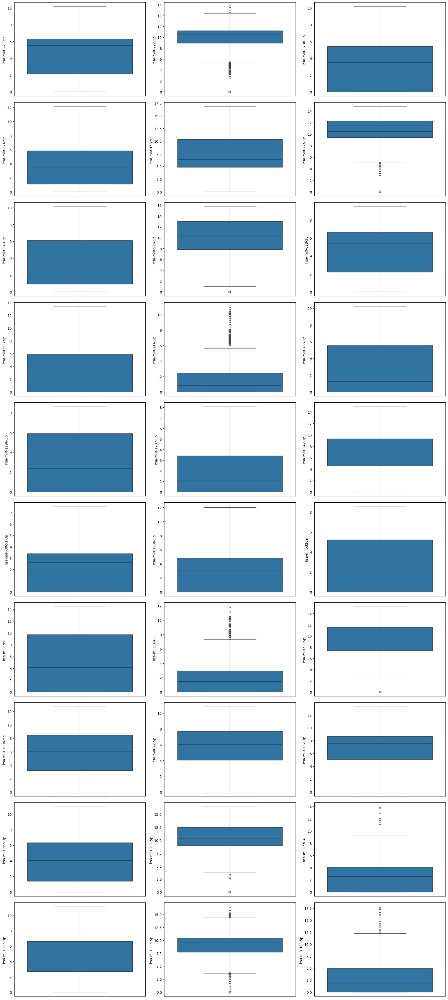

In [258]:
plot_boxplots(X_train_mirna_clean.iloc[:,1:])

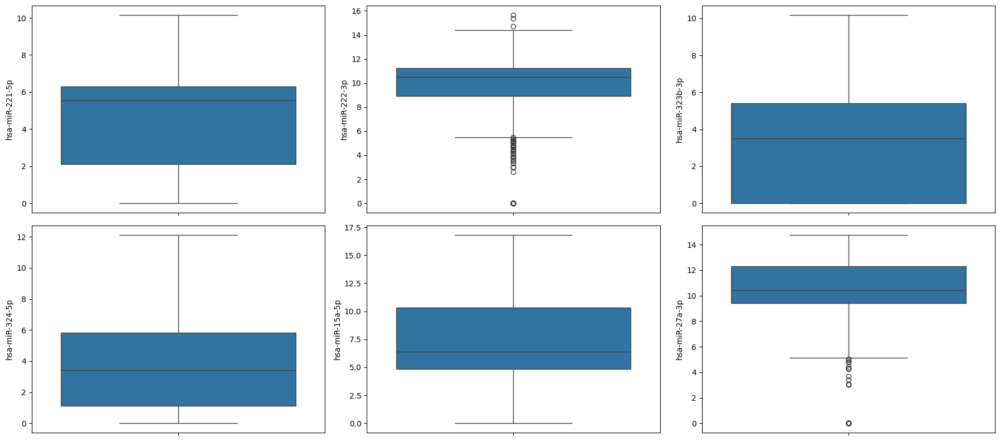

In [259]:
plot_boxplots(X_train_mirna_clean.iloc[:,1:], sample_size=6)

In [260]:
def correlation_heatmap(df, top_n=50, threshold_0_7=0.7, threshold_0_85=0.85):
    # Calcular la matriz de correlación
    correlation_matrix = df.corr()

    # Crear una máscara para excluir la diagonal y obtener los pares de correlación
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool), k=1)

    # Obtener correlaciones absolutas y aplicar la máscara
    abs_corr_matrix = correlation_matrix.abs()
    masked_corr_matrix = abs_corr_matrix.where(mask)

    # Encontrar los pares con alta correlación (> 0.7 y > 0.85)
    high_corr_0_7 = masked_corr_matrix.stack()[masked_corr_matrix.stack() > threshold_0_7]
    high_corr_0_85 = masked_corr_matrix.stack()[masked_corr_matrix.stack() > threshold_0_85]

    # Imprimir los resultados
    print(f"Número de pares con correlación absoluta > {threshold_0_7}: {len(high_corr_0_7)}")
    print(f"Número de pares con correlación absoluta > {threshold_0_85}: {len(high_corr_0_85)}")

    # Filtrar las top N correlaciones más altas (en valor absoluto)
    top_corr = masked_corr_matrix.stack().nlargest(top_n)

    # Extraer los miRNAs/metadata correspondientes a las top N correlaciones más altas
    top_miRNAs = pd.unique(top_corr.index.get_level_values(0).append(top_corr.index.get_level_values(1)))

    # Crear una submatriz de correlación para estos miRNAs
    top_corr_matrix = correlation_matrix.loc[top_miRNAs, top_miRNAs]

    # Visualizar la submatriz de correlación como un mapa de calor
    plt.figure(figsize=(27, 24))
    sns.heatmap(top_corr_matrix, annot=True, fmt=".2f", cmap='coolwarm', center=0, linewidths=0.5, linecolor='black')
    plt.title(f"Mapa de Calor de los {top_n} miRNAs con Mayor Correlación")
    plt.show()


Número de pares con correlación absoluta > 0.7: 3191
Número de pares con correlación absoluta > 0.85: 241


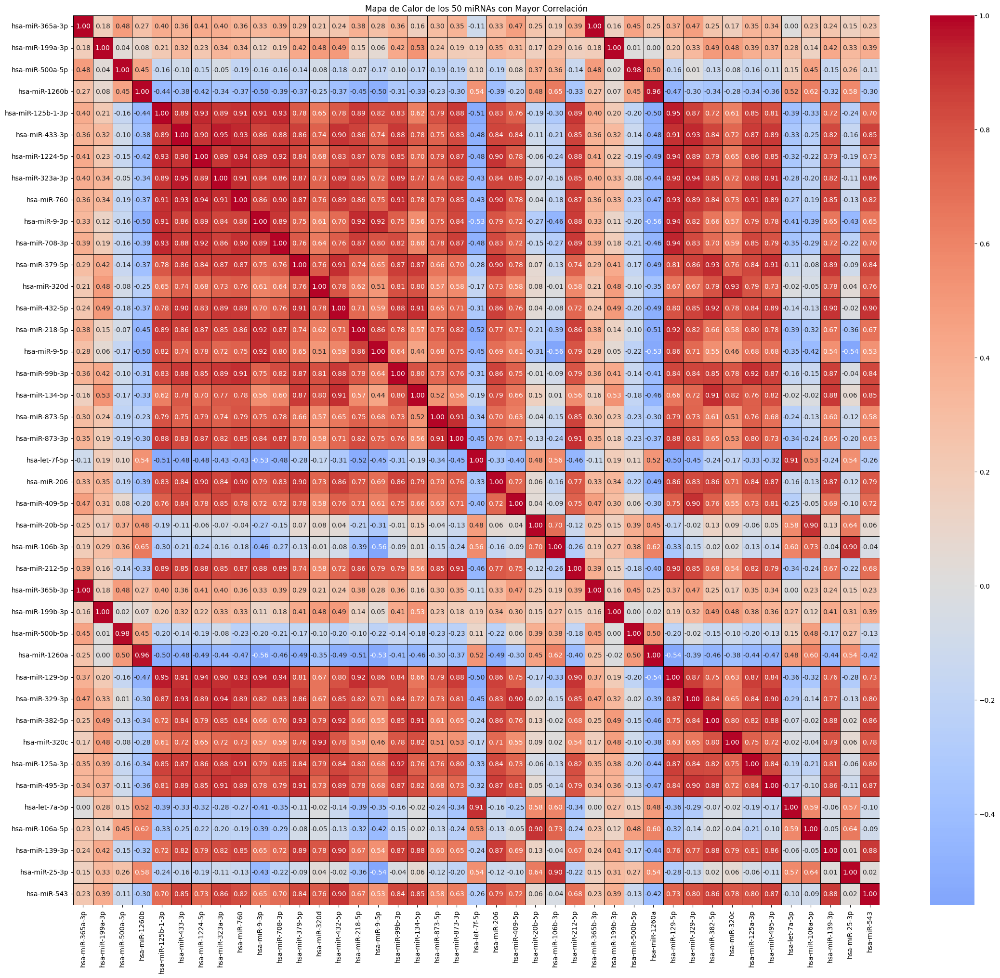

In [261]:
correlation_heatmap(X_train_mirna_clean.iloc[:,1:])

Número de pares con correlación absoluta > 0.7: 3191
Número de pares con correlación absoluta > 0.85: 241


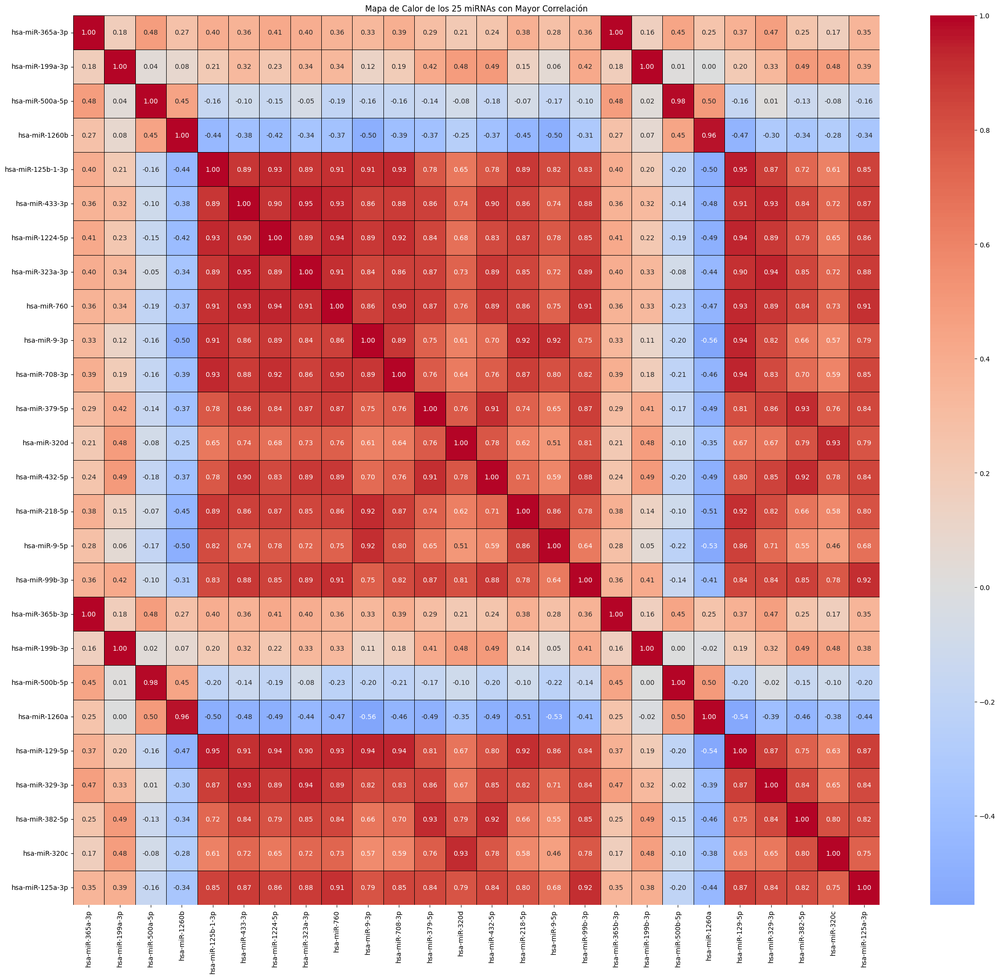

In [262]:
correlation_heatmap(X_train_mirna_clean.iloc[:,1:], top_n=25)

In [263]:
def mirna_cancer_correlations(df, y_cancer, method='pearson', top_n=50):

    data = df.copy()

    # Agregar las variables objetivo al dataframe de miRNA para calcular las correlaciones
    data['y_cancer'] = y_cancer

    # Calcular la correlación entre las variables de miRNA y las variables objetivo
    correlation_matrix = data.corr(method=method)

    # Filtrar solo las correlaciones de los miRNA con lasvariable y y_cancer
    data_correlations = correlation_matrix.loc[:, ['y_cancer']].drop(index=['y_cancer'])

    # Obtener las 50 correlaciones absolutas más altas
    top_corr_abs = data_correlations.abs().stack().nlargest(top_n).index

    # Crear un dataframe filtrado con las top 50 correlaciones
    top_corr = pd.Index([index[0] for index in top_corr_abs]).unique()
    top_data_correlations = data_correlations.loc[top_corr]

    # Dibujar el heatmap de las top 50 correlaciones
    plt.figure(figsize=(8, 10))
    sns.heatmap(top_data_correlations, annot=True, cmap='coolwarm', linewidths=0.5)
    plt.title(f"Heatmap de las Top {top_n} Correlaciones entre miRNA y Variables Objetivo ({method.capitalize()})")
    plt.show()

    return top_data_correlations

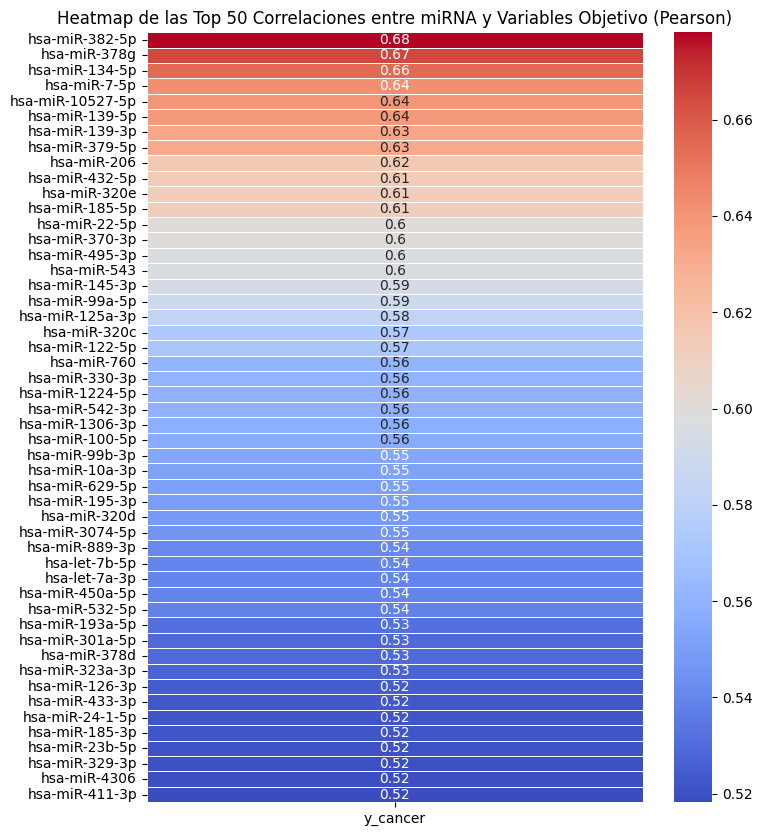

In [264]:
correlations = mirna_cancer_correlations(X_train_mirna_clean.iloc[:,1:], y_cancer_train_clean)

In [265]:
def pca_analysis_cancer(df, y_cancer, n_components=2, random_state=42):

    # Realizar PCA
    pca = PCA(n_components=n_components, random_state=random_state)
    pca_result = pca.fit_transform(df)
    # Obtener el porcentaje de varianza explicada por cada componente
    explained_variance = pca.explained_variance_ratio_

    # Crear un DataFrame con los resultados del PCA
    pca_df = pd.DataFrame(pca_result, columns=[f'PC{i+1}' for i in range(n_components)])

    # Agregar la columna de y y_cancer para realizar las divisiones
    pca_df['y_cancer'] = y_cancer

    # Gráfico PCA para todas las muestras, resaltando las que cumplen con y_cancer == 1
    plt.figure(figsize=(12, 8))
    # Graficar todos los puntos en gris
    sns.scatterplot(x='PC1', y='PC2', data=pca_df, color='lightgray', s=100, label='Todas las muestras')
    # Resaltar las muestras con y_cancer == 1
    sns.scatterplot(x='PC1', y='PC2', data=pca_df[pca_df['y_cancer'] == 1], color='red', s=100, label='Cancer = 1')
    plt.title("PCA - Resaltando Muestras con Cancer = 1")
    plt.xlabel(f'PC1 ({explained_variance[0]:.2%} varianza explicada)')
    plt.ylabel(f'PC2 ({explained_variance[1]:.2%} varianza explicada)')
    plt.grid(True)
    plt.legend()
    plt.show()

    # Retornar el DataFrame del PCA por si se quiere usar más adelante
    return pca_df

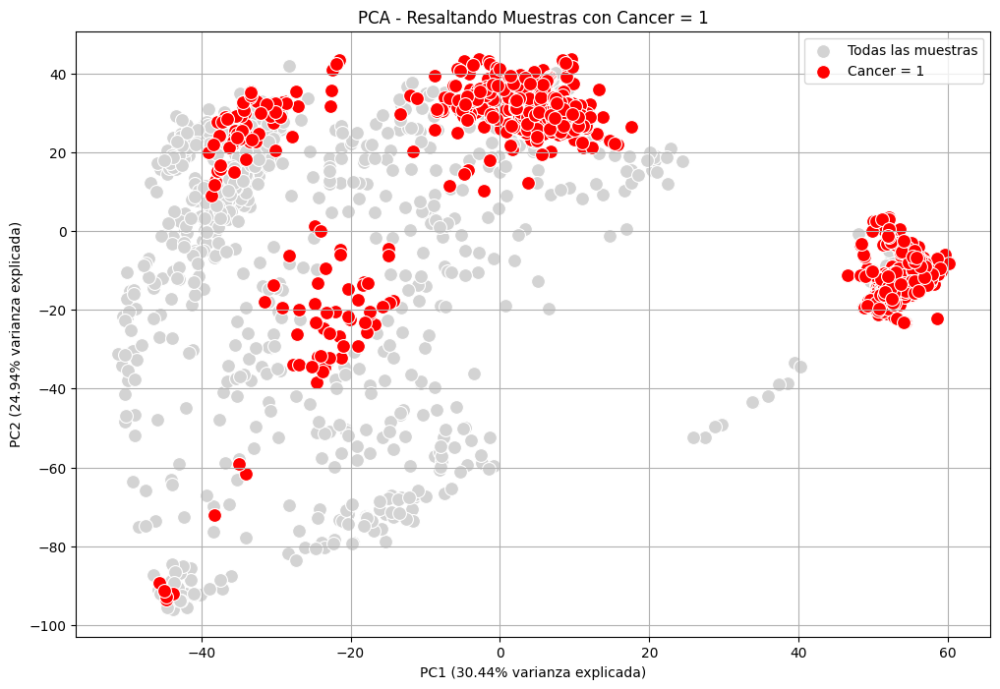

,PC1,PC2,y_cancer
0,0.492105,35.908206,1
1,-43.150330,20.884911,0
2,-36.634510,11.015207,0
3,-43.142658,18.460675,0
4,11.135002,21.227949,1
...,...,...,...
1601,9.642586,29.551226,1
1602,2.194190,33.171310,1
1603,55.983089,-15.337302,1
1604,-37.512677,16.702842,1


In [266]:
pca_analysis_cancer(X_train_mirna_clean.iloc[:,1:], y_cancer_train_clean)

---
# 5. Selección de Características
---

El dataset tiene 2419 características de epresesión de miRNA, lo cual es un conjunto de datos de alta dimensionalidad.

Siendo la interpretabilidad crucial, y tras haber comprobado en el EDA que el dataset puede tener muchas características potencialmente irrelevantes o redundantes, se realizará primero la **Selección de Características**. Esto permitirá identificar los miRNAs más importantes que contribuyen a la clasificación antes de reducir dimensionalidad, si es necesario.

Si después de la selección de características todavía existe un número considerable de características, se aplicará una técnica de **Reducción de Dimensionalidad** para mejorar la eficiencia y manejo del modelo.


In [267]:
X_train_mirna_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1606 entries, 0 to 1605
Columns: 416 entries, Experiment to hsa-miR-1304-3p
dtypes: float64(415), object(1)
memory usage: 5.1+ MB


In [268]:
X_train_mirna_clean_expression = X_train_mirna_clean.iloc[:,1:]
X_train_mirna_clean_expression

,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,9.671937,...,6.005777,17.179671,6.417664,5.181464,5.163893,1.608804,9.413083,5.431997,8.970077,4.726746
1,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,5.492624,...,5.619158,21.638673,8.028001,7.752329,5.808130,0.000000,6.898628,0.000000,6.431232,7.010611
2,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,2.795490,...,4.446213,9.880981,8.303605,4.234808,3.987018,0.000000,0.000000,0.000000,5.510013,4.234808
3,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,5.838925,...,6.265335,22.112450,7.819897,8.196934,7.201842,0.000000,8.684904,0.000000,7.057034,6.790068
4,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,7.401763,...,5.549404,15.776228,6.302500,1.523648,7.796886,0.581466,7.945661,3.831523,11.516693,4.242178
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1601,5.781479,3.430570,7.408063,10.369643,14.731742,3.681878,15.162415,4.483644,3.083021,9.574077,...,6.789648,17.620119,5.866023,3.760019,6.547693,0.987069,10.341737,5.430430,10.723556,5.029034
1602,7.180748,1.683081,7.286178,9.342468,14.193393,0.895711,15.091258,2.568761,3.611499,9.647283,...,7.550948,18.898021,6.955345,3.829679,6.694078,0.895711,11.914110,6.320277,11.043526,6.438089
1603,9.513278,6.883073,4.369365,11.821397,10.949829,8.898811,15.065079,10.775482,5.137709,5.876730,...,2.415570,8.631341,1.144527,1.198396,7.728549,3.598313,1.480496,0.000000,13.891859,0.000000
1604,0.000000,0.000000,9.830525,7.047468,13.143194,0.000000,15.258418,0.000000,5.101536,7.437053,...,4.373316,19.797914,7.437895,8.600551,5.797424,0.000000,0.000000,4.385217,6.657454,5.189537


In [269]:
X_test_mirna_clean_expression = X_test_mirna_clean.iloc[:,1:]
X_test_mirna_clean_expression

,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,1.298593,0.000000,9.753325,13.251531,16.628147,0.000000,13.575523,0.000000,2.773903,3.745136,...,4.562443,8.678667,8.515591,4.950829,6.121322,0.000000,2.217145,0.000000,5.508639,4.690312
1,6.581866,3.153727,6.207865,9.376254,15.809010,4.824996,15.264243,3.717331,3.153727,10.422567,...,8.440302,16.716829,6.572685,4.171074,7.040518,0.000000,10.295795,6.231392,11.607654,6.195957
2,1.331169,2.967592,11.257569,9.971639,14.384357,2.077803,13.138590,7.408132,4.318376,7.989723,...,6.566915,21.570470,8.795874,7.754234,7.084705,2.740980,12.038622,3.735309,9.583780,7.003934
3,1.256379,1.256379,9.161270,13.537516,16.921110,0.000000,14.035791,3.422594,2.161045,4.143022,...,5.438396,10.139726,8.892779,4.914949,5.692004,0.000000,1.624537,1.256379,7.401421,5.672492
4,3.656580,0.000000,9.035993,14.846308,17.849155,0.000000,14.030891,1.293572,2.210499,2.766673,...,6.436781,11.673218,8.286848,3.480187,4.976280,0.000000,4.722383,1.293572,11.000083,3.480187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,9.026138,7.399957,5.103071,11.684183,10.723401,8.255027,15.163786,10.554954,4.997139,6.089313,...,2.635530,11.159793,2.714056,1.257258,7.108057,4.279689,2.162218,1.453129,13.303094,0.761460
301,6.792578,1.374152,10.606113,13.632616,14.039061,8.980584,13.009725,0.213149,2.733820,3.923166,...,9.680608,6.368034,4.691401,2.663053,8.241049,0.308970,0.000000,0.483404,11.629698,1.460150
302,3.583996,2.653616,12.194899,11.088127,12.702208,3.315626,12.169305,3.255396,1.944771,9.201797,...,7.819720,15.249569,6.491107,5.503824,5.741929,3.285825,8.723020,3.285825,10.891292,7.246352
303,0.000000,0.000000,8.972269,7.221663,13.733764,0.000000,11.827071,0.000000,5.438272,7.608419,...,5.930953,23.301666,5.753530,13.040197,7.255385,0.000000,0.000000,4.684237,10.921054,5.438272


In [270]:
X_train_mirna_experiment = X_train_mirna_clean.iloc[:,0]
X_train_mirna_experiment

0       SRX2539128
1       SRX2956350
2       SRX2956137
3       SRX2956358
4       SRX2540517
           ...    
1601     SMOTE_408
1602     SMOTE_409
1603     SMOTE_410
1604     SMOTE_411
1605     SMOTE_412
Name: Experiment, Length: 1606, dtype: object

In [271]:
X_test_mirna_experiment = X_test_mirna_clean.iloc[:,0]
X_test_mirna_experiment

0      SRX2956186
1      SRX2539186
2      SRX2359242
3      SRX2956288
4      SRX2956220
          ...    
300    SRX1099479
301     SRX098326
302     SRX326620
303    SRX1169939
304    SRX2956047
Name: Experiment, Length: 305, dtype: object

## 5.1. Varianza baja

Este método selecciona características en función de su variabilidad. Si una característica tiene una varianza muy baja (es decir, cambia poco entre las observaciones), se considera irrelevante para la clasificación y puede eliminarse. Se utilizará para deintificar características constantes o casi constantes que no aportan información valiosa.

El umbral de 0.01 es un valor comúnmente adpotado en la práctica. Implica que se están eliminando características que tienen una variación muy baja, lo que generalmente significa que estas características no aportan suficiente información para distinguir entre las clases. Este umbral ayuda a filtrar características que son prácticamente constantes (o que cambian muy poco) en el conjunto de datos.

In [272]:
# Umbral de varianza
threshold = 0.01
var_selector = VarianceThreshold(threshold=threshold)
X_train_var = var_selector.fit_transform(X_train_mirna_clean_expression)

# Características seleccionadas
selected_features_var = X_train_mirna_clean_expression.columns[var_selector.get_support()]
print(selected_features_var)
print(len(selected_features_var))

Index(['hsa-miR-99b-3p', 'hsa-miR-136-5p', 'hsa-miR-106b-5p', 'hsa-miR-29a-3p',
       'hsa-miR-26a-5p', 'hsa-miR-885-5p', 'hsa-let-7i-5p', 'hsa-miR-136-3p',
       'hsa-miR-3074-5p', 'hsa-miR-199a-5p',
       ...
       'hsa-miR-335-3p', 'hsa-miR-486-5p', 'hsa-miR-589-5p', 'hsa-miR-93-3p',
       'hsa-let-7b-3p', 'hsa-miR-376a-3p', 'hsa-miR-486-3p', 'hsa-miR-1304-5p',
       'hsa-miR-99b-5p', 'hsa-miR-1304-3p'],
      dtype='object', length=415)
415


## 5.2. Análisis de Varianza (ANOVA)

ANOVA mide la relación entre una característica y la variable objetivo (en este caso, "healthy"). Compara la varianza entre grupos frente a la varianza dentro de los grupos para determinar si las diferencias son significativas. Se utilziará para seleccionar las características basándonos en la capacidad que tienen de discriminar entre clases.

ANOVA (Análisis de Varianza): Este método evalúa si hay diferencias significativas en la media de una variable continua (en este caso, la expresión de los miRNAs) entre diferentes grupos (las clases "healthy" y "cancer"). Al hacerlo, calcula un valor p para cada característica.

p-valor: El p-valor indica la probabilidad de que las diferencias observadas sean debidas al azar. Un p-valor menor que 0.05 generalmente se considera estadísticamente significativo, lo que significa que hay evidencia suficiente para afirmar que la característica tiene un efecto en la variable objetivo.

In [273]:
anova_selector = SelectKBest(score_func=f_classif, k='all')
anova_selector.fit(X_train_mirna_clean_expression, y_cancer_train_clean)

# Obtener scores y p-values
scores = anova_selector.scores_
p_values = anova_selector.pvalues_

# Crear un DataFrame
results_anova = pd.DataFrame({'Feature': X_train_mirna_clean_expression.columns, 'Score': scores, 'P-value': p_values})

# Filtrar y seleccionar características
selected_features_anova = results_anova[results_anova['P-value'] < 0.05]#.nlargest(50, 'Score')
print(selected_features_anova)
print(len(selected_features_anova))

             Feature       Score        P-value
0     hsa-miR-99b-3p  709.927396  8.330042e-130
1     hsa-miR-136-5p  211.987341   3.381193e-45
3     hsa-miR-29a-3p   26.356419   3.185115e-07
4     hsa-miR-26a-5p   78.583170   1.995048e-18
5     hsa-miR-885-5p  392.416453   2.654049e-78
..               ...         ...            ...
409    hsa-let-7b-3p  496.226285   5.347980e-96
410  hsa-miR-376a-3p  100.770206   4.865473e-23
411   hsa-miR-486-3p   40.760416   2.247619e-10
412  hsa-miR-1304-5p  190.909789   4.124280e-41
413   hsa-miR-99b-5p  436.439204   6.437350e-86

[375 rows x 3 columns]
375


## 5.3. Información Mutua (MI)

Mide la dependencia entre dos variables. Para la selección de características, evalúa la cantidad de información que aporta cada característica sobre la variable objetivo. Además, captura relaciones Lineales y relaciones No Lineales. Esto es relevante para datos biológicos como los de expresión de miRNA, donde las interacciones pueden no ser simplemente lineales. Se utilizará para  determinar qué características están más fuertemente relacionadas con la variable objetivo, sin hacer suposiciones sobre la relación lineal.


Se utilizará una curva de validación basada en la Información Mutua para evaluar el rendimiento del modelo en función del número de características seleccionadas. La Información Mutua mide la dependencia entre cada microARN y la variable objetivo, lo que permite identificar las características más relevantes para la clasificación de "cancer". Al graficar el rendimiento del modelo a medida que se varía el número de características, podremos observar cómo estas influyen en la capacidad de generalización del modelo. Esto nos ayudará a determinar el número óptimo de características que deben ser incluidas, evitando tanto el sobreajuste como la pérdida de información relevante.

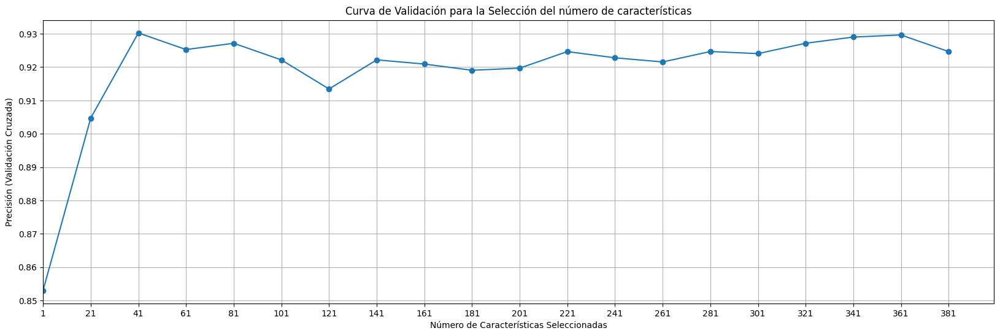

In [274]:
# Lista para almacenar los resultados
num_features = []
mean_scores = []

# Número máximo de características a probar
max_features = 400

# Selección de características con Información Mutua y evaluación
for k in range(1, max_features + 1, 20):
    # Seleccionar las k mejores características
    selector = SelectKBest(score_func=mutual_info_classif, k=k)
    X_selected = selector.fit_transform(X_train_mirna_clean_expression, y_cancer_train_clean)

    # Inicializar el clasificador
    model = SVC(kernel='linear')

    # Realizar validación cruzada
    scores = cross_val_score(model, X_selected, y_cancer_train_clean, cv=5)

    # Almacenar el número de características y la media de las puntuaciones
    num_features.append(k)
    mean_scores.append(np.mean(scores)) # métrica: precisión (score) por defecto

# Graficar los resultados
plt.figure(figsize=(20, 6))
plt.plot(num_features, mean_scores, marker='o')
plt.title('Curva de Validación para la Selección del número de características')
plt.xlabel('Número de Características Seleccionadas')
plt.ylabel('Precisión (Validación Cruzada)')
plt.grid()
plt.xlim(1, max_features)
plt.xticks(np.arange(1, max_features + 1, step=20))
plt.show()


In [275]:
# Calcular la información mutua
mi_scores = mutual_info_classif(X_train_mirna_clean_expression, y_cancer_train_clean, discrete_features='auto')

# Crear un DataFrame
results_mi = pd.DataFrame({'Feature': X_train_mirna_clean_expression.columns, 'MI Score': mi_scores})

# Seleccionar las mejores características
selected_features_mi = results_mi.nlargest(300, 'MI Score')
print(selected_features_mi)


            Feature  MI Score
27     hsa-miR-7-5p  0.327585
71   hsa-miR-185-5p  0.318267
17    hsa-miR-21-3p  0.296938
404   hsa-let-7b-5p  0.285841
370  hsa-miR-370-3p  0.281351
..              ...       ...
200  hsa-miR-501-5p  0.122065
117   hsa-let-7d-5p  0.121936
38      hsa-miR-941  0.121408
236  hsa-miR-423-3p  0.121263
99   hsa-miR-874-3p  0.119884

[300 rows x 2 columns]


## 5.4. Recursive Feature Elimination con Support Vector Machine (RFE + SVM)

RFE elimina recursivamente las características menos importantes entrenando el modelo y eliminando las características con menor importancia en cada iteración. SVM se utiliza para determinar la importancia de las características. Es muy útil en la selección de características en problemas de alta dimensionalidad y multicolinealidad, como el objetivo de este proyecto.

El uso de SVM (Support Vector Machine) combinado con RFECV (Recursive Feature Elimination with Cross-Validation) es una técnica efectiva para la selección de características en problemas de clasificación. En este enfoque, SVM se emplea como el clasificador base, donde se ajusta el modelo utilizando un conjunto de características. RFECV, por su parte, elimina recursivamente las características menos relevantes, evaluando el rendimiento del modelo en cada paso mediante validación cruzada. Este proceso permite identificar el subconjunto óptimo de características que maximizan la precisión del modelo, al tiempo que se reduce la complejidad y se mejora la interpretabilidad, lo que es crucial para el análisis de datos biomédicos, como en la detección de enfermedades a través de microARNs.

In [276]:
# Crear el clasificador SVM
svc = SVC(kernel='linear')

# Definir la estrategia de validación cruzada
cv = StratifiedKFold()

# Configurar y ejecutar RFECV
rfecv = RFECV(estimator=svc, step=10, cv=cv, scoring='accuracy')
rfecv.fit(X_train_mirna_clean_expression, y_cancer_train_clean)

# Obtener las características seleccionadas
selected_features_rfecv = X_train_mirna_clean_expression.columns[rfecv.support_]

print(selected_features_rfecv)
print(len(selected_features_rfecv))

Index(['hsa-miR-885-5p', 'hsa-miR-3074-5p', 'hsa-miR-199a-5p',
       'hsa-miR-548o-3p', 'hsa-miR-326', 'hsa-miR-23a-3p', 'hsa-miR-20a-5p',
       'hsa-miR-30d-5p', 'hsa-miR-193a-5p', 'hsa-miR-873-5p',
       ...
       'hsa-miR-130b-5p', 'hsa-miR-582-5p', 'hsa-miR-582-3p', 'hsa-miR-18b-5p',
       'hsa-miR-15b-5p', 'hsa-miR-15b-3p', 'hsa-let-7b-5p', 'hsa-miR-486-5p',
       'hsa-miR-589-5p', 'hsa-miR-1304-5p'],
      dtype='object', length=145)
145


## 5.5. Support Vector Classifier (SVM) with L1

Este modelo lineal incluye un término de regularización L1 que fuerza algunos coeficientes a ser cero, eliminando así características. Es útil cuando se quiere una selección automática de características durante el ajuste del modelo. También es común su uso en la selección de características en problemas de alta dimensionalidad y multicolinealidad.

SVC es un clasificador basado en máquinas de vectores de soporte, que intenta encontrar un hiperplano que separe las clases en un espacio de características de alta dimensión. Utilizar el penalizador L1 en SVC implica que el modelo aplicará una regularización L1 (también conocida como Lasso), que tiene efecto en la reducción de características.

c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\svm\_base.py:1235: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\svm\_base.py:1235: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\svm\_base.py:1235: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\svm\_base.py:1235: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\svm\_base.py:1235: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\mnunezmartinez_v

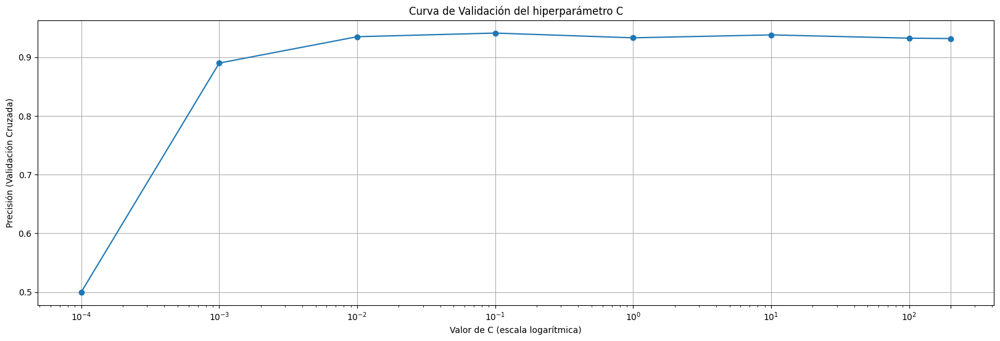

In [277]:
# Definir los valores del hiperparámetro C a evaluar
C_values = [0.0001, 0.001, 0.01, 0.1, 1, 10, 100, 200]

# Listas para almacenar los resultados
mean_scores = []

# Evaluar cada valor de C
for C in C_values:
    # Inicializar el clasificador SVC con regularización L1
    svc = LinearSVC(C=C, penalty="l1", dual=False,  max_iter=10000)

    # Ajustar el modelo y realizar validación cruzada
    scores = cross_val_score(svc, X_train_mirna_clean_expression, y_cancer_train_clean, cv=5)

    # Almacenar la media de las puntuaciones
    mean_scores.append(np.mean(scores))

# Graficar los resultados
plt.figure(figsize=(20, 6))
plt.plot(C_values, mean_scores, marker='o')
plt.xscale('log')  # Usar escala logarítmica para el eje x
plt.title('Curva de Validación del hiperparámetro C')
plt.xlabel('Valor de C (escala logarítmica)')
plt.ylabel('Precisión (Validación Cruzada)')
plt.grid()
plt.xticks(C_values)
plt.show()


In [278]:
# Crear el clasificador SVC con L1
svc_selector = LinearSVC(C=0.1, penalty='l1', dual=False)

# Ajustar el modelo
svc_selector.fit(X_train_mirna_clean_expression, y_cancer_train_clean)

# Selección de características
model = SelectFromModel(svc_selector, prefit=True)
X_new = model.transform(X_train_mirna_clean_expression)

# Características seleccionadas
selected_features_l1 = X_train_mirna_clean_expression.columns[model.get_support()]
print(selected_features_l1)
print(len(selected_features_l1))


Index(['hsa-miR-199a-5p', 'hsa-miR-548o-3p', 'hsa-miR-21-3p', 'hsa-miR-326',
       'hsa-miR-23a-3p', 'hsa-miR-20a-5p', 'hsa-miR-30d-5p', 'hsa-let-7f-1-3p',
       'hsa-miR-193a-5p', 'hsa-miR-30d-3p',
       ...
       'hsa-miR-130b-5p', 'hsa-miR-758-3p', 'hsa-miR-15b-5p', 'hsa-miR-15b-3p',
       'hsa-let-7b-5p', 'hsa-miR-486-5p', 'hsa-miR-589-5p', 'hsa-miR-93-3p',
       'hsa-let-7b-3p', 'hsa-miR-1304-3p'],
      dtype='object', length=173)
173


c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\svm\_base.py:1235: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\base.py:486: UserWarning: X has feature names, but SelectFromModel was fitted without feature names
  warnings.warn(


## 5.6. Random Forest

Este algoritmo basado en árboles mide la importancia de cada característica durante la construcción de los árboles de decisión. Las características con mayor importancia contribuyen más a la predicción. Realiza una identificación de características importantes de manera no lineal y con interacciones entre características.

In [279]:
# Random Forest
rfc = RandomForestClassifier(n_estimators=100, random_state=42)
rfc.fit(X_train_mirna_clean_expression, y_cancer_train_clean)

# Obtener importancias de características
importances = rfc.feature_importances_

# Crear un DataFrame con características e importancias
results_rfc = pd.DataFrame({'Feature': X_train_mirna_clean_expression.columns, 'Importance': importances})

# Ordenar por importancia
results_rfc = results_rfc.sort_values(by='Importance', ascending=False)


In [280]:
results_rfc

,Feature,Importance
27,hsa-miR-7-5p,0.048888
71,hsa-miR-185-5p,0.044141
404,hsa-let-7b-5p,0.034365
305,hsa-miR-4306,0.033870
373,hsa-miR-378g,0.018941
...,...,...
320,hsa-miR-769-5p,0.000142
66,hsa-miR-550a-3p,0.000135
300,hsa-miR-424-5p,0.000121
355,hsa-miR-3605-3p,0.000114


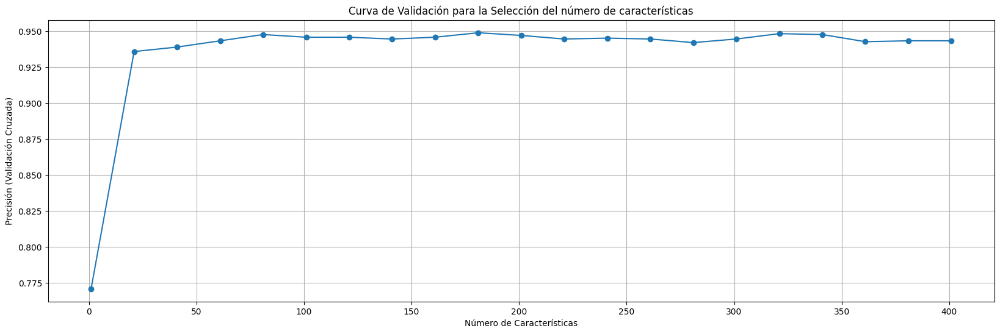

In [281]:
# Listas para almacenar los resultados
num_features_list = []
mean_scores = []

# Iterar sobre diferentes números de características
for k in range(1, 410, 20):
    # Seleccionar las k características más importantes
    selected_features = results_rfc['Feature'].head(k).values
    X_selected = X_train_mirna_clean_expression[selected_features]

    # Entrenar un clasificador con las características seleccionadas
    model = RandomForestClassifier(n_estimators=100, random_state=42)

    # Validación cruzada
    scores = cross_val_score(model, X_selected, y_cancer_train_clean, cv=5, scoring='accuracy')

    # Almacenar el número de características y la media de las puntuaciones
    num_features_list.append(k)
    mean_scores.append(scores.mean())

# Graficar los resultados
plt.figure(figsize=(20, 6))
plt.plot(num_features_list, mean_scores, marker='o')
plt.title('Curva de Validación para la Selección del número de características')
plt.xlabel('Número de Características')
plt.ylabel('Precisión (Validación Cruzada)')
plt.grid(True)
plt.show()


In [282]:
# Seleccionar las 200 características más importantes
selected_features_rfc = results_rfc['Feature'].head(200).values

# Mostrar las 200 características seleccionadas
print(selected_features_rfc)

['hsa-miR-7-5p' 'hsa-miR-185-5p' 'hsa-let-7b-5p' 'hsa-miR-4306'
 'hsa-miR-378g' 'hsa-miR-10527-5p' 'hsa-miR-379-5p' 'hsa-miR-206'
 'hsa-let-7i-5p' 'hsa-miR-148b-3p' 'hsa-miR-148a-3p' 'hsa-miR-23b-5p'
 'hsa-let-7a-3p' 'hsa-miR-629-5p' 'hsa-miR-224-5p' 'hsa-miR-370-3p'
 'hsa-miR-1224-5p' 'hsa-miR-543' 'hsa-miR-24-1-5p' 'hsa-miR-126-3p'
 'hsa-miR-139-3p' 'hsa-miR-329-3p' 'hsa-miR-139-5p' 'hsa-miR-145-3p'
 'hsa-miR-411-3p' 'hsa-miR-10b-3p' 'hsa-miR-382-3p' 'hsa-miR-409-5p'
 'hsa-miR-2110' 'hsa-miR-184' 'hsa-miR-140-3p' 'hsa-miR-323a-3p'
 'hsa-miR-451a' 'hsa-miR-431-5p' 'hsa-miR-140-5p' 'hsa-miR-16-5p'
 'hsa-miR-432-5p' 'hsa-miR-21-3p' 'hsa-miR-122-5p' 'hsa-miR-532-5p'
 'hsa-miR-450b-5p' 'hsa-miR-1246' 'hsa-miR-151a-5p' 'hsa-miR-3182'
 'hsa-miR-15b-3p' 'hsa-miR-92b-5p' 'hsa-miR-433-3p' 'hsa-miR-1343-3p'
 'hsa-miR-1-3p' 'hsa-miR-10a-3p' 'hsa-let-7g-3p' 'hsa-miR-214-3p'
 'hsa-miR-450a-5p' 'hsa-miR-320e' 'hsa-miR-340-5p' 'hsa-miR-382-5p'
 'hsa-miR-1306-3p' 'hsa-miR-223-5p' 'hsa-miR-362-5p' 'hs

## 5.7. Combinación de resultados con intersección de subconjuntos

In [283]:
X_train_mirna_clean_expression

,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,4.335000,2.507335,9.518807,11.295597,14.611787,3.268919,15.343192,4.406471,3.510503,9.671937,...,6.005777,17.179671,6.417664,5.181464,5.163893,1.608804,9.413083,5.431997,8.970077,4.726746
1,0.000000,0.000000,11.017423,7.841563,14.174973,0.000000,12.384189,0.000000,3.883378,5.492624,...,5.619158,21.638673,8.028001,7.752329,5.808130,0.000000,6.898628,0.000000,6.431232,7.010611
2,0.000000,0.000000,8.822229,12.564287,16.224703,0.000000,13.828303,0.000000,0.000000,2.795490,...,4.446213,9.880981,8.303605,4.234808,3.987018,0.000000,0.000000,0.000000,5.510013,4.234808
3,0.000000,0.000000,9.726893,8.353967,14.883398,0.000000,9.837443,0.000000,2.727680,5.838925,...,6.265335,22.112450,7.819897,8.196934,7.201842,0.000000,8.684904,0.000000,7.057034,6.790068
4,6.133725,2.297426,7.398466,13.808628,13.296125,4.853345,13.800163,5.116778,2.031578,7.401763,...,5.549404,15.776228,6.302500,1.523648,7.796886,0.581466,7.945661,3.831523,11.516693,4.242178
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1601,5.781479,3.430570,7.408063,10.369643,14.731742,3.681878,15.162415,4.483644,3.083021,9.574077,...,6.789648,17.620119,5.866023,3.760019,6.547693,0.987069,10.341737,5.430430,10.723556,5.029034
1602,7.180748,1.683081,7.286178,9.342468,14.193393,0.895711,15.091258,2.568761,3.611499,9.647283,...,7.550948,18.898021,6.955345,3.829679,6.694078,0.895711,11.914110,6.320277,11.043526,6.438089
1603,9.513278,6.883073,4.369365,11.821397,10.949829,8.898811,15.065079,10.775482,5.137709,5.876730,...,2.415570,8.631341,1.144527,1.198396,7.728549,3.598313,1.480496,0.000000,13.891859,0.000000
1604,0.000000,0.000000,9.830525,7.047468,13.143194,0.000000,15.258418,0.000000,5.101536,7.437053,...,4.373316,19.797914,7.437895,8.600551,5.797424,0.000000,0.000000,4.385217,6.657454,5.189537


In [284]:
X_test_mirna_clean_expression

,hsa-miR-99b-3p,hsa-miR-136-5p,hsa-miR-106b-5p,hsa-miR-29a-3p,hsa-miR-26a-5p,hsa-miR-885-5p,hsa-let-7i-5p,hsa-miR-136-3p,hsa-miR-3074-5p,hsa-miR-199a-5p,...,hsa-miR-335-3p,hsa-miR-486-5p,hsa-miR-589-5p,hsa-miR-93-3p,hsa-let-7b-3p,hsa-miR-376a-3p,hsa-miR-486-3p,hsa-miR-1304-5p,hsa-miR-99b-5p,hsa-miR-1304-3p
0,1.298593,0.000000,9.753325,13.251531,16.628147,0.000000,13.575523,0.000000,2.773903,3.745136,...,4.562443,8.678667,8.515591,4.950829,6.121322,0.000000,2.217145,0.000000,5.508639,4.690312
1,6.581866,3.153727,6.207865,9.376254,15.809010,4.824996,15.264243,3.717331,3.153727,10.422567,...,8.440302,16.716829,6.572685,4.171074,7.040518,0.000000,10.295795,6.231392,11.607654,6.195957
2,1.331169,2.967592,11.257569,9.971639,14.384357,2.077803,13.138590,7.408132,4.318376,7.989723,...,6.566915,21.570470,8.795874,7.754234,7.084705,2.740980,12.038622,3.735309,9.583780,7.003934
3,1.256379,1.256379,9.161270,13.537516,16.921110,0.000000,14.035791,3.422594,2.161045,4.143022,...,5.438396,10.139726,8.892779,4.914949,5.692004,0.000000,1.624537,1.256379,7.401421,5.672492
4,3.656580,0.000000,9.035993,14.846308,17.849155,0.000000,14.030891,1.293572,2.210499,2.766673,...,6.436781,11.673218,8.286848,3.480187,4.976280,0.000000,4.722383,1.293572,11.000083,3.480187
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,9.026138,7.399957,5.103071,11.684183,10.723401,8.255027,15.163786,10.554954,4.997139,6.089313,...,2.635530,11.159793,2.714056,1.257258,7.108057,4.279689,2.162218,1.453129,13.303094,0.761460
301,6.792578,1.374152,10.606113,13.632616,14.039061,8.980584,13.009725,0.213149,2.733820,3.923166,...,9.680608,6.368034,4.691401,2.663053,8.241049,0.308970,0.000000,0.483404,11.629698,1.460150
302,3.583996,2.653616,12.194899,11.088127,12.702208,3.315626,12.169305,3.255396,1.944771,9.201797,...,7.819720,15.249569,6.491107,5.503824,5.741929,3.285825,8.723020,3.285825,10.891292,7.246352
303,0.000000,0.000000,8.972269,7.221663,13.733764,0.000000,11.827071,0.000000,5.438272,7.608419,...,5.930953,23.301666,5.753530,13.040197,7.255385,0.000000,0.000000,4.684237,10.921054,5.438272


In [285]:
# Listar las características seleccionadas por cada método
selected_feature_sets = [
    set(selected_features_var),
    set(selected_features_anova),
    set(selected_features_mi),
    set(selected_features_rfecv),
    set(selected_features_l1),
    set(selected_features_rfc)
]

# Contar las ocurrencias de cada característica en los 6 métodos
all_features = [item for sublist in selected_feature_sets for item in sublist]
feature_counts = Counter(all_features)

# Seleccionar características que aparezcan en al menos 3 métodos
final_selected_features = [feature for feature, count in feature_counts.items() if count >= 3]

# Crear el dataset final con las características seleccionadas
X_train_mirna_features_expression = X_train_mirna_clean_expression[final_selected_features]
X_test_mirna_features_expression = X_test_mirna_clean_expression[final_selected_features]

# Mostrar las características seleccionadas
print(f"Características seleccionadas en al menos 3 métodos: {final_selected_features}")
print(len(final_selected_features))


Características seleccionadas en al menos 3 métodos: ['hsa-miR-3909', 'hsa-miR-454-3p', 'hsa-miR-19a-3p', 'hsa-miR-4306', 'hsa-miR-9-5p', 'hsa-miR-30c-5p', 'hsa-miR-374a-5p', 'hsa-miR-32-5p', 'hsa-miR-1-3p', 'hsa-miR-744-3p', 'hsa-miR-15b-3p', 'hsa-miR-140-3p', 'hsa-miR-148a-3p', 'hsa-miR-149-5p', 'hsa-miR-543', 'hsa-miR-342-5p', 'hsa-miR-629-5p', 'hsa-miR-379-5p', 'hsv2-miR-H10', 'hsa-miR-125a-5p', 'hsa-miR-324-5p', 'hsa-miR-4326', 'hsa-miR-7-1-3p', 'hsa-miR-1343-3p', 'hsa-miR-212-3p', 'hsa-miR-941', 'hsa-miR-184', 'hsa-let-7b-3p', 'hsa-miR-1843', 'hsa-miR-15a-5p', 'hsa-miR-2110', 'hsa-miR-3613-3p', 'hsa-miR-215-5p', 'hsa-miR-181a-5p', 'hsa-miR-500a-5p', 'hsa-miR-495-3p', 'hsa-miR-30b-5p', 'hsa-miR-628-3p', 'hsa-miR-1304-5p', 'hsa-miR-193a-5p', 'hsa-miR-331-3p', 'hsa-let-7a-5p', 'hsa-miR-362-5p', 'hsa-miR-30e-3p', 'hsa-miR-4508', 'hsa-miR-92a-3p', 'hsa-miR-145-3p', 'hsa-miR-301a-3p', 'hsa-miR-382-3p', 'hsa-miR-93-3p', 'hsa-miR-125b-1-3p', 'hsa-miR-7977', 'hsa-miR-326', 'hsa-miR-23b-3p

In [286]:
X_train_mirna_features_expression

,hsa-miR-3909,hsa-miR-454-3p,hsa-miR-19a-3p,hsa-miR-4306,hsa-miR-9-5p,hsa-miR-30c-5p,hsa-miR-374a-5p,hsa-miR-32-5p,hsa-miR-1-3p,hsa-miR-744-3p,...,hsa-miR-4433b-3p,hsa-miR-485-5p,hsa-miR-23a-3p,hsa-miR-423-5p,hsa-miR-550a-5p,hsa-miR-1246,hsa-miR-30d-5p,hsa-miR-3605-3p,hsa-miR-183-5p,hsa-miR-382-5p
0,4.376273,6.176130,8.617263,3.005136,3.749144,10.092221,6.835276,7.190910,4.601816,1.802926,...,6.879006,4.192074,10.569061,13.296238,6.751488,4.968577,14.593283,3.414708,10.531447,7.268317
1,4.340600,9.530950,8.859934,2.701107,0.000000,11.103830,7.770623,8.556814,0.000000,1.907469,...,0.000000,0.000000,8.556814,13.020249,5.304550,0.000000,14.544674,6.066866,9.573251,0.000000
2,0.000000,8.457863,8.382795,0.000000,3.309468,11.934519,7.899096,8.714102,3.987018,3.309468,...,0.000000,0.000000,10.698684,10.414519,0.000000,0.000000,13.340675,0.000000,0.000000,0.000000
3,4.370418,7.521809,9.187533,2.727680,0.000000,12.822126,7.201842,7.382883,0.000000,0.000000,...,0.000000,0.000000,9.228686,12.304032,5.838925,0.000000,14.461919,6.826268,10.393509,0.000000
4,2.679177,2.751853,4.839516,1.467210,3.848193,8.358750,4.800075,6.883043,11.721914,0.412416,...,4.195171,5.622289,10.847082,12.457318,4.649700,5.123641,13.262893,5.258625,8.625733,7.645366
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1601,4.175087,2.464493,7.399757,3.152595,5.421498,9.954839,6.262266,7.156403,7.105541,1.451138,...,9.719885,6.747353,8.050814,16.268928,5.799418,6.917359,14.986395,4.645791,10.745525,7.769364
1602,4.826611,1.716735,6.662919,3.025655,2.226927,10.018539,5.311605,5.219018,8.370505,0.648696,...,9.446986,5.025708,8.739945,16.568241,6.533821,7.204063,15.788754,5.422852,11.013778,7.061374
1603,0.000000,0.000000,3.529248,2.420787,13.458996,7.347724,0.000000,4.840033,3.736668,4.442213,...,3.210436,0.858970,10.285719,13.713203,0.946296,4.927153,14.100147,0.000000,4.244108,10.389462
1604,3.239068,5.785117,3.620239,5.692546,0.375810,13.094167,5.689783,0.375810,0.000000,0.000000,...,0.000000,0.000000,10.002445,14.380946,5.442593,0.000000,14.259937,5.503099,10.138675,0.000000


In [287]:
X_test_mirna_features_expression

,hsa-miR-3909,hsa-miR-454-3p,hsa-miR-19a-3p,hsa-miR-4306,hsa-miR-9-5p,hsa-miR-30c-5p,hsa-miR-374a-5p,hsa-miR-32-5p,hsa-miR-1-3p,hsa-miR-744-3p,...,hsa-miR-4433b-3p,hsa-miR-485-5p,hsa-miR-23a-3p,hsa-miR-423-5p,hsa-miR-550a-5p,hsa-miR-1246,hsa-miR-30d-5p,hsa-miR-3605-3p,hsa-miR-183-5p,hsa-miR-382-5p
0,3.174629,9.127756,8.888756,0.000000,4.152891,12.556976,8.989569,9.309685,2.611081,2.217145,...,0.000000,0.000000,11.643355,10.885358,0.000000,0.000000,13.605488,1.970772,0.000000,0.000000
1,4.971900,4.265261,7.066912,1.147509,4.436979,11.160006,5.976840,6.159629,10.510531,0.000000,...,8.455365,6.840859,9.859363,15.139248,6.018006,7.498776,15.556442,5.361250,9.088109,8.205085
2,4.304606,6.586961,10.191217,0.250365,0.463639,10.929746,6.395647,10.229296,0.000000,3.489728,...,3.513863,5.573466,10.169778,16.856103,6.245186,5.954699,15.293889,6.620692,9.364074,2.656777
3,3.678761,8.348796,8.260072,0.000000,4.738533,13.175570,8.246940,9.898627,3.678761,3.422594,...,0.000000,1.256379,10.991393,9.728366,1.256379,0.000000,13.954628,4.353702,0.000000,0.000000
4,2.603999,8.078011,8.555248,0.000000,1.667671,12.226813,8.869151,10.327229,0.000000,3.167098,...,0.000000,0.000000,10.759203,11.087835,0.000000,0.000000,13.978411,3.045567,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
300,0.000000,0.000000,4.662898,1.918699,13.266361,7.104418,1.779561,5.028207,4.495142,4.581457,...,1.779561,0.000000,9.732236,13.278070,2.714056,3.053050,13.808940,0.000000,4.227103,9.964292
301,2.750983,5.233411,10.083398,0.213149,4.659945,13.264448,9.998035,7.723854,6.335693,1.329151,...,0.000000,0.213149,9.247949,8.465254,2.448381,2.293011,15.898565,2.196087,12.968908,1.726231
302,2.506338,5.837467,7.830081,1.012765,2.985658,10.642869,7.645876,6.946456,9.343695,3.160055,...,9.713987,3.745974,13.788981,13.685835,4.644979,5.451096,15.245674,0.492735,11.460349,8.011729
303,4.869851,6.012101,7.288337,6.012101,0.000000,14.561805,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,12.164257,10.907861,5.034283,0.000000,13.459568,5.181877,10.401914,0.000000


In [288]:
y_cancer_train_clean.info()

<class 'pandas.core.series.Series'>
RangeIndex: 1606 entries, 0 to 1605
Series name: Cancer
Non-Null Count  Dtype
--------------  -----
1606 non-null   int64
dtypes: int64(1)
memory usage: 12.7 KB


In [289]:
y_cancer_test_clean.info()

<class 'pandas.core.series.Series'>
RangeIndex: 305 entries, 0 to 304
Series name: Cancer
Non-Null Count  Dtype
--------------  -----
305 non-null    int64
dtypes: int64(1)
memory usage: 2.5 KB


## 5.8. Evaluación de las características seleccionadas

**AUC-ROC (Area Under the Curve - Receiver Operating Characteristic):**
- AUC-ROC mide la capacidad del modelo para distinguir entre las clases. El área bajo la curva ROC representa la relación entre la tasa de verdaderos positivos (sensibilidad) y la tasa de falsos positivos a diferentes umbrales de decisión.
- Un valor de 1 indica una clasificación perfecta, mientras que 0.5 indica una clasificación aleatoria.

**F1-Score:**
- El F1-Score es la media armónica entre la precisión (proporción de predicciones correctas entre los positivos predichos) y la sensibilidad/recall (proporción de verdaderos positivos entre todos los positivos reales).
- Es útil cuando hay un desequilibrio entre las clases, ya que combina ambos aspectos en una única métrica.

**Precisión (Precision):**
- La precisión mide qué proporción de las predicciones positivas fueron correctas.
- Fórmula: Precision = TP/(TP+FP)
- Alta precisión significa menos falsos positivos.

**Sensibilidad (Recall):**
- La sensibilidad o recall es la proporción de casos positivos correctamente identificados por el modelo.
- Fórmula: Recall = TP/(TP+FN)
- Alta sensibilidad significa menos falsos negativos, lo cual es importante en problemas médicos como la detección de cáncer.

**Curva ROC:**
- Muestra la relación entre la tasa de verdaderos positivos (sensibilidad) y la tasa de falsos positivos para diferentes umbrales de decisión.
- Es útil para visualizar el rendimiento del modelo a diferentes umbrales y se complementa con el valor AUC.

### 5.8.1.  Evaluación del rendimiento del modelo (AUC-ROC, F1-score, etc.)

AUC-ROC: 0.9703834461116015
F1-Score: 0.867579908675799
Precision: 0.7916666666666666
Recall (Sensibilidad): 0.9595959595959596


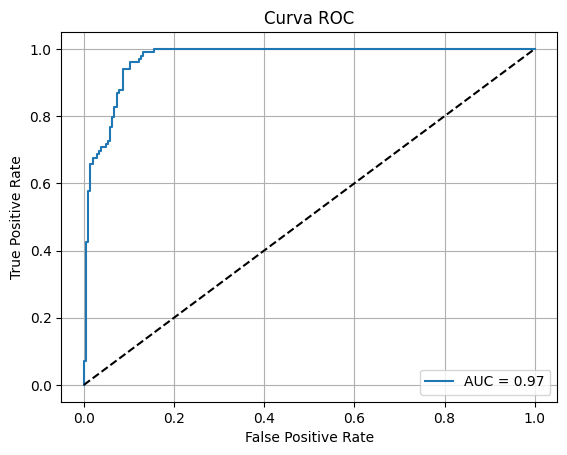

In [290]:
# Entrenar un modelo SVM en las características seleccionadas
model_svc_features = SVC(probability=True)
model_svc_features.fit(X_train_mirna_features_expression, y_cancer_train_clean)

# Predicciones y probabilidades
y_pred_features = model_svc_features.predict(X_test_mirna_features_expression)
y_proba_features = model_svc_features.predict_proba(X_test_mirna_features_expression)[:, 1]  # Probabilidades de la clase positiva

# Métricas de evaluación
auc = roc_auc_score(y_cancer_test_clean, y_proba_features)
f1 = f1_score(y_cancer_test_clean, y_pred_features)
precision = precision_score(y_cancer_test_clean, y_pred_features)
recall = recall_score(y_cancer_test_clean, y_pred_features)

print(f"AUC-ROC: {auc}")
print(f"F1-Score: {f1}")
print(f"Precision: {precision}")
print(f"Recall (Sensibilidad): {recall}")

# Curva ROC
fpr, tpr, _ = roc_curve(y_cancer_test_clean, y_proba_features)
plt.figure()
plt.plot(fpr, tpr, label=f'AUC = {auc:.2f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC')
plt.legend()
plt.grid(True)
plt.show()


### 5.8.2. Evaluación del antes de la selección de características

AUC-ROC (sin selección): 0.9559674414043345
F1-Score (sin selección): 0.867579908675799
Precision: 0.7916666666666666
Recall (Sensibilidad): 0.9595959595959596


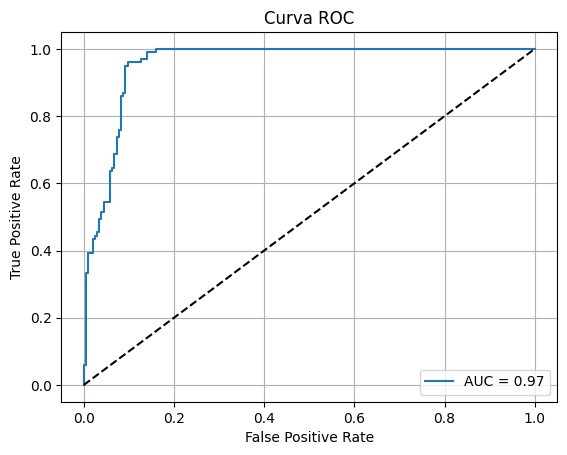

In [291]:
# Entrenar el modelo con todas las características
model_svc_full = SVC(probability=True)
model_svc_full.fit(X_train_mirna_clean_expression, y_cancer_train_clean)

# Predicciones y probabilidades
y_pred_full = model_svc_full.predict(X_test_mirna_clean_expression)
y_proba_full = model_svc_full.predict_proba(X_test_mirna_clean_expression)[:, 1]  # Probabilidades de la clase positiva

# Métricas de evaluación
auc_full = roc_auc_score(y_cancer_test_clean, y_proba_full)
f1_full = f1_score(y_cancer_test_clean, y_pred_full)
precision_full = precision_score(y_cancer_test_clean, y_pred_full)
recall_full = recall_score(y_cancer_test_clean, y_pred_full)

print(f"AUC-ROC (sin selección): {auc_full}")
print(f"F1-Score (sin selección): {f1_full}")
print(f"Precision: {precision_full}")
print(f"Recall (Sensibilidad): {recall_full}")


# Curva ROC
fpr, tpr, _ = roc_curve(y_cancer_test_clean, y_proba_full)
plt.figure()
plt.plot(fpr, tpr, label=f'AUC = {auc_full:.2f}')
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Curva ROC')
plt.legend()
plt.grid(True)
plt.show()

### 5.8.3. Curvas de aprendizaje

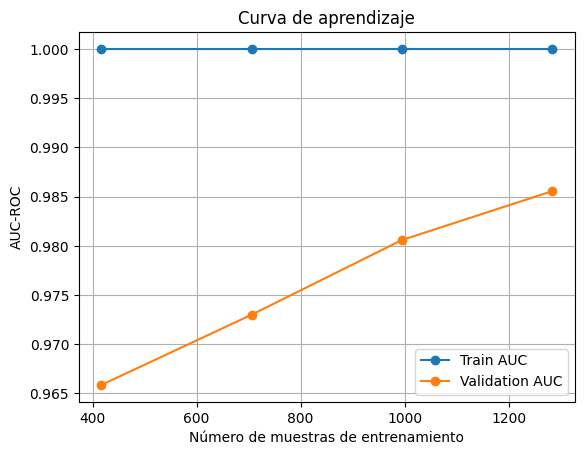

In [292]:
# Curvas de aprendizaje
train_sizes, train_scores, valid_scores = learning_curve(
    model, X_train_mirna_features_expression, y_cancer_train_clean, cv=5, scoring='roc_auc', n_jobs=-1
)

train_mean = train_scores.mean(axis=1)
valid_mean = valid_scores.mean(axis=1)

plt.figure()
plt.plot(train_sizes, train_mean, label='Train AUC', marker='o')
plt.plot(train_sizes, valid_mean, label='Validation AUC', marker='o')
plt.xlabel('Número de muestras de entrenamiento')
plt.ylabel('AUC-ROC')
plt.title('Curva de aprendizaje')
plt.legend()
plt.grid(True)
plt.show()


La línea azul, que representa el rendimiento del modelo en el conjunto de entrenamiento, está constantemente en 1.000 (rendimiento perfecto), lo que indica que el modelo está sobreajustando (overfitting). Es decir, está aprendiendo demasiado bien los datos de entrenamiento, posiblemente memorizándolos, pero no generalizando correctamente.

La línea naranja, que muestra el AUC en el conjunto de validación, comienza en torno a 0.965 y mejora gradualmente conforme se incrementa el número de muestras de entrenamiento, llegando a aproximadamente 0.985. Esto es un buen signo de que el modelo mejora con más datos de entrenamiento, pero sigue habiendo una brecha entre el rendimiento de entrenamiento y validación, lo que refuerza la sospecha de sobreajuste.


**Consideraciones**
- **Sobreajuste (Overfitting):** El hecho de que la curva de entrenamiento esté en 1.000 mientras que la curva de validación esté por debajo sugiere que el modelo es demasiado complejo, capturando incluso el ruido del conjunto de entrenamiento. No generaliza bien en datos no vistos.
- **Mejora con más datos:** La curva de validación está mejorando a medida que aumentan las muestras de entrenamiento, lo que sugiere que añadir más datos podría continuar reduciendo la brecha, pero no eliminará completamente el sobreajuste si no se ajusta la complejidad del modelo.

**Proximos pasos:**
- **Reducir la complejidad del modelo:** Simplificar el modelo (por ejemplo, reducir la regularización de SVC o cambiar de modelo) o eliminar características menos relevantes.
- **Agregar más datos:** Como la curva de validación sigue mejorando, agregar más muestras de entrenamiento podría seguir mejorando la generalización del modelo.

### 5.8.4. Análisis de correlación

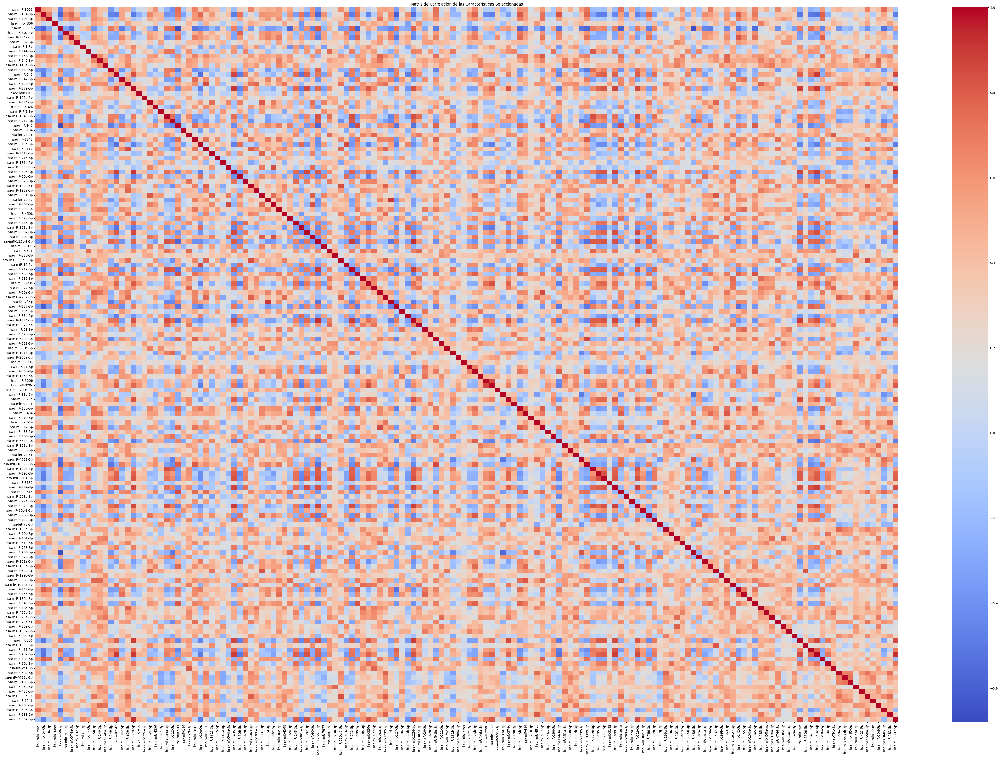

In [293]:
# Crear un DataFrame con las características seleccionadas
df_selected = pd.DataFrame(X_train_mirna_features_expression, columns=final_selected_features)

# Calcular la matriz de correlación
correlation_matrix = df_selected.corr()

# Visualizar el heatmap de correlación
plt.figure(figsize=(60, 40))
sns.heatmap(correlation_matrix, annot=False, fmt=".2f", cmap='coolwarm')
plt.title('Matriz de Correlación de las Características Seleccionadas')
plt.show()


### 5.8.5.  Comparación del rendimiento del modelo antes y después de la selección de características

In [294]:
# Evaluación sin selección de características (con todas las características)
scores_before = cross_val_score(model, X_train_mirna_clean_expression, y_cancer_train_clean, cv=5, scoring='accuracy')
print(f"Rendimiento antes de la selección de características: {scores_before.mean()}")

# Evaluación después de la selección de características
scores_after = cross_val_score(model, X_train_mirna_features_expression, y_cancer_train_clean, cv=5, scoring='accuracy')
print(f"Rendimiento después de la selección de características: {scores_after.mean()}")


Rendimiento antes de la selección de características: 0.944573440916391
Rendimiento después de la selección de características: 0.9476887057138988


### 5.8.7. ¿El número de características seleccionado es correcto?


**Regla práctica: Relación entre características y observaciones**
Una regla empírica común en ciencia de datos es que deberías tener al menos 10 observaciones por cada característica que utilices en el modelo. Esta regla garantiza que haya suficiente información en los datos para entrenar de manera efectiva cada característica sin caer en sobreajuste.

En este caso, después del preprocesamiento, se tienen los siguientes datasets:
- X_train_mirna_features_expression: 1606 observaciones.
- X_test_mirna_features: 305 observaciones.

Entonces, la recomendación general sería:
nº_observaciones / 10 = 1606/10 = 160.6

Para el conjunto de entrenamiento, el número máximo de características debería estar alrededor de 160. Actualmente, tiene 154 características después de la selección de características, lo que está dentro de este rango recomendado. Si se quisiera reducir aún más la dimensionalidad, se podrían aplicar técnicas adicionales como análisis de componentes principales (PCA) para reducir las características a un espacio más pequeño o seguir refinando la selección de características mediante modelos de regularización.

**Puntos a tener en cuenta tras la selección de características**
- Cuantas más características tenga el dataset en comparación con las observaciones, mayor es el riesgo de sobreajuste, ya que el modelo puede aprender patrones espurios. Es por esto que reducir el número de características es útil.
- Métodos de regularización: Si se utilizan métodos que incorporan regularización (como SVM con un valor alto de C, o modelos de regresión como Lasso), se pueden permitir un número mayor de características, ya que la regularización contrarresta parcialmente el problema del sobreajuste.



## 5.9. Variables tras la Selección de Características
- X_train_mirna_experiment
- X_test_mirna_experiment
- X_train_mirna_features_expression
- X_test_mirna_features_expression
- y_cancer_train_clean
- y_cancer_test_clean

In [295]:
X_train_mirna_experiment.info()

<class 'pandas.core.series.Series'>
RangeIndex: 1606 entries, 0 to 1605
Series name: Experiment
Non-Null Count  Dtype 
--------------  ----- 
1606 non-null   object
dtypes: object(1)
memory usage: 12.7+ KB


## 5.10. Guardar los datasets y las características seleccionadas

In [296]:
# Crear el directorio si no existe
os.makedirs(processed_data_path, exist_ok=True)

# Guardar la lista final_selected_features como CSV
final_selected_features_path = os.path.join(processed_data_path, 'final_selected_features.csv')
with open(final_selected_features_path, 'w') as file:
    # Convertimos la lista en líneas de texto
    for feature in final_selected_features:
        file.write(f"{feature}\n")

# Lista de las Series de pandas a guardar
series_list = {
    'X_train_mirna_experiment': X_train_mirna_experiment,
    'X_test_mirna_experiment': X_test_mirna_experiment,
    'X_train_mirna_features_expression': X_train_mirna_features_expression,
    'X_test_mirna_features_expression': X_test_mirna_features_expression,
    'y_cancer_train_clean': y_cancer_train_clean,
    'y_cancer_test_clean': y_cancer_test_clean
}

# Guardar cada Series de pandas como CSV
for nombre, serie in series_list.items():
    serie_path = os.path.join(processed_data_path, f'{nombre}.csv')
    serie.to_csv(serie_path, index=False)  # Guardar sin el índice

---
# 6. Construcción del Modelo
---

In [297]:
# X_train = X_train_mirna_features_expression.copy()
# X_test = X_test_mirna_features_expression.copy()
# X_train_experiment = X_train_mirna_experiment.copy()
# X_test_experiment = X_test_mirna_experiment.copy()
# y_cancer_train = y_cancer_train_clean.copy()
# y_cancer_test = y_cancer_test_clean.copy()

In [298]:
# Cargar las variables desde los archivos CSV
X_train = pd.read_csv(os.path.join(processed_data_path, 'X_train_mirna_features_expression.csv'))
X_test = pd.read_csv(os.path.join(processed_data_path, 'X_test_mirna_features_expression.csv'))
X_train_experiment = pd.read_csv(os.path.join(processed_data_path, 'X_train_mirna_experiment.csv'))
X_test_experiment = pd.read_csv(os.path.join(processed_data_path, 'X_test_mirna_experiment.csv'))
y_cancer_train = pd.read_csv(os.path.join(processed_data_path, 'y_cancer_train_clean.csv'))
y_cancer_test = pd.read_csv(os.path.join(processed_data_path, 'y_cancer_test_clean.csv'))
final_selected_features = pd.read_csv(os.path.join(processed_data_path, 'final_selected_features.csv'))

# Convertir a Series
X_train_experiment = X_train_experiment.iloc[:, 0] 
X_test_experiment = X_test_experiment.iloc[:, 0]
y_cancer_train = y_cancer_train.iloc[:, 0]
y_cancer_test = y_cancer_test.iloc[:, 0]
final_selected_features = final_selected_features.iloc[:,0]

In [299]:
X_train_experiment.info()

<class 'pandas.core.series.Series'>
RangeIndex: 1606 entries, 0 to 1605
Series name: Experiment
Non-Null Count  Dtype 
--------------  ----- 
1606 non-null   object
dtypes: object(1)
memory usage: 12.7+ KB


In [300]:
type(final_selected_features)

pandas.core.series.Series

## 6.1. Selección de Algoritmos

Dado el objetivo del proyecto, que es la detección de cáncer utilizando microARNs en biopsias líquidas, es crucial considerar modelos que manejen bien datos de alta dimensionalidad, desequilibrio en clases (aunque se haya aplicado SMOTE), y que tengan un buen rendimiento en problemas de clasificación.

### Support Vector Machine (SVM)
- Intenta encontrar el hiperplano que mejor separe las clases en el espacio de características.
- Ventajas:
    - Es muy eficaz en espacios de alta dimensionalidad.
    - Funciona bien con márgenes claros entre clases.
    - Robusto frente a sobreajuste.
- Desventajas:
    - Puede ser computacionalmente costoso en datasets grandes.
    - Difícil de interpretar y ajustar correctamente.
- Ajuste de hiperparámetros:
    - C: Parámetro de regularización [0.1, 1, 10, 100]
    - kernel: Tipo de kernel (lineal, RBF, polinómico) ['linear', 'rbf', 'poly']
    - gamma: Parámetro de los kernels no lineales  ['scale', 'auto', 0.001, 0.01, 0.1]

### k-Nearest Neighbors (KNN)
- Descripción: Clasifica una observación según sus "vecinos" más cercanos en el espacio de características.
- Ventajas:
    - Fácil de entender e implementar.
    - No necesita suposiciones fuertes sobre la distribución de los datos.
- Desventajas:
    - Muy sensible al ruido y a las características irrelevantes.
    - No escala bien con datasets grandes.
- Ajuste de hiperparámetros:
    - n_neighbors: Número de vecinos [3, 5, 7, 9]
    - weights: Forma de ponderar los vecinos (uniforme o por distancia).
    - metric: Métrica empleada para calcular la distancia ['euclidean', 'manhattan', 'minkowski']
    -GridSearch: Probar diferentes valores de n_neighbors y weights.

### Random Forest Classifier (RFC)
- Es un conjunto de árboles de decisión entrenados con diferentes subconjuntos de datos. Cada árbol contribuye al resultado final mediante votación.
- Ventajas:
    - Maneja bien datos no lineales y de alta dimensionalidad como el dataset de mirna.
    - Es robusto frente a overfitting si se configura correctamente.
    - Es robusto a outliers
    - Maneja características no correlacionadas.
- Desventajas:
    - Puede ser lento de entrenar y predecir si el número de árboles es alto.
    - Menos interpretabilidad que un árbol de decisión individual.
- Ajuste de hiperparámetros:
    - n_estimators: Número de árboles [100, 200, 500]
    - max_depth: Profundidad máxima de los árboles [None, 10, 20, 50]
    - min_samples_split: Mínimo número de muestras para dividir un nodo [2, 5, 10]
    - GridSearch: Probar diferentes combinaciones de estos parámetros y usar validación cruzada para evaluar.

### Gradient Boosting (GBM) / XGBoost 
- Modelos basados en boosting que combinan árboles secuenciales, donde cada uno corrige los errores del anterior.
- Ventajas:
    - Generalmente ofrece un rendimiento superior en tareas de clasificación.
    - Excelente para detectar relaciones complejas y no lineales.
- Desventajas:
    - Puede ser propenso a overfitting si no se ajustan bien los hiperparámetros.
    - Entrenamiento más lento que otros algoritmos.
- Ajuste de hiperparámetros:
    - n_estimators: Número de iteraciones de boosting  [100, 200, 500]
    - learning_rate: Tasa de aprendizaje (tamaño de paso) [0.01, 0.1, 0.2]
    - max_depth: Profundidad máxima de los árboles [3, 6, 10]
    - GridSearch: Probar con combinaciones de learning_rate, n_estimators, max_depth.

### Red Neuronal Artificial (ANN) -> Multi-Layer Perceptron (MLP)
- Modelo basado en neuronas interconectadas que pueden aprender representaciones complejas.
- Ventajas:
    - Capaz de modelar relaciones no lineales complejas.
    - Escalable a datasets grandes.
- Desventajas:
    - Necesita más datos para evitar el overfitting.
    - Difícil de interpretar y ajustar.
- Ajuste de hiperparámetros:
    - hidden_layer_sizes: Tamaño y número de capas ocultas  [(50,), (100,), (100, 100)]
    - learning_rate: Tasa de aprendizaje  [0.001, 0.01, 0.1]
    - activation: Función de activación (ReLU, sigmoid, etc.)  ['relu', 'tanh']
    - GridSearch: Explorar configuraciones de hidden_layer_sizes, learning_rate, y activation.

### 6.1.1. Otros modelos

***Modelos de Machine Learning***

1. **Decision Trees:** Son interpretables y útiles para captar relaciones no lineales, pero propensos a sobreajuste si no se podan bien. Random Forest mejora esto al combinar varios árboles.
2. **Naive Bayes:** Funciona bien en datos con independencia de características, pero este supuesto rara vez se cumple, especialmente en biología, donde hay interacciones complejas entre genes.
3. **ExtraTrees:** Similares a Random Forest pero con divisiones más aleatorias, lo que mejora la generalización y reduce el tiempo de entrenamiento, aunque a veces a costa de precisión.
4. **AdaBoost:** Ideal para clases desbalanceadas y mejora modelos débiles. Sin embargo, es sensible al ruido y puede fallar con modelos base muy inestables.

***Modelos de Deep Learning***

1. **RNN:** Adecuados para datos secuenciales, pero no aplicables si no hay dependencia temporal, como en los miRNAs.
2. **CNN:** Eficaces para detectar patrones espaciales, pero solo si los datos se pueden estructurar como imágenes o matrices.
3. **GNN:** Útiles si los datos de miRNA se pueden modelar como grafos, captando relaciones entre nodos, pero difíciles de aplicar a datos tabulares.
4. **Transformers:** Potentes en secuencias largas, pero requieren grandes volúmenes de datos y recursos de cómputo.
5. **Transfer Learning:** Puede aprovecharse de modelos preentrenados en datasets similares, pero encontrar uno adecuado puede ser complicado.

### 6.1.2. Algoritmos y SMOTE

1. **Random Forest (RF):** Robusto ante desequilibrio, pero SMOTE puede mejorar su rendimiento.
2. **SVM:** Adecuado para datos de alta dimensionalidad, pero necesita SMOTE para evitar sesgos hacia la clase mayoritaria.
3. **KNN:** Clasifica basándose en los vecinos más cercanos, por lo que necesita SMOTE para evitar sesgos hacia la clase mayoritaria.
4. **Regresión Logística:** Simple, pero muy sensible al desequilibrio, por lo que SMOTE es crucial.
5. **GBM (XGBoost, LightGBM, CatBoost):** Potentes en clasificación, aunque SMOTE puede ser útil para equilibrar clases.
6. **AdaBoost:** Similar a GBM, pero más sencillo y necesita SMOTE para evitar sesgos.
7. **MLP:** En deep learning, SMOTE es necesario para evitar el sesgo hacia la clase mayoritaria.

## 6.2. Selección de Métricas y Curvas de Validación

### 6.2.1. Corss-Validation

Es recomendable usar K-fold cross-validation (como 5-fold o 10-fold) para evaluar el rendimiento del modelo de manera más robusta. Se divide el conjunto de datos en K partes y realiza múltiples entrenamientos para reducir la varianza en la evaluación.

1. Entrenar el modelo con k-1 bloques como datos de entrenamiento.
2. Validar el modelo con el bloque restante.
La medida de rendimiento obtenida con la validación cruzada k-fold es el promedio de los resultados obtenidos en cada iteración del proceso.

### 6.2.2. Ajuste de los hiperparámetros del estimador

Los hiperparámetros son parámetros que no se aprenden directamente en los estimadores, sino que se pasan como argumentos al constructor de las clases de estimadores.

Existen dos enfoques genéricos para la búsqueda de parámetros: para valores dados, **GridSearchCV** considera exhaustivamente todas las combinaciones de parámetros, mientras que **RandomizedSearchCV** puede muestrear un número dado de candidatos de un espacio de parámetros con una distribución especificada.

### 6.2.3.  Curva de Validación (Validation Curve)

 La curva de validación muestra el rendimiento de un modelo de machine learning con respecto a un hiperparámetro específico. Lo que hace es evaluar el rendimiento del modelo variando el valor de ese hiperparámetro, tanto en los datos de entrenamiento como en los de validación.

El objetivo consiste en evaluar cómo un hiperparámetro afecta el rendimiento y determinar cuál es el valor óptimo de dicho hiperparámetro para evitar el sobreajuste o bajo ajuste.

- Eje X: el valor del hiperparámetro que se está variando (por ejemplo, C en una SVM o max_depth en un Random Forest).
- Eje Y: la métrica de rendimiento (por ejemplo, accuracy, f1-score, o AUC-ROC).

Se usa cuando queremos analizar el impacto de un hiperparámetro específico en el rendimiento del modelo y optimizar ese hiperparámetro. Por ejemplo, al ajustar el parámetro C en una máquina de soporte vectorial (SVM) o el número de árboles en un Random Forest.

### 6.2.4. Curva de Aprendizaje (Learning Curve)

La curva de aprendizaje muestra cómo varía el rendimiento del modelo en función de la cantidad de datos de entrenamiento utilizados. A medida que se incrementa el tamaño del conjunto de entrenamiento, podemos observar si el modelo está aprendiendo adecuadamente o si ya ha alcanzado su límite.

El objetivo consiste en saber si agregar más datos de entrenamiento mejorará el rendimiento del modelo, o si el modelo ya ha llegado a su capacidad máxima de aprendizaje.

- Eje X: el tamaño del conjunto de datos de entrenamiento.
- Eje Y: la métrica de rendimiento (accuracy, f1-score, o AUC-ROC).

Si la curva de entrenamiento y la curva de validación están muy separadas, el modelo podría estar sobreajustando. Agregar más datos o reducir la complejudad del modelo podría ayudar a reducir esta brecha.
Si ambas curvas están muy bajas y cercanas, el modelo podría estar bajo ajustado. En este caso, agregar más datos no ayudará, y es mejor revisar la arquitectura del modelo o los hiperparámetros.

Se usa para evaluar cómo afecta el tamaño del conjunto de entrenamiento al rendimiento del modelo y para decidir si deberías recolectar más datos o mejorar el modelo. También es útil para detectar problemas de sobreajuste o bajo ajuste.

### 6.2.4. Función para generar las curvas de aprendizaje y guardar los gráficos

In [301]:
def plot_learning_curve(model, X_train, y_train, metric, model_name, cv_splits=5, n_jobs=None, train_sizes=np.linspace(0.1, 1.0, 10)):
    # Cambiar n_jobs a -1 en Google Colab, donde dispongo de GPU
    """
    Plotea la curva de aprendizaje para el modelo dado.
    
    Parámetros:
    - model: modelo de clasificación (por ejemplo, SVM, KNN, RandomForestClassifier)
    - X_train: características de entrenamiento
    - y_train: etiquetas de entrenamiento
    - metric: métrica a usar para la validación ('accuracy', 'f1', 'roc_auc', etc.)
    - model_name: nombre del modelo para mostrar en la gráfica
    - cv_splits: número de folds para la validación cruzada
    - n_jobs: Número de núcleos a utilizar (None = 1 núcleo; -1 = Todos)
    - train_sizes: tamaños de entrenamiento para calcular la curva de aprendizaje
    """
    
    # Definir validación cruzada estratificada para mantener balance de clases
    cv = StratifiedKFold(n_splits=cv_splits, shuffle=True, random_state=42)
    
    # Obtener valores de la curva de aprendizaje
    train_sizes, train_scores, test_scores = learning_curve(model, X_train, y_train, cv=cv, scoring=metric, 
                                                            n_jobs=n_jobs, train_sizes=train_sizes)
    
    # Calcular media y desviación estándar de las puntuaciones de entrenamiento y validación
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    # Ploteo de la curva de aprendizaje
    plt.figure(figsize=(10, 6))
    plt.title(f"Learning Curve for {model_name}")
    plt.xlabel("Training Examples")
    plt.ylabel(metric.capitalize())
    plt.grid()

    # Rellenar la curva con las desviaciones estándar
    plt.fill_between(train_sizes, train_scores_mean - train_scores_std, train_scores_mean + train_scores_std, alpha=0.1, color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std, test_scores_mean + test_scores_std, alpha=0.1, color="g")

    # Ploteo de las medias de entrenamiento y validación
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r", label="Training Score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g", label="Cross-Validation Score")

    plt.legend(loc="best")

    # Renderizar el gráfico antes de guardarlo
    plt.tight_layout()

    # Guardar el gráfico en la ruta especificada
    output_path = os.path.join(results_figures_path, f"learning_curve_{model_name}.png")
    plt.savefig(output_path, format='png')

    plt.show()

## 6.3. SVM

### 6.3.1. Default

In [302]:
# Valores predeterminados

svm_default = SVC(probability=True, random_state=42)
#svm_default.fit(X_train, y_cancer_train)

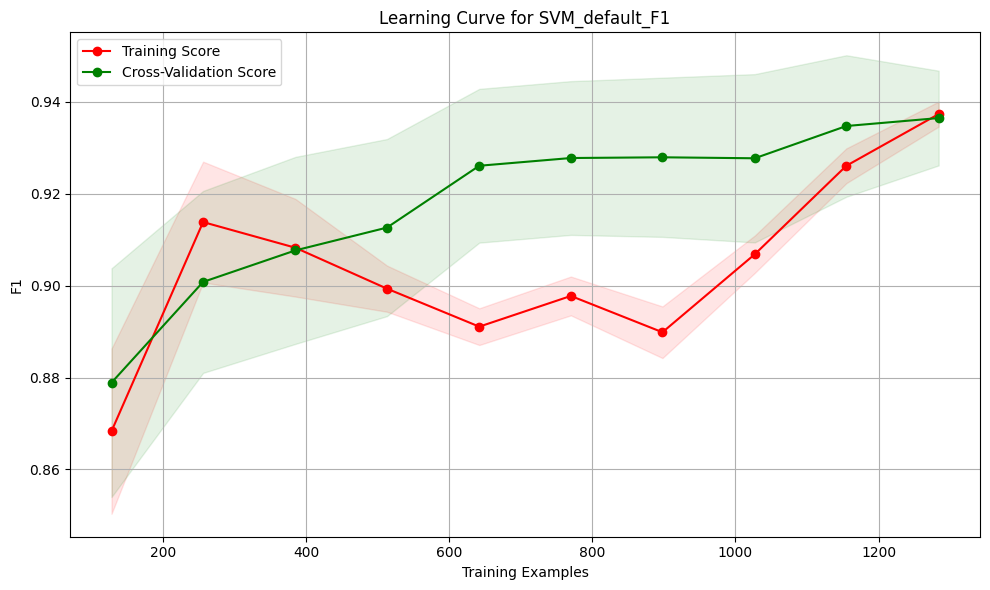

In [303]:
plot_learning_curve(svm_default, X_train, y_cancer_train, metric='f1', model_name='SVM_default_F1')

### 6.3.2. GridSearch

In [304]:
""" # SVM con GridSearchCV
# Eficaz en espacios de alta dimensionalidad. Puede manejar datasets no lineales cuando se usa el kernel adecuado.

svm_gridsearch = SVC(probability=True, random_state=42)

param_grid_svm = {
    'C': [0.1, 1, 10, 100], # Parámetro de regularización
    'kernel': ['linear', 'rbf', 'poly'],
    'gamma': ['scale', 'auto', 0.001, 0.01, 0.1, 1], #Coeficiente de kernel para 'rbf' y 'poly'
    'degree': [2, 3, 4] # Grado de polimomio para 'poly'
}
grid_svm = GridSearchCV(svm_gridsearch, param_grid_svm, cv=5, scoring='f1')
grid_svm.fit(X_train, y_cancer_train)

# Mejor modelo SVM
svm_best = grid_svm.best_estimator_
print(f"Mejores hiperparámetros SVM: {grid_svm.best_params_}") """

' # SVM con GridSearchCV\n# Eficaz en espacios de alta dimensionalidad. Puede manejar datasets no lineales cuando se usa el kernel adecuado.\n\nsvm_gridsearch = SVC(probability=True, random_state=42)\n\nparam_grid_svm = {\n    \'C\': [0.1, 1, 10, 100], # Parámetro de regularización\n    \'kernel\': [\'linear\', \'rbf\', \'poly\'],\n    \'gamma\': [\'scale\', \'auto\', 0.001, 0.01, 0.1, 1], #Coeficiente de kernel para \'rbf\' y \'poly\'\n    \'degree\': [2, 3, 4] # Grado de polimomio para \'poly\'\n}\ngrid_svm = GridSearchCV(svm_gridsearch, param_grid_svm, cv=5, scoring=\'f1\')\ngrid_svm.fit(X_train, y_cancer_train)\n\n# Mejor modelo SVM\nsvm_best = grid_svm.best_estimator_\nprint(f"Mejores hiperparámetros SVM: {grid_svm.best_params_}") '

In [305]:
""" # Guardar los mejores hiperparámetros
grid_svm_path = os.path.join(results_models_path, 'best_hyperparameters_svm.txt')
with open(grid_svm_path, 'w') as f:
    f.write(f"Best hyperparameters SVM: {grid_svm.best_params_}\n") """

' # Guardar los mejores hiperparámetros\ngrid_svm_path = os.path.join(results_models_path, \'best_hyperparameters_svm.txt\')\nwith open(grid_svm_path, \'w\') as f:\n    f.write(f"Best hyperparameters SVM: {grid_svm.best_params_}\n") '

In [306]:
""" # Guardar modelo
joblib.dump(svm_best, os.path.join(results_models_path, 'best_model_svm.pkl')) """

" # Guardar modelo\njoblib.dump(svm_best, os.path.join(results_models_path, 'best_model_svm.pkl')) "

In [307]:
# Cargar el modelo
loaded_svm_best = joblib.load(os.path.join(results_models_path, 'best_model_svm.pkl'))

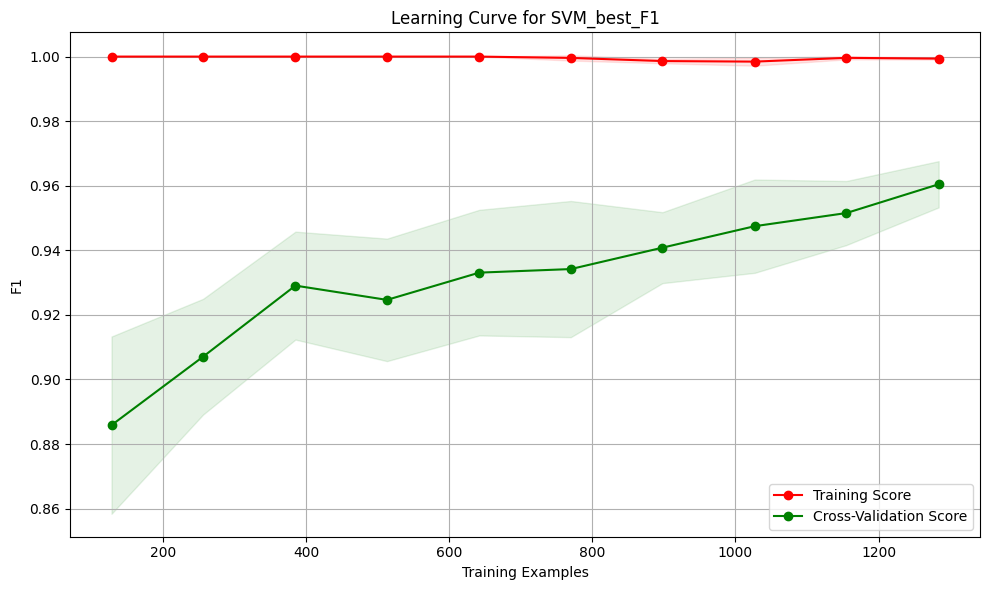

In [308]:
plot_learning_curve(loaded_svm_best, X_train, y_cancer_train, metric='f1', model_name='SVM_best_F1')

### 6.3.4. Custom

In [309]:
# Se reduce el parámetro de regularización C para introducir más regularización
svm_custom1 = SVC(C=10, kernel='rbf', degree=2, gamma=0.001, probability=True, random_state=42)

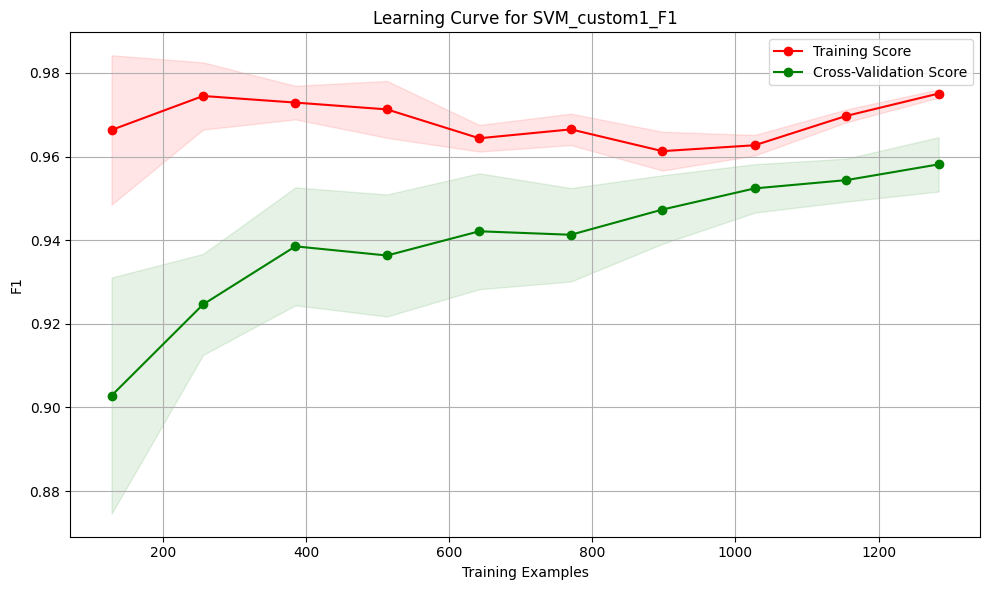

In [310]:
plot_learning_curve(svm_custom1, X_train, y_cancer_train, metric='f1', model_name='SVM_custom1_F1')

### 6.3.5. Guardar el modelo final

In [367]:
""" # Guardar modelo
svm_custom1.fit(X_train, y_cancer_train)
joblib.dump(svm_custom1, os.path.join(results_models_path, 'final_model_svm.pkl')) """

['C:/Users/mnunezmartinez_viu/Documents/14MBID---TFM--VF\\results/models\\final_model_svm.pkl']

## 6.4 KNN

### 6.4.1. Default

In [312]:
# Valores predeterminados
knn_default = KNeighborsClassifier()

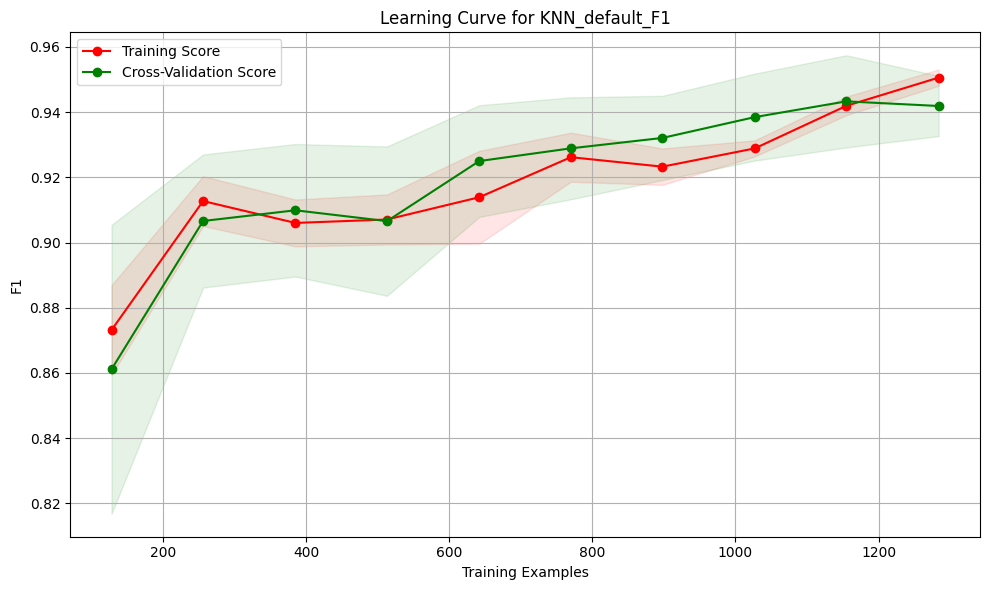

In [313]:
plot_learning_curve(knn_default, X_train, y_cancer_train, metric='f1', model_name='KNN_default_F1')

### 6.4.2. GridSearch

In [314]:
""" # KNN con GridSearchCV
# Simple. Puede ser sensible a la dimensionalidad del espacio.

knn_gridsearch = KNeighborsClassifier()

param_grid_knn = {
    'n_neighbors': [3, 5, 10, 15], # Número de vecinos
    'weights': ['uniform', 'distance'], # Ponderación de los vecinos
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'] # Método para encontrar vecinos más cercanos
}
grid_knn = GridSearchCV(knn_gridsearch, param_grid_knn, cv=5, scoring='f1')
grid_knn.fit(X_train, y_cancer_train)

# Mejor modelo KNN
knn_best = grid_knn.best_estimator_
print(f"Mejores hiperparámetros KNN: {grid_knn.best_params_}") """

' # KNN con GridSearchCV\n# Simple. Puede ser sensible a la dimensionalidad del espacio.\n\nknn_gridsearch = KNeighborsClassifier()\n\nparam_grid_knn = {\n    \'n_neighbors\': [3, 5, 10, 15], # Número de vecinos\n    \'weights\': [\'uniform\', \'distance\'], # Ponderación de los vecinos\n    \'algorithm\': [\'auto\', \'ball_tree\', \'kd_tree\', \'brute\'] # Método para encontrar vecinos más cercanos\n}\ngrid_knn = GridSearchCV(knn_gridsearch, param_grid_knn, cv=5, scoring=\'f1\')\ngrid_knn.fit(X_train, y_cancer_train)\n\n# Mejor modelo KNN\nknn_best = grid_knn.best_estimator_\nprint(f"Mejores hiperparámetros KNN: {grid_knn.best_params_}") '

In [315]:
""" # Guardar los mejores hiperparámetros
grid_knn_path = os.path.join(results_models_path, 'best_hyperparameters_knn.txt')
with open(grid_knn_path, 'w') as f:
    f.write(f"Best hyperparameters KNN: {grid_knn.best_params_}\n") """

' # Guardar los mejores hiperparámetros\ngrid_knn_path = os.path.join(results_models_path, \'best_hyperparameters_knn.txt\')\nwith open(grid_knn_path, \'w\') as f:\n    f.write(f"Best hyperparameters KNN: {grid_knn.best_params_}\n") '

In [316]:
""" # Guardar modelo
joblib.dump(knn_best, os.path.join(results_models_path, 'best_model_knn.pkl')) """

" # Guardar modelo\njoblib.dump(knn_best, os.path.join(results_models_path, 'best_model_knn.pkl')) "

In [317]:
# Cargar el modelo
loaded_knn_best = joblib.load(os.path.join(results_models_path, 'best_model_knn.pkl'))

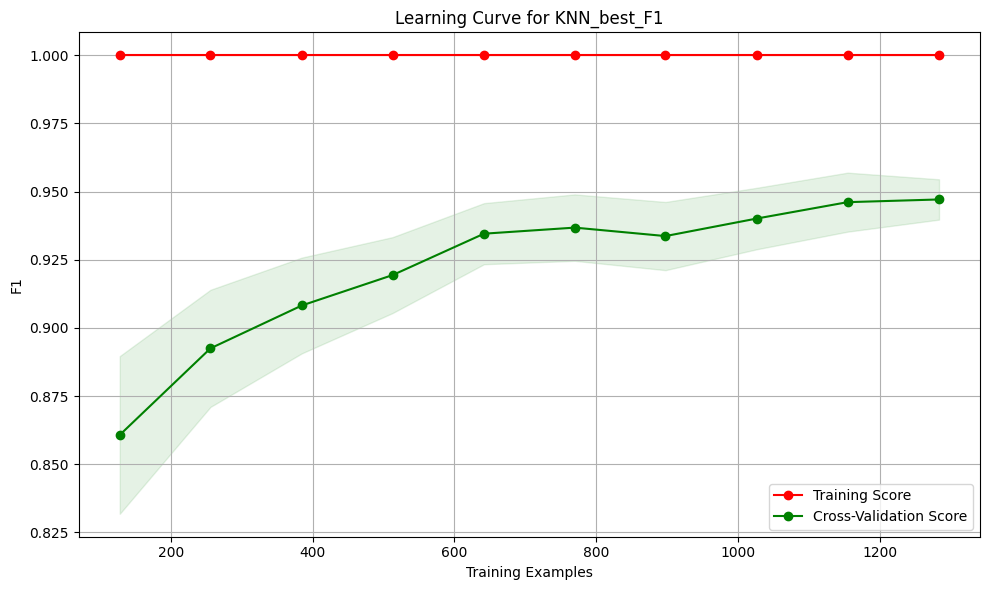

In [318]:
plot_learning_curve(loaded_knn_best, X_train, y_cancer_train, metric='f1', model_name='KNN_best_F1')

### 6.4.3. Custom

In [319]:
knn_custom1 = KNeighborsClassifier(algorithm='auto', n_neighbors=3, weights='uniform')

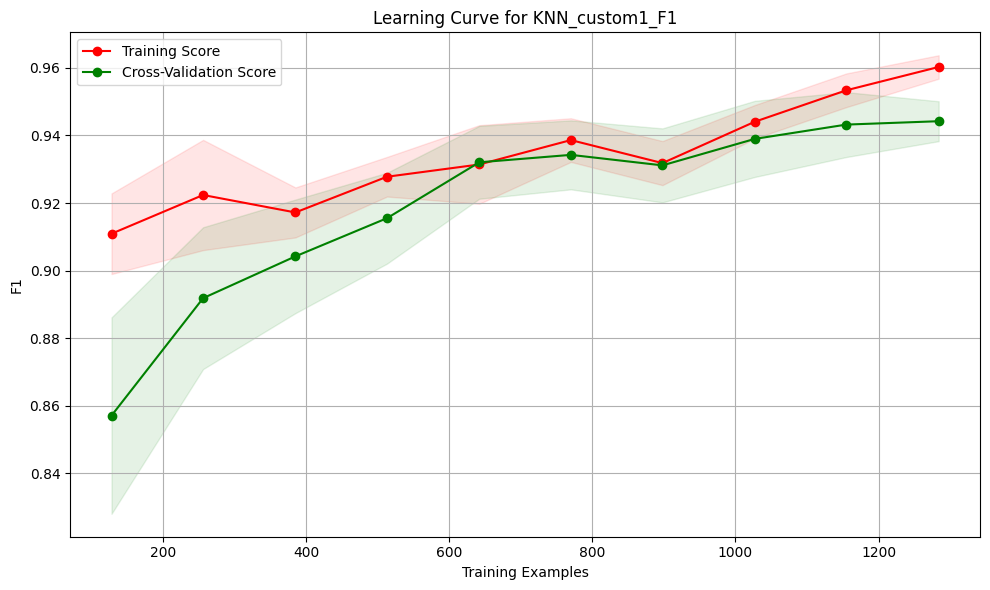

In [320]:
plot_learning_curve(knn_custom1, X_train, y_cancer_train, metric='f1', model_name='KNN_custom1_F1')

### 6.4.4. Guardar el modelo final

In [371]:
""" # Guardar modelo
knn_custom1.fit(X_train, y_cancer_train)
joblib.dump(knn_custom1, os.path.join(results_models_path, 'final_model_knn.pkl')) """

['C:/Users/mnunezmartinez_viu/Documents/14MBID---TFM--VF\\results/models\\final_model_knn.pkl']

## 6.5. Random Forest

### 6.5.1. Default

In [322]:
# Valores predeterminados
rfc_default = RandomForestClassifier(random_state=42)

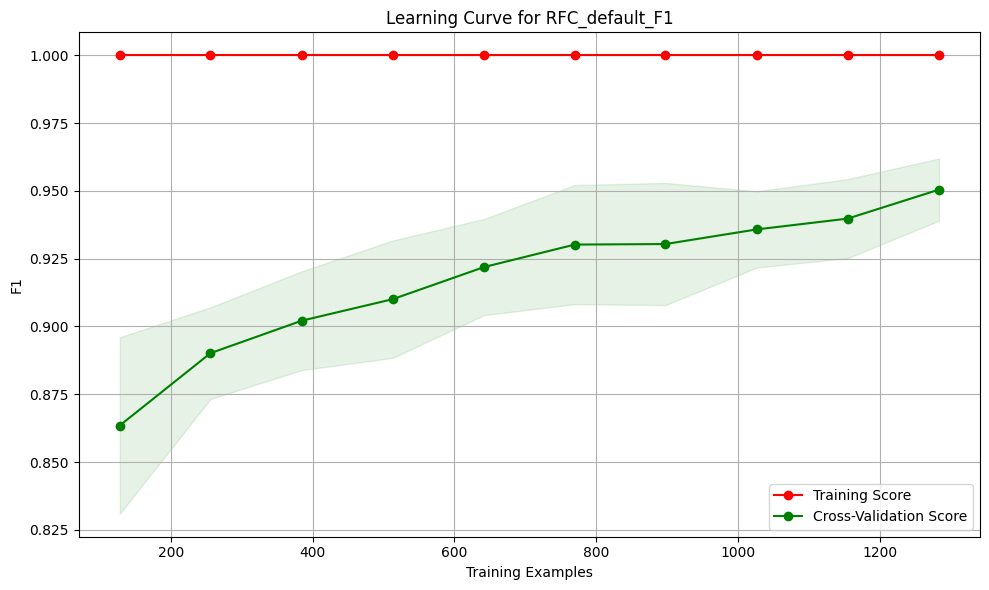

In [323]:
plot_learning_curve(rfc_default, X_train, y_cancer_train, metric='f1', model_name='RFC_default_F1')

### 6.5.1. GridSearch

In [324]:
""" # Random Forest con GridSearchCV
# Es robusto, maneja bien conjuntos de datos con características ruidosas o irrelevantes, y es capaz de capturar relaciones no lineales.

rfc_gridsearch = RandomForestClassifier(random_state=42)

param_grid_rfc = {
    'n_estimators': [100, 200, 500], # Número de árboles
    'max_depth': [None, 10, 20, 30], # Profundidad máxima de los árboles. Menores profundidades ayudan a evitar el overfitting.
    'min_samples_split': [2, 5, 10], #Mínimo número de muestras necesarias para dividir un nodo
    'min_samples_leaf': [1, 2, 4] # Mínimo número de muestras en una hoja
    #'max_features': ['auto', 'sqrt', 'log2'] # Número máximo de características a considerar para dividir un nodo. Es más común probar este hiperparámetro aquí  que en ExtraTrees
}
grid_rfc = GridSearchCV(rfc_gridsearch, param_grid_rfc, cv=5, scoring='f1', n_jobs=-1)
grid_rfc.fit(X_train, y_cancer_train)

# Mejor modelo RFC
rfc_best = grid_rfc.best_estimator_
print(f"Mejores hiperparámetros RFC: {grid_rfc.best_params_}")
 """

' # Random Forest con GridSearchCV\n# Es robusto, maneja bien conjuntos de datos con características ruidosas o irrelevantes, y es capaz de capturar relaciones no lineales.\n\nrfc_gridsearch = RandomForestClassifier(random_state=42)\n\nparam_grid_rfc = {\n    \'n_estimators\': [100, 200, 500], # Número de árboles\n    \'max_depth\': [None, 10, 20, 30], # Profundidad máxima de los árboles. Menores profundidades ayudan a evitar el overfitting.\n    \'min_samples_split\': [2, 5, 10], #Mínimo número de muestras necesarias para dividir un nodo\n    \'min_samples_leaf\': [1, 2, 4] # Mínimo número de muestras en una hoja\n    #\'max_features\': [\'auto\', \'sqrt\', \'log2\'] # Número máximo de características a considerar para dividir un nodo. Es más común probar este hiperparámetro aquí  que en ExtraTrees\n}\ngrid_rfc = GridSearchCV(rfc_gridsearch, param_grid_rfc, cv=5, scoring=\'f1\', n_jobs=-1)\ngrid_rfc.fit(X_train, y_cancer_train)\n\n# Mejor modelo RFC\nrfc_best = grid_rfc.best_estimator

In [325]:
""" # Guardar los mejores hiperparámetros
grid_rfc_path = os.path.join(results_models_path, 'best_hyperparameters_rfc.txt')
with open(grid_rfc_path, 'w') as f:
    f.write(f"Best hyperparameters RFC: {grid_rfc.best_params_}\n") """

' # Guardar los mejores hiperparámetros\ngrid_rfc_path = os.path.join(results_models_path, \'best_hyperparameters_rfc.txt\')\nwith open(grid_rfc_path, \'w\') as f:\n    f.write(f"Best hyperparameters RFC: {grid_rfc.best_params_}\n") '

In [326]:
""" # Guardar modelo
joblib.dump(rfc_best, os.path.join(results_models_path, 'best_model_rfc.pkl')) """

" # Guardar modelo\njoblib.dump(rfc_best, os.path.join(results_models_path, 'best_model_rfc.pkl')) "

In [327]:
# Cargar el modelo
loaded_rfc_best = joblib.load(os.path.join(results_models_path, 'best_model_rfc.pkl'))

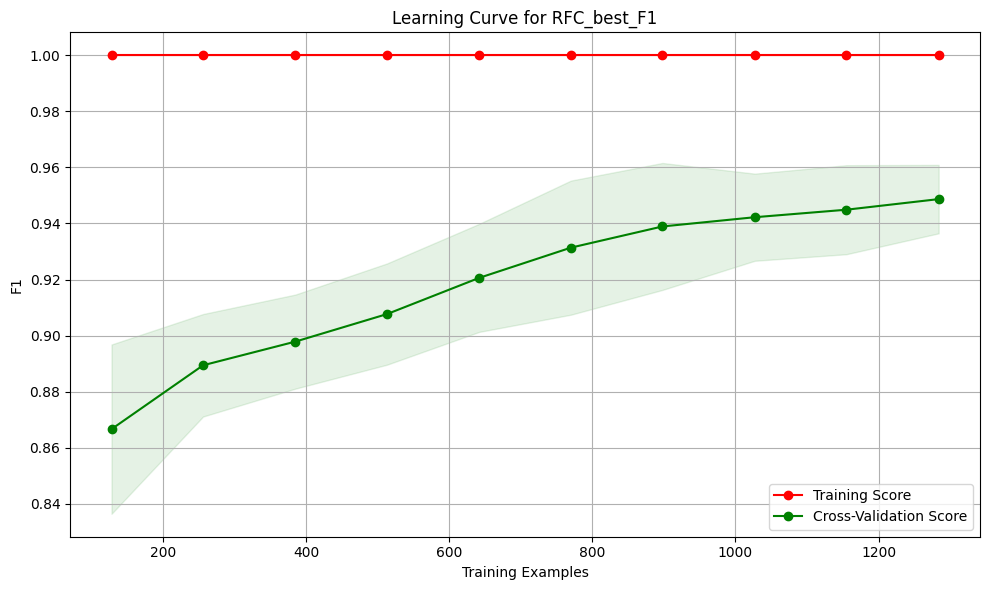

In [328]:
plot_learning_curve(loaded_rfc_best, X_train, y_cancer_train, metric='f1', model_name='RFC_best_F1')

### 6.5.3. Custom 

In [329]:
rfc_custom1 = RandomForestClassifier(random_state=42, max_depth=15, min_samples_leaf=5, min_samples_split=6, n_estimators=300)

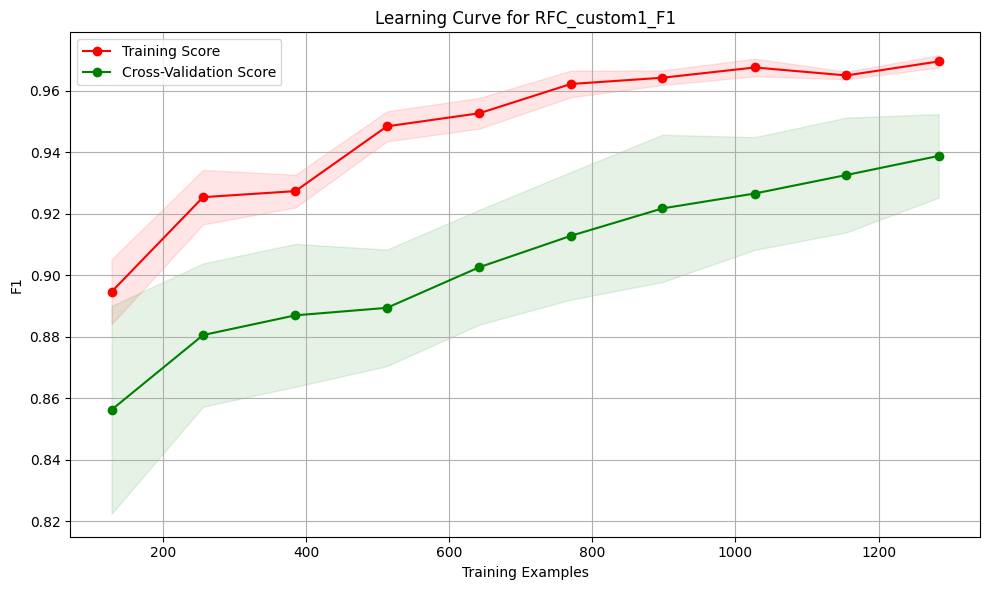

In [330]:
plot_learning_curve(rfc_custom1, X_train, y_cancer_train, metric='f1', model_name='RFC_custom1_F1')

In [331]:
rfc_custom2 = RandomForestClassifier(random_state=42, max_depth=10, min_samples_leaf=3, min_samples_split=4, n_estimators=300)

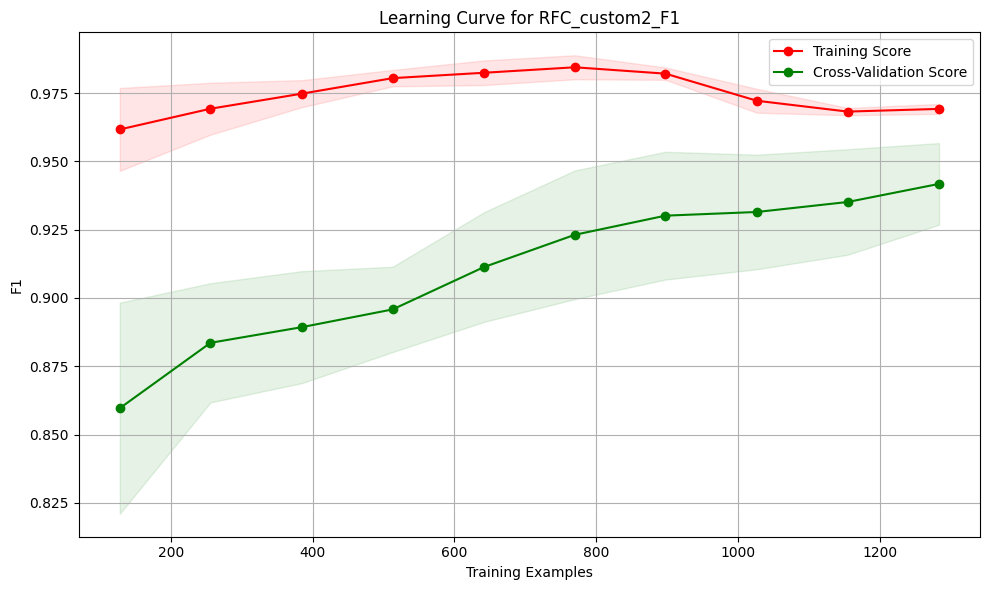

In [332]:
plot_learning_curve(rfc_custom2, X_train, y_cancer_train, metric='f1', model_name='RFC_custom2_F1')

### 6.5.4. Guardar el modelo final

In [376]:
""" # Guardar modelo
rfc_custom1.fit(X_train, y_cancer_train)
joblib.dump(rfc_custom1, os.path.join(results_models_path, 'final_model_rfc.pkl')) """

['C:/Users/mnunezmartinez_viu/Documents/14MBID---TFM--VF\\results/models\\final_model_rfc.pkl']

## 6.6. Extremely Randomized Trees

ExtraTrees pueden ser una buena opción para reducir el overfitting debido a la mayor aleatoriedad en la creación de árboles, lo que conduce a un conjunto de árboles más diversos y menos propensos a ajustarse a detalles específicos del conjunto de entrenamiento.

### 6.6.1. Default

In [334]:
# Valores predeterminados
etc_default = ExtraTreesClassifier(random_state=42)

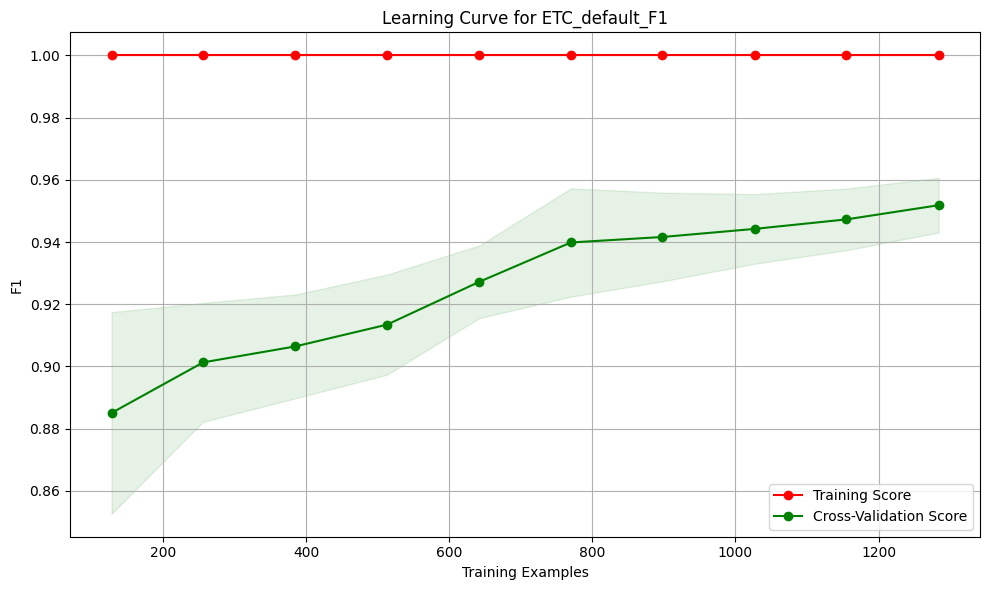

In [335]:
plot_learning_curve(etc_default, X_train, y_cancer_train, metric='f1', model_name='ETC_default_F1')

### 6.6.2. GridSearch

In [336]:
""" # Extremely Randomized Trees con GridSearchCV
# Variante del Random Forest que introduce más aleatoriedad durante la construcción de los árboles. Puede ser útil para reducir overfitting.

etc_gridsearch = ExtraTreesClassifier(random_state=42)

param_grid_etc = {
    'n_estimators': [100, 200, 500], # Número de árboles. Se puede probar 1000 porque, debido a la aleatoriedad, es más rápido.
    'max_depth': [None, 10, 20, 30], # Profundidad máxima de los árboles. Menores profundidades ayudan a evitar el overfitting.
    'min_samples_split': [2, 5, 10], #Mínimo número de muestras necesarias para dividir un nodo
    'min_samples_leaf': [1, 2, 4] # Mínimo número de muestras en una hoja
    #'max_features': ['auto', 'sqrt', 'log2'] # Número máximo de características a considerar para dividir un nodo
}
grid_etc = GridSearchCV(etc_gridsearch, param_grid_etc, cv=5, scoring='f1', n_jobs=-1)
grid_etc.fit(X_train, y_cancer_train)

# Mejor modelo KNN
etc_best = grid_etc.best_estimator_
print(f"Mejores hiperparámetros ETC: {grid_etc.best_params_}") """

' # Extremely Randomized Trees con GridSearchCV\n# Variante del Random Forest que introduce más aleatoriedad durante la construcción de los árboles. Puede ser útil para reducir overfitting.\n\netc_gridsearch = ExtraTreesClassifier(random_state=42)\n\nparam_grid_etc = {\n    \'n_estimators\': [100, 200, 500], # Número de árboles. Se puede probar 1000 porque, debido a la aleatoriedad, es más rápido.\n    \'max_depth\': [None, 10, 20, 30], # Profundidad máxima de los árboles. Menores profundidades ayudan a evitar el overfitting.\n    \'min_samples_split\': [2, 5, 10], #Mínimo número de muestras necesarias para dividir un nodo\n    \'min_samples_leaf\': [1, 2, 4] # Mínimo número de muestras en una hoja\n    #\'max_features\': [\'auto\', \'sqrt\', \'log2\'] # Número máximo de características a considerar para dividir un nodo\n}\ngrid_etc = GridSearchCV(etc_gridsearch, param_grid_etc, cv=5, scoring=\'f1\', n_jobs=-1)\ngrid_etc.fit(X_train, y_cancer_train)\n\n# Mejor modelo KNN\netc_best = gr

In [337]:
""" # Guardar los mejores hiperparámetros
grid_etc_path = os.path.join(results_models_path, 'best_hyperparameters_etc.txt')
with open(grid_etc_path, 'w') as f:
    f.write(f"Best hyperparameters SVM: {grid_etc.best_params_}\n") """

' # Guardar los mejores hiperparámetros\ngrid_etc_path = os.path.join(results_models_path, \'best_hyperparameters_etc.txt\')\nwith open(grid_etc_path, \'w\') as f:\n    f.write(f"Best hyperparameters SVM: {grid_etc.best_params_}\n") '

In [338]:
""" # Guardar modelo
joblib.dump(etc_best, os.path.join(results_models_path, 'best_model_etc.pkl')) """

" # Guardar modelo\njoblib.dump(etc_best, os.path.join(results_models_path, 'best_model_etc.pkl')) "

In [339]:
# Cargar el modelo
loaded_etc_best = joblib.load(os.path.join(results_models_path, 'best_model_etc.pkl'))

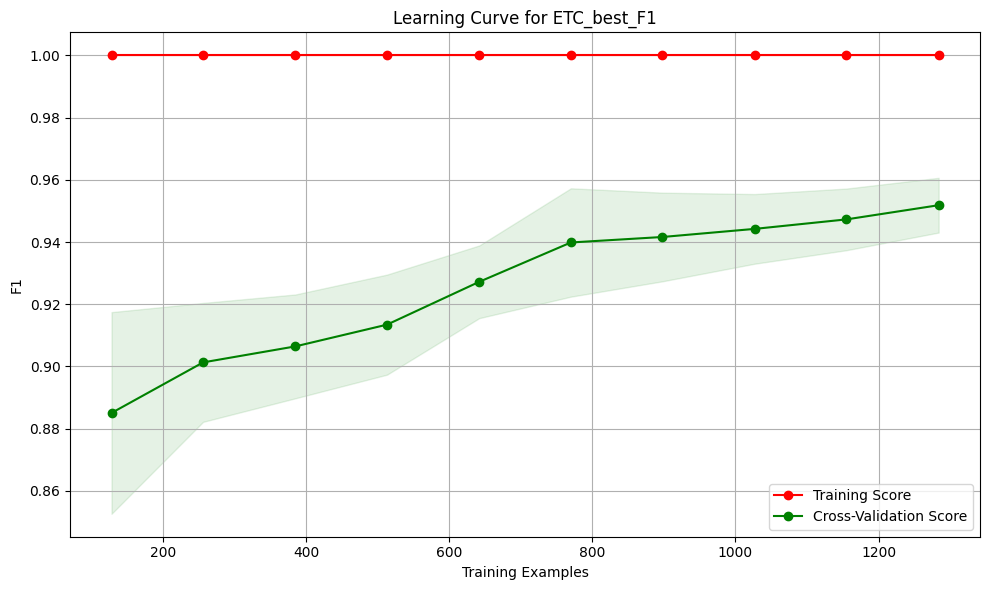

In [340]:
plot_learning_curve(loaded_etc_best, X_train, y_cancer_train, metric='f1', model_name='ETC_best_F1')

## 6.7. Gradient Boosting

### 6.7.1. Default

In [341]:
gbc_default = GradientBoostingClassifier(random_state=42)

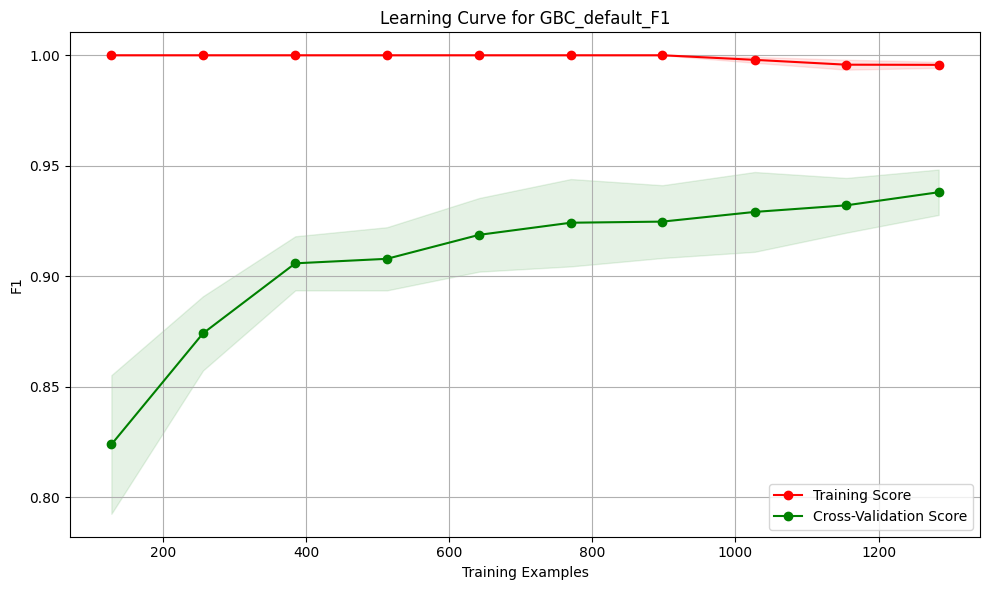

In [342]:
plot_learning_curve(gbc_default, X_train, y_cancer_train, metric='f1', model_name='GBC_default_F1')

### 6.7.2. GridSearch

In [343]:
""" # GridSearch con GridSearchCV
# Buen rendimiento en problemas complejos, siendo menos propenso al overfitting que otros algoritmos

gbc_gridsearch = GradientBoostingClassifier(random_state=42)

param_grid_gbc = {
    'n_estimators': [100, 200, 500], # Número de árboles
    'max_depth': [3, 5, 10], # Profundidad máxima de los árboles. Menores profundidades ayudan a evitar el overfitting.  Es mucho más sensible al max_depth debido a su naturaleza secuencial. Los árboles demasiado profundos pueden corregir en exceso los errores de los árboles anteriores, llevando a un fuerte sobreajuste. Por eso, en Gradient Boosting a menudo se utilizan profundidades más bajas que en Random Forest.
    'learning_rate': [0.001, 0.005, 0.01, 0.03], # Tasa de aprendizaje
    'subsample': [0.6, 0.8, 1], #  Fracción de muestras utilizadas para entrenar cada árbol
    'max_features': [0.6, 0.8, 1.0],  # Proporción de características para entrenar cada árbol
    'min_impurity_decrease': [0, 0.1, 0.5, 1]  # Reduce la impureza mínima para dividir un nodo
}
grid_gbc = GridSearchCV(gbc_gridsearch, param_grid_gbc, cv=5, scoring='f1', n_jobs=-1)
grid_gbc.fit(X_train, y_cancer_train)

# Mejor modelo KNN
gbc_best = grid_gbc.best_estimator_
print(f"Mejores hiperparámetros GBC: {grid_gbc.best_params_}")
 """

' # GridSearch con GridSearchCV\n# Buen rendimiento en problemas complejos, siendo menos propenso al overfitting que otros algoritmos\n\ngbc_gridsearch = GradientBoostingClassifier(random_state=42)\n\nparam_grid_gbc = {\n    \'n_estimators\': [100, 200, 500], # Número de árboles\n    \'max_depth\': [3, 5, 10], # Profundidad máxima de los árboles. Menores profundidades ayudan a evitar el overfitting.  Es mucho más sensible al max_depth debido a su naturaleza secuencial. Los árboles demasiado profundos pueden corregir en exceso los errores de los árboles anteriores, llevando a un fuerte sobreajuste. Por eso, en Gradient Boosting a menudo se utilizan profundidades más bajas que en Random Forest.\n    \'learning_rate\': [0.001, 0.005, 0.01, 0.03], # Tasa de aprendizaje\n    \'subsample\': [0.6, 0.8, 1], #  Fracción de muestras utilizadas para entrenar cada árbol\n    \'max_features\': [0.6, 0.8, 1.0],  # Proporción de características para entrenar cada árbol\n    \'min_impurity_decrease\':

NOTA: Tras 263min, no he conseguido resultados. Se procede con el modelo optimizado XGBoost en Google Colab.

### 6.7.3. XGBoost: Default

In [344]:
xgb_default = xgb.XGBClassifier(random_state=42)

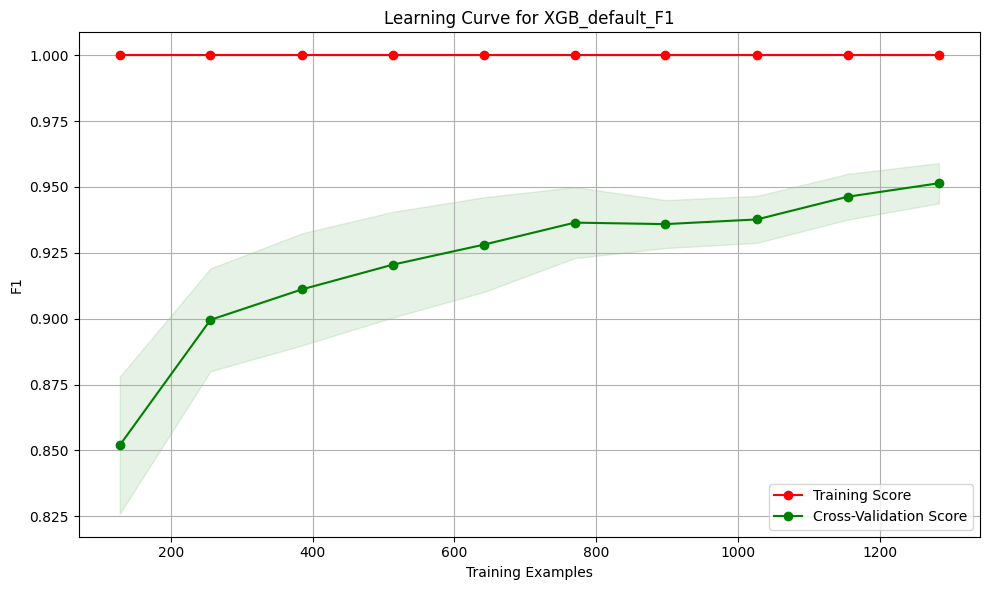

In [345]:
plot_learning_curve(xgb_default, X_train, y_cancer_train, metric='f1', model_name='XGB_default_F1')

### 6.7.4. XGBoost: GridSearch

In [346]:
# Cargar el modelo
loaded_xgb_best = joblib.load(os.path.join(results_models_path, 'best_model_xgb.pkl'))

c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:388: Changing updater from `grow_gpu_hist` to `grow_quantile_histmaker`.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:196: XGBoost is not compiled with CUDA support.
  wa

c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:18] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:196: XGBoost is not compiled with CUDA support.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:19] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWa

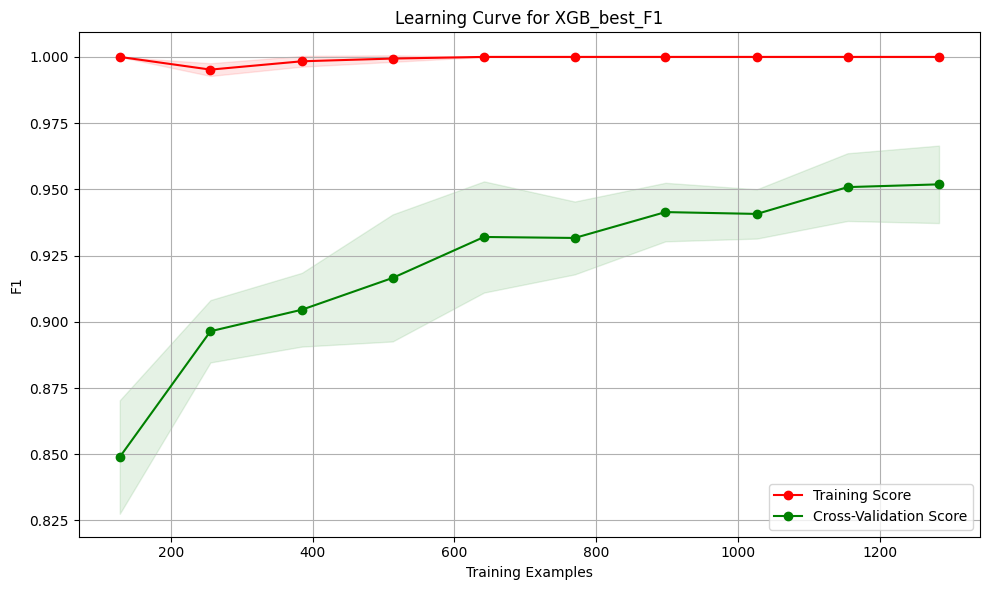

In [347]:
plot_learning_curve(loaded_xgb_best, X_train, y_cancer_train, metric='f1', model_name='XGB_best_F1')

### 6.7.4. XGBoost: Custom

In [348]:
# Cargar el modelo
loaded_xgb_custom1 = joblib.load(os.path.join(results_models_path, 'custom1_model_xgb.pkl'))

c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:54] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:388: Changing updater from `grow_gpu_hist` to `grow_quantile_histmaker`.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:54] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:54] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:196: XGBoost is not compiled with CUDA support.
  wa

c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:54] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:54] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:196: XGBoost is not compiled with CUDA support.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:18:54] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWa

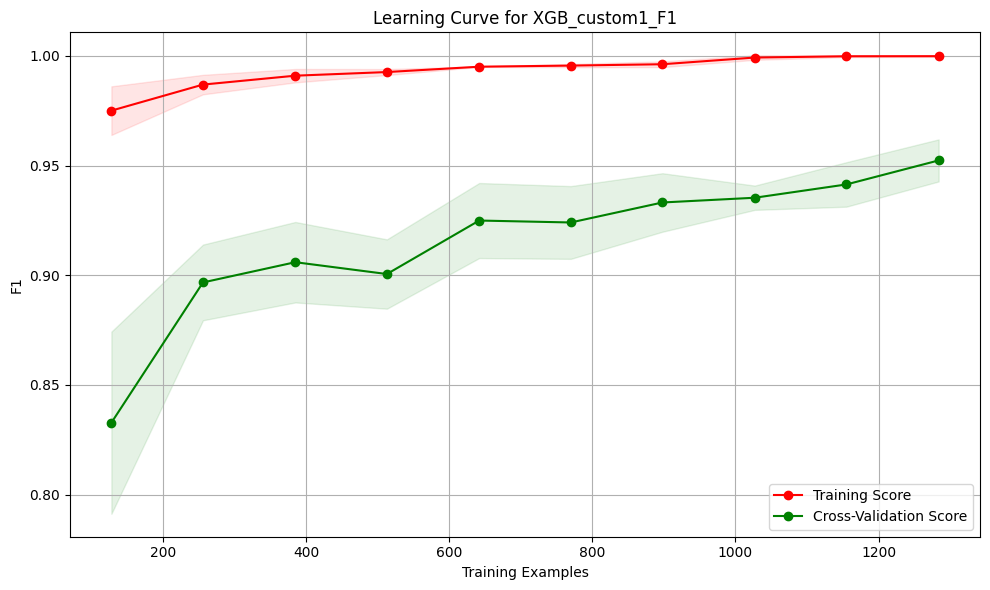

In [349]:
plot_learning_curve(loaded_xgb_custom1, X_train, y_cancer_train, metric='f1', model_name='XGB_custom1_F1')

In [350]:
# Cargar el modelo
loaded_xgb_custom2 = joblib.load(os.path.join(results_models_path, 'custom2_model_xgb.pkl'))

c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:20:00] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:388: Changing updater from `grow_gpu_hist` to `grow_quantile_histmaker`.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:20:00] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:20:00] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:196: XGBoost is not compiled with CUDA support.
  wa

c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:20:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:20:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:196: XGBoost is not compiled with CUDA support.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:20:02] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWa

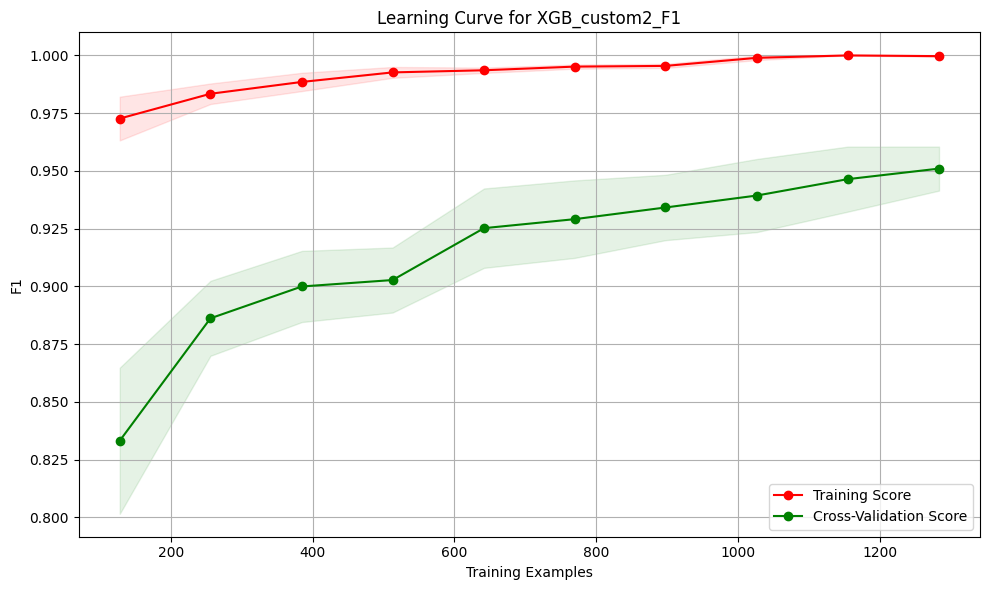

In [351]:
plot_learning_curve(loaded_xgb_custom2, X_train, y_cancer_train, metric='f1', model_name='XGB_custom2_F1')

## 6.8. Decision Trees

### 6.8.1. Default

In [352]:
dtc_default = DecisionTreeClassifier(random_state=42)

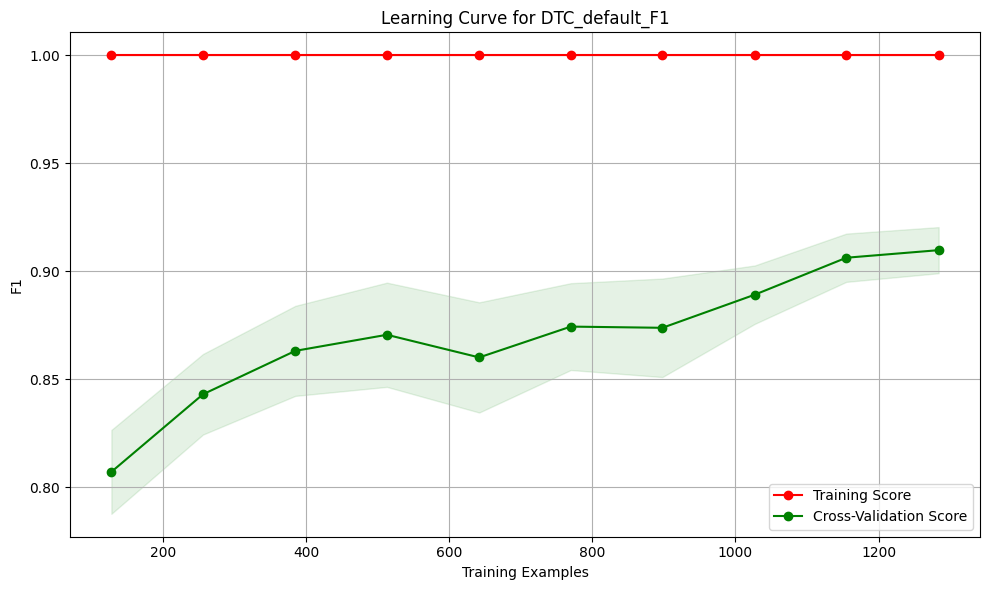

In [353]:
plot_learning_curve(dtc_default, X_train, y_cancer_train, metric='f1', model_name='DTC_default_F1')

## 6.9. MLP

### 6.9.1. Default

In [354]:
mlp_default = MLPClassifier(random_state=42)

c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:690: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged ye

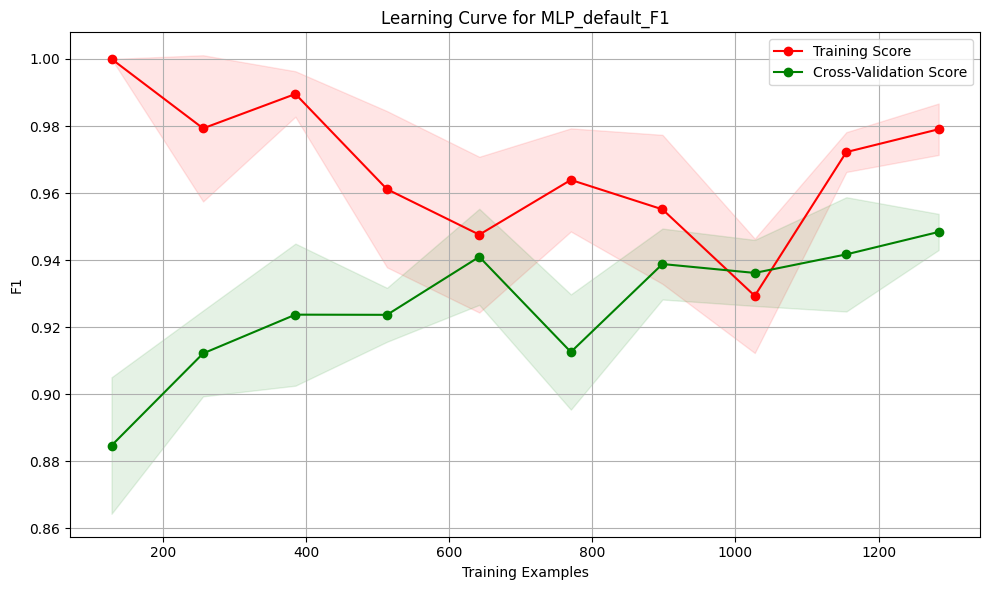

In [355]:
plot_learning_curve(mlp_default, X_train, y_cancer_train, metric='f1', model_name='MLP_default_F1')

### 6.9.2. Grid Search

In [356]:
""" mlp_gridsearch = MLPClassifier(random_state=42, early_stopping=True)

param_grid_mlp = {
    'hidden_layer_sizes': [(50,),(100,), (100, 50), (100, 100), (150, 100)],  # Tamaños de las capas ocultas
    'activation': ['relu', 'tanh'],  # Funciones de activación
    'solver': ['adam', 'sgd'],  # Algoritmos para optimización (adam es más común)
    'alpha': [0.0001, 0.001, 0.01],  # Parámetro de regularización L2
    'learning_rate_init': [0.001, 0.01, 0.1],  # Tasa de aprendizaje inicial
    'batch_size': [32, 64, 128],  # Tamaño del batch para la optimización
    'max_iter': [200, 300, 500], # Número máximo de iteraciones 
    'learning_rate': ['constant', 'adaptive'] # Ajuste de tasa de aprendizaje
}

# GridSearchCV con validación cruzada estratificada
grid_mlp = GridSearchCV(estimator=mlp_gridsearch, 
                        param_grid=param_grid_mlp, 
                        cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42), 
                        scoring='f1',
                        n_jobs=-1)

grid_mlp.fit(X_train, y_cancer_train)

mlp_best = grid_mlp.best_estimator_
print(f"Mejores hiperparámetros MLP: {grid_mlp.best_params_}")
 """

' mlp_gridsearch = MLPClassifier(random_state=42, early_stopping=True)\n\nparam_grid_mlp = {\n    \'hidden_layer_sizes\': [(50,),(100,), (100, 50), (100, 100), (150, 100)],  # Tamaños de las capas ocultas\n    \'activation\': [\'relu\', \'tanh\'],  # Funciones de activación\n    \'solver\': [\'adam\', \'sgd\'],  # Algoritmos para optimización (adam es más común)\n    \'alpha\': [0.0001, 0.001, 0.01],  # Parámetro de regularización L2\n    \'learning_rate_init\': [0.001, 0.01, 0.1],  # Tasa de aprendizaje inicial\n    \'batch_size\': [32, 64, 128],  # Tamaño del batch para la optimización\n    \'max_iter\': [200, 300, 500], # Número máximo de iteraciones \n    \'learning_rate\': [\'constant\', \'adaptive\'] # Ajuste de tasa de aprendizaje\n}\n\n# GridSearchCV con validación cruzada estratificada\ngrid_mlp = GridSearchCV(estimator=mlp_gridsearch, \n                        param_grid=param_grid_mlp, \n                        cv=StratifiedKFold(n_splits=5, shuffle=True, random_state=42), \

In [357]:
""" # Guardar los mejores hiperparámetros
grid_mlp_path = os.path.join(results_models_path, 'best_hyperparameters_mlp.txt')
with open(grid_mlp_path, 'w') as f:
    f.write(f"Best hyperparameters MLP: {grid_mlp.best_params_}\n") """

' # Guardar los mejores hiperparámetros\ngrid_mlp_path = os.path.join(results_models_path, \'best_hyperparameters_mlp.txt\')\nwith open(grid_mlp_path, \'w\') as f:\n    f.write(f"Best hyperparameters MLP: {grid_mlp.best_params_}\n") '

In [358]:
""" # Guardar modelo
joblib.dump(mlp_best, os.path.join(results_models_path, 'best_model_mlp.pkl')) """

" # Guardar modelo\njoblib.dump(mlp_best, os.path.join(results_models_path, 'best_model_mlp.pkl')) "

In [382]:
# mlp_best = MLPClassifier(random_state=42, early_stopping=True, activation='relu', alpha=0.01, batch_size=32, hidden_layer_sizes=(150, 100), learning_rate='adaptive', learning_rate_init=0.01, max_iter= 200, solver= 'sgd')

In [383]:
""" # Guardar modelo
mlp_best.fit(X_train, y_cancer_train)
joblib.dump(mlp_best, os.path.join(results_models_path, 'best_model_mlp.pkl')) """

['C:/Users/mnunezmartinez_viu/Documents/14MBID---TFM--VF\\results/models\\best_model_mlp.pkl']

In [362]:
# Cargar el modelo
loaded_mlp_best = joblib.load(os.path.join(results_models_path, 'best_model_mlp.pkl'))

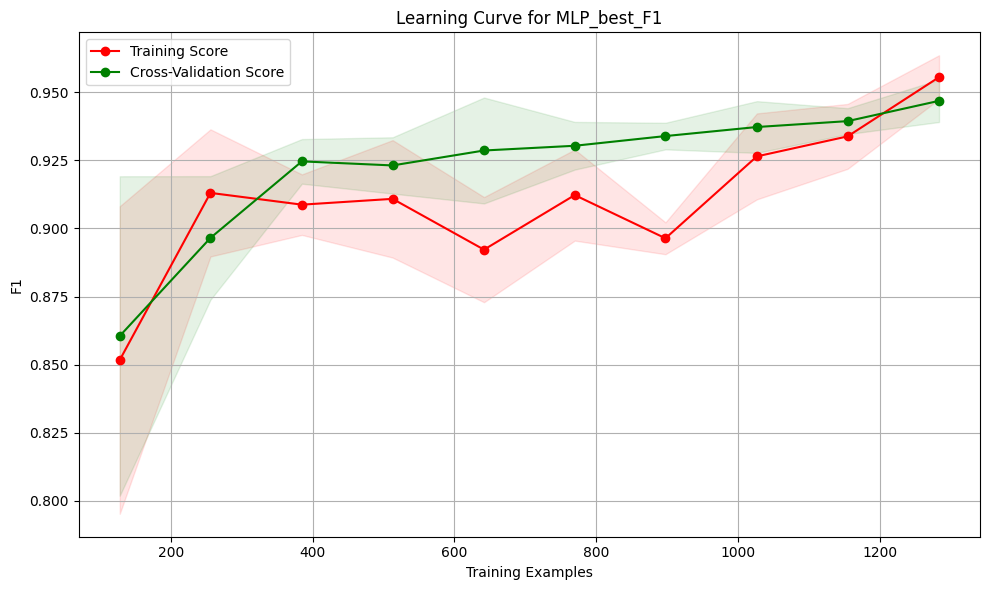

In [363]:
plot_learning_curve(loaded_mlp_best, X_train, y_cancer_train, metric='f1', model_name='MLP_best_F1')

---
# 7. Evaluación del Modelo
---

Una vez entrenados los modelos, es fundamental evaluarlos utilizando métricas de clasificación que te permitan interpretar los resultados. Se generarán métricas para cada modelo entrenado y se compararán entre sí. La métrica más importante en la detección de cáncer suele ser la sensibilidad, dado que los falsos negativos pueden tener graves consecuencias.

Métricas de evaluación:
- **Exactitud (Accuracy):** Proporción de predicciones correctas.
- **Sensibilidad/Recall:** La proporción de positivos correctamente identificados. Es especialmente importante en el contexto de la detección de cáncer.
- **Precisión (Precision):** Proporción de predicciones positivas correctas.
- **F1-Score:** La media armónica entre precisión y sensibilidad.
- **ROC-AUC:** Área bajo la curva ROC, que mide la capacidad del modelo para distinguir entre clases.

## 7.1. Métricas de evaluación

In [364]:
def evaluate_model(model, X_test, y_test):
    """
    Evalúa el modelo seleccionado y genera métricas de evaluación y visualización.
    
    Parametros:
    - model: Modelo previamente entrenado
    - X_test: Características del conjunto de prueba
    - y_test: Etiquetas del conjunto de prueba
    """

    # Realizar predicciones con el modelo seleccionado
    y_pred = model.predict(X_test)

    # Probabilidades de predicción para la curva ROC
    y_proba = model.predict_proba(X_test)[:, 1]  # Obtener la probabilidad para la clase positiva (1)
    
    # Calcular las métricas de evaluación
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    auc_roc = roc_auc_score(y_test, y_proba)
    
    # Mostrar las métricas de evaluación
    print(f'Accuracy: {accuracy:.4f}')
    print(f'Precision: {precision:.4f}')
    print(f'Recall: {recall:.4f}')
    print(f'F1-Score: {f1:.4f}')
    print(f'AUC-ROC: {auc_roc:.4f}')
    
    # Mostrar el reporte de clasificación
    print("\nReporte de clasificación:\n", classification_report(y_test, y_pred))
    
    # Generar la matriz de confusión
    model_name = model.__class__.__name__
    conf_matrix = confusion_matrix(y_test, y_pred)
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues')
    plt.xlabel('Valor predicho')
    plt.ylabel('Valor real')
    plt.title(f'Matriz de Confusión {model_name}')
    plt.show()


In [385]:
# Subir modelos
svm_final = joblib.load(os.path.join(results_models_path, 'final_model_svm.pkl'))
knn_final = joblib.load(os.path.join(results_models_path, 'final_model_knn.pkl'))
rfc_final = joblib.load(os.path.join(results_models_path, 'final_model_rfc.pkl'))
# xgb_final = joblib.load(os.path.join(results_models_path, 'custom2_model_xgb.pkl'))
mlp_final = joblib.load(os.path.join(results_models_path, 'best_model_mlp.pkl'))

c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:33:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\gbm\gbtree.cc:388: Changing updater from `grow_gpu_hist` to `grow_quantile_histmaker`.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:33:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:43: No visible GPU is found, setting device to CPU.
  warnings.warn(smsg, UserWarning)
c:\Users\mnunezmartinez_viu\miniconda3\envs\TFM\Lib\site-packages\xgboost\core.py:158: UserWarning: [12:33:55] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\context.cc:196: XGBoost is not compiled with CUDA support.
  wa

#### 7.1.1. SVM

Accuracy: 0.9213
Precision: 0.8261
Recall: 0.9596
F1-Score: 0.8879
AUC-ROC: 0.9788

Reporte de clasificación:
               precision    recall  f1-score   support

           0       0.98      0.90      0.94       206
           1       0.83      0.96      0.89        99

    accuracy                           0.92       305
   macro avg       0.90      0.93      0.91       305
weighted avg       0.93      0.92      0.92       305



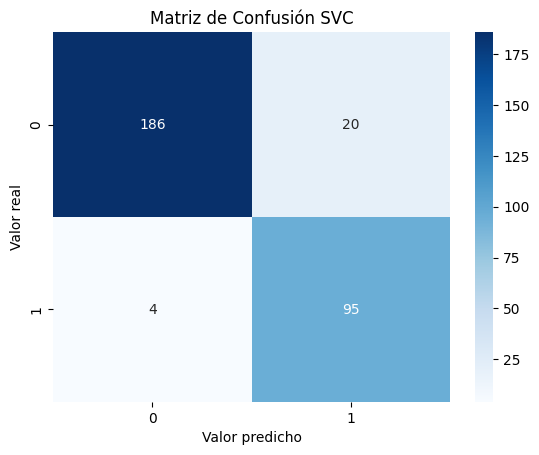

In [369]:
evaluate_model(svm_final, X_test, y_cancer_test)

### 7.1.2. KNN

Accuracy: 0.9049
Precision: 0.7966
Recall: 0.9495
F1-Score: 0.8664
AUC-ROC: 0.9572

Reporte de clasificación:
               precision    recall  f1-score   support

           0       0.97      0.88      0.93       206
           1       0.80      0.95      0.87        99

    accuracy                           0.90       305
   macro avg       0.88      0.92      0.90       305
weighted avg       0.92      0.90      0.91       305



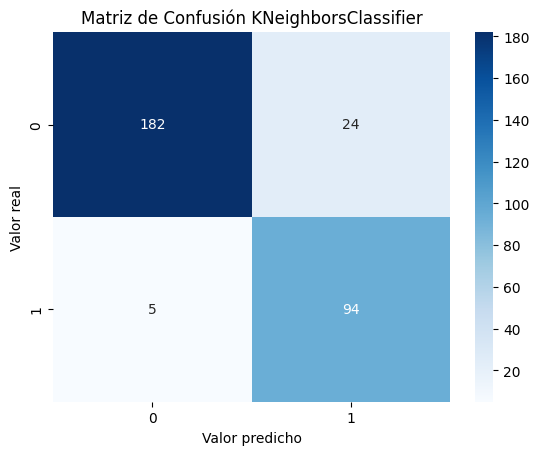

In [375]:
evaluate_model(knn_final, X_test, y_cancer_test)

### 7.1.3. Random Forest

Accuracy: 0.9180
Precision: 0.8190
Recall: 0.9596
F1-Score: 0.8837
AUC-ROC: 0.9690

Reporte de clasificación:
               precision    recall  f1-score   support

           0       0.98      0.90      0.94       206
           1       0.82      0.96      0.88        99

    accuracy                           0.92       305
   macro avg       0.90      0.93      0.91       305
weighted avg       0.93      0.92      0.92       305



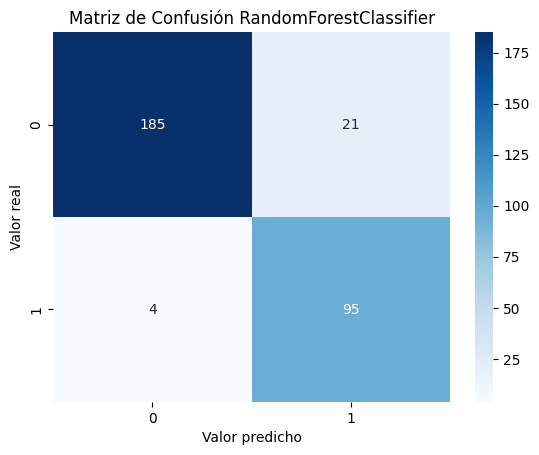

In [378]:
evaluate_model(rfc_final, X_test, y_cancer_test)

### 7.1.4. XGBoost

**NOTA:** Generado en TFM_code_GPU

In [380]:
# evaluate_model(xgb_final, X_test, y_cancer_test)

### 7.1.5. MLP

Accuracy: 0.9279
Precision: 0.8407
Recall: 0.9596
F1-Score: 0.8962
AUC-ROC: 0.9777

Reporte de clasificación:
               precision    recall  f1-score   support

           0       0.98      0.91      0.94       206
           1       0.84      0.96      0.90        99

    accuracy                           0.93       305
   macro avg       0.91      0.94      0.92       305
weighted avg       0.93      0.93      0.93       305



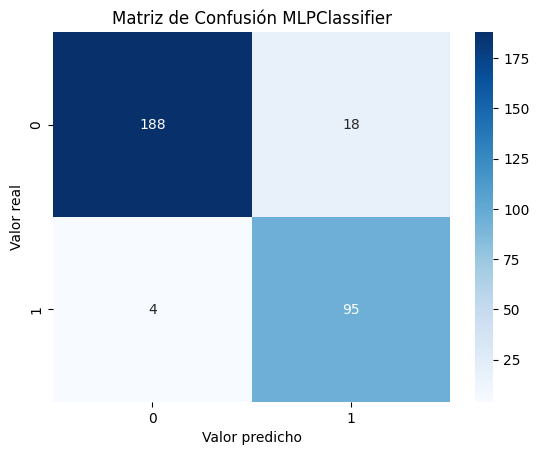

In [386]:
evaluate_model(mlp_final, X_test, y_cancer_test)

## 7.2. Curvas ROC y PC

**Curva ROC**  
La curva ROC muestra cómo cambia la tasa de verdaderos positivos frente a la tasa de falsos positivos a diferentes umbrales de clasificación.  
Área bajo la curva ROC (AUC-ROC): El área bajo esta curva (AUC) proporciona una medida del rendimiento del modelo. Un AUC cercano a 1 indica un excelente rendimiento, mientras que un AUC de 0.5 indica un modelo que no tiene poder de clasificación (equivalente a una clasificación aleatoria).

**Curva PC**  
La curva Precision-Recall es útil cuando se trabaja con datasets desbalanceados (donde hay muchas más observaciones negativas que positivas), ya que se enfoca en la capacidad del modelo para capturar la clase positiva.  
Área bajo la curva PR (AP): El área bajo esta curva es el Average Precision (AP), que mide la precisión media en todos los niveles de recall. Al igual que con ROC, cuanto más alto sea este valor, mejor será el rendimiento del modelo.

In [387]:
from sklearn.metrics import roc_curve, auc

def plot_roc_pr_curves(model, X_test, y_test):
    """
    Genera las curvas ROC y Precision-Recall para el modelo seleccionado.
    
    Parametros:
    - model: Modelo previamente entrenado
    - X_test: Características del conjunto de prueba
    - y_test: Etiquetas del conjunto de prueba
    """
    # Obtener probabilidades de predicción para la clase positiva
    y_proba = model.predict_proba(X_test)[:, 1]  # Probabilidad para la clase positiva (1)
    
    # Calcular la curva ROC
    fpr, tpr, _ = roc_curve(y_test, y_proba)
    roc_auc = auc(fpr, tpr)  # Área bajo la curva ROC (AUC)
    
    # Calcular la curva Precision-Recall
    precision, recall, _ = precision_recall_curve(y_test, y_proba)
    pr_auc = average_precision_score(y_test, y_proba)  # Área bajo la curva PR (Average Precision Score)

    model_name = model.__class__.__name__

    # Plot de la curva ROC
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)  # 1 fila, 2 columnas, gráfico 1
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (AUC = {roc_auc:.4f})')
    plt.plot([0, 1], [0, 1], color='red', linestyle='--')  # Línea diagonal para referencia
    plt.xlabel('Tasa de Falsos Positivos (FPR)')
    plt.ylabel('Tasa de Verdaderos Positivos (TPR)')
    plt.title(f'Curva ROC {model_name}')
    plt.legend(loc='lower right')

    # Plot de la curva Precision-Recall
    plt.subplot(1, 2, 2)  # 1 fila, 2 columnas, gráfico 2
    plt.plot(recall, precision, color='green', lw=2, label=f'PR curve (AUC = {pr_auc:.4f})')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title(f'Curva Precision-Recall {model_name}')
    plt.legend(loc='lower left')

    plt.tight_layout()
    plt.show()


#### 7.1.1. SVM

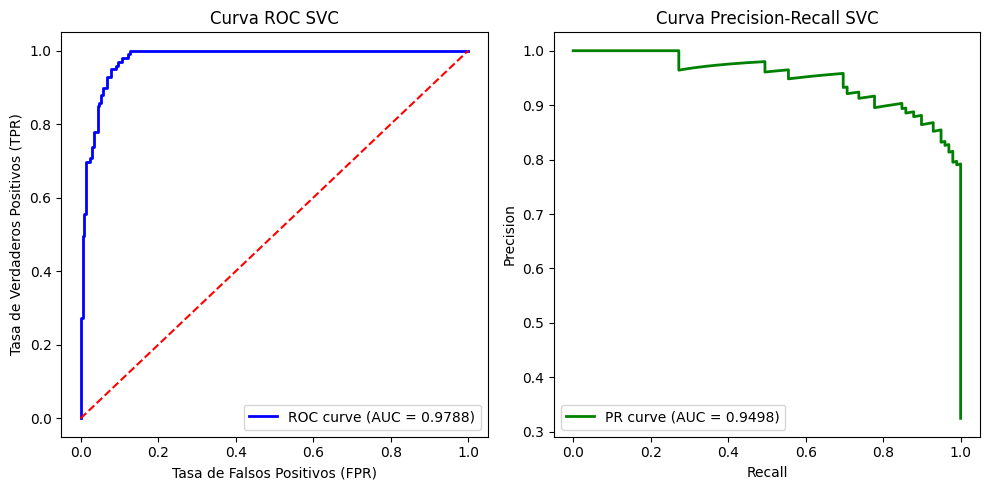

In [388]:
plot_roc_pr_curves(svm_final, X_test, y_cancer_test)

### 7.1.2. KNN

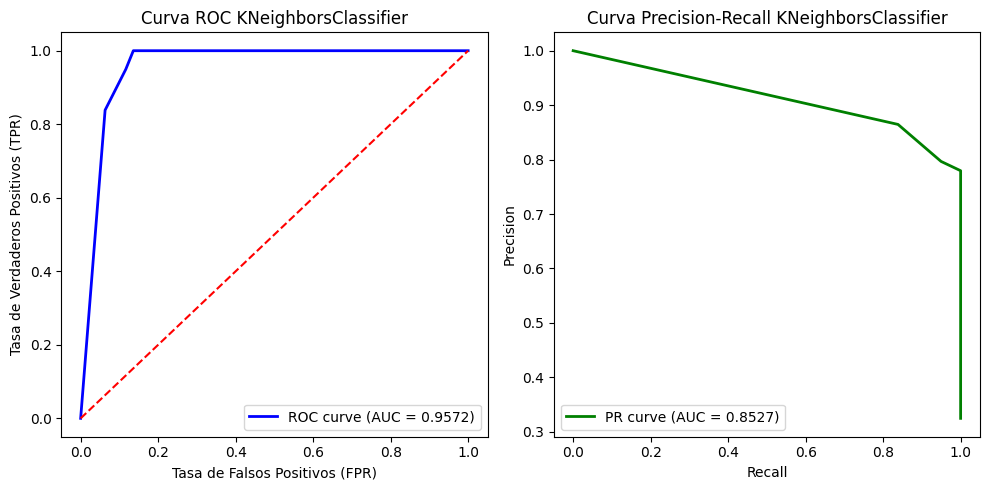

In [389]:
plot_roc_pr_curves(knn_final, X_test, y_cancer_test)

### 7.1.3. Random Forest

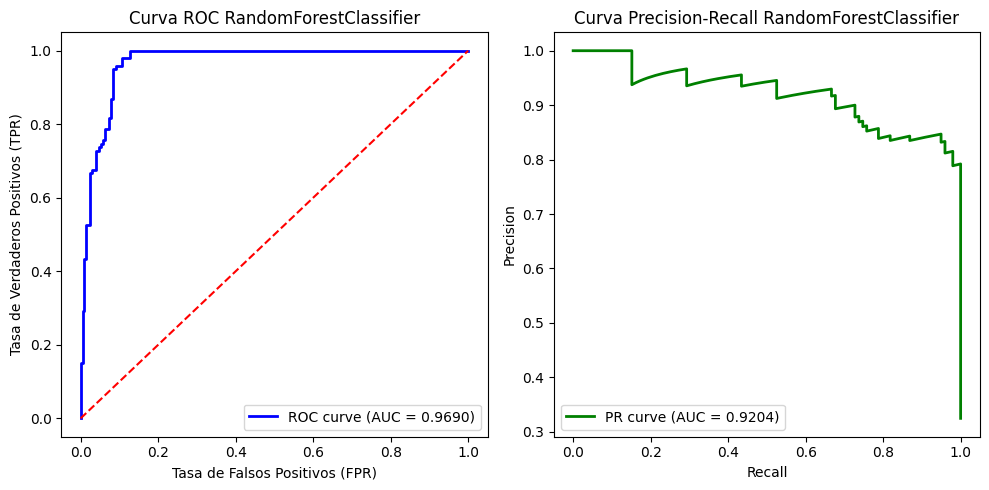

In [390]:
plot_roc_pr_curves(rfc_final, X_test, y_cancer_test)

### 7.1.4. XGBoost

**NOTA:** Generado en TFM_code_GPU

In [391]:
# plot_roc_pr_curves(xgb_final, X_test, y_cancer_test)

### 7.1.5. MLP

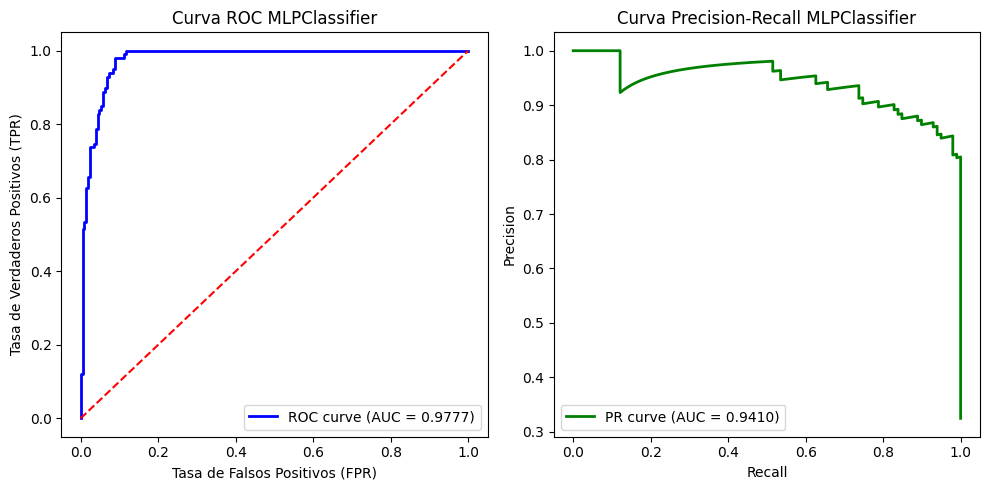

In [392]:
plot_roc_pr_curves(mlp_final, X_test, y_cancer_test)

# 8. Interpretación de modelos

## 8.1. Importancia de características

Tanto Random Forest como XGBoost ofrecen métodos integrados para obtener la importancia de las características.

In [393]:
def feature_importance(model, X_train):
    """
    Grafica la importancia de las características para Random Forest y XGBoost.
    
    Parametros:
    - model: Modelo previamente entrenado (RandomForest o XGBoost).
    - X_train: Características del conjunto de prueba

    Devoluciones:
    - feature_importance_df: DataFrame con nombres de características y sus valores de importancia
    """
    #Nombres de caracteristicas
    feature_names = X_train.columns

    # Obtener la importancia de las características
    importances = model.feature_importances_

    # Crear un DataFrame con nombres de características e importancia
    feature_importance_df = pd.DataFrame({
        'miARN': feature_names,
        'Importancia': importances
    })

    # Ordenar por importancia
    feature_importance_df = feature_importance_df.sort_values(by='Importancia', ascending=False)
    feature_importance_df.reset_index(inplace=True, drop=True)
    
    # Ordenar la importancia de las características y seleccionar las top más importantes
    indices = np.argsort(importances)[::-1]
    
    # Graficar la importancia de las características
    model_name = model.__class__.__name__
    plt.figure(figsize=(30, 6))
    plt.title(f'Importancia de las Características - {model_name}')
    plt.bar(range(len(feature_names)), importances[indices], align='center')
    plt.xticks(range(len(feature_names)), np.array(feature_names)[indices], rotation=90)
    plt.xlabel('miRNAs')
    plt.ylabel('Importancia')
    plt.grid(True)
    plt.show()

    return feature_importance_df


### 8.1.1. Random Forest

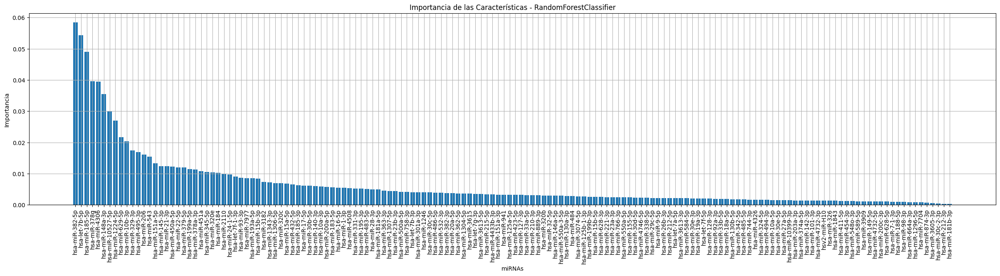

In [394]:
rfc_feature_importance_df = feature_importance(rfc_final, X_train)

In [395]:
# Guardar el csv
rfc_feature_importance_path = os.path.join(characteristics_path, 'rfc_feature_importance.csv')
rfc_feature_importance_df.to_csv(rfc_feature_importance_path, index=False)

In [397]:
rfc_feature_importance_df.head(20)

,miARN,Importancia
0,hsa-miR-382-5p,0.058400
1,hsa-let-7b-5p,0.054388
2,hsa-miR-185-5p,0.049064
3,hsa-miR-378g,0.039679
4,hsa-miR-4306,0.039511
5,hsa-miR-148a-3p,0.035488
6,hsa-miR-10527-5p,0.029876
7,hsa-miR-1224-5p,0.026958
8,hsa-miR-629-5p,0.021690
9,hsa-miR-10b-3p,0.020351


### 8.1.2. XGBoost

In [396]:
""" xgb_feature_importance_df = feature_importance(xgb_final, X_train)
# Guardar el csv
xgb_feature_importance_path = os.path.join(characteristics_path, 'xgb_feature_importance.csv')
xgb_feature_importance_df.to_csv(xgb_feature_importance_path, index=False) """

" xgb_feature_importance_df = feature_importance(xgb_final, X_train)\n# Guardar el csv\nxgb_feature_importance_path = os.path.join(characteristics_path, 'xgb_feature_importance.csv')\nxgb_feature_importance_df.to_csv(xgb_feature_importance_path, index=False) "